In [396]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
from sklearn.linear_model import LinearRegression
from datetime import date, timedelta
from scipy.optimize import leastsq
#from sklearn.linear_model import LinearRegression
from matplotlib.dates import DateFormatter
from scipy.stats import chisquare

#from datetime import date, timedelta
yesterday = date.today() - timedelta(days=1)
d1 = yesterday.strftime("%Y-%m-%d")
#yesterday1 = date.today() - timedelta(days=3)
d12f = lambda x:(date.today() - timedelta(days=x)).strftime("%Y-%m-%d")

countriesEU = ["Austria","Italy","Belgium","Latvia","Bulgaria","Lithuania",\
               "Croatia","Luxembourg","Cyprus","Malta","Czechia","Netherlands",\
               "Denmark","Poland","Estonia","Portugal","Finland","Romania","France",\
               "Slovakia","Germany","Slovenia","Greece","Spain","Hungary","Sweden","Ireland"]
#x = [ 8.08213515e+04,  2.21924344e-01, -7.12649833e-01]
d0 = date(2020, 3, 29)
d2 = date.today()
deltaT = d2 - d0
print(deltaT.days)
dT = deltaT.days
koreaCoeffs = [  0.35416971,   0.02606324,   4.35859408,  19.30413219]
RkoreaCoeffs=[ 0.36242246,  2.56241634,  1.84890887,  0.13324732]
%matplotlib inline
expPopWorld = 2.67152730e+06
def moving_average(a, n=3) :
    ret = np.cumsum(a, dtype=float)
    ret[n:] = ret[n:] - ret[:-n]
    return ret[n - 1:] / n

def linreg(dfLT,population):
    
    dfLT['date'] = pd.to_datetime(dfLT['date'])
    yy = np.log(dfLT['cases'].values*10000./population)
    xx = np.array(range(dfLT['cases'].size)).reshape((-1, 1))
    model1 = LinearRegression().fit(xx, yy)
    r_sq1 = model1.score(xx, yy)
    return model1, r_sq1, dfLT

def plotpred(dfLT1, population, dateStart, dateEnd, filename, model1, country,level):
    
    #fig, ax = plt.subplots(figsize=(12, 12))
    plt.plot(dfLT1['date'].values,dfLT1['cases']*10000./population)
    date_form = DateFormatter("%m-%d")
    ax = plt.axes()
    ax.xaxis.set_major_formatter(date_form)
    ix1 = pd.date_range(dateStart, dateEnd, freq='D')
    ss1 = pd.DataFrame({'date': ix1},index=range(len(ix1)))
    y_pred1 = np.exp(model1.intercept_ + model1.coef_ * range(len(ix1)))
    ax.plot(ss1['date'].values,y_pred1)
    plt.xticks(rotation=90)
    plt.title(country)
    plt.ylabel('Tolat COVID-19 cases per 10000')
    ax.fill_between(ss1['date'].values, 1,level, facecolor='red', alpha=0.3)
    ax.fill_between(ss1['date'].values, yc,1, facecolor='m', alpha=0.3)
    ax.fill_between(ss1['date'].values, 1e-3,yc, facecolor='y', alpha=0.3)
    plt.xlabel('Date')
    #plt.yscale('log')
    plt.yscale('log')
    plt.grid()
    plt.savefig(filename)
    plt.show()
    ss1a = pd.DataFrame({'cases': (y_pred1*population/10000).astype(int)},index=range(len(y_pred1)))
    ss1t = pd.concat([ss1,ss1a], axis=1)
    return ss1t

def forecast(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases',pMAPE=True):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))#+coeffs[0]*.25/(1 + np.exp( - coeffs[1] * (t - 3.5*coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    if pMAPE:
        print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: logistic')
    print('coeffs: ',x)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    if cases=='cases':
        print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0)) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print(output)
    return x

def forecast2(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'bi-logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendS0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: bi-logistic')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("bi-logistic approximation splitting point: %d"%(vL))
    print(output0)
    print(output)
    return x

def forecast3(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.],vL=[0,3],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))+coeffsUS[3]/(1 + np.exp( - coeffsUS[4] * (t - coeffsUS[5])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP,vL[1])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendS0(dfSP,vL[0])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendS1(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: tri-logistic')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('forecast rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("tri-logistic approximation splitting points: %d,%d"%(vL[0],vL[1]))
    print(output0)
    print(output1)
    print(output)
    
    return x

def trend3(dfLV,dfLT1,dfES,lLV,lLT,lES,pLV,pLT,pES):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #dfLT1 = pd.read_csv("~/Desktop/coronaLT1.csv",",")
    y = np.log(np.diff(dfLT1["cases"].values)[:]/dfLT1["cases"].values[1:]**2)
    x = np.array(range(len(dfLT1["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLT)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLT) 
    plt.plot(range(len(x)+pLT),y_pred12,label='%s tr'%(lLT))

    y = np.log(np.diff(dfES["cases"].values)[:]/dfES["cases"].values[1:]**2)
    x = np.array(range(len(dfES["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lES)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pES) 
    plt.plot(range(len(x)+pES),y_pred12,label='%s tr'%(lES))
    plt.xlabel('t, days')
    plt.ylabel('G(t)')
    plt.grid()
    plt.legend()
    plt.savefig("pictures/logdifflogcorna%s%s%s.png"%(lLV,lLT,lES))
    plt.show()
    
def trend(dfLV,lLV,pLV):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    plt.xlabel('t [days]')
    plt.ylabel('G(t)')
    plt.grid()
    plt.legend()
    plt.savefig("pictures/logdifflogcorna%s.png"%(lLV))
    plt.show()

def trendS(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL:], y[vL:])
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendS0(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[:vL], y[:vL])
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend0 coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x[:vL])+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL])+pLV,y_pred12, output

def trendS1(dfLV,vL=[0,3],pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend1 coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output
    
def forecastR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model'],loc='lower right') 
    ax2.set_xlabel('t, days')
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_ylim([0,max(np.diff(allmodel)*(1+3*diffStd))])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t, output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s%d_R.png"%(Cntr,int(xcoef[0]*100)))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    print('model: Richards')
    print('coeffs: ',x)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1])) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    print('\t total death: ', deathV,'±',int(deathV*diffStd0))
    print (output)
    return x

def forecast2R(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3] * coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3] *coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])-coeffs2[0]/(1 + np.exp( - coeffs2[3] *coeffs2[1] * (tt - coeffs2[2])))**(1./coeffs2[3])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model'],loc='lower right') 
    ax2.set_xlabel('t, days')
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.set_ylim([0,max(np.diff(allmodel)*(1+3*diffStd))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s%d_R.png"%(Cntr,int(xcoef[0]*100)))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    print('model: bi-Richards')
    print('coeffs: ',x,coeffs2)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1]))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    print('\t total death: ', deathV,'±',int(deathV*diffStd0))
    print(output)
    return x

def forecast3R(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3] * coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3] * coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])+coeffsUS[4]/(1 + np.exp( - coeffsUS[7] * coeffsUS[5] * (t - coeffsUS[6])))**(1./coeffsUS[7])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(waveform_1-model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel-6*diffStd0*np.ones(len(tt)),allmodel+6*diffStd0*np.ones(len(tt)), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model']) 
    ax2.set_xlabel('t, days')
    ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(np.diff(waveform_1)-np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)-3*diffStd*np.ones(len(tt)-1), np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1), alpha=0.2)
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t [days]')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s_R.png"%(Cntr))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    rint('model: tri-Richards')
    print('coeffs: ',x,coeffs2)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1]))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    print('\t total death: ', int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0]))
    print(output)
    return x

def get_cases(df,threshold):    
    dfA = df[df[['Country','TotCasesper1Mpop']].TotCasesper1Mpop>=threshold]
    #y = df[df['Country','TotCasesper1Mpop'].TotCasesper1Mpop>=56.]
    dfA = dfA.sort_values(by=['TotCasesper1Mpop'], ascending=False)
    country = dfA['Country']
    #country = country.tolist()
    cases = dfA['TotCasesper1Mpop']/100
    #case = cases.tolist()
    return country, cases

def stat_picture(country, cases, high=35, picname="pictures/coronage0.png"):
# Import the necessary packages and modules


    # Prepare the data
    #x = dfA['Country']
    fig = plt.figure( figsize=(6, high))
    fig.subplots_adjust(bottom=0.2, left=0.1)
    # Plot the data
    y_pos = cases
    #barh(y_pos, performance, xerr=error, align='center')
    plt.barh(country,y_pos)
    #plt.xticks(rotation=90)
    plt.xlabel('COVID-19 cases per 10000')
    # Add a legend
    plt.legend()
    ax = plt.axes() 
    x = range(len(country))
    ax.fill_betweenx(x, 1,1000, facecolor='red', alpha=0.3)
    yc = 0.56
    ax.fill_betweenx(x, yc,1, facecolor='m', alpha=0.3)
    ax.fill_betweenx(x, 1e-4,yc, facecolor='y', alpha=0.3)
    plt.vlines(yc, 0, len(country)-1, colors='g', linestyles='solid')
    #plt.ylim([1e-2,60])
    ax.xaxis.grid() # horizontal lines
    #ax.xaxis.grid() # vertical lines

    ax.set_yticks(range(len(country)))
    ax.set_yticklabels(country)
    #ax.invert_yaxis()
    plt.xscale("log")
    # Show the plot

    plt.savefig(picname, bbox_inches='tight')
    plt.show()
    
def read_df(dfRM,lRM):
    dfRM = pd.read_csv("data/corona%s.csv"%(lRM),",")
    dfRM['date'] = pd.to_datetime(dfRM['date'])
    print("%s\n"%(lRM),dfRM.tail())
    return dfRM

199


In [397]:
from sklearn.linear_model import Ridge
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import make_pipeline

def forecastRR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    locStr = 'upper left'
    if Cntr in ['New Zealand']:
        locStr = 'lower right'
    ax2.legend(['COVID-19 %s'%(Cntr), 'Richards','-3days'],loc=locStr) 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecastRRR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]) )))#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast2RRR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]))))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * ((t- coeffsUS[2])*(t- coeffsUS[3]))))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]))))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    24.31714688, 0.00530186**2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSQ0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-logisticQ approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast3RRR(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1],vL=[0,3],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])* (t - coeffsUS[3])))+coeffsUS[4]/(1 + np.exp( - coeffsUS[5] * (t - coeffsUS[6])* (t - coeffsUS[7])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.01 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP,vL[1])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSQ0(dfSP,vL[0])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendSQ1(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: tri-logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "tri-logisticQ approximation splitting points: %d,%d"%(vL[0],vL[1])
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output1)
    ff.write(output1.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def trendSQ(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL:], y[vL:])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[vL:], y[vL:]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:, np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(x,y,label=lLV)
    #y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSQ0(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL:], y[vL:])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[:vL], y[:vL]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:vL, np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL]),y_pred12, output

def trendSQ1(dfLV,vL=[0,3],pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:vL[1], np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend1 coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(x,y,label=lLV)
    #y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL[1]]),y_pred12, output

def trendSS(dfLV,vL=0,pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL:], y[vL:])
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSS0(dfLV,vL=0,pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[:vL], y[:vL])
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSS1(dfLV,vL=[0,1],pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

In [398]:
def forecastQR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * coeffs[4] * ((t- coeffs[2])**0.5*(t- coeffs[3])**0.5 )))**(1./coeffs[4])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001, 5.0e-2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3],xcoef[4]*x[4]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3],xcoef[4]*x_1[4]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'RichardsQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_QR.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_QR.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: RichardsQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x


def forecast2RR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)   
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3]*coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL,nu=x[3])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-Richards approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast3RR(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1],vL=[0,3],cases='cases',zoom=1.):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3]*coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])+coeffsUS[4]/(1 + np.exp( - coeffsUS[7]*coeffsUS[5] * (t - coeffsUS[6])))**(1./coeffsUS[7])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop/4,  2.61212092e+01, -9.65961409e-01,  5.96529356e-03], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    if zoom != 1.:
        ax3.set_ylim([0,zoom])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL[1],nu=x[3])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL[0],nu=x[3])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendSS1(dfSP,vL,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: tri-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "tri-logisticQ approximation splitting points: %d,%d"%(vL[0],vL[1])
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output1)
    ff.write(output1.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast2QR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)   
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[4]*coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))**(1./coeffs[4])+coeffsUS[0]/(1 + np.exp( - coeffsUS[4]*coeffsUS[1] * (t - coeffsUS[2])* (t - coeffsUS[3])))**(1./coeffsUS[4])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[4]*coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))**(1./coeffs[4])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001, 5.0e-2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-logisticQ approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

In [422]:
dfp = pd.read_csv("data/population.csv",",")
#dfp[dfp['Country (or dependency)']=='China'].Population.tolist()[0]
dfp.head()

,Country (or dependency),Population,Yearly\nChange,Net\nChange,Density\n(P/Km²),Land Area\n(Km²),Migrants\n(net),Fert.\nRate,Med.\nAge,Urban\nPop %,World\nShare
0,World,7774108745,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,European Union,445250514,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,China,1439323776,0.39 %,5540090.0,153.0,9388211.0,-348399.0,1.7,38,61 %,18.47 %
3,India,1380004385,0.99 %,13586631.0,464.0,2973190.0,-532687.0,2.2,28,35 %,17.70 %
4,United States,331002651,0.59 %,1937734.0,36.0,9147420.0,954806.0,1.8,38,83 %,4.25 %


In [423]:
popEU = sum(dfp[dfp["Country (or dependency)"].isin(countriesEU) ].Population)

In [424]:
#df = pd.read_csv("~/Desktop/coronaAllT.csv","\t")
df = pd.read_csv("data/coronaAll_%s.csv"%(d1),",")
dfAll = df#pd.read_csv("~/Desktop/coronaAll_2020-03-28.csv",",")

In [425]:
df.head()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,NaN,North America,9704894,4752.0,328709.0,484.0,6415160.0,"+4,185",2961025,18404.0,NaN,NaN,NaN,NaN,NaN,North America,\n,NaN,NaN
1,NaN,Asia,12026077,6100.0,216161.0,34.0,10369745.0,"+6,458",1440171,21014.0,NaN,NaN,NaN,NaN,NaN,Asia,\n,NaN,NaN
2,NaN,South America,8738070,227.0,273328.0,25.0,7645361.0,560,819381,17597.0,NaN,NaN,NaN,NaN,NaN,South America,\n,NaN,NaN
3,NaN,Europe,6269107,13909.0,233167.0,167.0,3071296.0,"+2,720",2964644,11174.0,NaN,NaN,NaN,NaN,NaN,Europe,\n,NaN,NaN
4,NaN,Africa,1601181,NaN,38633.0,NaN,1323354.0,NaN,239194,1771.0,NaN,NaN,NaN,NaN,NaN,Africa,\n,NaN,NaN


In [426]:
df.tail()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
226,NaN,Total:,6269107,13909.0,233167.0,167.0,3071296.0,"+2,720",2964644,11174.0,NaN,NaN,NaN,NaN,NaN,Europe,,NaN,NaN
227,NaN,Total:,1601181,NaN,38633.0,NaN,1323354.0,NaN,239194,1771.0,NaN,NaN,NaN,NaN,NaN,Africa,,NaN,NaN
228,NaN,Total:,33088,22.0,949.0,5.0,29582.0,5,2557,10.0,NaN,NaN,NaN,NaN,NaN,Australia/Oceania,,NaN,NaN
229,NaN,Total:,721,NaN,15.0,NaN,659.0,NaN,47,4.0,NaN,NaN,NaN,NaN,NaN,NaN,,NaN,NaN
230,NaN,European Union,3677207,8319.0,153858.0,60.0,1152579.0,NaN,1201633,7273.0,8258.737238,345.553784,93471081.0,209929.192805,NaN,Europe,NaN,NaN,NaN


In [427]:
dfAll.head()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,NaN,North America,9704894,4752.0,328709.0,484.0,6415160.0,"+4,185",2961025,18404.0,NaN,NaN,NaN,NaN,NaN,North America,\n,NaN,NaN
1,NaN,Asia,12026077,6100.0,216161.0,34.0,10369745.0,"+6,458",1440171,21014.0,NaN,NaN,NaN,NaN,NaN,Asia,\n,NaN,NaN
2,NaN,South America,8738070,227.0,273328.0,25.0,7645361.0,560,819381,17597.0,NaN,NaN,NaN,NaN,NaN,South America,\n,NaN,NaN
3,NaN,Europe,6269107,13909.0,233167.0,167.0,3071296.0,"+2,720",2964644,11174.0,NaN,NaN,NaN,NaN,NaN,Europe,\n,NaN,NaN
4,NaN,Africa,1601181,NaN,38633.0,NaN,1323354.0,NaN,239194,1771.0,NaN,NaN,NaN,NaN,NaN,Africa,\n,NaN,NaN


In [428]:
dfAll.fillna(0, inplace=True)
dfAll[dfAll["Country"]=="Lithuania"]

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
123,117.0,Lithuania,6366,0.0,106.0,0.0,2842.0,0,3418,15.0,2348.0,39.0,852008.0,314264.0,"2,711,118",Europe,426,"25,577",3


No handles with labels found to put in legend.
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:815: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


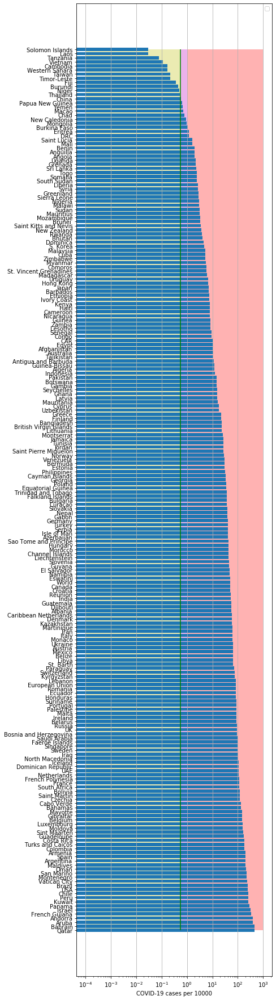

In [429]:
country, cases = get_cases(df,0.01)
country.values, cases.values
stat_picture(country.values, cases.values, high=35, picname="pictures/coronage0.png")

No handles with labels found to put in legend.
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:815: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


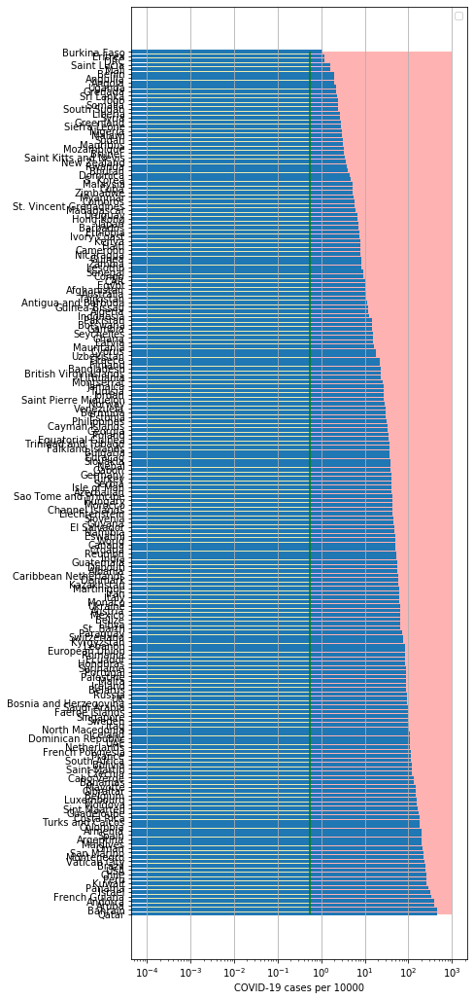

In [430]:
country, cases = get_cases(df,100.0)
stat_picture(country.values, cases.values, high=20, picname="pictures/coronage1.png")

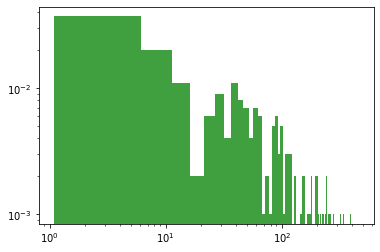

In [431]:
n, bins, patches = plt.hist(cases, 90, density=True,facecolor='g', alpha=0.75)
plt.yscale("log")
plt.xscale("log")

In [432]:
dfSP = read_df(pd.DataFrame(),"SP")
dfGB = read_df(pd.DataFrame(),"GB")
dfIT = read_df(pd.DataFrame(),"IT")
dfLT = read_df(pd.DataFrame(),"LT")
dfUkr = read_df(pd.DataFrame(),"Ukr")
dfUS = read_df(pd.DataFrame(),"US")
dfCN = read_df(pd.DataFrame(),"CN")
dfFR = read_df(pd.DataFrame(),"FR")
dfKR = read_df(pd.DataFrame(),"KR")
dfW = read_df(pd.DataFrame(),"World")
dfDK = read_df(pd.DataFrame(),"DK")
dfNG = read_df(pd.DataFrame(),"NG")
dfGR = read_df(pd.DataFrame(),"GR")
dfES = read_df(pd.DataFrame(),"ES")
dfSW = read_df(pd.DataFrame(),"SW")
dfPL = read_df(pd.DataFrame(),"PL")
dfIS = read_df(pd.DataFrame(),"IS")
dfUR = read_df(pd.DataFrame(),"Ukr")
dfSZ = read_df(pd.DataFrame(),"SZ")
dfIN = read_df(pd.DataFrame(),"IN")
#dfKRA = read_df(pd.DataFrame(),"KRA")
dfRS = read_df(pd.DataFrame(),"RS")
dfJP = read_df(pd.DataFrame(),"JP")
dfNL = read_df(pd.DataFrame(),"NL")
dfAT = read_df(pd.DataFrame(),"AT")
dfBG = read_df(pd.DataFrame(),"BG")
dfSG = read_df(pd.DataFrame(),"SG")
dfLV = read_df(pd.DataFrame(),"LV")
dfCA = read_df(pd.DataFrame(),"CA")
dfPT = read_df(pd.DataFrame(),"PT")
dfTR = read_df(pd.DataFrame(),"TR")
dfBZ = read_df(pd.DataFrame(),"BZ")
dfAS = read_df(pd.DataFrame(),"AS")
dfML = read_df(pd.DataFrame(),"ML")
dfZL = read_df(pd.DataFrame(),"ZL")
dfBR = read_df(pd.DataFrame(),"BR")
dfIR = read_df(pd.DataFrame(),"IR")
dfCL = read_df(pd.DataFrame(),"CL")
dfCH = read_df(pd.DataFrame(),"CH")
dfRM = read_df(pd.DataFrame(),"RM")
dfFI = read_df(pd.DataFrame(),"FI")
dfID = read_df(pd.DataFrame(),"ID")
dfED = read_df(pd.DataFrame(),"ED")
dfPH = read_df(pd.DataFrame(),"PH")
#dfPK = read_df(pd.DataFrame(),"PK")
dfLX = read_df(pd.DataFrame(),"LX")
dfTH = read_df(pd.DataFrame(),"TH")
dfIE = read_df(pd.DataFrame(),"IE")
dfMX = read_df(pd.DataFrame(),"MX")
dfPM = read_df(pd.DataFrame(),"PM")
dfPU = read_df(pd.DataFrame(),"PU")
dfSB = read_df(pd.DataFrame(),"SB")
dfAG = read_df(pd.DataFrame(),"AG")
dfCT = read_df(pd.DataFrame(),"CT")
dfEG = read_df(pd.DataFrame(),"EG")
dfSV = read_df(pd.DataFrame(),"SV")
dfMR = read_df(pd.DataFrame(),"MR")
dfIQ = read_df(pd.DataFrame(),"IQ")
dfIC = read_df(pd.DataFrame(),"IC")
dfQR = read_df(pd.DataFrame(),"QR")
dfCB = read_df(pd.DataFrame(),"CB")
dfBL = read_df(pd.DataFrame(),"BL")
dfAG = read_df(pd.DataFrame(),"AR")
dfEU = read_df(pd.DataFrame(),"EU")
dfMT = read_df(pd.DataFrame(),"MT")
dfCP = read_df(pd.DataFrame(),"CP")

SP
           date   cases  active    death
237 2020-10-09  890367       0  32929.0
238 2020-10-10  899557       0  32929.0
239 2020-10-11  908842       0  32929.0
240 2020-10-12  918223       0  33124.0
241 2020-10-13  925341       0  33204.0
GB
           date   cases  active    death
226 2020-10-09  575679       0  42679.0
227 2020-10-10  590844       0  42760.0
228 2020-10-11  603716       0  42825.0
229 2020-10-12  617688       0  42875.0
230 2020-10-13  634920       0  43018.0
IT
           date   cases  active    death
229 2020-10-09  343770   70110  36111.0
230 2020-10-10  349494   74829  36140.0
231 2020-10-11  354950   79075  36166.0
232 2020-10-12  359569   82764  36205.0
233 2020-10-13  365467   87193  36246.0
LT
           date   cases  active  death     tests
214 2020-10-09  5963.0    3109  103.0  838501.0
215 2020-10-10  6122.0    3220  103.0  842423.0
216 2020-10-11  6248.0    3352  103.0  844742.0
217 2020-10-12  6366.0    3418  106.0  852008.0
218 2020-10-13  6366.0  

228 2020-10-13  84524.0    5821  906.0
IR
           date    cases  active   death
223 2020-10-09  40703.0   15518  1821.0
224 2020-10-10  41714.0   16526  1824.0
225 2020-10-11  42528.0   17338  1826.0
226 2020-10-12  43351.0   18160  1827.0
227 2020-10-13  44159.0   18965  1830.0
CL
           date   cases  active    death
220 2020-10-09  477769   14252  13220.0
221 2020-10-10  479595   14269  13272.0
222 2020-10-11  481371   14701  13318.0
223 2020-10-12  482888   15025  13379.0
224 2020-10-13  484280   14385  13396.0
CH
           date     cases  active   death
222 2020-10-09  109374.0   55296   905.0
223 2020-10-10  114005.0   58148   948.0
224 2020-10-11  117110.0   61143   987.0
225 2020-10-12  121421.0   62170  1051.0
226 2020-10-13  129747.0   68740  1106.0
RM
           date     cases   active   death
226 2020-10-09  148886.0  28795.0  5299.0
227 2020-10-10  152403.0  30417.0  5358.0
228 2020-10-11  155283.0  31930.0  5411.0
229 2020-10-12  157352.0  32973.0  5467.0
230 2020-

In [433]:
dfBL = dfBL.fillna(0)
dfRM = dfRM.fillna(0)
dfSV = dfSV.fillna(0)
dfCT = dfCT.fillna(0)
#dfAR = dfAR.fillna(0)
dfSB = dfSB.fillna(0)
dfCP = dfCP.fillna(0)
dfID = dfID.fillna(0)
dfAG = dfAG.fillna(0)
dfMX = dfMX.fillna(0)
dfPU = dfPU.fillna(0)
dfIQ = dfIQ.fillna(0)
dfIE = dfIE.fillna(0)
dfPH = dfPH.fillna(0)
dfTH = dfTH.fillna(0)
dfMR = dfMR.fillna(0)
dfCP = dfCP.fillna(0)

In [434]:
from sklearn.linear_model import LinearRegression
populationSp = dfp[dfp['Country (or dependency)']=='Spain'].Population.tolist()[0]
y = np.log(dfSP['cases'].values*10000./populationSp)
x = np.array(range(dfSP['cases'].size)).reshape((-1, 1))
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)


coefficient of determination: 0.5387798769717173
intercept: 1.447336550974759
slope: [0.01814834]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:6: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  


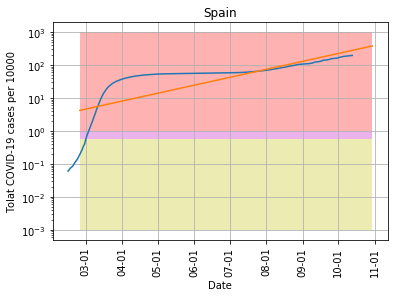

In [435]:
from matplotlib.dates import DateFormatter
#fig, ax = plt.subplots(figsize=(12, 12))
yc = 0.56
plt.plot(dfSP['date'].values,dfSP['cases']*10000./populationSp)
date_form = DateFormatter("%m-%d")
ax = plt.axes()
ax.xaxis.set_major_formatter(date_form)
ix = pd.date_range('2020-02-25', '2020-10-30', freq='D')
ss = pd.DataFrame({'date': ix})
y_pred = np.exp(model.intercept_ + model.coef_ * range(len(ix)))
ax.plot(ss['date'].values,y_pred)
plt.xticks(rotation=90)
plt.title('Spain')
plt.ylabel('Tolat COVID-19 cases per 10000')
ax.fill_between(ss['date'].values, 1,1000, facecolor='red', alpha=0.3)
ax.fill_between(ss['date'].values, yc,1, facecolor='m', alpha=0.3)
ax.fill_between(ss['date'].values, 1e-3,yc, facecolor='y', alpha=0.3)
plt.xlabel('Date')
plt.yscale('log')
plt.yscale('log')
plt.grid()
plt.savefig("pictures/coronaSP.png")
plt.show()

In [436]:
populationUK = dfp[dfp['Country (or dependency)']=='United Kingdom'].Population.tolist()[0]
model1, r_sql, dfGB1 = linreg(dfGB,populationUK)
print('coefficient of determination:', r_sql)
print('intercept:', model1.intercept_)
print('slope:', model1.coef_)

coefficient of determination: 0.530530981941076
intercept: -0.2304121109950623
slope: [0.02556631]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:51: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


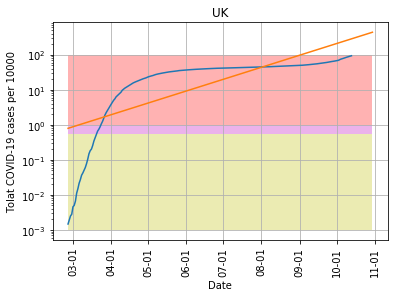

In [437]:
ss1t = plotpred(dfGB1,populationUK,'2020-02-26', '2020-10-30', "pictures/coronaGB.png", model1, 'UK',100)

In [438]:
populationIT = dfp[dfp['Country (or dependency)']=='Italy'].Population.tolist()[0]
coefIT = 5.01378751-0.3
yy1 = np.log(coefIT-np.log(dfIT['cases'].values*10000./populationIT))
xx1 = np.array(range(dfIT['cases'].size)).reshape((-1, 1))
model11 = LinearRegression().fit(xx1, yy1)
r_sq1 = model11.score(xx1, yy1)
print('coefficient of determination:', r_sq1)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.6652903758615394
intercept: 0.998640994060754
slope: [-0.00656693]


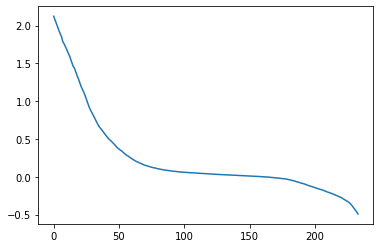

In [439]:
plt.plot(xx1,yy1)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:5: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  """


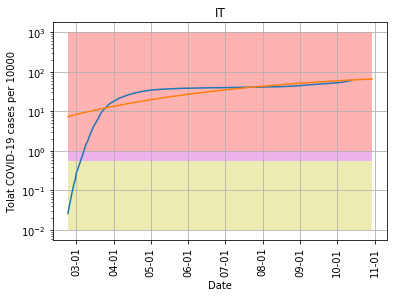

In [440]:
from matplotlib.dates import DateFormatter
#fig, ax = plt.subplots(figsize=(12, 12))
plt.plot(dfIT['date'].values,dfIT['cases']*10000./populationIT)
date_form = DateFormatter("%m-%d")
ax = plt.axes()
ax.xaxis.set_major_formatter(date_form)
ix11 = pd.date_range('2020-02-23', '2020-10-30', freq='D')
ss11 = pd.DataFrame({'date': ix11})
y_pred11 = np.exp(coefIT-np.exp(model11.intercept_ + model11.coef_ * range(len(ix11))))
ax.plot(ss11['date'].values,y_pred11)
plt.xticks(rotation=90)
plt.title('IT')
plt.ylabel('Tolat COVID-19 cases per 10000')
ax.fill_between(ss11['date'].values, 1,1000, facecolor='red', alpha=0.3)
ax.fill_between(ss11['date'].values, yc,1, facecolor='m', alpha=0.3)
ax.fill_between(ss11['date'].values, 1e-2,yc, facecolor='y', alpha=0.3)
plt.xlabel('Date')
plt.yscale('log')
#plt.yscale('log')
plt.grid()
plt.savefig("pictures/coronaIT.png")
plt.show()

In [441]:
cs=y_pred11[-1]/10000.*populationIT

In [442]:
cs

398437.2422385587

In [443]:
populationLT = dfp[dfp['Country (or dependency)']=='Lithuania'].Population.tolist()[0]
model1, r_sql, dfLT1 = linreg(dfLT[1:],populationLT)
print('coefficient of determination:', r_sql)
print('intercept:', model1.intercept_)
print('slope:', model1.coef_)

coefficient of determination: 0.5133898565949744
intercept: -0.011057115038576315
slope: [0.01529677]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:51: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


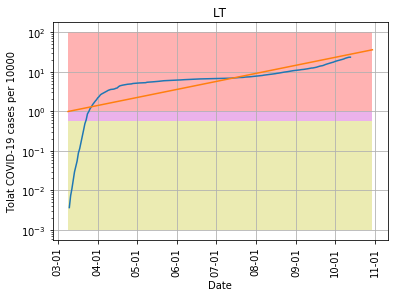

In [444]:
populationLT = dfp[dfp['Country (or dependency)']=='Lithuania'].Population.tolist()[0]
ss1t = plotpred(dfLT[1:],populationLT,'2020-03-09', '2020-10-30', "pictures/coronaLT.png", model1, 'LT',100)

In [445]:
populationUKr = dfp[dfp['Country (or dependency)']=='Ukraine'].Population.tolist()[0]
model11, r_sql, dfUkr1 = linreg(dfUkr, populationUKr)
print('coefficient of determination:', r_sql)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.7181571747611081
intercept: -2.2456584232631642
slope: [0.03434884]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:51: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


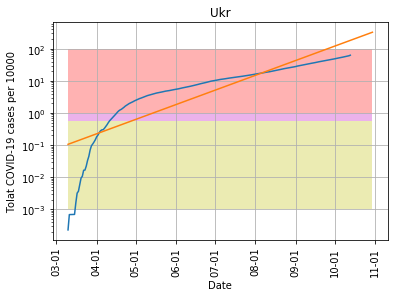

In [446]:
ss1t1 = plotpred(dfUkr1,populationUKr,'2020-03-10', '2020-10-30', "pictures/coronaUkr.png", model11, 'Ukr',100)

No handles with labels found to put in legend.
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:16: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  app.launch_new_instance()


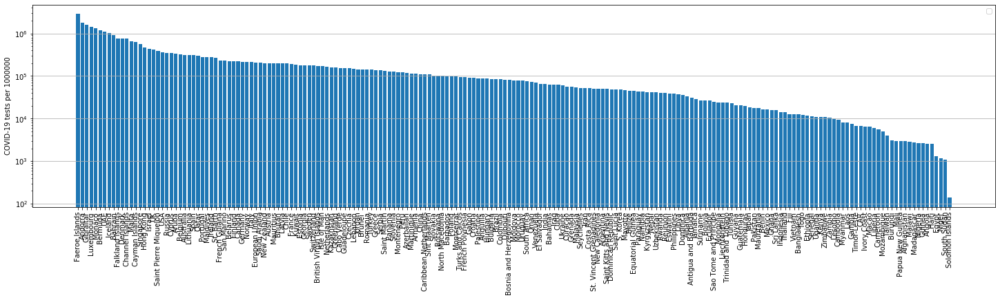

In [447]:
# Prepare the data
dfTs = dfAll
dfTs = dfTs.sort_values(by=['Testsper1Mpop'], ascending=False)
dfTs = dfTs[dfTs['Testsper1Mpop']>0]
x = dfTs['Country']
y = dfTs['Testsper1Mpop']
fig = plt.figure( figsize=(25, 6))
fig.subplots_adjust(bottom=0.2)
# Plot the data
plt.bar(x, y)

plt.xticks(rotation=90)
plt.ylabel('COVID-19 tests per 1000000')
# Add a legend
plt.legend()
ax = plt.axes() 
#ax.fill_between(x, 1,10, facecolor='red', alpha=0.3)
yc = 0.56
#ax.fill_between(x, yc,1, facecolor='m', alpha=0.3)
#ax.fill_between(x, 1e-4,yc, facecolor='y', alpha=0.3)
#plt.hlines(yc, 0, len(df)-1, colors='g', linestyles='solid')
#plt.ylim([1e-4,10])
ax.yaxis.grid() # horizontal lines
#ax.xaxis.grid() # vertical lines
plt.yscale("log")
# Show the plot
plt.savefig("pictures/coronaTests.png")
plt.show()

In [448]:
populationUS= dfp[dfp['Country (or dependency)']=='United States'].Population.tolist()[0]
model11, r_sql, dfUS1 = linreg(dfUS, populationUS)
print('coefficient of determination:', r_sql)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.6192605554177583
intercept: 0.18823434498676095
slope: [0.02984635]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:51: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


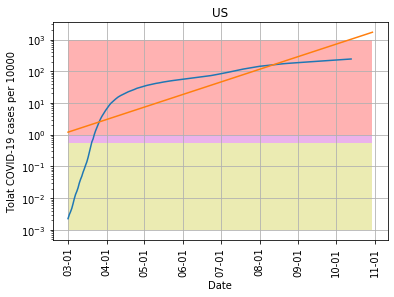

In [449]:
ss1t = plotpred(dfUS1,populationUS,'2020-03-01', '2020-10-30', "pictures/coronaUS.png", model11, 'US',1000)

In [450]:
dfAll[dfAll["Country"]=="Latvia"]
dfAll.fillna(0, inplace=True)

North America
            Country         0
230  European Union  0.041841


Text(0.5, 1.0, 'Death rate')

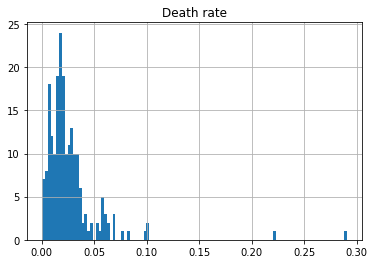

In [451]:
dfT1 = dfAll#[dfAll["Total Cases"]>0]
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
print(dfTT.Country[0])
print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=[0], ascending=False)
hist = dfTTh[dfTTh[0]>0].hist(bins=9*12)
plt.title("Death rate")
#plt.xlim([0,0.15])

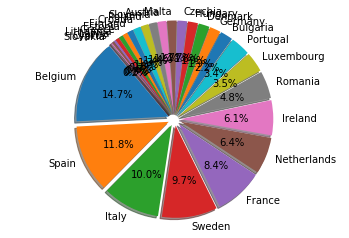

In [452]:
cLst = countriesEU
dfT1 = dfAll[dfAll['Country'].isin(cLst)]
#dfD1 = dfAll#[dfAll["Total Cases"]>0]
dfTT = pd.concat([dfT1["Country"],dfT1["Deathsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT["Deathsper1Mpop"]>0]
#print(dfDD.Country[0])
#print(dfDD[dfDD.Country=="Latvia"])
dfTTh = dfTT.sort_values(by=["Deathsper1Mpop"], ascending=False)
dfTTh.rename(columns={0: "DeathRate"})
#hist = dfTTh.hist(bins=9*16)
#plt.yscale("log")
#plt.xscale("log")
#plt.xlim([0,200])
#plt.show()
#import matplotlib.pyplot as plt

labels = dfTTh.Country.tolist()#'apple', 'banana', 'cherry', 'durian', 'elderberries', 'figs', 'grapes'
sizes = dfTTh.Deathsper1Mpop.values#[32, 20, 15, 10, 10, 8, 5]

p = plt.pie(sizes, labels=labels, explode=(.07,)*len(sizes), autopct='%1.1f%%', startangle=130, shadow=True)
plt.axis('equal')

            
plt.show()

In [453]:
dfTTh.head()

,Country,Deathsper1Mpop
34,Belgium,883.0
11,Spain,710.0
23,Italy,600.0
50,Sweden,583.0
16,France,504.0


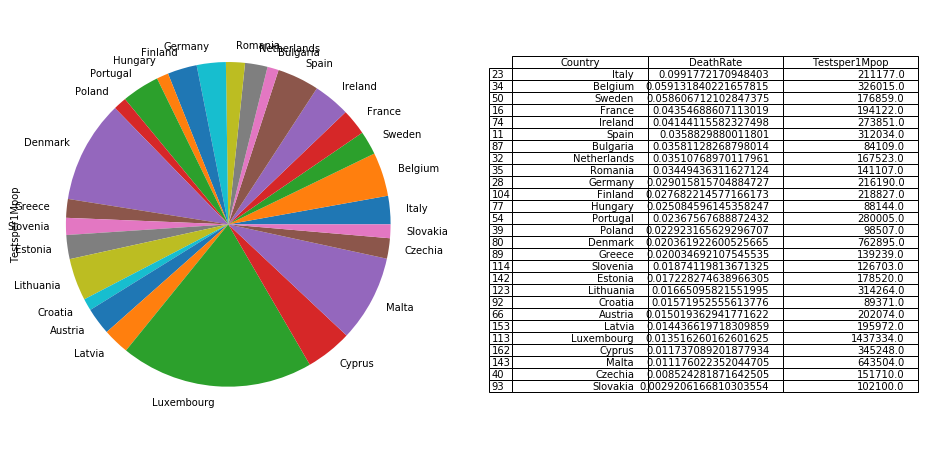

In [454]:
dfT1 = dfAll[dfAll['Country'].isin(cLst)]
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"],dfT1["Testsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
#print(dfTT.Country[0])
#print(dfTT[dfTT.Country=="European Union"])
#dfTTh = dfTT.sort_values(by=["Testsper1Mpop"], ascending=False)
dfTTh = dfTT.sort_values(by=[0], ascending=False)
dfTTh = dfTTh.rename(columns={0: "DeathRate"})
#import matplotlib.pyplot as plt
from pandas.plotting import table
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfTTh.plot.pie(y=["Testsper1Mpop"],ax=ax1,labels=dfTTh['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfTTh, loc='center')
tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.savefig("pictures/DeathRate2.png")
plt.show()

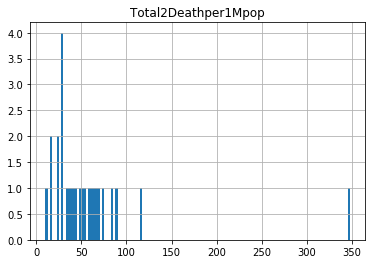

In [455]:
dfD1 = dfAll[dfAll['Country'].isin(cLst)]#[dfAll["Total Cases"]>0]
dfDD = pd.concat([dfD1["Country"],dfD1["TotCasesper1Mpop"],dfD1["Deathsper1Mpop"]], axis=1)
dfDD2 = pd.concat([dfD1["Country"],dfD1["TotCasesper1Mpop"]/dfD1["Testsper1Mpop"]], axis=1)
dfDD = dfDD[dfDD["Deathsper1Mpop"]>0]
#print(dfDD.Country[0])
#print(dfDD[dfDD.Country=="Latvia"])
dfDD1 = pd.concat([dfDD["Country"],dfDD["TotCasesper1Mpop"]/dfDD["Deathsper1Mpop"]], axis=1)
dfDDh = dfDD1.sort_values(by=[0], ascending=False)
dfDDh=dfDDh.rename(columns={0:"Total2Deathper1Mpop"})
dfDDh2=dfDD2.rename(columns={0:"Cases2Testsper1Mpop"})
hist = dfDDh.hist(bins=9*15)
#plt.yscale("log")
#plt.xscale("log")
#plt.xlim([0,200])

In [456]:
dfDD.head()

,Country,TotCasesper1Mpop,Deathsper1Mpop
11,Spain,19789.0,710.0
16,France,11582.0,504.0
23,Italy,6047.0,600.0
28,Germany,4003.0,116.0
32,Netherlands,11016.0,387.0


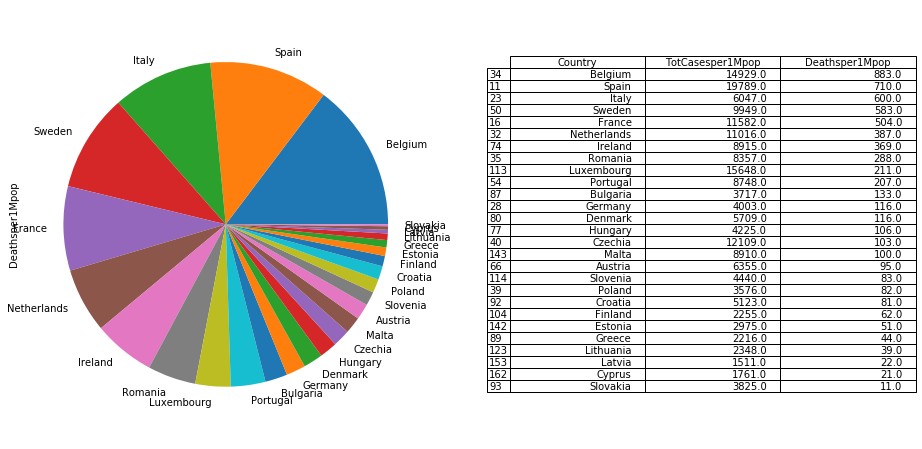

In [457]:
from pandas.plotting import table
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfDD = dfDD.sort_values(by=['Deathsper1Mpop'], ascending=False)
dfDD.plot.pie(y='Deathsper1Mpop',ax=ax1,labels=dfDD['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfDD, loc='center')
tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.savefig("pictures/DeathRate1.png")
plt.show()

In [458]:
dfAll.head()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,0.0,North America,9704894,4752.0,328709.0,484.0,6415160.0,"+4,185",2961025,18404.0,0.0,0.0,0.0,0.0,0,North America,\n,0,0
1,0.0,Asia,12026077,6100.0,216161.0,34.0,10369745.0,"+6,458",1440171,21014.0,0.0,0.0,0.0,0.0,0,Asia,\n,0,0
2,0.0,South America,8738070,227.0,273328.0,25.0,7645361.0,560,819381,17597.0,0.0,0.0,0.0,0.0,0,South America,\n,0,0
3,0.0,Europe,6269107,13909.0,233167.0,167.0,3071296.0,"+2,720",2964644,11174.0,0.0,0.0,0.0,0.0,0,Europe,\n,0,0
4,0.0,Africa,1601181,0.0,38633.0,0.0,1323354.0,0,239194,1771.0,0.0,0.0,0.0,0.0,0,Africa,\n,0,0


In [459]:
dfDDh2.head()

,Country,Cases2Testsper1Mpop
11,Spain,0.063419
16,France,0.059664
23,Italy,0.028635
28,Germany,0.018516
32,Netherlands,0.065758


In [460]:
dfDDh2 = dfDDh2.sort_values(by=["Cases2Testsper1Mpop"], ascending=False)

     Country  Cases2Testsper1Mpop
     Czechia             0.079817
 Netherlands             0.065758
       Spain             0.063419
      France             0.059664
     Romania             0.059225
     Croatia             0.057323
      Sweden             0.056254
     Hungary             0.047933
     Belgium             0.045792
    Bulgaria             0.044193
    Slovakia             0.037463
      Poland             0.036302
    Slovenia             0.035043
     Ireland             0.032554
     Austria             0.031449
    Portugal             0.031242
       Italy             0.028635
     Germany             0.018516
     Estonia             0.016665
      Greece             0.015915
       Malta             0.013846
  Luxembourg             0.010887
     Finland             0.010305
      Latvia             0.007710
     Denmark             0.007483
   Lithuania             0.007471
      Cyprus             0.005101


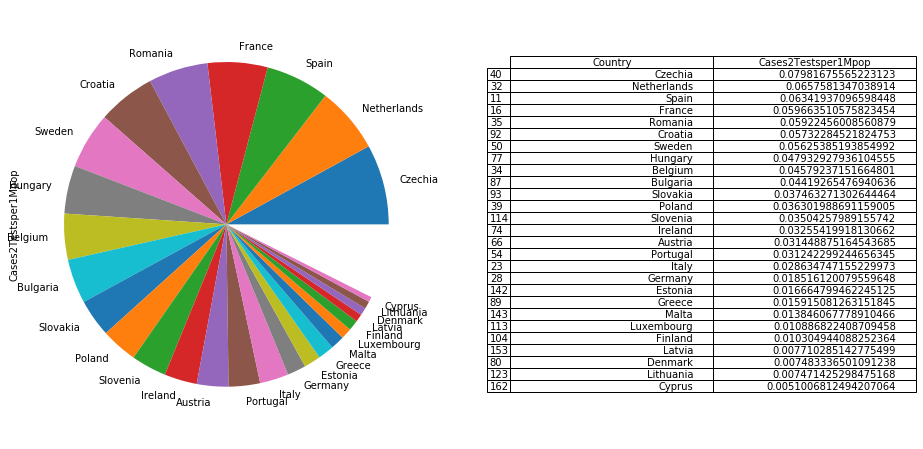

In [461]:
print (dfDDh2[dfDDh2["Cases2Testsper1Mpop"]<1000].to_string(index=False))
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfDDh2.plot.pie(y='Cases2Testsper1Mpop',ax=ax1,labels=dfDDh2['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfDDh2, loc='center')
#tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.show()

In [462]:
dfT1 = dfAll
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"],dfT1["Testsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
#print(dfTT.Country[0])
#print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=[0], ascending=False)
dfTTh = dfTTh.rename(columns={0: "DeathRate"})
dfTT[dfTT[0]>=0.000001].sort_values(by=[0], ascending=True)
#dfTT[dfTT.Country=="France"]

,Country,0,Testsper1Mpop
65,Singapore,0.000484,561151.0
177,Curaçao,0.001616,57010.0
41,Qatar,0.001713,300436.0
180,Burundi,0.001890,3130.0
135,Sri Lanka,0.002580,15968.0
...,...,...,...
23,Italy,0.099177,211177.0
218,Western Sahara,0.100000,0.0
15,Mexico,0.102285,16312.0
219,MS Zaandam,0.222222,0.0


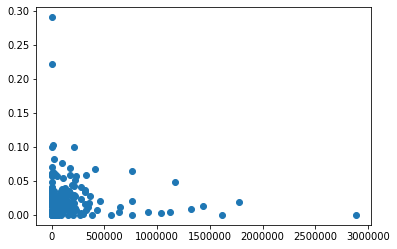

In [463]:
plt.plot(dfTTh["Testsper1Mpop"],dfTTh['DeathRate'],'o')

/usr/local/lib/python3.7/site-packages/matplotlib/patches.py:715: RuntimeWarning: invalid value encountered in double_scalars
  self._x1 = self._x0 + self._width
/usr/local/lib/python3.7/site-packages/matplotlib/projections/polar.py:55: RuntimeWarning: invalid value encountered in greater_equal
  r = np.where(r >= 0, r, np.nan)


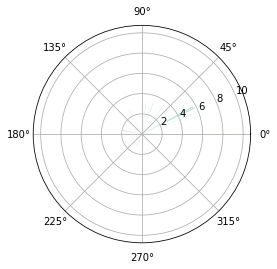

In [464]:
import numpy as np
import matplotlib.pyplot as plt


# Fixing random state for reproducibility
np.random.seed(19680801)

# Compute pie slices
N = len(dfTTh)
theta = np.linspace(0.0, 2*np.pi, N, endpoint=False)
radii = 100 * dfTTh['DeathRate']
width = 2*np.pi* 3.5/ dfTTh["Testsper1Mpop"]
colors = plt.cm.viridis(radii / 10.)

ax = plt.subplot(111, projection='polar')
ax.bar(theta, radii, width=width, bottom=0.0, color=colors, alpha=0.35)

plt.show()

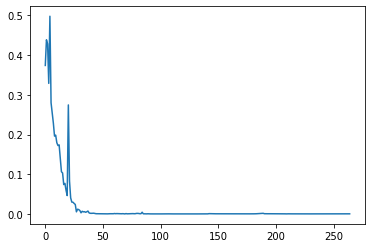

In [465]:
plt.plot(range(len(dfCN["cases"].values)-1),np.diff(np.log(dfCN["cases"].values)))

In [466]:
#np.diff(np.log(dfCN["cases"].values))

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: divide by zero encountered in log
  """Entry point for launching an IPython kernel.


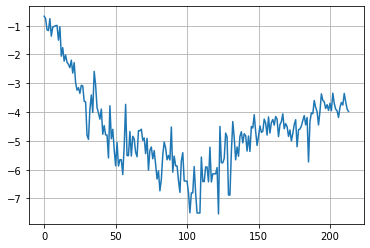

In [467]:
plt.plot(range(len(dfLT["cases"].values[3:])-1),np.log(np.diff(np.log(dfLT["cases"].values[3:]))))
plt.grid()

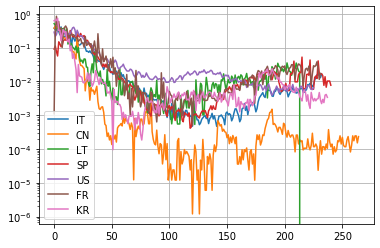

In [468]:
plt.plot(range(len(dfIT["cases"].values)-1),np.diff(np.log(dfIT["cases"].values))[:],label='IT')
plt.plot(range(len(dfCN["cases"].values)-1),np.diff(np.log(dfCN["cases"].values)),label='CN')
plt.plot(range(len(dfLT["cases"].values)-4),np.diff(np.log(dfLT["cases"].values))[3:],label='LT')
plt.plot(range(len(dfSP["cases"].values)-1),np.diff(np.log(dfSP["cases"].values)),label='SP')
plt.plot(range(len(dfUS["cases"].values)-1),np.diff(np.log(dfUS["cases"].values)),label='US')
plt.plot(range(len(dfFR["cases"].values)-10),np.diff(np.log(dfFR["cases"].values))[9:],label='FR')
plt.plot(range(len(dfKR["cases"].values)-4),np.diff(np.log(dfKR["cases"].values))[3:],label='KR')
plt.yscale('log')
plt.grid()
plt.legend()
plt.show()

226 226
coefficient of determination: 0.7006805040410645
intercept: -12.904625692384919
slope: [-0.04473518]


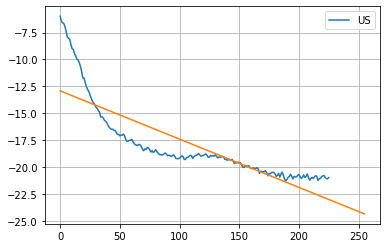

In [469]:
y = np.log(np.diff(dfUS["cases"].values)[:]/dfUS["cases"].values[1:]**2)
x = np.array(range(len(dfUS["cases"].values)-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='US')
y_pred11 = model.intercept_ + model.coef_ * range(len(x)+30) 
plt.plot(range(len(x)+30),y_pred11)
plt.grid()
plt.legend()
plt.savefig("pictures/logdiffUS.png")
plt.show()

In [470]:
#np.diff(dfIT["cases"])

233 233
coefficient of determination: 0.44067073001704093
intercept: -13.755301338678365
slope: [-0.02824541]


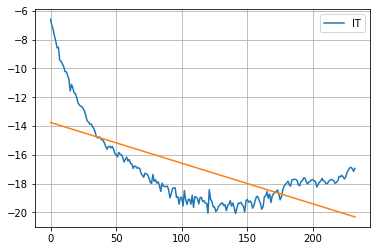

In [471]:
y = np.log(np.diff(dfIT["cases"].values)[:]/dfIT["cases"].values[1:]**2)
x = np.array(range(len(dfIT["cases"].values)-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='IT')
y_pred12 = model.intercept_ + model.coef_ * range(len(x)) 
plt.plot(x,y_pred12)
plt.grid()
plt.legend()
plt.show()

In [472]:
#model11.coef_

In [473]:
#np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)

215 215
coefficient of determination: 0.877942196737611
intercept: -16.549258204748
slope: [-0.03046072]


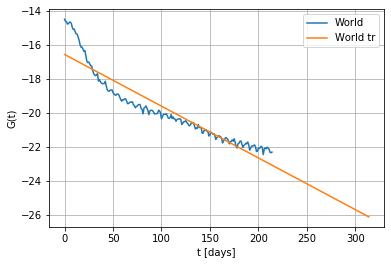

In [474]:
y = np.log(np.diff(dfW["cases"].values)[50:]/dfW["cases"].values[51:]**2)
x = np.array(range(len(dfW["cases"].values[50:])-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='World')
y_pred11 = model.intercept_ + model.coef_ * range(len(x)+100)
plt.plot(range(len(x)+100),y_pred11,label='World tr')
plt.legend()
plt.xlabel('t [days]')
plt.ylabel('G(t)')
plt.grid()
plt.savefig("pictures/logdifflogcoronaW.png")

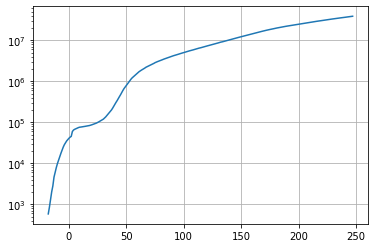

In [475]:
waveform_1 = dfW['cases'].values
waveform_A = dfW['active'].values
t = np.arange(-18,len(waveform_1)-18)
plt.plot(t, waveform_1) 
plt.yscale("log")
plt.grid()
plt.show()

In [476]:
dfW['cases'].values

array([     580,      845,     1317,     2015,     2800,     4581,
           6058,     7813,     9823,    11950,    14553,    17391,
          20630,    24545,    28266,    31439,    34876,    37552,
          40553,    43099,    45134,    59287,    64438,    67100,
          69197,    71329,    73332,    75184,    75700,    76677,
          77673,    78651,    79205,    80087,    80828,    81820,
          83112,    84615,    86604,    88585,    90443,    93016,
          95314,    98425,   102050,   106099,   109991,   114381,
         118948,   126214,   134576,   145483,   156653,   169593,
         182490,   198238,   218822,   244933,   275597,   305036,
         337489,   378860,   422629,   471035,   531864,   596366,
         663079,   723279,   784738,   858355,   936237,  1016330,
        1117928,  1203058,  1274578,  1347566,  1432869,  1519195,
        1605277,  1700004,  1780713,  1853505,  1925330,  2000065,
        2084633,  2183942,  2252370,  2332650,  2407467,  2482

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: overflow encountered in exp
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in true_divide
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


[ 9.76698973e+07  1.65748417e-01 -1.13672790e+02  5.05117516e-02]


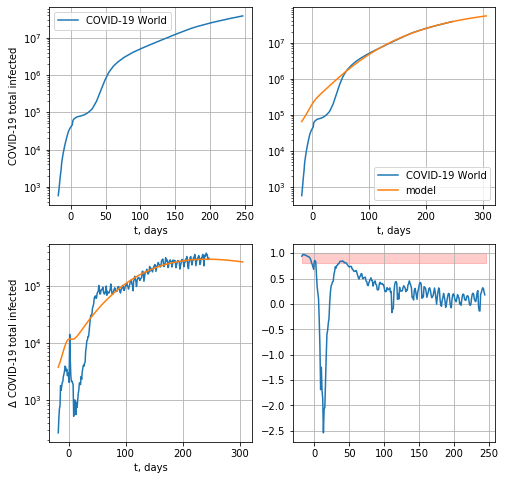

264680.53636985586


In [477]:
def model(t, coeffs):
    coeffsCN = [ 8.08213515e+04,  2.21924344e-01, -7.12649833e-01]
    #coeffsCN = [2.06174475e+06, 1.67277852e-01, 5.36255447e+01]
    return coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3]) + coeffsCN[0]/(1 + np.exp( - coeffsCN[1] * (t - coeffsCN[2])))

x0 = np.array([2.06174475e+06, 1.67277852e-01, 5.36255447e+01, 0.9 ], dtype=float)
#x0 = np.array([8.08757112e+04,  2.24114193e-01, -6.94900467e-01 ], dtype=float)
def residuals(coeffs, y, t):
    return y - model(t, coeffs)
from scipy.optimize import leastsq
x, flag = leastsq(residuals, x0, args=(waveform_1, t))
print(x)
tt = np.arange(-18,len(waveform_1)-18+59)
fig, ((ax3,ax1),(ax2,ax4)) = plt.subplots(2,2,figsize=(8,8), sharex=False, sharey=False)
ax3.plot(t, waveform_1) 
ax3.legend(['COVID-19 World']) 
ax3.set_xlabel('t, days')
ax3.set_yscale("log")
ax3.set_ylabel(r'COVID-19 total infected')
ax3.grid()
ax1.plot(t, waveform_1, tt, model(tt, x)) 
ax1.legend(['COVID-19 World', 'model']) 
ax1.set_xlabel('t, days')
ax1.set_yscale("log")
ax1.grid()
ax2.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(model(tt, x)))
ax2.set_ylabel(r'$\Delta$ COVID-19 total infected')
ax2.set_yscale("log")
ax2.grid()
ax2.set_xlabel('t, days')
z = np.diff(moving_average(waveform_A, n=3) )/np.diff(moving_average(waveform_1, n=3))
ax4.plot(t[:-3],z)
#ax4.axhline(y=2.2587741081036339/2, color='r')
ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
#ax4.set_yscale("log")
ax4.grid()
plt.savefig("pictures/covidworld.png")

plt.show()
print(np.std(residuals(x, waveform_1, t)))
#expPopWorld = x[0]
expPopWorld = 2.67152730e+06

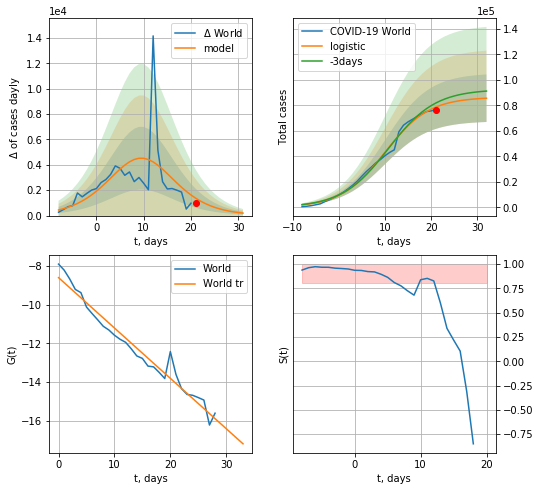

World data at: 2020-10-13
+3 day model MAPE: 0.04256770161128604
model: logistic
coeffs:  [8.64735804e+04 2.09600360e-01 9.98515269e+00]
rational stdev:  0.2178111789766563
forecast at the end of period: +11 days
	 deltaDaycases:  195
	 total cases:  85625 ± 18650
	 total death:  2434 ± 1590
trend coefficient of determination: 0.960820
 intercept: -8.598458
 slope: -0.260482


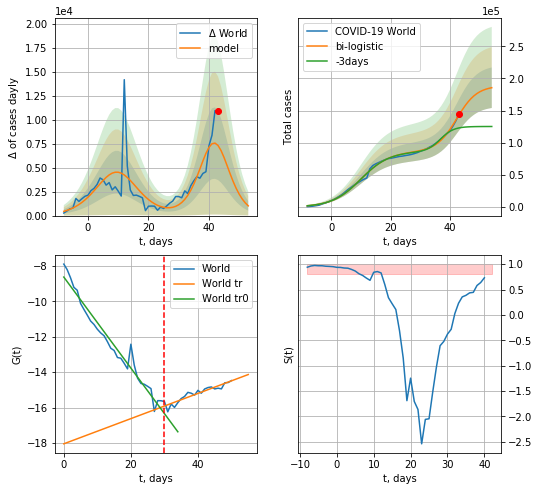

World data at: 2020-10-13
+3 day model MAPE: 0.21572977405755475
model: bi-logistic
coeffs:  [1.02227620e+05 2.95650803e-01 4.22367007e+01] [8.64735804e+04 2.09600360e-01 9.98515269e+00]
rational stdev:  0.16992860967254475
forecast at the end of period: +11 days
	 deltaDaycases:  1013
	 total cases:  185630 ± 31544
	 total death:  5277 ± 2690
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend coefficient of determination: 0.868835
 intercept: -18.049568
 slope: 0.071157


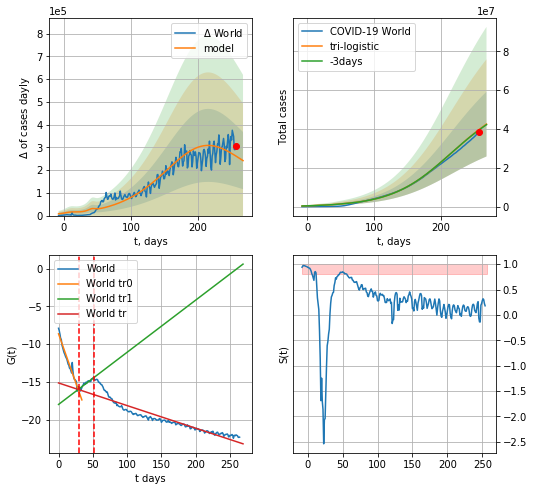

World data at: 2020-10-13
+3 day model MAPE: 0.006006450507100581
model: tri-logistic
coeffs:  [4.93156258e+07 2.32012054e-02 2.09581627e+02] [8.64735804e+04 2.09600360e-01 9.98515269e+00 1.02227620e+05
 2.95650803e-01 4.22367007e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
forecast rational stdev:  0.39242038456505923
forecast at the end of period: +11 days
	 deltaDaycases:  241675
	 total cases:  42530017 ± 16689645
	 total death:  1209143 ± 1423477
tri-logistic approximation splitting points: 30,52
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend1 coefficient of determination: 0.872494
 intercept: -17.970431
 slope: 0.068998
trend coefficient of determination: 0.879981
 intercept: -15.130615
 slope: -0.029920


In [478]:
vL = 30
T18 = 30
x = forecast("World",dfW[:vL],d1,7*T18-dT,1.0,False)
xx = forecast2("World",dfW[:52],d1,7*T18-dT,x,1.0,vL=vL)#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("World",dfW,d1,7*T18-dT, xx, shift=1.,addpred=True,xcoef=[.25,1.,1.5],vL=[vL,52])

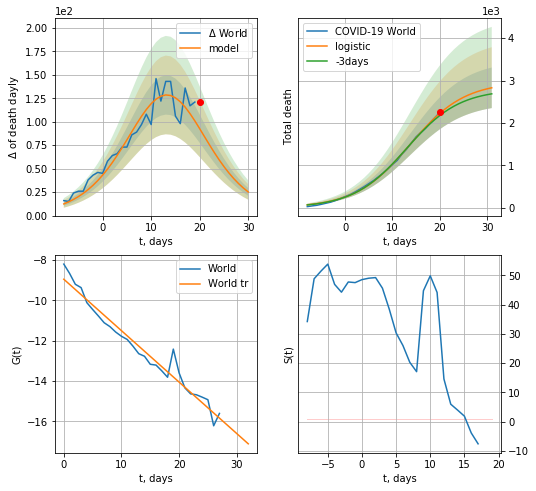

World data at: 2020-10-13
+3 day model MAPE: 0.027312195038559757
model: logistic
coeffs:  [2.96959017e+03 1.73350949e-01 1.36930068e+01]
rational stdev:  0.16928081921473714
forecast at the end of period: +11 days
	 total death:  2828 ± 478
trend coefficient of determination: 0.959176
 intercept: -8.958870
 slope: -0.254930


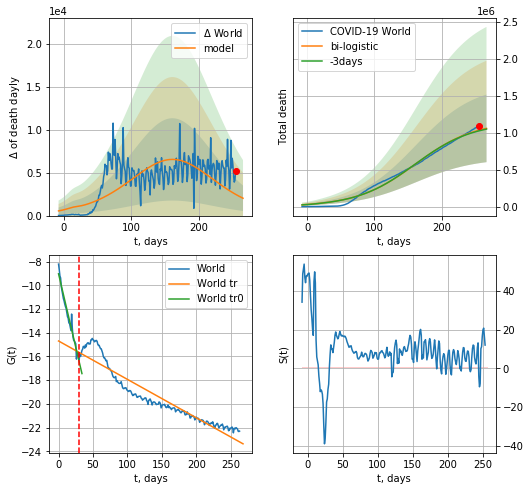

World data at: 2020-10-13
+3 day model MAPE: 0.008440272597709766
model: bi-logistic
coeffs:  [1.14992652e+06 2.27433306e-02 1.61632851e+02] [2.96959017e+03 1.73350949e-01 1.36930068e+01]
rational stdev:  0.4321286940002683
forecast at the end of period: +11 days
	 deltaDaydeath:  2019
	 total death:  1056937 ± 456733
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.960969
 intercept: -9.026339
 slope: -0.247583
trend coefficient of determination: 0.897143
 intercept: -14.693672
 slope: -0.032369


In [479]:
vL = 30
vL1=52
x = forecast("World",dfW[1:vL],d1,7*T18-dT,1.0,False,cases='death')
xx = forecast2("World",dfW[1:],d1,7*T18-dT,x,1.0,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,1.5]
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("World",dfW,d1,7*20-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,1.5],vL=[vL,vL1],cases='death')

In [480]:
#vL = 30
#x = forecast("World",dfW[:vL],d1,7*9-dT,1.0,False)
#xx = forecast2("World",dfW,d1,7*15-dT,x,1.0,addpred=True,xcoef=[3.,1.,1.7],vL=vL)
#trend(dfW,"W",10)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


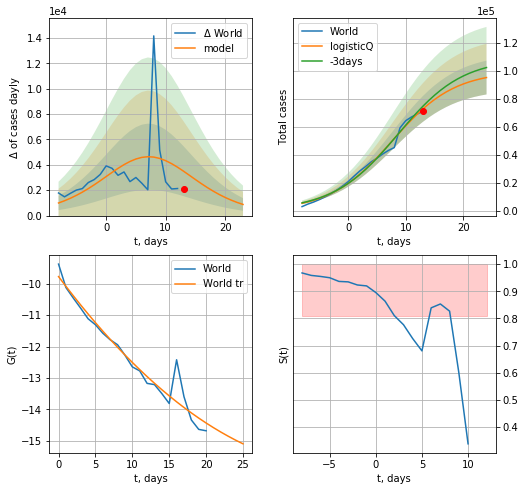

World data at: 2020-10-13
+3 day model MAPE: 0.031856
model: logisticQ
coeffs: [ 9.98643061e+04  1.79654926e-05  7.63889443e+00 -1.03374511e+04]
rational stdev: 0.126959
forecast at the end of period: +11 days
	 deltaDaycases: 878
	 total cases: 95329 ± 12102
	 total death: 2710 ± 1032
trend coefficient of determination: 0.944130
 intercept_: -9.771844228006898
 coeffs_: [ 0.         -0.31384117  0.00402719]


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


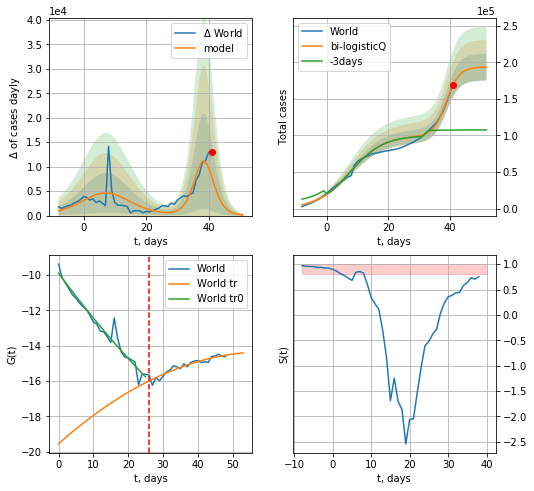

World data at: 2020-10-13
+3 day model MAPE: 0.635592
model: bi-logisticQ
coeffs: [ 9.37621522e+04  2.37764402e-05  3.89555041e+01 -2.00834102e+04]
rational stdev: 0.094698
forecast at the end of period: +11 days
	 deltaDaycases: 116
	 total cases: 193419 ± 18316
	 total death: 5498 ± 1561
bi-logisticQ approximation splitting point: 26
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend coefficient of determination: 0.893677
 intercept_: -19.558019139425994
 coeffs_: [ 0.          0.17538587 -0.00147405]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:435: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


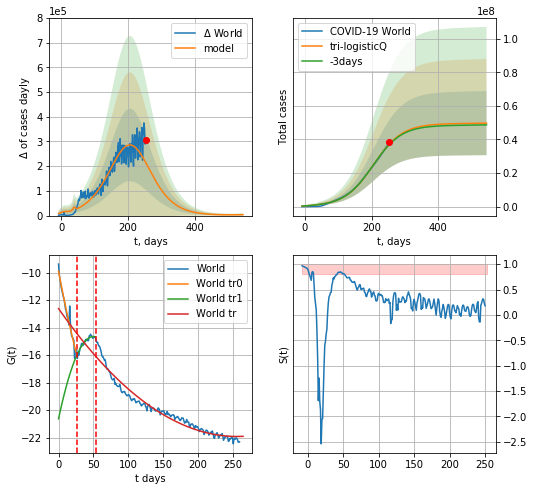

World data at: 2020-10-13
+3 day model MAPE: 0.007858
model: tri-logisticQ
coeffs: [ 4.92622980e+07  1.72804834e-07  2.05504468e+02 -1.34194494e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.383866
forecast at the end of period: +291 days
	 deltaDaycases: 3671
	 total cases: 49720538 ± 19086025
	 total death: 1413572 ± 1627866
tri-logisticQ approximation splitting points: 26,54
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend1 coefficient of determination: 0.900515
 intercept_: -20.622215746086294
 coeffs_: [ 0.          0.23801537 -0.00236922]
trend coefficient of determination: 0.958498
 intercept_: -12.608924349403972
 coeffs_: [ 0.         -0.07255983  0.0001415 ]


In [481]:
vL=30 - 4
vL1=59 - 5
koreaCoeffs = [  0.35416971,   0.02606324,   4.35859408,  19.30413219]
x = forecastRRR("World",dfW[4:vL],d1,7*T18-dT,1.0,False)
xx = forecast2RRR("World",dfW[4:vL1],d1,7*T18-dT,x,1.0,vL=vL)#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3RRR("World",dfW[4:],d1,7*70-dT, xx, shift=1.,addpred=True,xcoef=koreaCoeffs,vL=[vL,vL1])

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


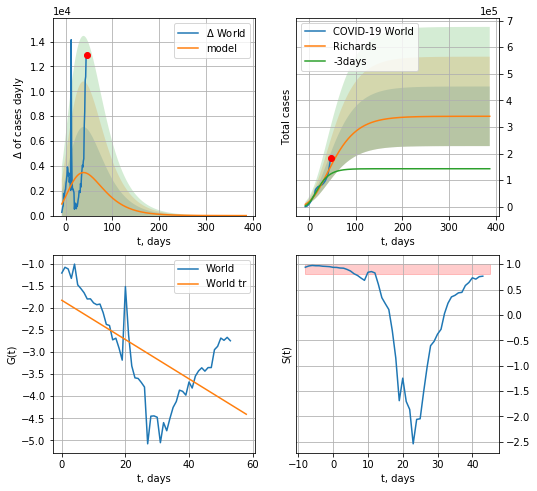

World data at: 2020-10-13
+3 day model MAPE: 0.241623
model: Richards
coeffs: [ 3.40076103e+05  3.50838629e+00 -1.35190892e+02  7.92527881e-03]
rational stdev: 0.329278
forecast at the end of period: +341 days
	 deltaDaycases: 0
	 total cases: 340054 ± 111972
	 total death: 9667 ± 9549
trend coefficient of determination: 0.389869
 intercept: -1.829859
 slope: -0.044449


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


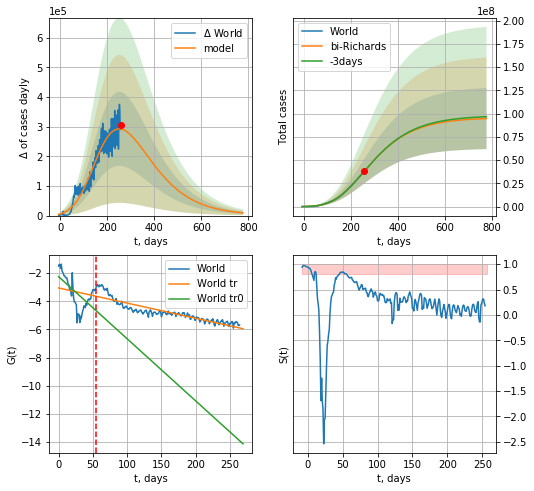

World data at: 2020-10-13
+3 day model MAPE: 0.000916
model: bi-Richards
coeffs: [ 9.54667185e+07  1.75078011e-01 -1.03346136e+02  4.87217116e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.346803
forecast at the end of period: +521 days
	 deltaDaycases: 9129
	 total cases: 94753296 ± 32860772
	 total death: 2693870 ± 2802730
bi-Richards approximation splitting point: 55
trend coefficient of determination: 0.379639
 intercept: -2.244127
 slope: -0.044191
trend coefficient of determination: 0.811616
 intercept: -3.050031
 slope: -0.010772


In [482]:
vL = 55
x = forecastRR("World",dfW[:vL],d1,60*9-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("World",dfW[:],d1,80*9-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)

266


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


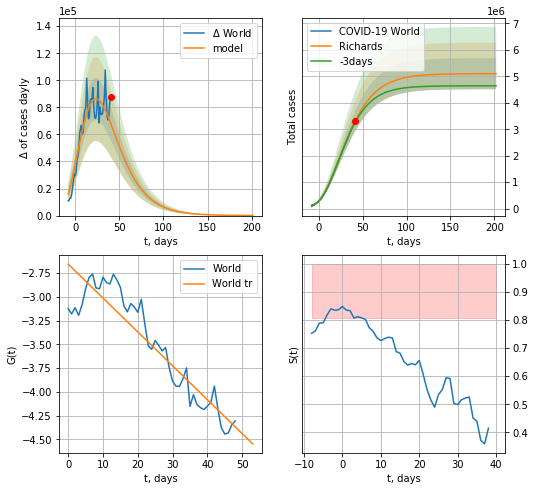

World data at: 2020-10-13
+3 day model MAPE: 0.014871
model: Richards
coeffs: [ 5.10253376e+06  1.04389323e+00 -4.20529569e+01  4.49999517e-02]
rational stdev: 0.115528
forecast at the end of period: +161 days
	 deltaDaycases: 57
	 total cases: 5101343 ± 589346
	 total death: 145033 ± 50265
trend coefficient of determination: 0.854894
 intercept: -2.655671
 slope: -0.035657


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


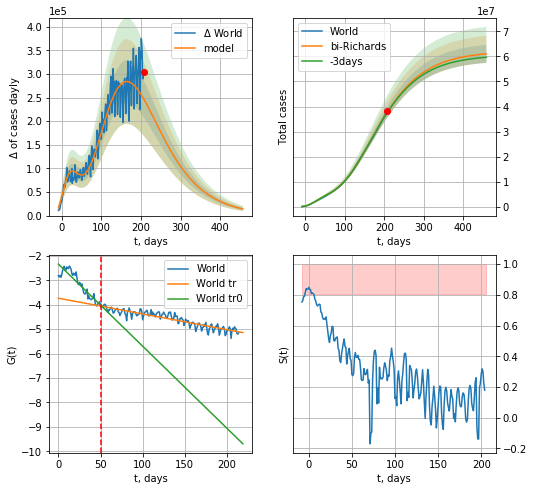

World data at: 2020-10-13
+3 day model MAPE: 0.005449
model: bi-Richards
coeffs: [ 5.69461024e+07  7.48868707e-01 -1.27819541e+02  1.82519422e-02]
rational stdev: 0.058640
forecast at the end of period: +251 days
	 deltaDaycases: 14036
	 total cases: 61019055 ± 3578130
	 total death: 1734793 ± 305182
bi-Richards approximation splitting point: 50
trend coefficient of determination: 0.842986
 intercept: -2.332693
 slope: -0.033617
trend coefficient of determination: 0.839770
 intercept: -3.729559
 slope: -0.006437


In [483]:
print (len(dfW))
vL = 100
x = forecastRR("World",dfW[50:vL],d1,40*9-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("World",dfW[50:],d1,50*9-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-50)
#x = forecastQR("World",dfW[50:],d1,30*9-dT,1.0,addpred=False)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


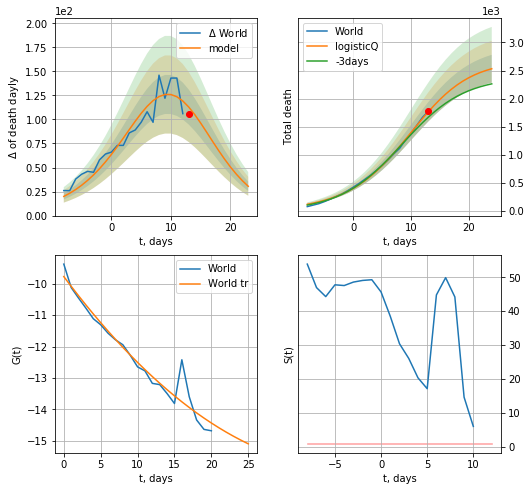

World data at: 2020-10-13
+3 day model MAPE: 0.067194
model: logisticQ
coeffs: [ 2.67018329e+03  8.28113131e-04  9.49649422e+00 -2.18461064e+02]
rational stdev: 0.098000
forecast at the end of period: +11 days
	 total death: 2532 ± 248
trend coefficient of determination: 0.944130
 intercept_: -9.771844228006898
 coeffs_: [ 0.         -0.31384117  0.00402719]


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


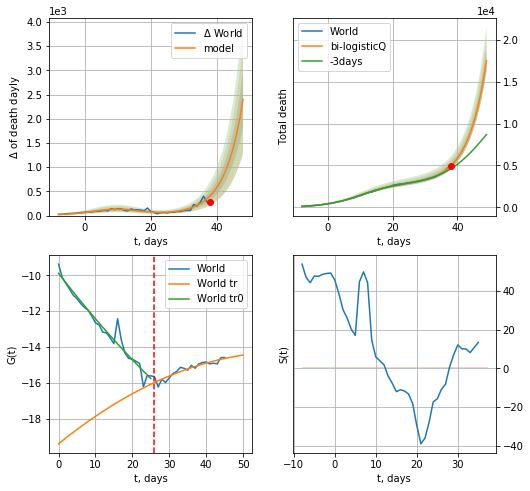

World data at: 2020-10-13
+3 day model MAPE: 0.105641
model: bi-logisticQ
coeffs: [ 6.44010385e+06  6.89934025e-04  7.95796325e+01 -2.38740330e+02]
rational stdev: 0.076590
forecast at the end of period: +11 days
	 total death: 17508 ± 1341
bi-logisticQ approximation splitting point: 26
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend coefficient of determination: 0.866834
 intercept_: -19.41123113056416
 coeffs_: [ 0.          0.16686573 -0.0013545 ]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:435: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:477: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


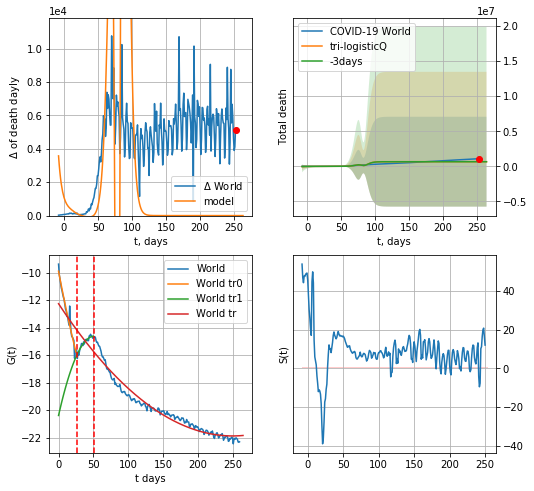

World data at: 2020-10-13
+3 day model MAPE: 0.012079
model: tri-logisticQ
coeffs: [-5.77815476e+06  2.27739819e-03  7.91051722e+01 -3.47948380e+01]
rational stdev: 9.639655
forecast at the end of period: +11 days
	 total death: 664619 ± 6406700
tri-logisticQ approximation splitting points: 26,51
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend1 coefficient of determination: 0.890965
 intercept_: -20.382525077358043
 coeffs_: [ 0.          0.22422642 -0.00217733]
trend coefficient of determination: 0.956973
 intercept_: -12.254957413276506
 coeffs_: [ 0.        -0.0769189  0.0001538]


In [484]:
vL=30 - 4
vL1=51
x = forecastRRR("World",dfW[4:vL],d1,7*T18-dT,1.0,False,cases='death')
xx = forecast2RRR("World",dfW[4:vL1],d1,7*T18-dT,x,1.0,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3RRR("World",dfW[4:],d1,7*T18-dT, xx, shift=1.,addpred=False,xcoef=[.35,.5,4.,1.],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


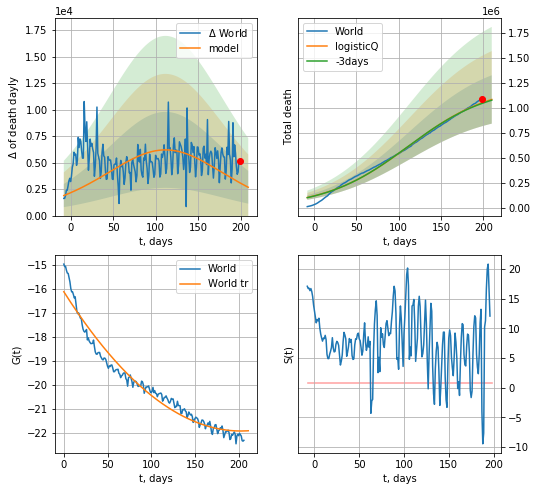

World data at: 2020-10-13
+3 day model MAPE: 0.006004
model: logisticQ
coeffs: [ 1.23154343e+06  7.42835726e-07  1.11727429e+02 -2.69903108e+04]
rational stdev: 0.223351
forecast at the end of period: +11 days
	 total death: 1082871 ± 241860
trend coefficient of determination: 0.958498
 intercept_: -16.114512096378323
 coeffs_: [ 0.         -0.05727928  0.0001415 ]


In [485]:
x = forecastRRR("World",dfW[58:],d1,7*T18-dT,1.0,False,cases='death')

In [486]:
#trend(dfSP,'SP',10)

In [487]:
#vL = len(dfSP[:])-16-dT
#x = forecast('Spain',dfSP[:vL],d1,30-dT,1.0)
#xx = forecast2('Spain',dfSP,d1,7*6-dT,x,1.0,addpred=True,xcoef=[3.,1.,1.8],vL=vL)

SP
           date   cases  active    death
237 2020-10-09  890367       0  32929.0
238 2020-10-10  899557       0  32929.0
239 2020-10-11  908842       0  32929.0
240 2020-10-12  918223       0  33124.0
241 2020-10-13  925341       0  33204.0


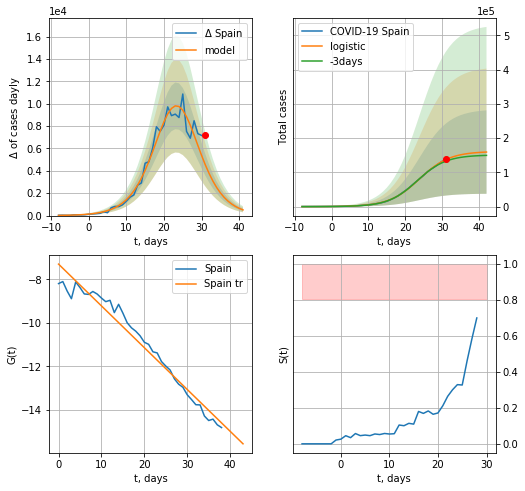

Spain data at: 2020-10-13
+3 day model MAPE: 0.04065647450118455
model: logistic
coeffs:  [1.61048783e+05 2.44209245e-01 2.38061166e+01]
rational stdev:  0.7646314126726975
forecast at the end of period: +11 days
	 deltaDaycases:  510
	 total cases:  159176 ± 121711
	 total death:  5711 ± 13100
trend coefficient of determination: 0.963842
 intercept: -7.302330
 slope: -0.192029


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


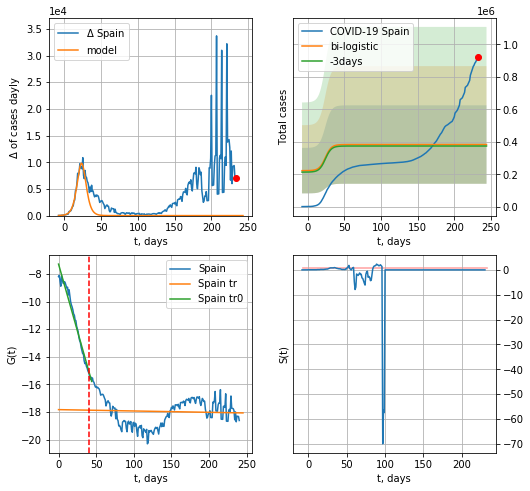

Spain data at: 2020-10-13
+3 day model MAPE: 0.02429293806865917
model: bi-logistic
coeffs:  [ 1.77538593e+05 -1.41270513e+01  3.44113893e+02] [1.61048783e+05 2.44209245e-01 2.38061166e+01]
scenario coeffs:  [0.25, 1.0, 1.6]
rational stdev:  0.6314352881026298
forecast at the end of period: +11 days
	 deltaDaycases:  0
	 total cases:  382972 ± 241822
	 total death:  13742 ± 26031
bi-logistic approximation splitting point: 40
trend0 coefficient of determination: 0.966463
 intercept: -7.292080
 slope: -0.192838
trend coefficient of determination: 0.002888
 intercept: -17.819444
 slope: -0.000972


In [488]:
try:
    dfSP = read_df(pd.DataFrame(),"SP")
    vL = 40#len(dfSP[:])-7-dT
    x = forecast('Spain',dfSP[:vL],d1,7*T18-dT,1.0,cases='cases')
    xx = forecast2('Spain',dfSP[:],d1,7*T18-dT,x,1.0,addpred=True,xcoef=[.25,1.,1.6],vL=vL,cases='cases')
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: divide by zero encountered in true_divide


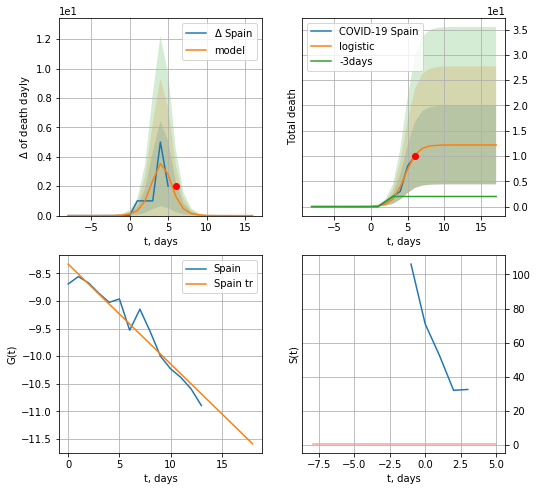

Spain data at: 2020-10-13
+3 day model MAPE: 4.756036700963932
model: logistic
coeffs:  [12.18291976  1.20295815  4.63698223]
rational stdev:  0.6384450788145528
forecast at the end of period: +11 days
	 total death:  12 ± 7
trend coefficient of determination: 0.932343
 intercept: -8.335143
 slope: -0.180548


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:251: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:251: RuntimeWarning: invalid value encountered in true_divide


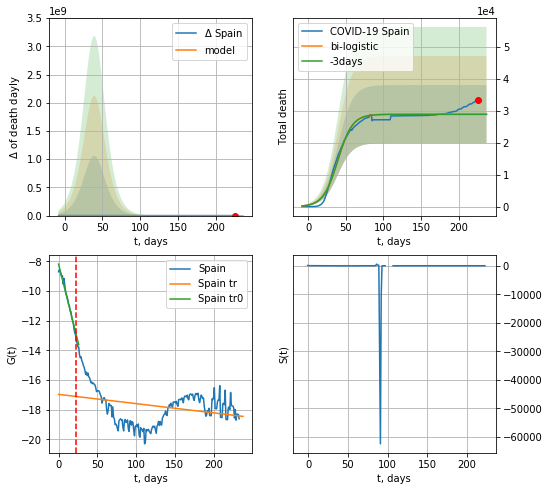

Spain data at: 2020-10-13
+3 day model MAPE: 0.0030406242607297833
model: bi-logistic
coeffs:  [2.88864479e+04 1.03032660e-01 3.95781981e+01] [12.18291976  1.20295815  4.63698223]
rational stdev:  0.314254996176996
forecast at the end of period: +11 days
	 deltaDaydeath:  0
	 total death:  28898 ± 9081
bi-logistic approximation splitting point: 22
trend0 coefficient of determination: 0.977622
 intercept: -8.181737
 slope: -0.208457
trend coefficient of determination: 0.080876
 intercept: -16.960688
 slope: -0.006231


In [489]:
vL = 22#len(dfSP[:])-7-dT
#dfSP = read_df(pd.DataFrame(),"SP")
x = forecast('Spain',dfSP[7:vL],d1,7*T18-dT,1.0,cases='death')
xx = forecast2('Spain',dfSP[7:],d1,7*T18-dT,x,1.0,addpred=False,xcoef=[.25,1.,1.8],vL=vL,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


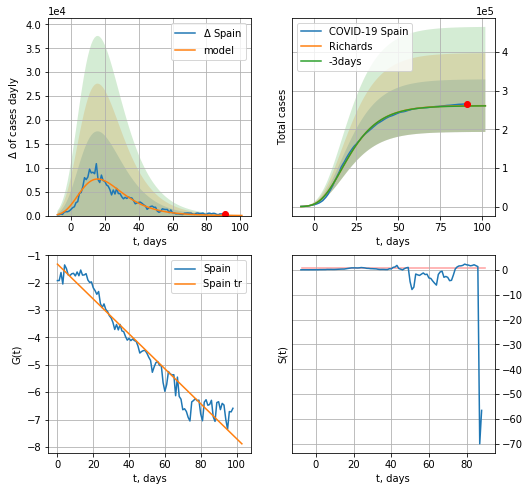

Spain data at: 2020-10-13
+3 day model MAPE: 0.002063
model: Richards
coeffs: [ 2.61234581e+05  1.11545617e+01 -4.55891964e+01  7.16375241e-03]
rational stdev: 0.259932
forecast at the end of period: +11 days
	 deltaDaycases: 22
	 total cases: 260959 ± 67831
	 total death: 9364 ± 7302
trend coefficient of determination: 0.950456
 intercept: -1.320749
 slope: -0.063751


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


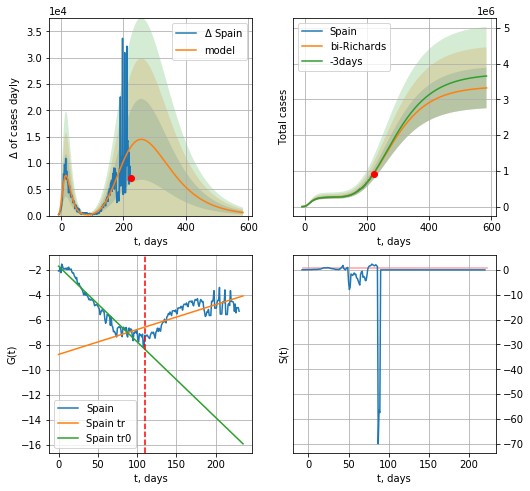

Spain data at: 2020-10-13
+3 day model MAPE: 0.005961
model: bi-Richards
coeffs: [ 3.10434627e+06  3.83286554e-01 -5.32326416e+00  3.36535981e-02]
rational stdev: 0.171357
forecast at the end of period: +361 days
	 deltaDaycases: 589
	 total cases: 3319845 ± 568878
	 total death: 119125 ± 61238
bi-Richards approximation splitting point: 110
trend coefficient of determination: 0.943859
 intercept: -1.723772
 slope: -0.060515
trend coefficient of determination: 0.525927
 intercept: -8.788326
 slope: 0.019922


In [490]:
iL = 10
vL = 110+iL#75+iL#135+1
x = forecastRR('Spain',dfSP[iL:vL-iL],d1,7*T18-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Spain',dfSP[iL:],d1,7*80-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:75: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:75: RuntimeWarning: invalid value encountered in true_divide


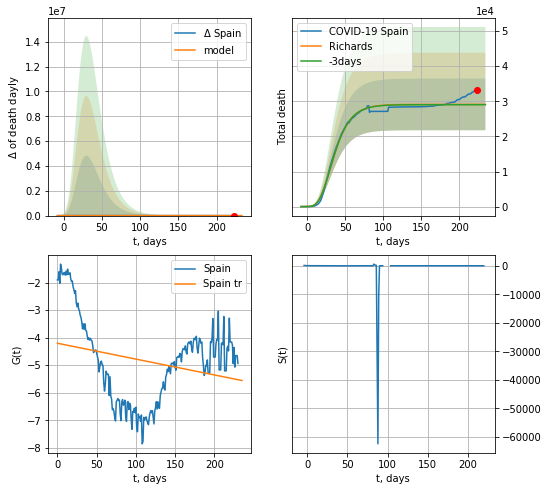

Spain data at: 2020-10-13
+3 day model MAPE: 0.003150
model: Richards
coeffs: [ 2.91173896e+04  1.39488837e+01 -4.71821315e+01  4.91757256e-03]
rational stdev: 0.252705
forecast at the end of period: +11 days
	 total death: 29117 ± 7358
trend coefficient of determination: 0.063275
 intercept: -4.203935
 slope: -0.005752


In [491]:
x = forecastRR('Spain',dfSP[10:],d1,7*T18-dT,1.0,addpred=False,xcoef=[.25,1.,3.,1],cases='death')

In [492]:
#x = forecastRRR('Spain',dfSP[:50],d1,7*T18-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[.35,.5,3.,1])
#xx = forecast2RRR('Spain',dfSP[:],d1,7*T18-dT,x,1.0,addpred=False,xcoef=koreaCoeffs,vL=50)#[.35,.5,3.,1])

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


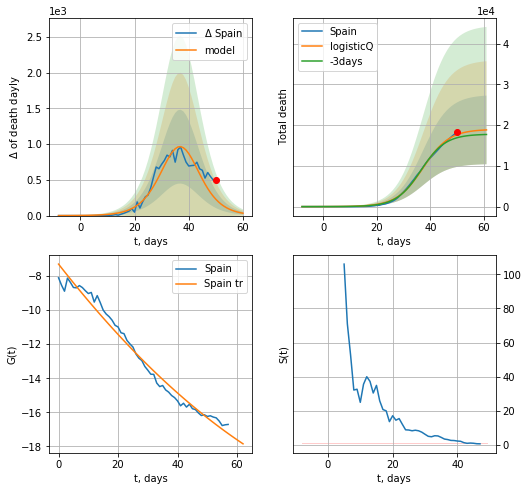

Spain data at: 2020-10-13
+3 day model MAPE: 0.047871
model: logisticQ
coeffs: [ 1.89599654e+04  5.38912704e-06  3.72491565e+01 -3.78046979e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.447682
forecast at the end of period: +11 days
	 total death: 18812 ± 8421
trend coefficient of determination: 0.978811
 intercept_: -7.301838938937334
 coeffs_: [ 0.         -0.22359908  0.00086295]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:347: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:347: RuntimeWarning: invalid value encountered in true_divide


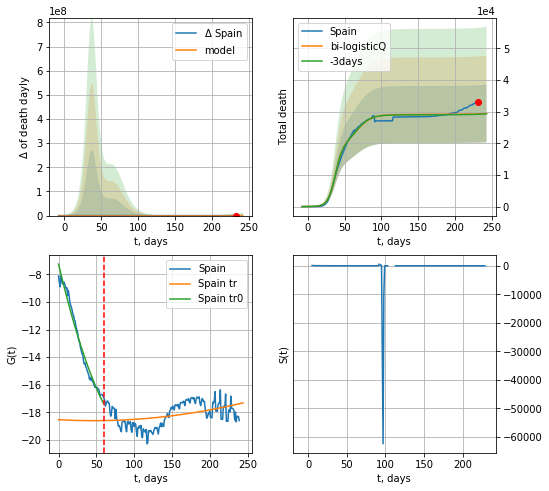

Spain data at: 2020-10-13
+3 day model MAPE: 0.004144
model: bi-logisticQ
coeffs: [ 1.01655695e+04  5.41256081e-08  6.62156625e+01 -1.83251251e+06]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.309630
forecast at the end of period: +11 days
	 total death: 29460 ± 9121
bi-logisticQ approximation splitting point: 60
trend coefficient of determination: 0.978897
 intercept_: -7.2487934110171
 coeffs_: [ 0.         -0.2311524   0.00102662]
trend coefficient of determination: 0.176478
 intercept_: -18.540636316894023
 coeffs_: [ 0.00000000e+00 -3.10550662e-03  3.32477345e-05]


In [493]:
x = forecastRRR('Spain',dfSP[1:60],d1,7*T18-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,3.,1])
xx = forecast2RRR('Spain',dfSP[1:],d1,7*T18-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,cases='death',vL=60)

In [494]:
#x = forecastQR('Spain',dfSP[5:],d1,7*16-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[.35,.5,3.,1])

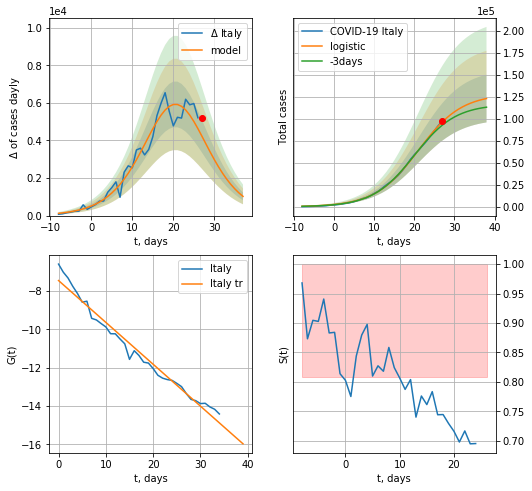

Italy data at: 2020-10-13
+3 day model MAPE: 0.0455783779571316
model: logistic
coeffs:  [1.28139025e+05 1.85112184e-01 2.10100291e+01]
rational stdev:  0.22065596629973358
forecast at the end of period: +11 days
	 deltaDaycases:  1022
	 total cases:  122848 ± 27107
	 total death:  12183 ± 8064
trend coefficient of determination: 0.974872
 intercept: -7.448746
 slope: -0.218671


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:195: RuntimeWarning: overflow encountered in exp


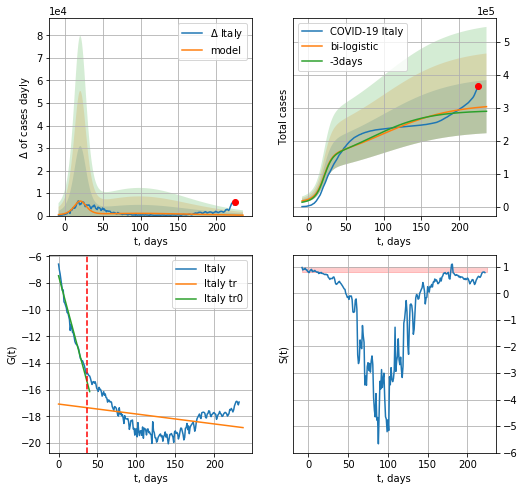

Italy data at: 2020-10-13
+3 day model MAPE: 0.04440582324335827
model: bi-logistic
coeffs:  [1.83685957e+05 2.16057868e-02 9.88704019e+01] [1.28139025e+05 1.85112184e-01 2.10100291e+01]
rational stdev:  0.26584823901858967
forecast at the end of period: +11 days
	 deltaDaycases:  187
	 total cases:  302799 ± 80498
	 total death:  30030 ± 23950
bi-logistic approximation splitting point: 36
trend0 coefficient of determination: 0.975965
 intercept: -7.466589
 slope: -0.217097
trend coefficient of determination: 0.115924
 intercept: -17.086958
 slope: -0.007451


In [495]:
vL = 36#len(dfIT)-6-dT
x = forecast('Italy',dfIT[:vL],d1,T18*7-dT,1.0)
xx = forecast2('Italy',dfIT,d1,T18*7-dT,x,1.0,vL=vL)

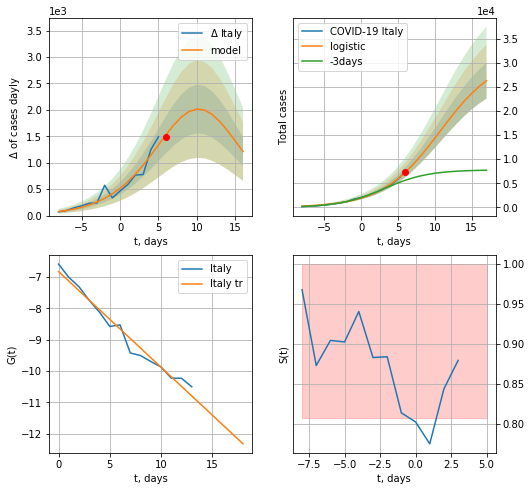

Italy data at: 2020-10-13
+3 day model MAPE: 0.4426444096966454
model: logistic
coeffs:  [3.14978219e+04 2.56455865e-01 1.06869170e+01]
rational stdev:  0.1414781796365507
forecast at the end of period: +11 days
	 deltaDaycases:  1212
	 total cases:  26290 ± 3719
	 total death:  2607 ± 1106
trend coefficient of determination: 0.972594
 intercept: -6.827533
 slope: -0.305163


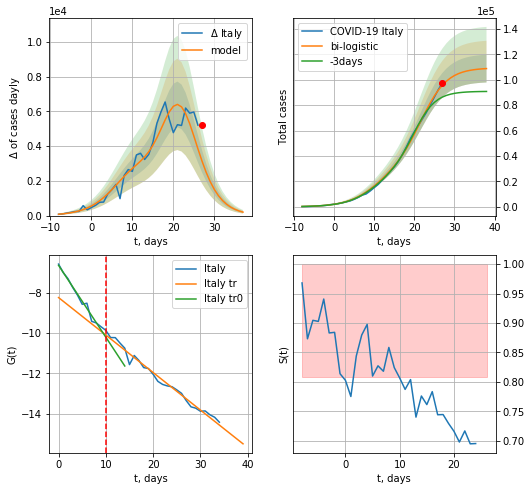

Italy data at: 2020-10-13
+3 day model MAPE: 0.1273932630183904
model: bi-logistic
coeffs:  [7.78644566e+04 3.07215545e-01 2.18188310e+01] [3.14978219e+04 2.56455865e-01 1.06869170e+01]
rational stdev:  0.10049358712471239
forecast at the end of period: +11 days
	 deltaDaycases:  199
	 total cases:  108797 ± 10933
	 total death:  10790 ± 3252
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980937
 intercept: -6.650494
 slope: -0.355987
trend coefficient of determination: 0.983083
 intercept: -8.246651
 slope: -0.185682


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:311: RuntimeWarning: overflow encountered in exp


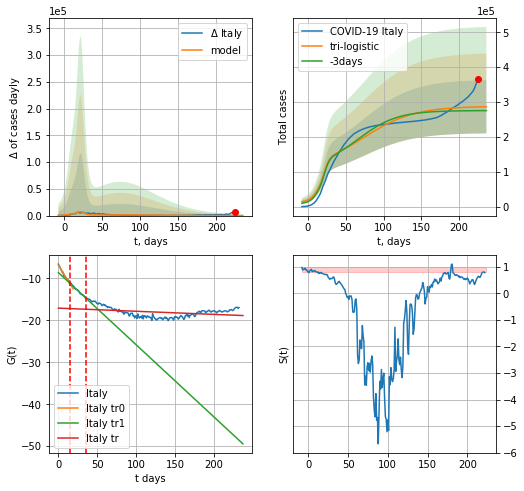

Italy data at: 2020-10-13
+3 day model MAPE: 0.03883784271191721
model: tri-logistic
coeffs:  [1.78386040e+05 3.01753627e-02 7.39556347e+01] [3.14978219e+04 2.56455865e-01 1.06869170e+01 7.78644566e+04
 3.07215545e-01 2.18188310e+01]
forecast rational stdev:  0.26635683065466736
forecast at the end of period: +11 days
	 deltaDaycases:  40
	 total cases:  286416 ± 76288
	 total death:  28405 ± 22697
tri-logistic approximation splitting points: 15,36
trend0 coefficient of determination: 0.972806
 intercept: -6.865084
 slope: -0.296498
trend1 coefficient of determination: 0.980669
 intercept: -8.621660
 slope: -0.172200
trend coefficient of determination: 0.115924
 intercept: -17.086958
 slope: -0.007451


In [496]:
vL = 15#len(dfSP[:])-11-dT
vL1=36
x = forecast('Italy',dfIT[:vL],d1,7*T18-dT,1.0)
xx = forecast2('Italy',dfIT[:vL1],d1,7*T18-dT,x,1.0)#,addpred=True,xcoef=[.25,1.,1.8],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Italy",dfIT,d1,7*T18-dT, xx, shift=1.,addpred=False,xcoef=[.35,1.,1.5],vL=[vL,vL1])

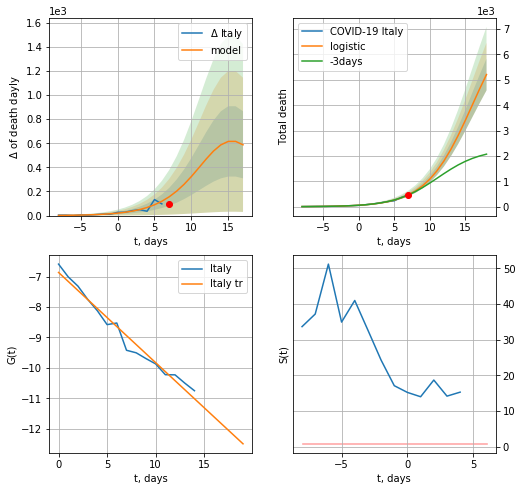

Italy data at: 2020-10-13
+3 day model MAPE: 0.04050488963495004
model: logistic
coeffs:  [8.02165383e+03 3.09187965e-01 1.60041387e+01]
rational stdev:  0.12009378173020563
forecast at the end of period: +11 days
	 total death:  5210 ± 625
trend coefficient of determination: 0.972806
 intercept: -6.865084
 slope: -0.296498


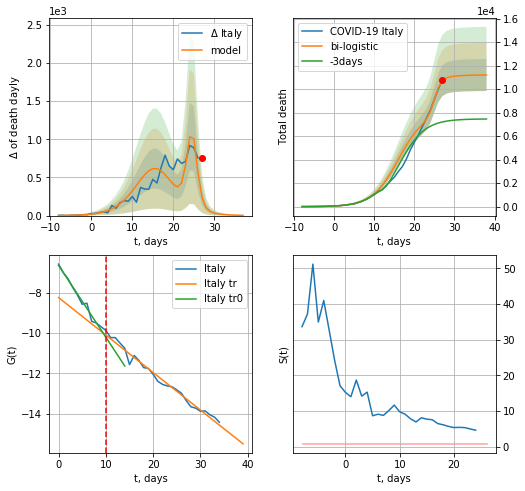

Italy data at: 2020-10-13
+3 day model MAPE: 0.5045402783114736
model: bi-logistic
coeffs:  [3.18986478e+03 1.24682064e+00 2.50159742e+01] [8.02165383e+03 3.09187965e-01 1.60041387e+01]
rational stdev:  0.12176299197618909
forecast at the end of period: +11 days
	 deltaDaydeath:  3
	 total death:  11202 ± 1364
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980937
 intercept: -6.650494
 slope: -0.355987
trend coefficient of determination: 0.983083
 intercept: -8.246651
 slope: -0.185682


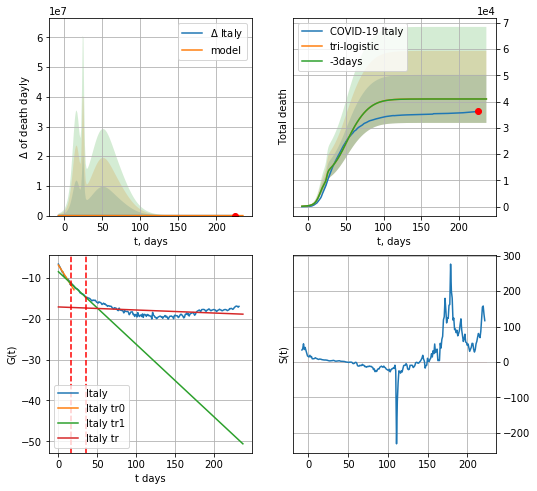

Italy data at: 2020-10-13
+3 day model MAPE: 0.0008265676855198032
model: tri-logistic
coeffs:  [2.38569863e+04 9.05187727e-02 4.96077937e+01] [8.02165383e+03 3.09187965e-01 1.60041387e+01 3.18986478e+03
 1.24682064e+00 2.50159742e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
forecast rational stdev:  0.22279297863230807
forecast at the end of period: +11 days
	 deltaDaydeath:  0
	 total death:  41032 ± 9141
tri-logistic approximation splitting points: 16,36
trend0 coefficient of determination: 0.976775
 intercept: -6.838969
 slope: -0.302094
trend1 coefficient of determination: 0.986358
 intercept: -8.457993
 slope: -0.177909
trend coefficient of determination: 0.115924
 intercept: -17.086958
 slope: -0.007451


In [497]:
vL = 16#len(dfSP[:])-11-dT
vL1=36
x = forecast('Italy',dfIT[:vL],d1,7*T18-dT,1.0,cases='death')
xx = forecast2('Italy',dfIT[:vL1],d1,7*T18-dT,x,1.0,cases='death')#,addpred=True,xcoef=[.25,1.,1.8],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Italy",dfIT,d1,7*T18-dT, xx, shift=1.,addpred=True,xcoef=[.25,1.,1.5],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


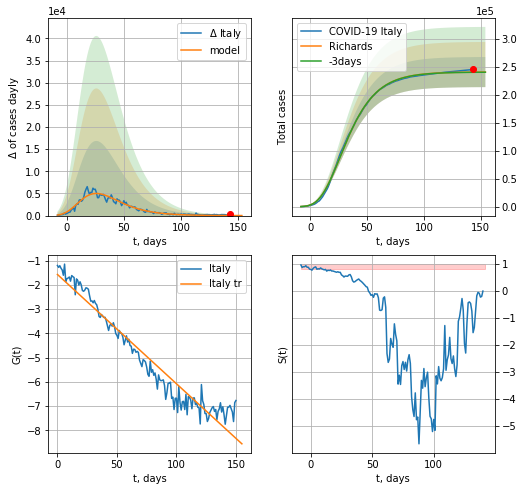

Italy data at: 2020-10-13
+3 day model MAPE: 0.001137
model: Richards
coeffs: [ 2.40825315e+05  8.29717345e+00 -6.16464143e+01  6.82557212e-03]
rational stdev: 0.111816
forecast at the end of period: +11 days
	 deltaDaycases: 10
	 total cases: 240650 ± 26908
	 total death: 23867 ± 8006
trend coefficient of determination: 0.940744
 intercept: -1.565853
 slope: -0.045125


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


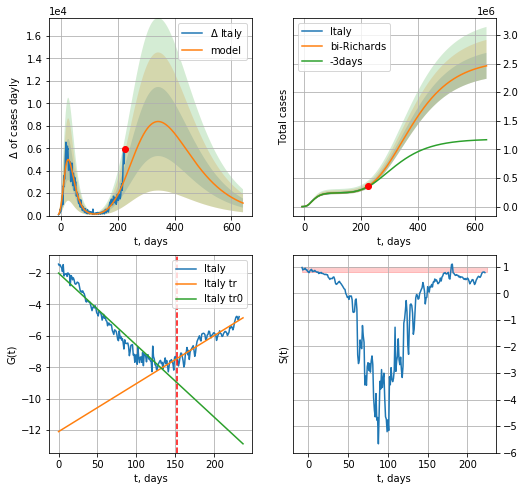

Italy data at: 2020-10-13
+3 day model MAPE: 0.017519
model: bi-Richards
coeffs: [2.33409621e+06 1.98345685e-01 4.44541697e+01 5.04700922e-02]
rational stdev: 0.092143
forecast at the end of period: +417 days
	 deltaDaycases: 1114
	 total cases: 2461186 ± 226782
	 total death: 244093 ± 67474
bi-Richards approximation splitting point: 152
trend coefficient of determination: 0.935675
 intercept: -2.004518
 slope: -0.045873
trend coefficient of determination: 0.839452
 intercept: -12.098865
 slope: 0.030574


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


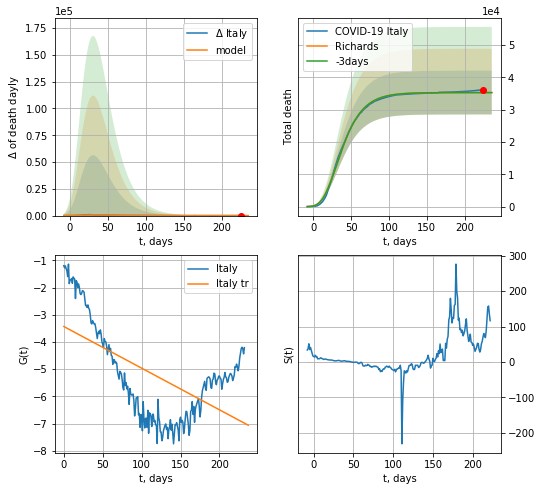

Italy data at: 2020-10-13
+3 day model MAPE: 0.000622
model: Richards
coeffs: [ 3.53334323e+04  8.37344166e+00 -6.46427857e+01  6.32409037e-03]
rational stdev: 0.191835
forecast at the end of period: +11 days
	 total death: 35332 ± 6778
trend coefficient of determination: 0.352532
 intercept: -3.430014
 slope: -0.015319


In [498]:
vL=152
x = forecastRR('Italy',dfIT[:vL],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Italy',dfIT[:],d1,88*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
x = forecastRR('Italy',dfIT[:],d1,T18*7-dT,1.0,cases='death')

In [499]:
#x = forecastRRR('Italy',dfIT[:],d1,7*T18-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,4.,1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


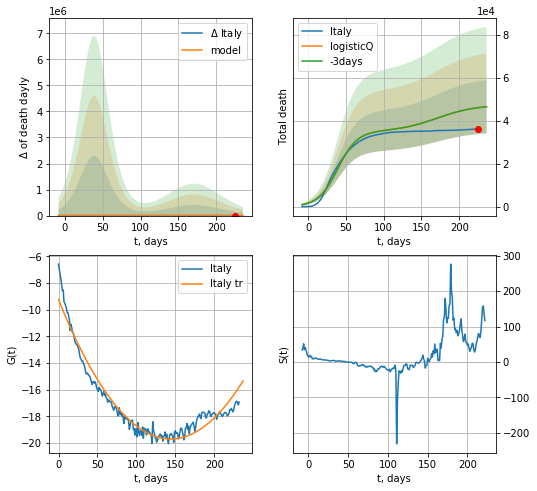

Italy data at: 2020-10-13
+3 day model MAPE: 0.000517
model: logisticQ
coeffs: [ 3.50203958e+04  1.38876097e-07  3.91672166e+01 -5.60715421e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.266405
forecast at the end of period: +11 days
	 total death: 46531 ± 12396
trend coefficient of determination: 0.946801
 intercept_: -9.260948048666354
 coeffs_: [ 0.         -0.14498213  0.00050318]


In [500]:
x = forecastRRR('Italy',dfIT[:],d1,7*T18-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,4.,1])

In [501]:
dT

199

FR
           date     cases  active    death
237 2020-10-09  691977.0  558566  32583.0
238 2020-10-10  718873.0  585408  32637.0
239 2020-10-11  734974.0  601463  32683.0
240 2020-10-12  743479.0  609872  32779.0
241 2020-10-13  756472.0  620850  32942.0


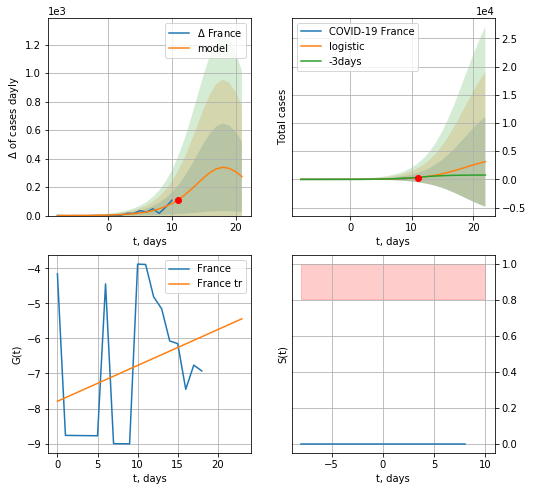

France data at: 2020-10-13
+3 day model MAPE: 0.04053351776025477
model: logistic
coeffs:  [4.17382756e+03 3.25568782e-01 1.85948993e+01]
rational stdev:  2.5390566064289986
forecast at the end of period: +11 days
	 deltaDaycases:  273
	 total cases:  3138 ± 7967
	 total death:  136 ± 1035
trend coefficient of determination: 0.083417
 intercept: -7.793073
 slope: 0.102246


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


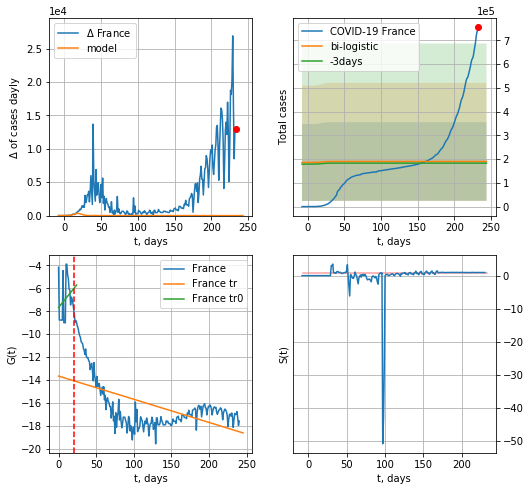

France data at: 2020-10-13
+3 day model MAPE: 0.0380778323067319
model: bi-logistic
coeffs:  [ 1.85761278e+05 -1.03807397e+01  2.58663625e+02] [4.17382756e+03 3.25568782e-01 1.85948993e+01]
rational stdev:  0.8716519990179943
forecast at the end of period: +11 days
	 deltaDaycases:  0
	 total cases:  189935 ± 165557
	 total death:  8271 ± 21628
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.062178
 intercept: -7.670498
 slope: 0.081817
trend coefficient of determination: 0.320771
 intercept: -13.668186
 slope: -0.020273


In [502]:
# prideta 1990 2020-04-17
# prideta 3824 2020-04-18
dfFR = read_df(pd.DataFrame(),"FR")
vL=20
try:
    x = forecast('France',dfFR[:vL],d1,T18*7-dT,1.0)
    xx = forecast2('France',dfFR,d1,T18*7-dT,x,1.0,addpred=False,xcoef=[.25,1.,1.5],vL=vL)
except:
    print ("Exception occurs")

In [503]:
#vL=len(dfFR)-9-5-dT
#x = forecast('France',dfFR[10:-9-dT],d1,7*5-dT-4,1.0)
#xx = forecast2('France',dfFR[10:],d1,7*7-dT-4,x,1.0,addpred=True,xcoef=[.25,1.,1.4],vL=vL)

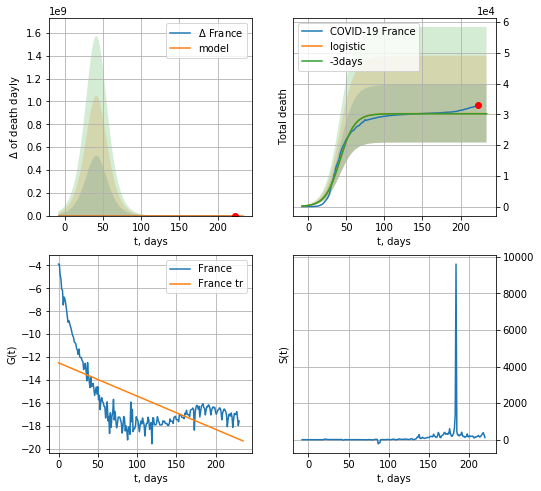

France data at: 2020-10-13
+3 day model MAPE: 0.0018493673609796344
model: logistic
coeffs:  [3.02480208e+04 1.04102584e-01 4.17783854e+01]
rational stdev:  0.3107855177866339
forecast at the end of period: +11 days
	 total death:  30248 ± 9400
trend coefficient of determination: 0.390964
 intercept: -12.510683
 slope: -0.029043


In [504]:
#dfFR = read_df(pd.DataFrame(),"FR")
x = forecast('France',dfFR[10:],d1,7*T18-dT,1.0,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


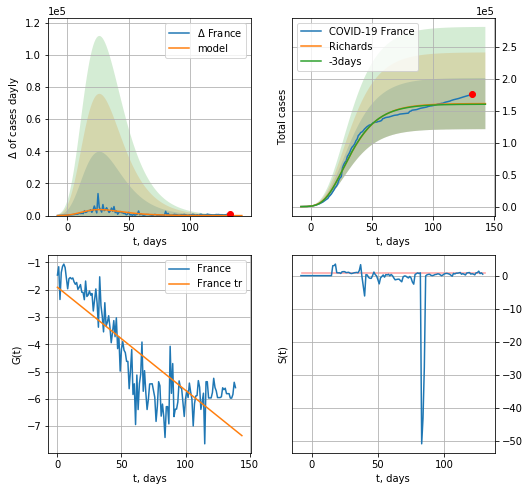

France data at: 2020-10-13
+3 day model MAPE: 0.006316
model: Richards
coeffs: [ 1.60997599e+05  1.46350142e+01 -5.95952768e+01  4.31594545e-03]
rational stdev: 0.248135
forecast at the end of period: +11 days
	 deltaDaycases: 6
	 total cases: 160894 ± 39923
	 total death: 7006 ± 5215
trend coefficient of determination: 0.728995
 intercept: -1.912518
 slope: -0.037751


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


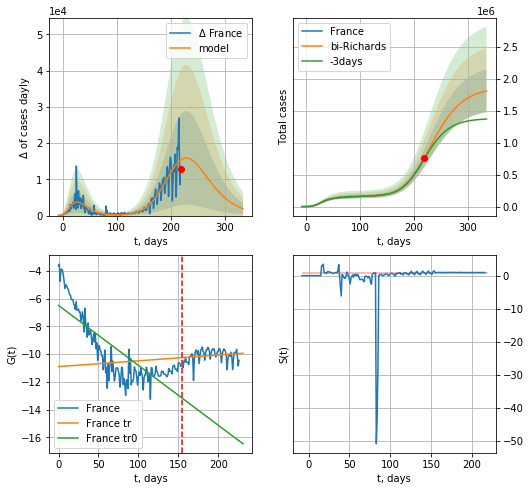

France data at: 2020-10-13
+3 day model MAPE: 0.016409
model: bi-Richards
coeffs: [1.70878831e+06 6.58426883e-02 2.05011142e+02 4.71804885e-01]
rational stdev: 0.184449
forecast at the end of period: +116 days
	 deltaDaycases: 1906
	 total cases: 1807643 ± 333418
	 total death: 78717 ± 43557
bi-Richards approximation splitting point: 155
trend coefficient of determination: 0.653841
 intercept: -6.483198
 slope: -0.043212
trend coefficient of determination: 0.036578
 intercept: -10.897119
 slope: 0.004185


In [505]:
vL = 86+14+40+29
x = forecastRR('France',dfFR[14:vL-14],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('France',dfFR[14:],d1,45*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-14)

In [506]:
#x = forecastRRR('France',dfFR[10:],d1,34*7-dT-4,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,3.,1.])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


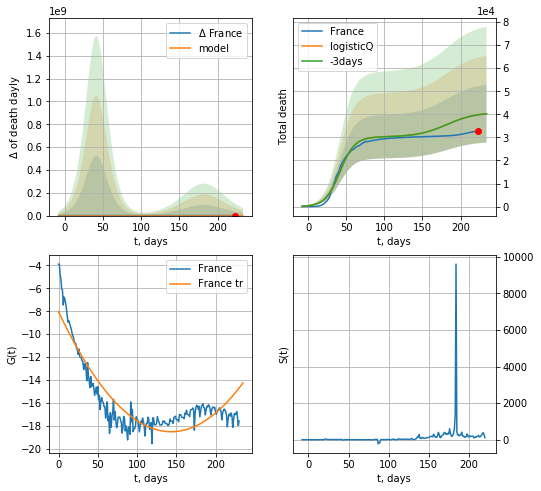

France data at: 2020-10-13
+3 day model MAPE: 0.001198
model: logisticQ
coeffs: [ 3.02480575e+04  1.93441765e-07  4.17792940e+01 -5.37937280e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.310822
forecast at the end of period: +11 days
	 total death: 40297 ± 12525
trend coefficient of determination: 0.819958
 intercept_: -8.033023093365983
 coeffs_: [ 0.         -0.14636187  0.00051008]


In [507]:
x = forecastRRR('France',dfFR[10:],d1,T18*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,3.,1.])

In [508]:
#x = forecastR('France',dfFR[:],d1,8*7-dT-4,1.0,addpred=True,xcoef=[0.25,1.,20.,1])

In [509]:
#trend3(dfGR,dfUS,dfGB[:],'GR','US','GB',40,40,40)

In [510]:
dfGR = read_df(pd.DataFrame(),"GR")
#x = forecast('Germany',dfGR[:],d1,7*T18-dT,1.0)
#xx = forecast2('Germany',dfGR,d1,7*7-dT,x,1.0)

GR
           date   cases  active   death
228 2020-10-09  320478   38991  9687.0
229 2020-10-10  323453   40262  9691.0
230 2020-10-11  326291   41889  9702.0
231 2020-10-12  331094   42273  9721.0
232 2020-10-13  335679   46839  9740.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


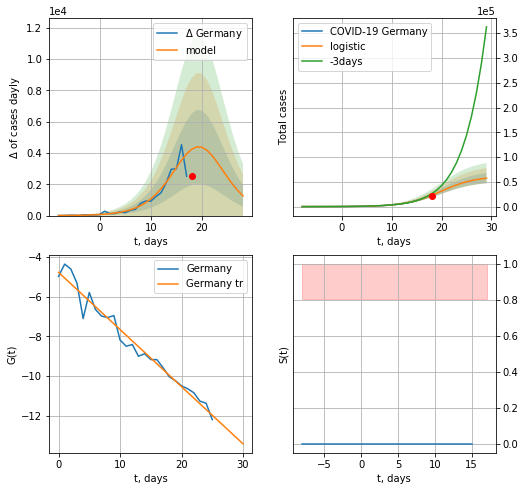

Germany data at: 2020-10-13
+3 day model MAPE: 0.1832688253569737
model: logistic
coeffs:  [6.15503848e+04 2.86340373e-01 1.98405530e+01]
rational stdev:  0.17812668621711658
forecast at the end of period: +11 days
	 deltaDaycases:  1259
	 total cases:  57384 ± 10221
	 total death:  1665 ± 889
trend coefficient of determination: 0.966755
 intercept: -4.774386
 slope: -0.288157


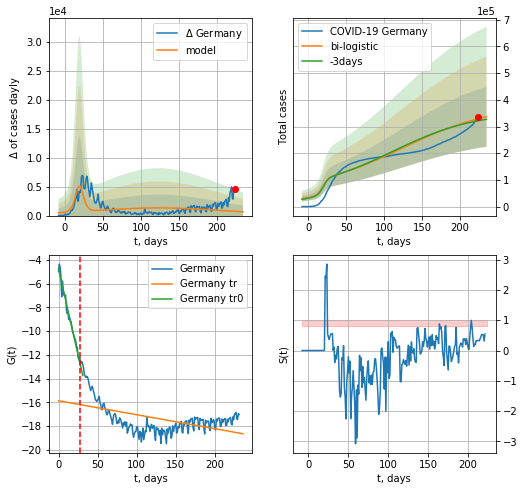

Germany data at: 2020-10-13
+3 day model MAPE: 0.023720160932561296
model: bi-logistic
coeffs:  [2.55542170e+05 1.75789229e-02 1.12794560e+02] [6.15503848e+04 2.86340373e-01 1.98405530e+01]
scenario coeffs:  [0.25, 1.0, 1.6]
rational stdev:  0.33324084992275477
forecast at the end of period: +11 days
	 deltaDaycases:  649
	 total cases:  336568 ± 112158
	 total death:  9765 ± 9762
bi-logistic approximation splitting point: 27
trend0 coefficient of determination: 0.970316
 intercept: -4.764587
 slope: -0.289333
trend coefficient of determination: 0.256368
 intercept: -15.858536
 slope: -0.011778


In [511]:
vL = 27
x = forecast('Germany',dfGR[:vL],d1,T18*7-dT,1.0)#,addpred=True,xcoef=[0.25,1.,2.0,1])
xx = forecast2('Germany',dfGR,d1,7*T18-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.6],vL=vL)

In [512]:
dfGR = read_df(pd.DataFrame(),"GR")
#x = forecast('Germany',dfGR[14:],d1,24*7-dT,1.0,cases='death')

GR
           date   cases  active   death
228 2020-10-09  320478   38991  9687.0
229 2020-10-10  323453   40262  9691.0
230 2020-10-11  326291   41889  9702.0
231 2020-10-12  331094   42273  9721.0
232 2020-10-13  335679   46839  9740.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


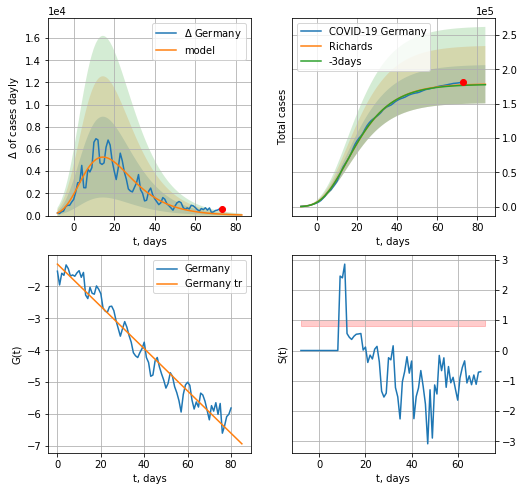

Germany data at: 2020-10-13
+3 day model MAPE: 0.003910
model: Richards
coeffs: [ 1.79110642e+05  9.15687169e+00 -4.39392677e+01  8.78226811e-03]
rational stdev: 0.155919
forecast at the end of period: +11 days
	 deltaDaycases: 57
	 total cases: 178418 ± 27818
	 total death: 5176 ± 2421
trend coefficient of determination: 0.956451
 intercept: -1.304276
 slope: -0.066178


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


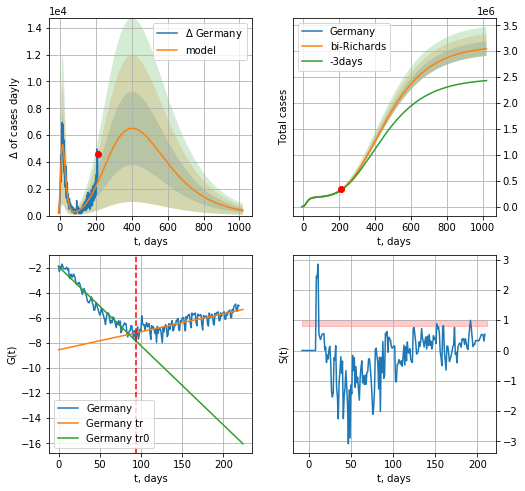

Germany data at: 2020-10-13
+3 day model MAPE: 0.009580
model: bi-Richards
coeffs: [ 2.93342430e+06  1.07202956e-01 -5.64918742e+01  5.78521039e-02]
rational stdev: 0.045844
forecast at the end of period: +809 days
	 deltaDaycases: 386
	 total cases: 3049741 ± 139811
	 total death: 88490 ± 12170
bi-Richards approximation splitting point: 94
trend coefficient of determination: 0.950044
 intercept: -1.915792
 slope: -0.063054
trend coefficient of determination: 0.603896
 intercept: -8.545449
 slope: 0.014361


In [513]:
vL = 94+12
x = forecastRR('Germany',dfGR[12:vL-12],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Germany',dfGR[12:],d1,144*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12)

In [514]:
#x = forecastRRR('Germany',dfGR[:],d1,T18*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3.0,1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


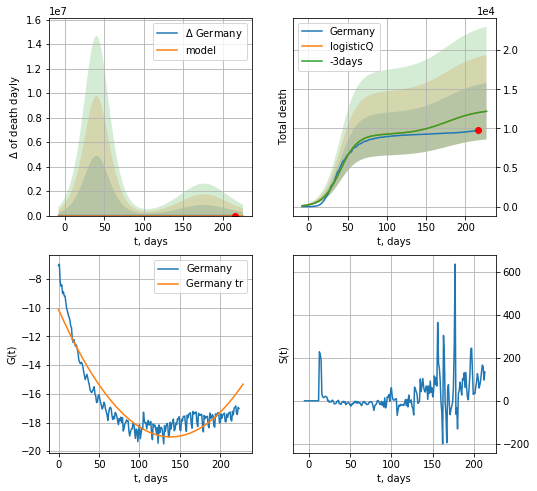

Germany data at: 2020-10-13
+3 day model MAPE: 0.000759
model: logisticQ
coeffs: [ 9.21734940e+03  1.75294244e-07  4.05755416e+01 -5.18570981e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.295044
forecast at the end of period: +11 days
	 total death: 12182 ± 3594
trend coefficient of determination: 0.865022
 intercept_: -10.116586777834705
 coeffs_: [ 0.         -0.12803336  0.00046138]


In [515]:
x = forecastRRR('Germany',dfGR[8:],d1,T18*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[0.35,.5,3.0,1])

US
           date    cases   active     death
222 2020-10-09  7894478  2611530  218648.0
223 2020-10-10  7945505  2636381  219282.0
224 2020-10-11  7991998  2644141  219695.0
225 2020-10-12  8038037  2632033  220018.0
226 2020-10-13  8090253  2642953  220873.0


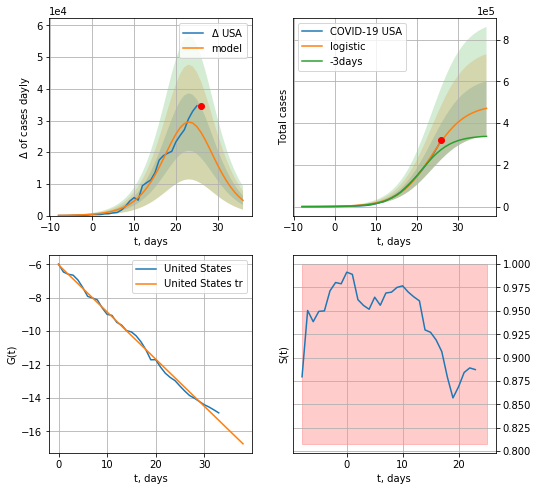

USA data at: 2020-10-13
+3 day model MAPE: 0.17962965905806133
model: logistic
coeffs:  [4.89025787e+05 2.41973856e-01 2.36121759e+01]
rational stdev:  0.27607026078318453
forecast at the end of period: +11 days
	 deltaDaycases:  4807
	 total cases:  470586 ± 129914
	 total death:  12847 ± 10640
trend coefficient of determination: 0.995387
 intercept: -6.036925
 slope: -0.281840


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


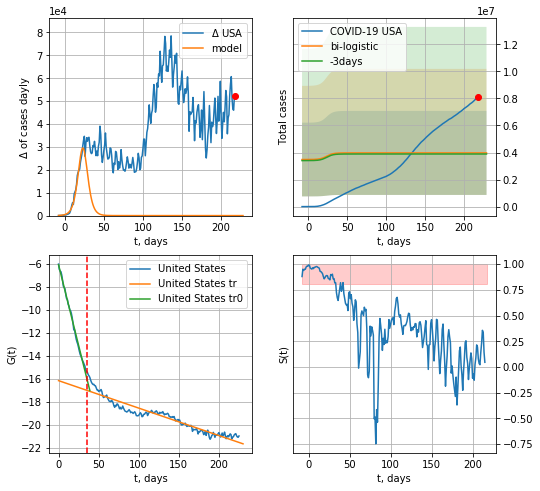

USA data at: 2020-10-13
+3 day model MAPE: 0.02050458699727404
model: bi-logistic
coeffs:  [ 2.78538145e+06 -3.18320973e+01  7.62574923e+02] [4.89025787e+05 2.41973856e-01 2.36121759e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
rational stdev:  0.7824116232373135
forecast at the end of period: +11 days
	 deltaDaycases:  0
	 total cases:  3970752 ± 3106762
	 total death:  108406 ± 254454
bi-logistic approximation splitting point: 35
trend0 coefficient of determination: 0.995488
 intercept: -6.051468
 slope: -0.280518
trend coefficient of determination: 0.903222
 intercept: -16.133468
 slope: -0.023908


In [516]:
vL=35
dfUS = read_df(pd.DataFrame(),"US")
x = forecast('USA',dfUS[:vL],d1,T18*7-dT,1.0,addpred=False,xcoef=[0.25,1.,2.])
xx = forecast2('USA',dfUS[:],d1,T18*7-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.5],vL=vL)

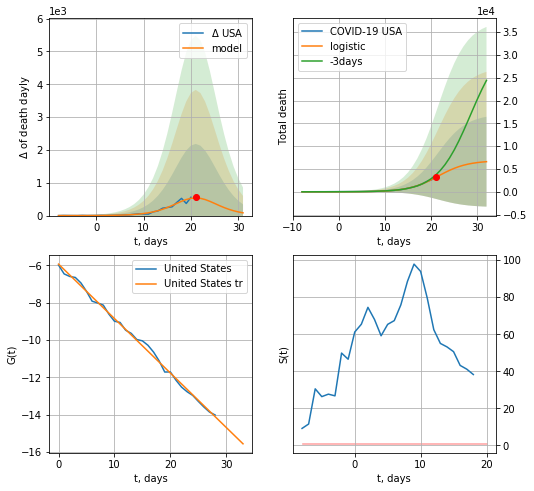

USA data at: 2020-10-13
+3 day model MAPE: 0.21421329662103625
model: logistic
coeffs:  [6.83398319e+03 3.16137728e-01 2.14876356e+01]
rational stdev:  1.4929056707100332
forecast at the end of period: +11 days
	 total death:  6596 ± 9847
trend coefficient of determination: 0.996549
 intercept: -5.938291
 slope: -0.291586


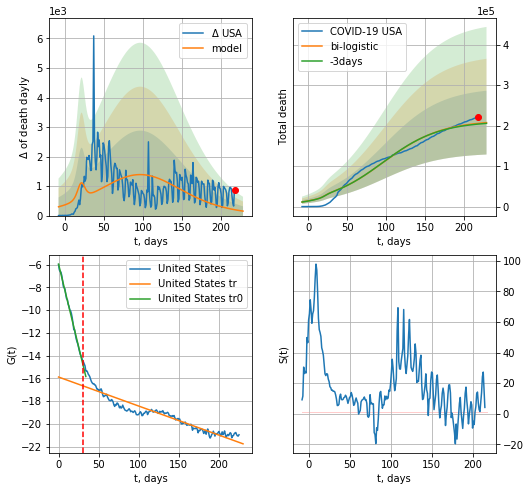

USA data at: 2020-10-13
+3 day model MAPE: 0.008511671984545614
model: bi-logistic
coeffs:  [2.06346750e+05 2.69330361e-02 9.68771910e+01] [6.83398319e+03 3.16137728e-01 2.14876356e+01]
rational stdev:  0.37972120946375554
forecast at the end of period: +11 days
	 deltaDaydeath:  151
	 total death:  207466 ± 78779
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.996707
 intercept: -5.949158
 slope: -0.290421
trend coefficient of determination: 0.879099
 intercept: -15.873504
 slope: -0.025523


In [517]:
vL=30
x = forecast('USA',dfUS[:vL],d1,7*T18-dT,1.0,cases='death')
xx = forecast2('USA',dfUS,d1,7*T18-dT,x,1.0,cases='death',vL=vL)
#x = forecast('USA',dfUS[:],d1,28*3-dT)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


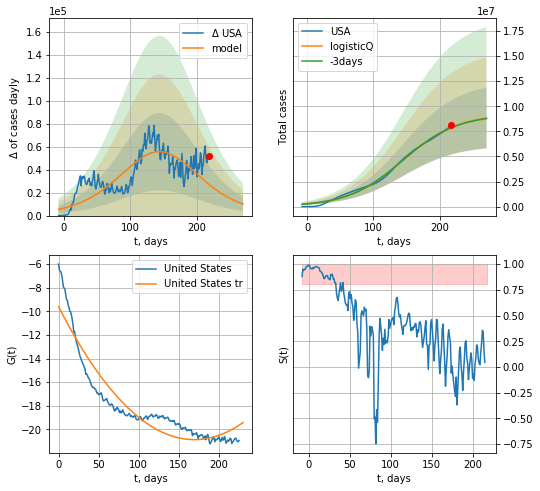

USA data at: 2020-10-13
+3 day model MAPE: 0.004528
model: logisticQ
coeffs: [ 9.19903699e+06  2.35056190e-07  1.44285725e+02 -1.02693700e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.342377
forecast at the end of period: +53 days
	 deltaDaycases: 10079
	 total cases: 8831337 ± 3023651
	 total death: 241105 ± 247646
trend coefficient of determination: 0.885070
 intercept_: -9.601091416979333
 coeffs_: [ 0.         -0.13322299  0.00039328]


In [518]:
x = forecastRRR('USA',dfUS[:],d1,7*36-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3.,1.])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


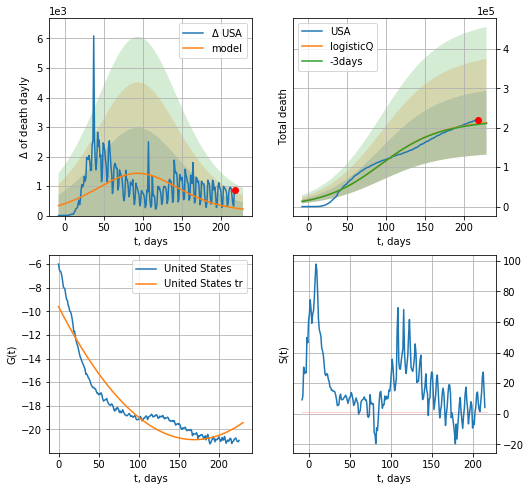

USA data at: 2020-10-13
+3 day model MAPE: 0.008123
model: logisticQ
coeffs: [ 2.12048463e+05  3.50289287e-08  9.34782227e+01 -7.63862088e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.380728
forecast at the end of period: +11 days
	 total death: 212790 ± 81015
trend coefficient of determination: 0.885070
 intercept_: -9.601091416979333
 coeffs_: [ 0.         -0.13322299  0.00039328]


In [519]:
x = forecastRRR('USA',dfUS[:],d1,7*30-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[0.35,.5,3.,1.])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


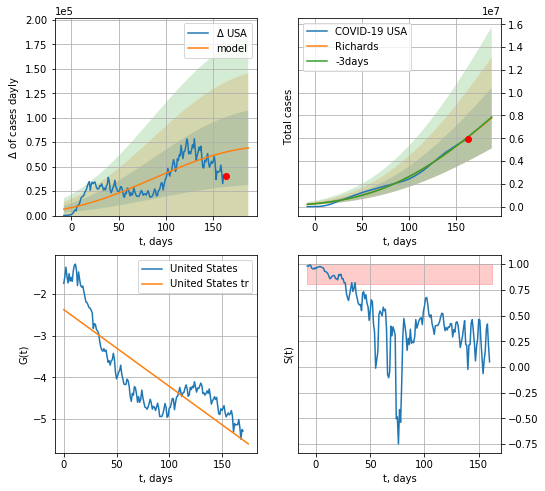

USA data at: 2020-10-13
+3 day model MAPE: 0.006431
model: Richards
coeffs: [ 2.71802437e+07  3.81051895e-01 -3.30137400e+02  1.89050664e-02]
rational stdev: 0.342473
forecast at the end of period: +25 days
	 deltaDaycases: 69220
	 total cases: 7779779 ± 2664368
	 total death: 212396 ± 218219
trend coefficient of determination: 0.700114
 intercept: -2.380633
 slope: -0.018376


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in power
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


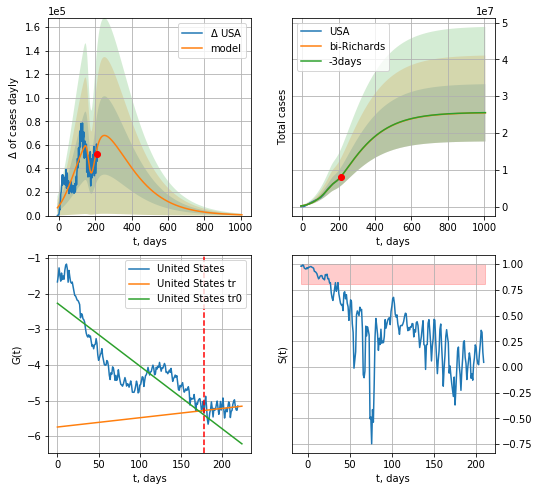

USA data at: 2020-10-13
+3 day model MAPE: 0.002466
model: bi-Richards
coeffs: [-1.60282975e+06  7.73236327e+00  8.91539444e+01  7.02769704e-03]
rational stdev: 0.305380
forecast at the end of period: +795 days
	 deltaDaycases: 679
	 total cases: 25483317 ± 7782082
	 total death: 695723 ± 637378
bi-Richards approximation splitting point: 178
trend coefficient of determination: 0.711614
 intercept: -2.272487
 slope: -0.017592
trend coefficient of determination: 0.035186
 intercept: -5.742510
 slope: 0.002607


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in power


In [520]:
iL = 6
vL = 178+iL#90+iL
x = forecastRR('USA',dfUS[iL:vL-iL],d1,7*32-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('USA',dfUS[iL:],d1,7*142-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [521]:
#x = forecastQR('USA',dfUS[20:],d1,7*18-dT,1.0,addpred=False,xcoef=[0.35,.5,3.,1.,1.])

GB
           date   cases  active    death
226 2020-10-09  575679       0  42679.0
227 2020-10-10  590844       0  42760.0
228 2020-10-11  603716       0  42825.0
229 2020-10-12  617688       0  42875.0
230 2020-10-13  634920       0  43018.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


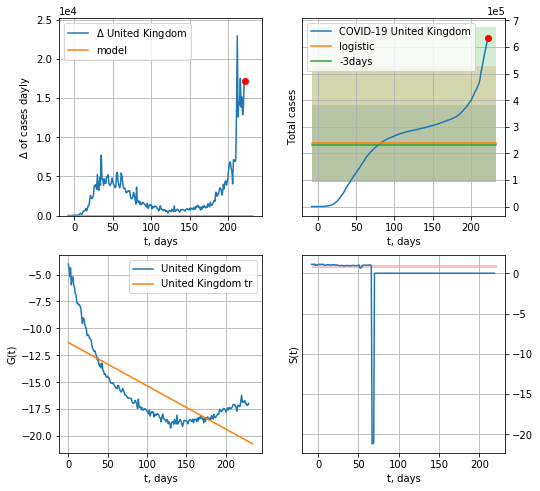

United Kingdom data at: 2020-10-13
+3 day model MAPE: 0.021551277026201413
model: logistic
coeffs:  [ 2.37684649e+05 -1.25263186e+01  3.15185626e+02]
rational stdev:  0.614401310065296
forecast at the end of period: +11 days
	 deltaDaycases:  0
	 total cases:  237684 ± 146033
	 total death:  16103 ± 29681
trend coefficient of determination: 0.561791
 intercept: -11.304958
 slope: -0.040233


In [522]:
try:
    dfGB = read_df(pd.DataFrame(),"GB")
    x = forecast('United Kingdom',dfGB[:],d1,7*T18-dT,1.)
    #x = forecast('United Kingdom',dfGB[:-8-dT],d1,4*7-dT,1.)
    #xx = forecast2('United Kingdom',dfGB[:],d1,4*7-dT,x,1.)
except:
    print ("Exception occurs")

In [523]:
#x = forecast('United Kingdom',dfGB[:],d1,T18*7-dT,1.,addpred=True,xcoef=[0.25,1.,1.8])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: divide by zero encountered in true_divide


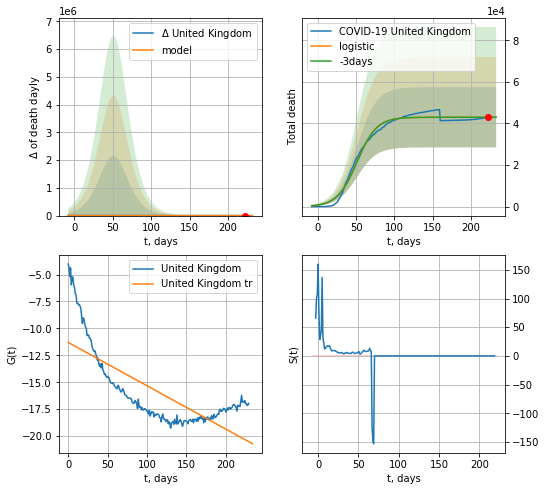

United Kingdom data at: 2020-10-13
+3 day model MAPE: 4.529390979546066e-05
model: logistic
coeffs:  [4.29824465e+04 7.84018988e-02 5.12416588e+01]
rational stdev:  0.33693549164895803
forecast at the end of period: +11 days
	 total death:  42982 ± 14482
trend coefficient of determination: 0.561791
 intercept: -11.304958
 slope: -0.040233


In [524]:
x = forecast('United Kingdom',dfGB[:],d1,T18*7-dT,1.,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


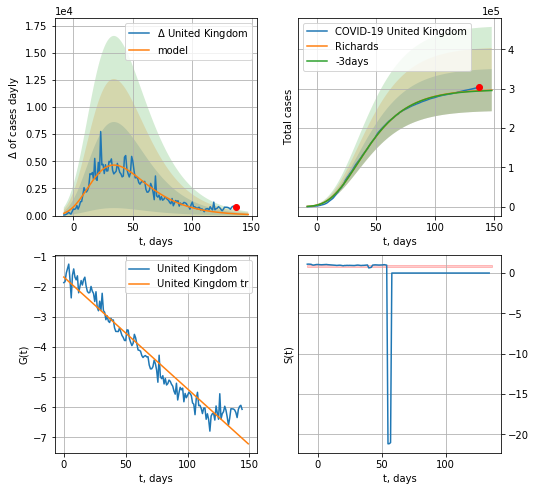

United Kingdom data at: 2020-10-13
+3 day model MAPE: 0.002835
model: Richards
coeffs: [ 2.98822585e+05  5.79672157e+00 -8.10771552e+01  7.33198786e-03]
rational stdev: 0.180965
forecast at the end of period: +11 days
	 deltaDaycases: 103
	 total cases: 296423 ± 53642
	 total death: 20083 ± 10902
trend coefficient of determination: 0.947055
 intercept: -1.683219
 slope: -0.037107


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


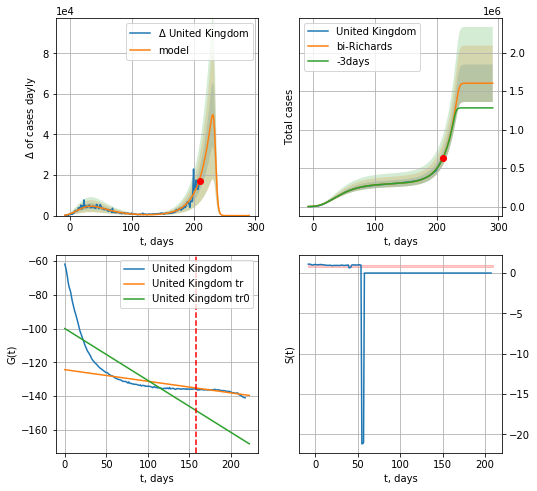

United Kingdom data at: 2020-10-13
+3 day model MAPE: 0.008314
model: bi-Richards
coeffs: [1.30468651e+06 5.30173849e-02 2.35808252e+02 1.02877184e+01]
rational stdev: 0.151989
forecast at the end of period: +81 days
	 deltaDaycases: 0
	 total cases: 1603503 ± 243714
	 total death: 108642 ± 49537
bi-Richards approximation splitting point: 158
trend coefficient of determination: 0.637512
 intercept: -99.991984
 slope: -0.307850
trend coefficient of determination: 0.749133
 intercept: -124.391560
 slope: -0.068791


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:62: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:62: RuntimeWarning: invalid value encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:183: RuntimeWarning: invalid value encountered in reduce
  arrmean = umr_sum(arr, axis, dtype, keepdims=True)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:75: RuntimeWarning: divide by zero encountered in true_divide


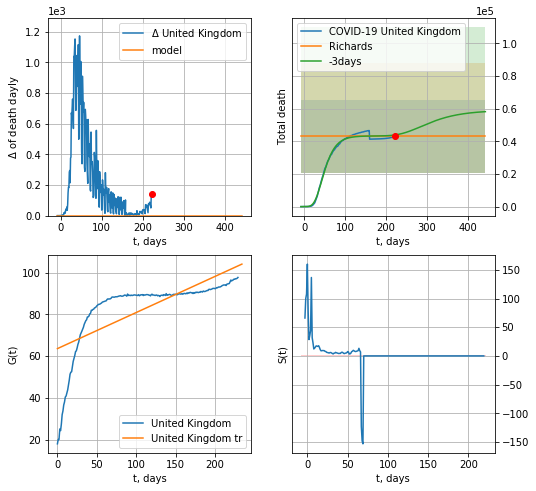

United Kingdom data at: 2020-10-13
+3 day model MAPE: 0.019309
model: Richards
coeffs: [ 3.16478833e+04 -7.68689408e+00 -5.90101212e+01 -7.58245008e+00]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.518311
forecast at the end of period: +221 days
	 total death: 43117 ± 22348
trend coefficient of determination: 0.512506
 intercept: 63.598767
 slope: 0.173039


In [525]:
vL = 170#143+12
x = forecastRR('United Kingdom',dfGB[12:vL-12],d1,30*7-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('United Kingdom',dfGB[12:],d1,40*7-dT,x,1.,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12)
x = forecastRR('United Kingdom',dfGB[:],d1,60*7-dT,1.,addpred=True,xcoef=RkoreaCoeffs,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


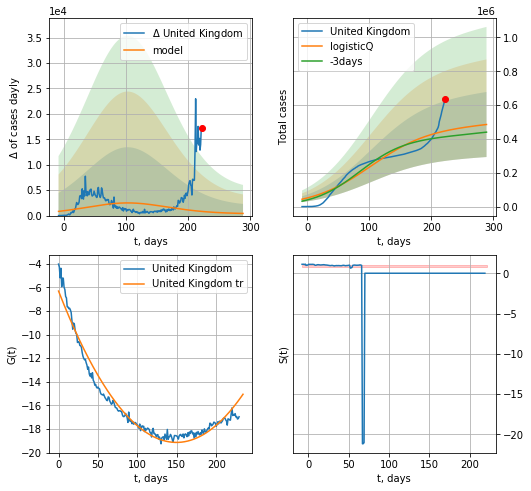

United Kingdom data at: 2020-10-13
+3 day model MAPE: 0.083495
model: logisticQ
coeffs: [ 4.68125971e+05  2.01311228e-08  1.02412613e+02 -1.03932474e+06]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.396153
forecast at the end of period: +67 days
	 deltaDaycases: 425
	 total cases: 485445 ± 192310
	 total death: 32890 ± 39088
trend coefficient of determination: 0.963880
 intercept_: -6.317239657210305
 coeffs_: [ 0.         -0.17148931  0.00057317]


In [526]:
x = forecastRRR('United Kingdom',dfGB[:],d1,38*7-dT,1.,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3,1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


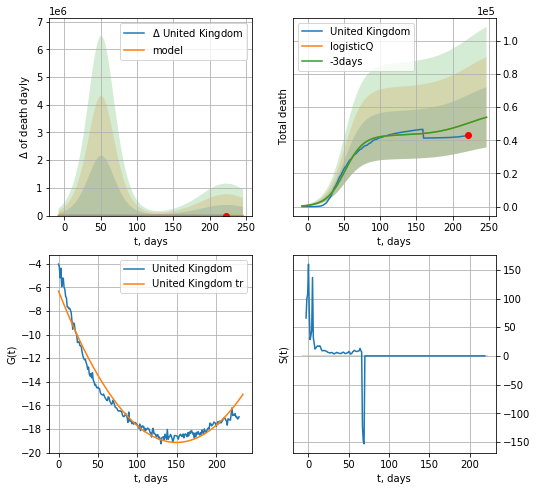

United Kingdom data at: 2020-10-13
+3 day model MAPE: 0.000013
model: logisticQ
coeffs: [ 4.29823324e+04  1.79069042e-07  5.12421333e+01 -4.37636957e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.336957
forecast at the end of period: +25 days
	 total death: 53906 ± 18164
trend coefficient of determination: 0.963880
 intercept_: -6.317239657210305
 coeffs_: [ 0.         -0.17148931  0.00057317]


In [527]:
x = forecastRRR('United Kingdom',dfGB[:],d1,32*7-dT,1.,addpred=True,xcoef=koreaCoeffs,cases='death')

In [528]:
#x = forecastQR('United Kingdom',dfGB[:],d1,18*7-dT,1.,addpred=True,xcoef=[0.35,.5,3,1,1])

In [529]:
#x = forecastR('United Kingdom',dfGB[:],d1,20*7-dT,1.,addpred=True,xcoef=[0.25,1.,2.4,1])

In [530]:
#trend3(dfDK,dfNG,dfSW[:],'DK','NG','SW',40,40,40)

In [531]:
#x = forecastR('United Kingdom',dfGB[:],d1,20*7-dT,1.,addpred=True,xcoef=[0.25,1.,4.,1])

In [532]:
#x = forecast('Denmark',dfDK[:15],d1,2*7-dT,1.0)
#xx = forecast2('Denmark',dfDK[:],d1,4*7-dT, x,1.0)
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3('Denmark',dfDK[:],d1,14-dT, xx)

DK
           date    cases  active  death
225 2020-10-09  31638.0    5471  665.0
226 2020-10-10  32082.0    5428  667.0
227 2020-10-11  32422.0    5373  669.0
228 2020-10-12  32811.0    5399  671.0
229 2020-10-13  33101.0    5202  674.0


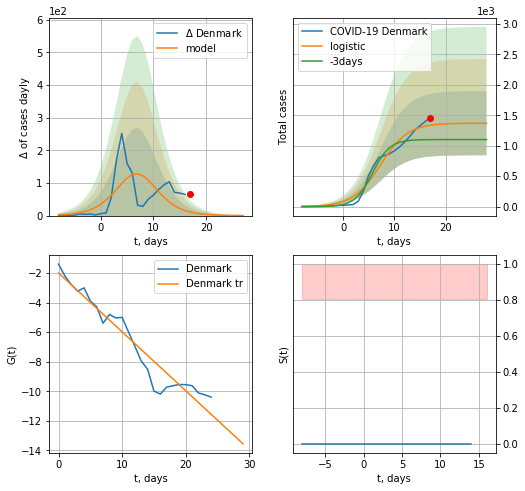

Denmark data at: 2020-10-13
+3 day model MAPE: 0.22309164797181072
model: logistic
coeffs:  [1.36966074e+03 3.75718857e-01 7.30059730e+00]
rational stdev:  0.3847660616131427
forecast at the end of period: +11 days
	 deltaDaycases:  0
	 total cases:  1369 ± 526
	 total death:  27 ± 31
trend coefficient of determination: 0.928037
 intercept: -1.984791
 slope: -0.399221


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:195: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


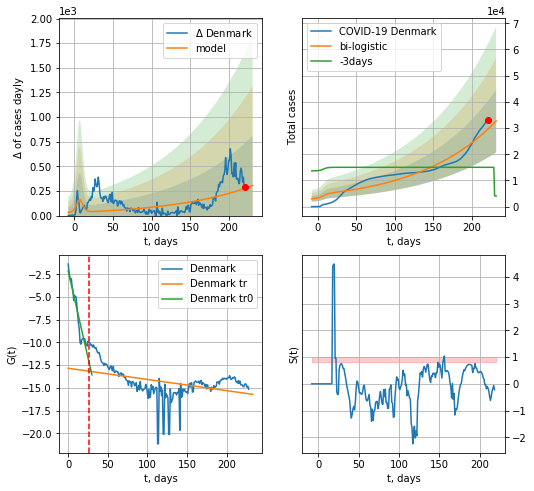

Denmark data at: 2020-10-13
+3 day model MAPE: 0.9831628989034777
model: bi-logistic
coeffs:  [3.61207747e+07 9.78732686e-03 9.52330591e+02] [1.36966074e+03 3.75718857e-01 7.30059730e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.3666147474115225
forecast at the end of period: +11 days
	 deltaDaycases:  304
	 total cases:  32671 ± 11977
	 total death:  665 ± 731
bi-logistic approximation splitting point: 26
trend0 coefficient of determination: 0.914728
 intercept: -2.128126
 slope: -0.381304
trend coefficient of determination: 0.168041
 intercept: -12.840686
 slope: -0.012302


In [533]:
dfDK = read_df(pd.DataFrame(),"DK")
vL = 26
try:
    x = forecast('Denmark',dfDK[:vL],d1,7*T18-dT,1.0)
    xx = forecast2('Denmark',dfDK[:],d1,T18*7-dT, x,1.0,addpred=True,xcoef=[0.25,1.,2.],vL=vL)
except:
    print("Exception occurs")

In [534]:
d12f(4)

'2020-10-10'

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


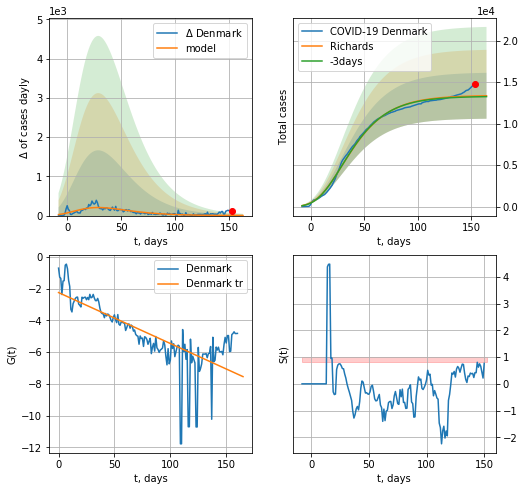

Denmark data at: 2020-10-13
+3 day model MAPE: 0.007554
model: Richards
coeffs: [ 1.34130300e+04  7.49026131e+00 -9.48203706e+01  5.58236421e-03]
rational stdev: 0.207033
forecast at the end of period: +11 days
	 deltaDaycases: 2
	 total cases: 13365 ± 2767
	 total death: 272 ± 168
trend coefficient of determination: 0.554551
 intercept: -2.245446
 slope: -0.032115


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


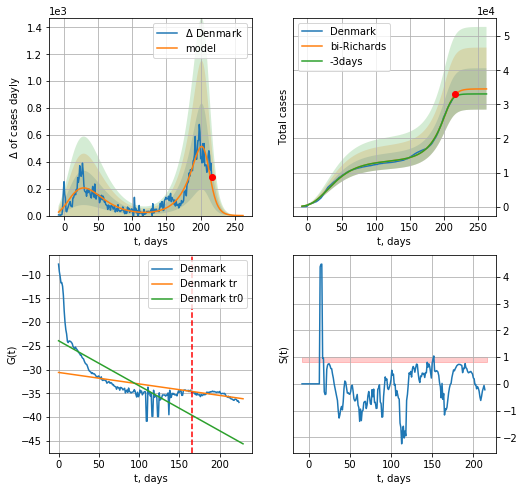

Denmark data at: 2020-10-13
+3 day model MAPE: 0.020328
model: bi-Richards
coeffs: [2.11100472e+04 5.08907118e-02 2.09106488e+02 3.08915865e+00]
rational stdev: 0.175630
forecast at the end of period: +46 days
	 deltaDaycases: 0
	 total cases: 34520 ± 6062
	 total death: 702 ± 369
bi-Richards approximation splitting point: 166
trend coefficient of determination: 0.591050
 intercept: -23.923540
 slope: -0.094660
trend coefficient of determination: 0.429859
 intercept: -30.588687
 slope: -0.024161


In [536]:
vL = 170#125+4
x = forecastRR('Denmark',dfDK[4:vL-4],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Denmark',dfDK[4:],d1,35*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-4)
#x2 = forecast2R('Denmark',dfDK[:],d1,16*7-dT,x,1.0)

In [537]:
#x = forecastRRR('Denmark',dfDK[:18],d1,T18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[0.35,0.5,4.5,1.])
#x = forecast2RRR('Denmark',dfDK[:],d1,26*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=18)

NG
           date    cases  active  death
226 2020-10-09  15388.0    3250  275.0
227 2020-10-10  15466.0    3328  275.0
228 2020-10-11  15524.0    3386  275.0
229 2020-10-12  15639.0    3500  276.0
230 2020-10-13  15793.0    3653  277.0


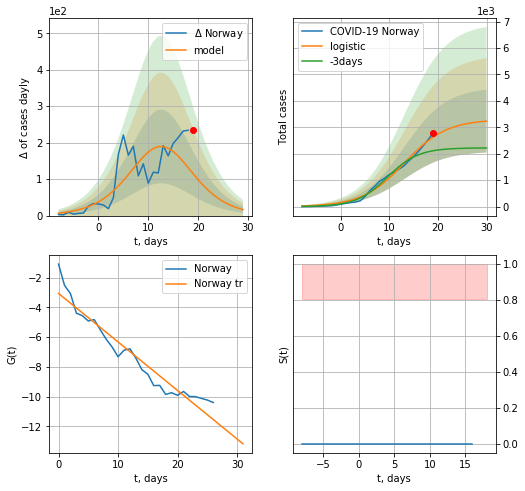

Norway data at: 2020-10-13
+3 day model MAPE: 0.28148190042351234
model: logistic
coeffs:  [3.29798793e+03 2.30651156e-01 1.30696563e+01]
rational stdev:  0.36743919108062534
forecast at the end of period: +11 days
	 deltaDaycases:  16
	 total cases:  3232 ± 1187
	 total death:  56 ± 61
trend coefficient of determination: 0.927855
 intercept: -3.067798
 slope: -0.326083


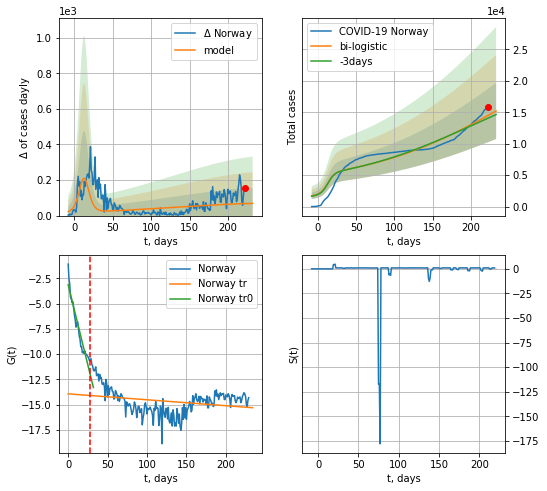

Norway data at: 2020-10-13
+3 day model MAPE: 0.03039226158087051
model: bi-logistic
coeffs:  [2.75146166e+04 1.01594966e-02 2.59718169e+02] [3.29798793e+03 2.30651156e-01 1.30696563e+01]
rational stdev:  0.2929740343876238
forecast at the end of period: +11 days
	 deltaDaycases:  68
	 total cases:  15199 ± 4453
	 total death:  266 ± 233
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.925279
 intercept: -3.146002
 slope: -0.317060
trend coefficient of determination: 0.067636
 intercept: -13.917720
 slope: -0.005855


In [538]:
dfNG = read_df(pd.DataFrame(),"NG")
vL=28
x = forecast('Norway',dfNG[:vL],d1,7*T18-dT,1.0)
xx = forecast2('Norway',dfNG[:],d1,T18*7-dT,x,1.0,vL=vL)
#xx = np.concatenate((x, xx), axis=0)

In [539]:
vL = 28#len(dfNG)-13-dT
#x = forecast('Norway',dfNG[:-12-dT],d1,7*T18-dT,1.0)
#xx = forecast2('Norway',dfNG[:],d1,T18*7-dT,x,1.0,addpred=True,xcoef=[0.25/2,1.,2.],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


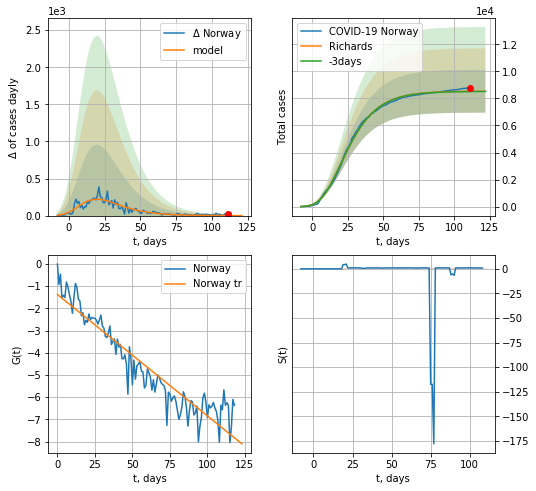

Norway data at: 2020-10-13
+3 day model MAPE: 0.002349
model: Richards
coeffs: [ 8.53893504e+03  9.40298407e+00 -4.93140335e+01  7.49676920e-03]
rational stdev: 0.185681
forecast at the end of period: +11 days
	 deltaDaycases: 0
	 total cases: 8532 ± 1584
	 total death: 149 ± 82
trend coefficient of determination: 0.886133
 intercept: -1.376205
 slope: -0.054692


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


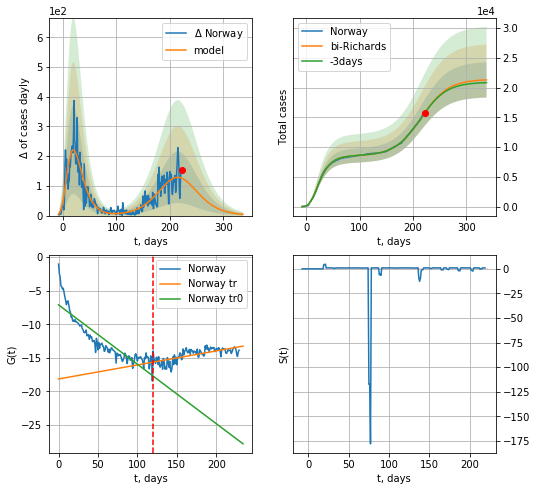

Norway data at: 2020-10-13
+3 day model MAPE: 0.001553
model: bi-Richards
coeffs: [1.28730219e+04 4.13422099e-02 2.14218815e+02 9.54824553e-01]
rational stdev: 0.139315
forecast at the end of period: +116 days
	 deltaDaycases: 4
	 total cases: 21310 ± 2968
	 total death: 373 ± 155
bi-Richards approximation splitting point: 120
trend coefficient of determination: 0.800100
 intercept: -7.113111
 slope: -0.088440
trend coefficient of determination: 0.491712
 intercept: -18.150839
 slope: 0.020874


In [540]:
vL = 120#96+22
x = forecastRR('Norway',dfNG[:vL],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Norway',dfNG[:],d1,45*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastQR('Norway',dfNG[:],d1,8*7-dT,1.0)

In [541]:
#x = forecastRRR('Norway',dfNG[:],d1,T18*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,4.,1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


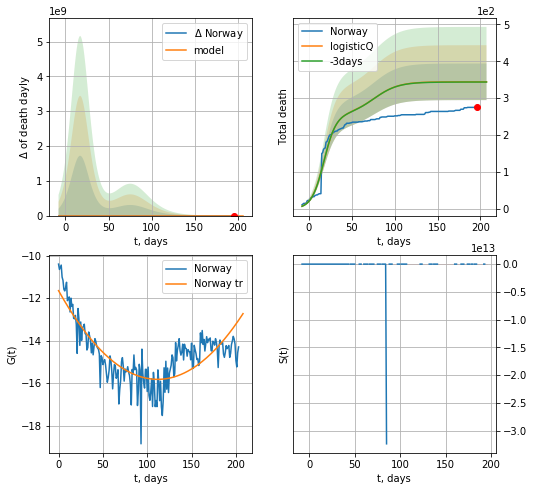

Norway data at: 2020-10-13
+3 day model MAPE: 0.001849
model: logisticQ
coeffs: [ 2.54241540e+02  1.97216317e-07  1.74365319e+01 -7.10110739e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.143972
forecast at the end of period: +11 days
	 total death: 344 ± 49
trend coefficient of determination: 0.660086
 intercept_: -11.64979696725603
 coeffs_: [ 0.         -0.07466792  0.00033399]


In [542]:
x = forecastRRR('Norway',dfNG[26:],d1,T18*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,4.,1])

SW
           date   cases  active   death
227 2020-10-09   98451       0  5894.0
228 2020-10-10   98997       0  5894.0
229 2020-10-11   99546       0  5894.0
230 2020-10-12  100098       0  5894.0
231 2020-10-13  100654       0  5899.0


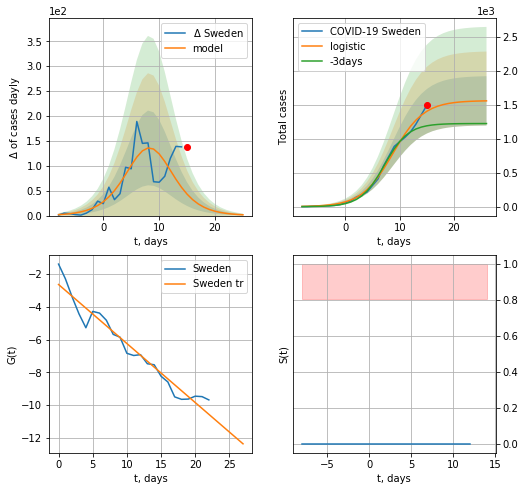

Sweden data at: 2020-10-13
+3 day model MAPE: 0.20348254679733155
model: logistic
coeffs:  [1.56232986e+03 3.49134536e-01 8.72829156e+00]
rational stdev:  0.2329336409619122
forecast at the end of period: +11 days
	 deltaDaycases:  1
	 total cases:  1558 ± 363
	 total death:  91 ± 63
trend coefficient of determination: 0.947679
 intercept: -2.633085
 slope: -0.360867


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


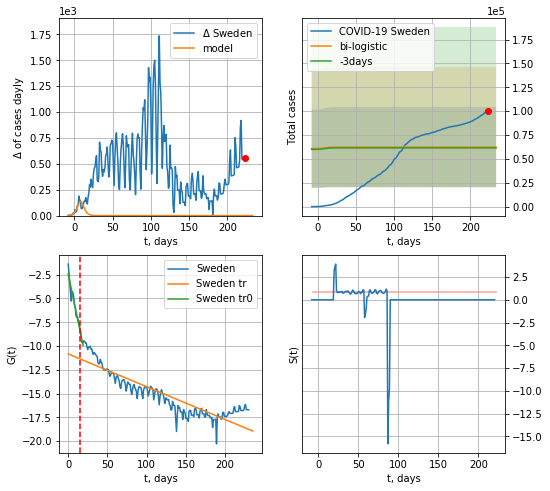

Sweden data at: 2020-10-13
+3 day model MAPE: 0.013297866726906119
model: bi-logistic
coeffs:  [ 4.85999682e+04 -1.77283158e+01  4.35037044e+02] [1.56232986e+03 3.49134536e-01 8.72829156e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.6734446899980789
forecast at the end of period: +11 days
	 deltaDaycases:  0
	 total cases:  62312 ± 41963
	 total death:  3651 ± 7376
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.906612
 intercept: -2.393320
 slope: -0.396924
trend coefficient of determination: 0.801786
 intercept: -10.834138
 slope: -0.034515


In [544]:
vL = 15#len(dfSW)-12-dT
dfSW = read_df(pd.DataFrame(),"SW")
try:
    x = forecast('Sweden',dfSW[:-9-dT],d1,7*T18-dT,1.0)
    xx = forecast2('Sweden',dfSW[:],d1,7*T18-dT,x,1.0,addpred=True,xcoef=[.25,1.,2.],vL=vL)
except:
    print ("Exception occurs")

SW
           date   cases  active   death
227 2020-10-09   98451       0  5894.0
228 2020-10-10   98997       0  5894.0
229 2020-10-11   99546       0  5894.0
230 2020-10-12  100098       0  5894.0
231 2020-10-13  100654       0  5899.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: invalid value encountered in true_divide


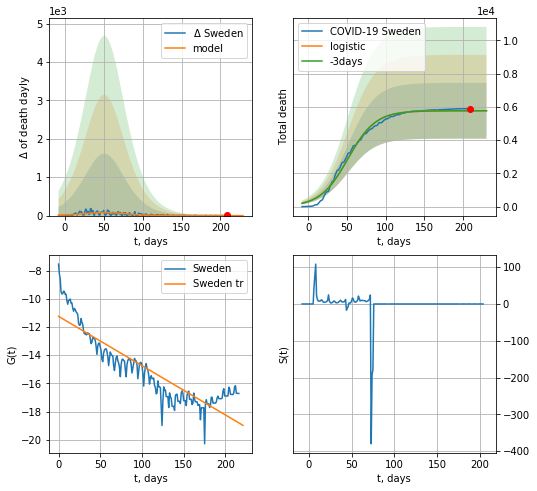

Sweden data at: 2020-10-13
+3 day model MAPE: 0.0007678770080451617
model: logistic
coeffs:  [5.77094192e+03 5.61980531e-02 5.12355339e+01]
rational stdev:  0.291353815231462
forecast at the end of period: +21 days
	 total death:  5770 ± 1681
trend coefficient of determination: 0.799613
 intercept: -11.248243
 slope: -0.034994


In [545]:
dfSW = read_df(pd.DataFrame(),"SW")
x = forecast('Sweden',dfSW[14:],d1,3*7,shift=1.0,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


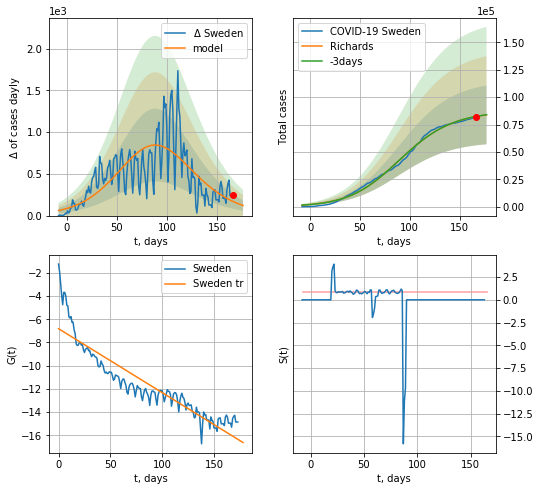

Sweden data at: 2020-10-13
+3 day model MAPE: 0.001760
model: Richards
coeffs: [8.71843177e+04 4.55229088e-02 8.26211178e+01 7.98672029e-01]
rational stdev: 0.319982
forecast at the end of period: +11 days
	 deltaDaycases: 121
	 total cases: 83778 ± 26807
	 total death: 4909 ± 4712
trend coefficient of determination: 0.834131
 intercept: -6.814403
 slope: -0.055119


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


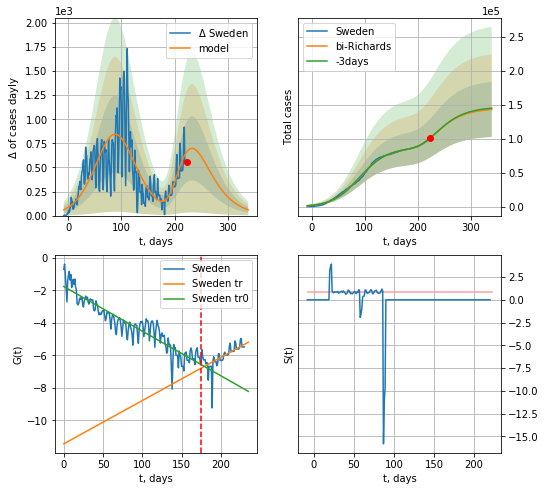

Sweden data at: 2020-10-13
+3 day model MAPE: 0.000421
model: bi-Richards
coeffs: [5.76247766e+04 1.32561122e+00 1.20041878e+02 2.45704118e-02]
rational stdev: 0.283222
forecast at the end of period: +116 days
	 deltaDaycases: 60
	 total cases: 142955 ± 40488
	 total death: 8378 ± 7118
bi-Richards approximation splitting point: 175
trend coefficient of determination: 0.861401
 intercept: -1.763016
 slope: -0.027427
trend coefficient of determination: 0.433015
 intercept: -11.434547
 slope: 0.026589


In [546]:
iL = 0
vL = 175+iL
x = forecastRR('Sweden',dfSW[iL:vL-iL],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Sweden',dfSW[iL:],d1,45*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:75: RuntimeWarning: invalid value encountered in true_divide


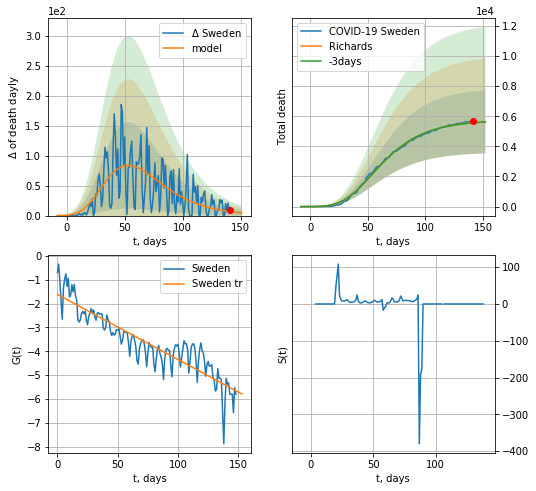

Sweden data at: 2020-10-13
+3 day model MAPE: 0.002445
model: Richards
coeffs: [ 5.75133549e+03  5.79293366e+00 -7.21072797e+01  6.85063513e-03]
rational stdev: 0.372383
forecast at the end of period: +11 days
	 total death: 5637 ± 2099
trend coefficient of determination: 0.814804
 intercept: -1.618399
 slope: -0.027247


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in power
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:209: RuntimeWarning: invalid value encountered in true_divide


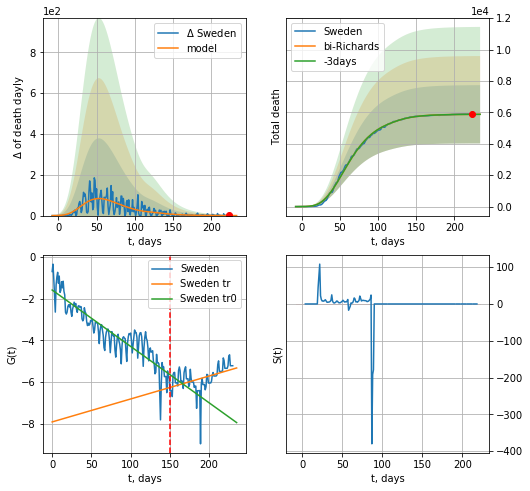

Sweden data at: 2020-10-13
+3 day model MAPE: 0.000285
model: bi-Richards
coeffs: [1.28286985e+02 4.93063295e+01 4.51211502e+01 1.57605776e-03]
rational stdev: 0.315632
forecast at the end of period: +11 days
	 total death: 5875 ± 1854
bi-Richards approximation splitting point: 150
trend coefficient of determination: 0.816791
 intercept: -1.583276
 slope: -0.027076
trend coefficient of determination: 0.192846
 intercept: -7.914287
 slope: 0.011023


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in power


In [547]:
vL = 150
x = forecastRR('Sweden',dfSW[:vL],d1,30*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs,cases='death')
xx = forecast2RR('Sweden',dfSW[:],d1,30*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,cases='death',vL=vL)
#x = forecastQR('Sweden',dfSW[:],d1,16*7-dT,1.0)
#xx = forecast2R('Sweden',dfSW[:],d1,12*7-dT,x,1.0)#,addpred=True,xcoef=[0.25,1.,2.3,1]

In [548]:
#x = forecastRRR('Sweden',dfSW[1:],d1,55*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


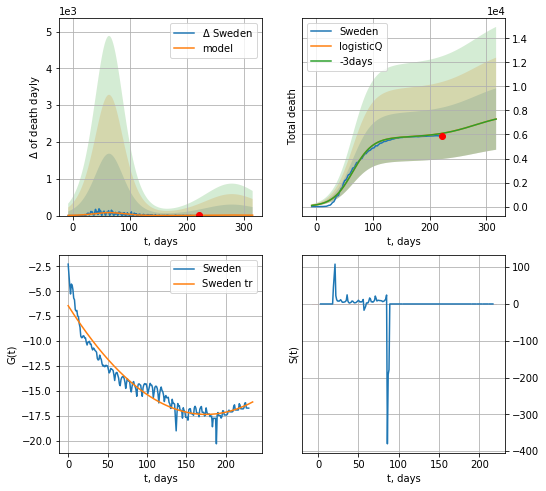

Sweden data at: 2020-10-13
+3 day model MAPE: 0.000662
model: logisticQ
coeffs: [ 5.76744155e+03  1.03742492e-07  6.42298912e+01 -5.45977101e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.350579
forecast at the end of period: +95 days
	 total death: 7282 ± 2553
trend coefficient of determination: 0.933095
 intercept_: -6.44838134470486
 coeffs_: [ 0.         -0.12467354  0.00035658]


In [549]:
x = forecastRRR('Sweden',dfSW[1:],d1,42*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')

CN
           date    cases  active   death
261 2020-10-09  85536.0     206  4634.0
262 2020-10-10  85557.0     218  4634.0
263 2020-10-11  85578.0     230  4634.0
264 2020-10-12  85591.0     228  4634.0
265 2020-10-13  85611.0     241  4634.0


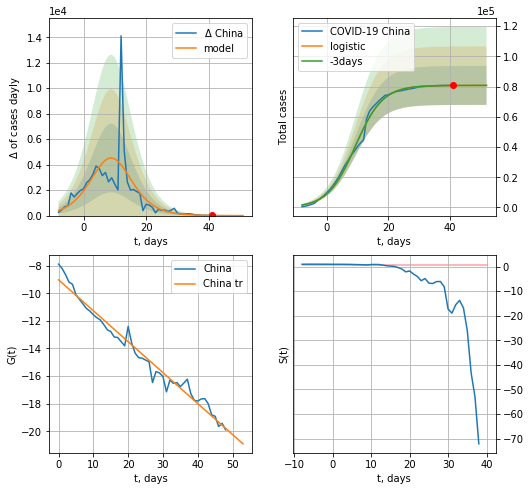

China data at: 2020-10-13
+3 day model MAPE: 0.00012785692963974442
model: logistic
coeffs:  [8.08101838e+04 2.24512818e-01 9.29453373e+00]
rational stdev:  0.159713160092933
forecast at the end of period: +11 days
	 deltaDaycases:  1
	 total cases:  80804 ± 12905
	 total death:  4373 ± 2095
trend coefficient of determination: 0.972183
 intercept: -9.021396
 slope: -0.224243


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


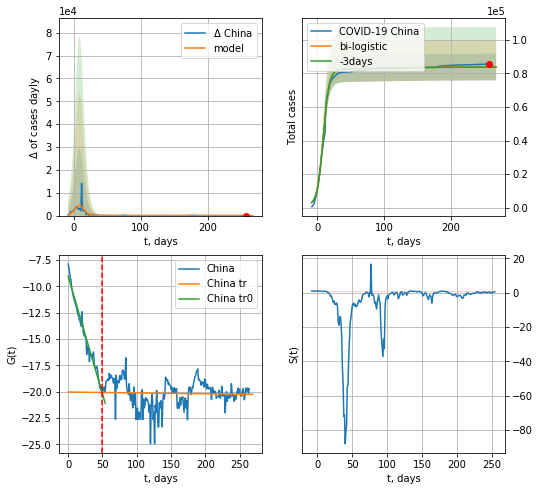

China data at: 2020-10-13
+3 day model MAPE: 0.00039291350347679205
model: bi-logistic
coeffs:  [3.14595491e+03 1.38103573e-02 1.01710963e+01] [8.08101838e+04 2.24512818e-01 9.29453373e+00]
rational stdev:  0.09506636461586472
forecast at the end of period: +11 days
	 deltaDaycases:  1
	 total cases:  83869 ± 7973
	 total death:  4539 ± 1294
bi-logistic approximation splitting point: 50
trend0 coefficient of determination: 0.973282
 intercept: -9.036652
 slope: -0.223289
trend coefficient of determination: 0.001745
 intercept: -20.036483
 slope: -0.000825


In [550]:
dfCN = read_df(pd.DataFrame(),"CN")
try:
    x = forecast('China',dfCN[:50],d1,7*T18-dT,1.0)
    #xx = forecast('China',dfCN[21:-32],d1,17)
    #xx = np.concatenate((x, xx), axis=0)
    xx = forecast2('China',dfCN[:],d1,T18*7-dT,x,1.0,vL=50)
except:
    print ("Exception occurs")

In [551]:
#dfTT[dfTT.Country=='%s'%('China')][0].values[0]

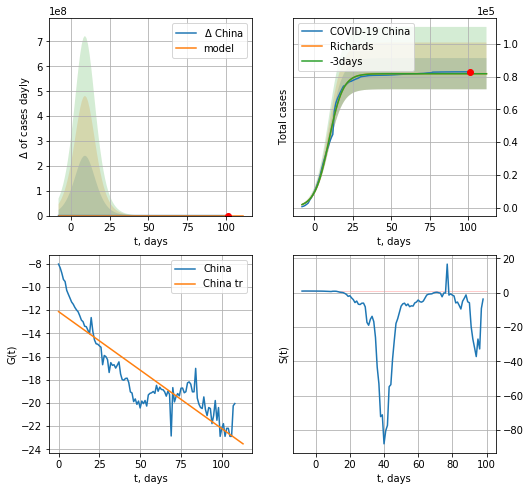

China data at: 2020-10-13
+3 day model MAPE: 0.000627
model: Richards
coeffs: [8.17736184e+04 2.15574455e-01 9.59539709e+00 1.02116174e+00]
rational stdev: 0.116457
forecast at the end of period: +11 days
	 deltaDaycases: 0
	 total cases: 81773 ± 9523
	 total death: 4426 ± 1546
trend coefficient of determination: 0.785239
 intercept: -12.125055
 slope: -0.100960


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


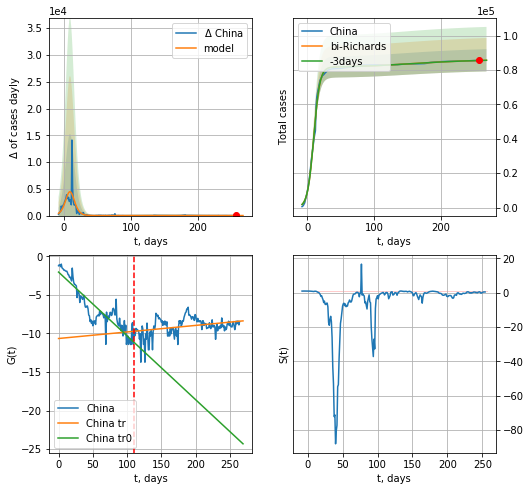

China data at: 2020-10-13
+3 day model MAPE: 0.000121
model: bi-Richards
coeffs: [ 4.67201035e+03  1.51195852e+00 -1.87315101e+02  9.28947775e-03]
rational stdev: 0.075508
forecast at the end of period: +11 days
	 deltaDaycases: 9
	 total cases: 85677 ± 6469
	 total death: 4637 ± 1050
bi-Richards approximation splitting point: 110
trend coefficient of determination: 0.820972
 intercept: -2.046115
 slope: -0.082797
trend coefficient of determination: 0.115740
 intercept: -10.661227
 slope: 0.008496


In [552]:
vL = 110
x = forecastRR('China',dfCN[:vL],d1,T18*7-dT,1.0)
xx = forecast2RR('China',dfCN[:],d1,30*7-dT,x,1.0,vL=vL)
#x = forecastQR('China',dfCN[:],d1,6*7-dT,1.0)
#xx = forecast('China',dfCN[21:-32],d1,17)
#xx = np.concatenate((x, xx), axis=0)
#xx = forecast2R('China',dfCN[:],d1,6*7-dT,x,1.0)

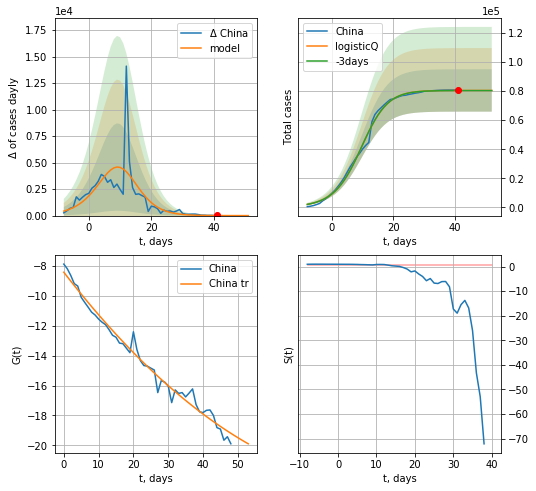

China data at: 2020-10-13
+3 day model MAPE: 0.001323
model: logisticQ
coeffs: [ 8.04175259e+04  1.07650464e-03  9.35257489e+00 -2.02425637e+02]
rational stdev: 0.181019
forecast at the end of period: +11 days
	 deltaDaycases: 0
	 total cases: 80416 ± 14556
	 total death: 4352 ± 2363
trend coefficient of determination: 0.979964
 intercept_: -8.428864441790822
 coeffs_: [ 0.         -0.29994819  0.00157784]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


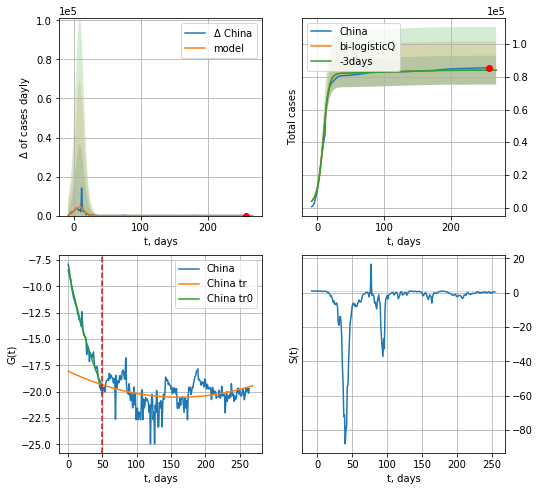

China data at: 2020-10-13
+3 day model MAPE: 0.000472
model: bi-logisticQ
coeffs: [ 3.69360667e+03  1.00722284e-04  2.47710188e+01 -5.73148557e-02]
rational stdev: 0.104873
forecast at the end of period: +11 days
	 deltaDaycases: 0
	 total cases: 84105 ± 8820
	 total death: 4552 ± 1432
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.980847
 intercept_: -8.442415731989867
 coeffs_: [ 0.         -0.29762768  0.00151769]
trend coefficient of determination: 0.073251
 intercept_: -18.059286613292112
 coeffs_: [ 0.00000000e+00 -3.06769456e-02  9.50715257e-05]


In [553]:
x = forecastRRR('China',dfCN[:50],d1,7*T18-dT,1.0)
xx=forecast2RRR('China',dfCN[:],d1,T18*7-dT,x,1.0,vL=50)

In [554]:
#x = forecastQR('China',dfCN[50:],d1,6*7-dT,1.0)

KR
           date  cases  active  death
237 2020-10-09  24548  1494.0  430.0
238 2020-10-10  24606  1481.0  432.0
239 2020-10-11  24703  1541.0  433.0
240 2020-10-12  24805  1508.0  434.0
241 2020-10-13  24889  1421.0  438.0


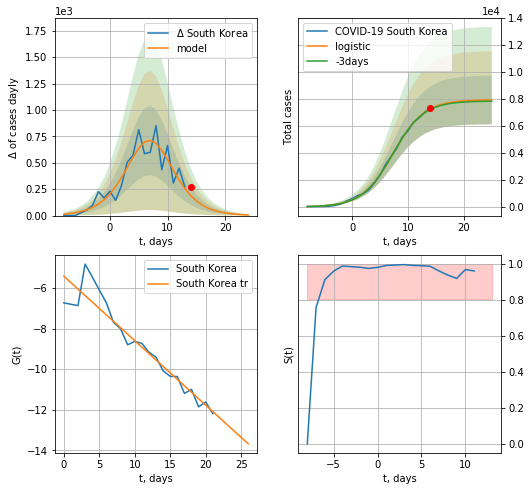

South Korea data at: 2020-10-13
model: logistic
coeffs:  [7.94116797e+03 3.59786702e-01 7.37445793e+00]
rational stdev:  0.2275932520547523
forecast at the end of period: +11 days
	 deltaDaycases:  6
	 total cases:  7927 ± 1804
	 total death:  139 ± 94
trend coefficient of determination: 0.904554
 intercept: -5.419235
 slope: -0.317547


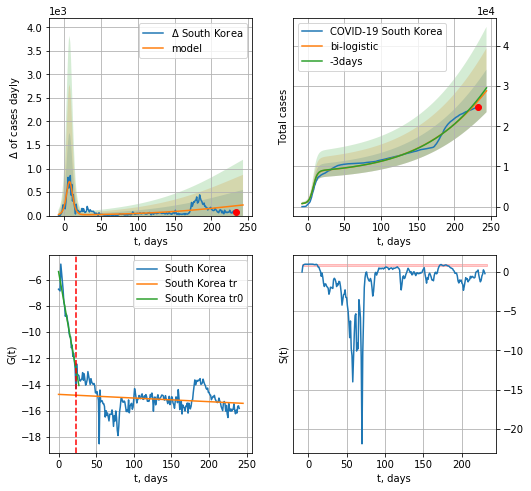

South Korea data at: 2020-10-13
+3 day model MAPE: 0.017922540429120698
model: bi-logistic
coeffs:  [8.56820797e+04 1.43360892e-02 3.23151423e+02] [7.94116797e+03 3.59786702e-01 7.37445793e+00]
rational stdev:  0.1840446808848304
forecast at the end of period: +11 days
	 deltaDaycases:  225
	 total cases:  28786 ± 5298
	 total death:  506 ± 279
bi-logistic approximation splitting point: 23
trend0 coefficient of determination: 0.916463
 intercept: -5.394262
 slope: -0.321115
trend coefficient of determination: 0.035554
 intercept: -14.744379
 slope: -0.002780


In [555]:
dfKR = read_df(pd.DataFrame(),"KR")
x = forecast('South Korea',dfKR[:23],d1,7*T18-dT,1.0,pMAPE=False)
xx=forecast2('South Korea',dfKR[:],d1,T18*7-dT,x,1.0,vL=23)

In [556]:
#vL = 30
#x = forecastRRR('South Korea',dfKR[:vL],d1,8*7-dT,1.0)
#x1 = forecastRRR('South Korea',dfKR[39:],d1,12*7-dT,1.0)
#xx = np.concatenate((x, x1), axis=0)
#xx=forecast2RRR('South Korea',dfKR[:],d1,8*7-dT,x,1.0,vL=vL)

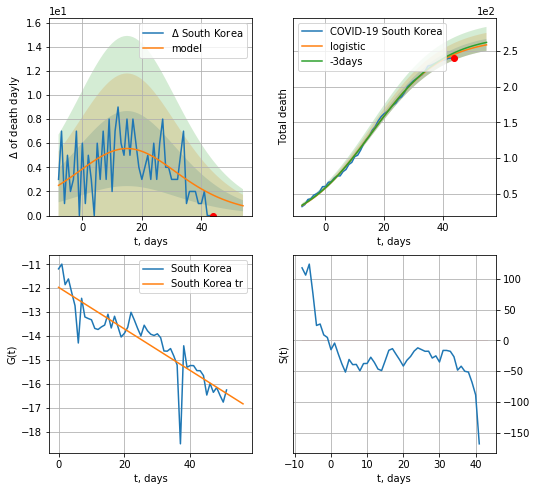

South Korea data at: 2020-10-13
model: logistic
coeffs:  [2.68513907e+02 8.28168907e-02 1.55065021e+01]
rational stdev:  0.032418936831668854
forecast at the end of period: +11 days
	 total death:  258 ± 8
trend coefficient of determination: 0.782213
 intercept: -11.965009
 slope: -0.087016


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:251: RuntimeWarning: divide by zero encountered in true_divide


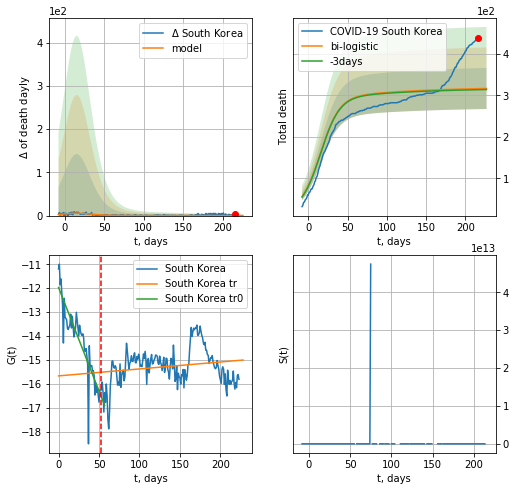

South Korea data at: 2020-10-13
+3 day model MAPE: 0.008021196427481234
model: bi-logistic
coeffs:  [5.10319182e+01 1.25104911e-02 9.77643477e+00] [2.68513907e+02 8.28168907e-02 1.55065021e+01]
rational stdev:  0.15609324733033098
forecast at the end of period: +11 days
	 deltaDaydeath:  0
	 total death:  316 ± 49
bi-logistic approximation splitting point: 53
trend0 coefficient of determination: 0.789613
 intercept: -11.973248
 slope: -0.086531
trend coefficient of determination: 0.037717
 intercept: -15.668520
 slope: 0.002907


In [557]:
x = forecast('South Korea',dfKR[17:70],d1,T18*7-dT,1.0,cases='death',pMAPE=False)
xx=forecast2('South Korea',dfKR[17:],d1,T18*7-dT,x,1.0,vL=70-17,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


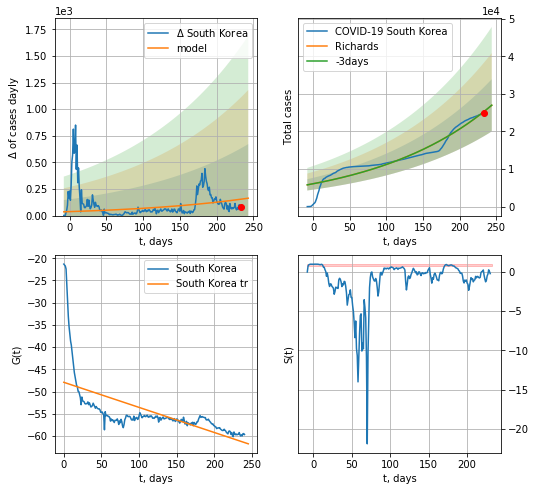

South Korea data at: 2020-10-13
+3 day model MAPE: 0.001078
model: Richards
coeffs: [3.50098232e+05 6.08496760e-03 6.65295783e+02 5.33186639e+00]
rational stdev: 0.257655
forecast at the end of period: +11 days
	 deltaDaycases: 163
	 total cases: 26967 ± 6948
	 total death: 474 ± 366
trend coefficient of determination: 0.390077
 intercept: -47.908720
 slope: -0.056487


In [558]:
x = forecastRR('South Korea',dfKR[:],d1,T18*7-dT,1.0)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


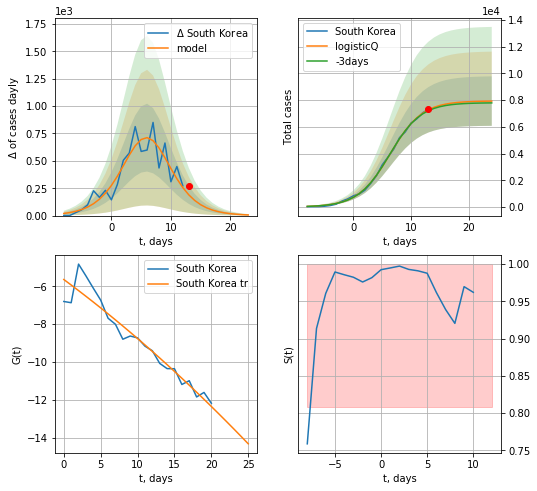

South Korea data at: 2020-10-13
+3 day model MAPE: 0.011158
model: logisticQ
coeffs: [ 7.93644740e+03  5.70893336e-05  6.37140939e+00 -6.30084107e+03]
rational stdev: 0.233522
forecast at the end of period: +11 days
	 deltaDaycases: 5
	 total cases: 7922 ± 1850
	 total death: 139 ± 97
trend coefficient of determination: 0.923340
 intercept_: -5.639271391154587
 coeffs_: [ 0.         -0.28882126 -0.00235709]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


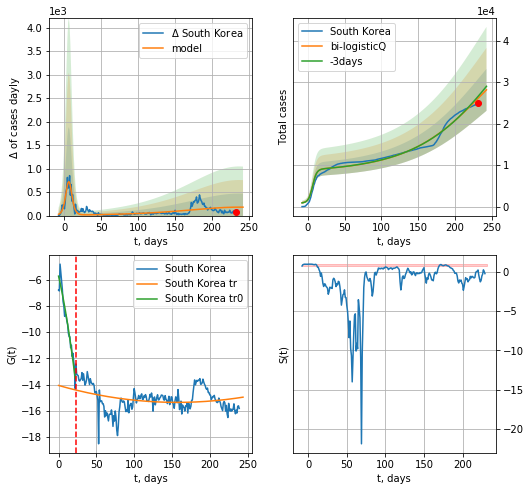

South Korea data at: 2020-10-13
+3 day model MAPE: 0.019075
model: bi-logisticQ
coeffs: [ 3.49159916e+04  2.14112039e-05  2.27584300e+02 -7.25222440e+02]
rational stdev: 0.179423
forecast at the end of period: +11 days
	 deltaDaycases: 179
	 total cases: 28160 ± 5052
	 total death: 495 ± 266
bi-logisticQ approximation splitting point: 23
trend coefficient of determination: 0.939645
 intercept_: -5.742054822567119
 coeffs_: [ 0.         -0.24685696 -0.00483449]
trend coefficient of determination: 0.072774
 intercept_: -14.064813086029309
 coeffs_: [ 0.00000000e+00 -1.64372966e-02  5.23800533e-05]


In [559]:
vL=23
x = forecastRRR('South Korea',dfKR[1:vL],d1,T18*7-dT,1.0)
xx=forecast2RRR('South Korea',dfKR[1:],d1,T18*7-dT,x,1.0,vL=vL)

In [560]:
#x = forecastRR('South Korea',dfKR[68:],d1,10*7-dT,1.0)

In [561]:
#vL=25
#x = forecastQR('South Korea',dfKR[1:vL],d1,16*7-dT,1.0)
#xx=forecast2QR('South Korea',dfKR[1:],d1,16*7-dT,x,1.0,vL=vL)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


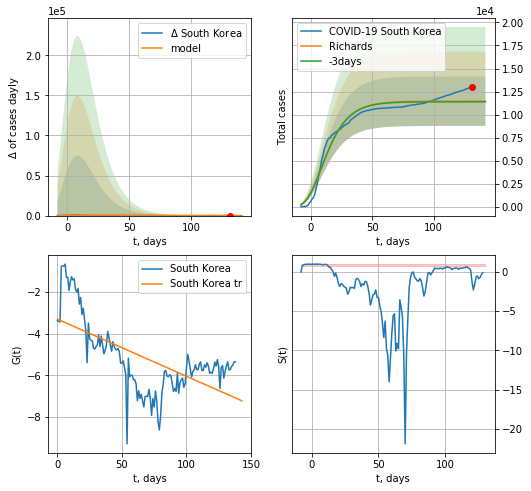

South Korea data at: 2020-10-13
+3 day model MAPE: 0.006245
model: Richards
coeffs: [ 1.14621909e+04  2.64955361e+01 -6.29475021e+01  3.05260511e-03]
rational stdev: 0.234092
forecast at the end of period: +11 days
	 deltaDaycases: 0
	 total cases: 11461 ± 2683
	 total death: 201 ± 141
trend coefficient of determination: 0.403266
 intercept: -3.307543
 slope: -0.027367


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


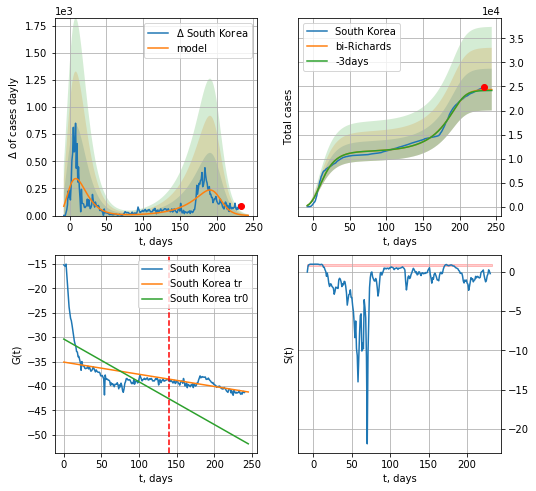

South Korea data at: 2020-10-13
+3 day model MAPE: 0.007261
model: bi-Richards
coeffs: [1.29140642e+04 3.60531759e-02 2.01280421e+02 3.52015924e+00]
rational stdev: 0.178278
forecast at the end of period: +11 days
	 deltaDaycases: 2
	 total cases: 24360 ± 4342
	 total death: 428 ± 228
bi-Richards approximation splitting point: 140
trend coefficient of determination: 0.425994
 intercept: -30.397601
 slope: -0.087464
trend coefficient of determination: 0.506333
 intercept: -35.108248
 slope: -0.024930


In [562]:
iL = 0
vL = 140+iL
x = forecastRR('South Korea',dfKR[iL:vL-iL],d1,T18*7-dT,1.0)
xx=forecast2RR('South Korea',dfKR[iL:],d1,30*7-dT,x,1.0,vL=vL-iL)
#xx = np.concatenate((x, xx), axis=0)
#print (xx)
#xxx=forecast3RR('South Korea',dfKR[1:],d1,12*7-dT,xx,1.0,vL=[vL,vL1],zoom=1e3)

In [563]:
a = np.array([ 7.90607495e+03,  3.14377481e-03, -1.32150046e+02,  5.22462480e+00, 7.59593205e-01])
b = np.array([ 2.91876181e+03,  1.43325056e-01, -3.99886263e+01, -3.39427361e+02, 1.77367535e-03])
QRkoreaCoeffs=b/a
QRkoreaCoeffs,RkoreaCoeffs,koreaCoeffs

(array([ 3.69179628e-01,  4.55901153e+01,  3.02600169e-01, -6.49668395e+01,
         2.33503320e-03]),
 [0.36242246, 2.56241634, 1.84890887, 0.13324732],
 [0.35416971, 0.02606324, 4.35859408, 19.30413219])

In [564]:
#x = forecastQR('South Korea',dfKR[:],d1,16*7-dT,1.0)

SG
           date    cases  active  death
260 2020-10-09  57866.0     164   27.0
261 2020-10-10  57876.0     151   27.0
262 2020-10-11  57880.0     148   27.0
263 2020-10-12  57884.0     128   28.0
264 2020-10-13  57889.0     121   28.0


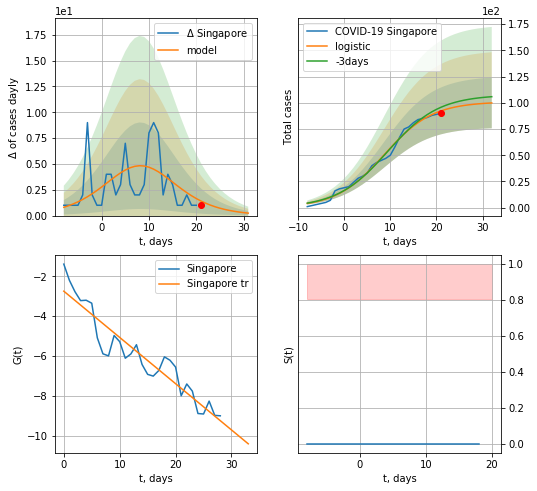

Singapore data at: 2020-10-13
+3 day model MAPE: 0.03963437966370839
model: logistic
coeffs:  [101.02990869   0.19128696   8.67555654]
rational stdev:  0.24212715882466435
forecast at the end of period: +11 days
	 deltaDaycases:  0
	 total cases:  99 ± 24
	 total death:  0 ± 0
trend coefficient of determination: 0.887345
 intercept: -2.744831
 slope: -0.232145


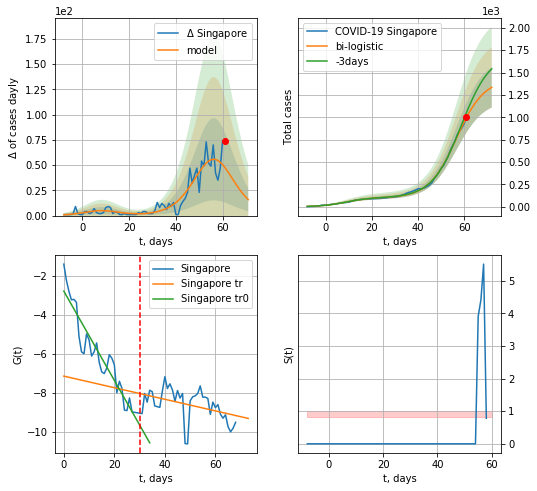

Singapore data at: 2020-10-13
+3 day model MAPE: 0.06119827726371909
model: bi-logistic
coeffs:  [1.32695355e+03 1.68329223e-01 5.66911530e+01] [101.02990869   0.19128696   8.67555654]
rational stdev:  0.16894112356490856
forecast at the end of period: +11 days
	 deltaDaycases:  15
	 total cases:  1334 ± 225
	 total death:  0 ± 0
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.893525
 intercept: -2.772249
 slope: -0.229208
trend coefficient of determination: 0.177815
 intercept: -7.138791
 slope: -0.029776


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:353: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


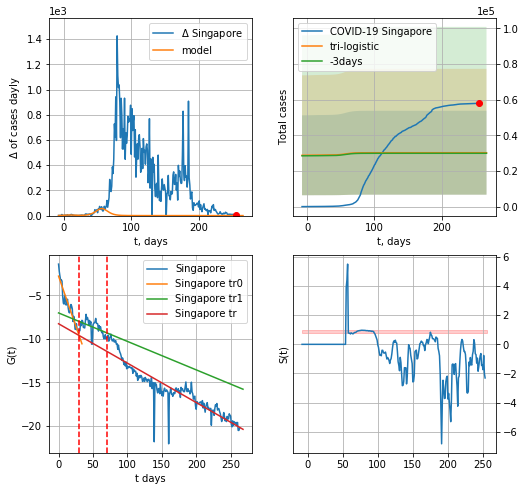

Singapore data at: 2020-10-13
+3 day model MAPE: 0.010597068695317463
model: tri-logistic
coeffs:  [ 2.87866293e+04 -1.81626153e+01  4.38527455e+02] [1.01029909e+02 1.91286963e-01 8.67555654e+00 1.32695355e+03
 1.68329223e-01 5.66911530e+01]
forecast rational stdev:  0.7783380639114654
forecast at the end of period: +11 days
	 deltaDaycases:  0
	 total cases:  30214 ± 23517
	 total death:  14 ± 32
tri-logistic approximation splitting points: 30,70
trend0 coefficient of determination: 0.893525
 intercept: -2.772249
 slope: -0.229208
trend1 coefficient of determination: 0.215531
 intercept: -7.009854
 slope: -0.032798
trend coefficient of determination: 0.850252
 intercept: -8.256913
 slope: -0.045383


In [565]:
vL = 30
vL1 = 70
try:
    dfSG = read_df(pd.DataFrame(),"SG")
    x = forecast('Singapore',dfSG[:vL],d1,7*T18-dT,1.0)
    xx = forecast2('Singapore',dfSG[:vL1],d1,T18*7-dT,x,1.0,vL=vL)
    xx = np.concatenate((x, xx), axis=0)
    xxx = forecast3("Singapore",dfSG,d1,T18*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])
except:
    print ("Exception occurs")

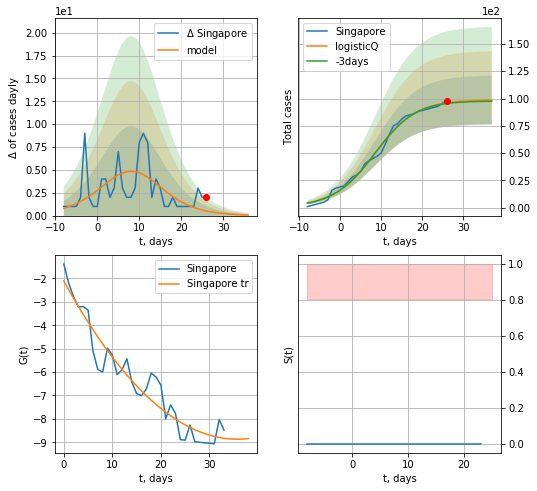

Singapore data at: 2020-10-13
+3 day model MAPE: 0.007575
model: logisticQ
coeffs: [ 9.88556613e+01  2.70689941e-04  8.43151450e+00 -7.17657610e+02]
rational stdev: 0.226599
forecast at the end of period: +11 days
	 deltaDaycases: 0
	 total cases: 98 ± 22
	 total death: 0 ± 0
trend coefficient of determination: 0.918167
 intercept_: -2.103369555726971
 coeffs_: [ 0.         -0.37832792  0.00528917]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


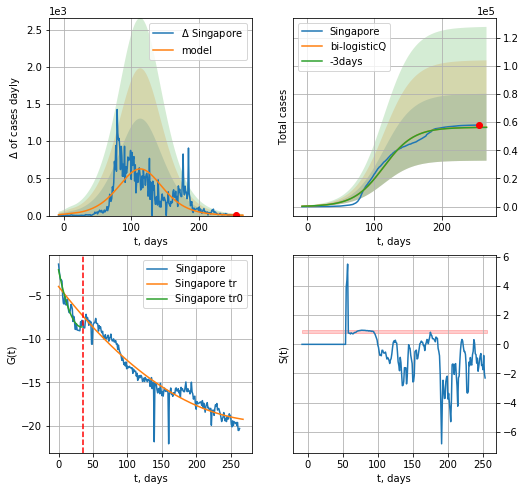

Singapore data at: 2020-10-13
+3 day model MAPE: 0.001652
model: bi-logisticQ
coeffs: [ 5.61880537e+04  5.08409473e-08  1.13796821e+02 -8.78102962e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.421518
forecast at the end of period: +11 days
	 deltaDaycases: 5
	 total cases: 56342 ± 23749
	 total death: 27 ± 34
bi-logisticQ approximation splitting point: 35
trend coefficient of determination: 0.914568
 intercept_: -2.036640634366525
 coeffs_: [ 0.         -0.39517788  0.00592335]
trend coefficient of determination: 0.930677
 intercept_: -3.9639705560376477
 coeffs_: [ 0.         -0.10218188  0.00016824]


In [566]:
vL = 35
x = forecastRRR('Singapore',dfSG[:vL],d1,7*T18-dT,1.0)
xx = forecast2RRR('Singapore',dfSG[:],d12f(1),T18*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

In [567]:
#vL = 31
#x = forecast('Singapore',dfSG[:vL],d1,6*7-dT,1.0)
#xx = forecast2('Singapore',dfSG[:],d1,12*7-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


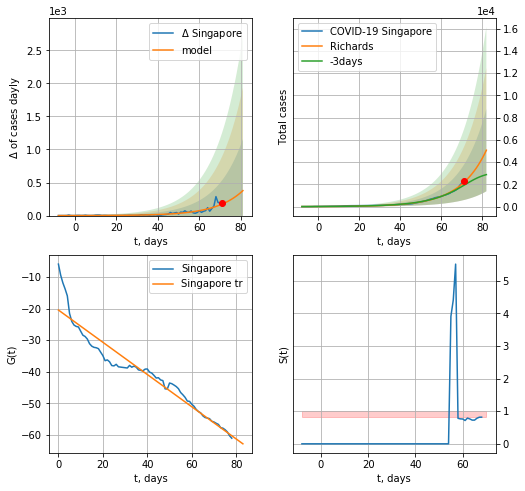

Singapore data at: 2020-10-13
+3 day model MAPE: 0.158856
model: Richards
coeffs: [1.92302023e+04 7.72500001e-02 9.92482833e+01 7.56752958e+00]
rational stdev: 0.728321
forecast at the end of period: +11 days
	 deltaDaycases: 377
	 total cases: 5073 ± 3695
	 total death: 2 ± 4
trend coefficient of determination: 0.919778
 intercept: -20.482187
 slope: -0.510333


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


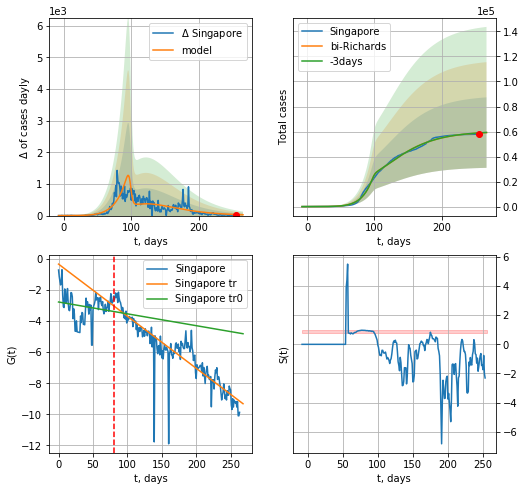

Singapore data at: 2020-10-13
+3 day model MAPE: 0.001788
model: bi-Richards
coeffs: [4.09415254e+04 5.41657752e-01 1.63180954e+00 4.68659435e-02]
rational stdev: 0.476014
forecast at the end of period: +11 days
	 deltaDaycases: 25
	 total cases: 59148 ± 28155
	 total death: 28 ± 39
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.033977
 intercept: -2.780951
 slope: -0.007605
trend coefficient of determination: 0.802224
 intercept: -0.346190
 slope: -0.033471


In [568]:
iL = 0
vL = 80+iL
x = forecastRR('Singapore',dfSG[iL:vL+iL],d1,T18*7-dT,1.0)
x = forecast2RR('Singapore',dfSG[iL:],d12f(1),30*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)
#xx = forecast2R('Singapore',dfSG[:],d1,28*7-dT,x,1.0)
#x = forecastQR('Singapore',dfSG[60:],d1,16*7-dT,1.0)

ES
           date   cases  active  death
211 2020-10-09  3846.0     832   68.0
212 2020-10-10  3865.0     839   68.0
213 2020-10-11  3883.0     848   68.0
214 2020-10-12  3908.0     825   68.0
215 2020-10-13  3947.0     819   68.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


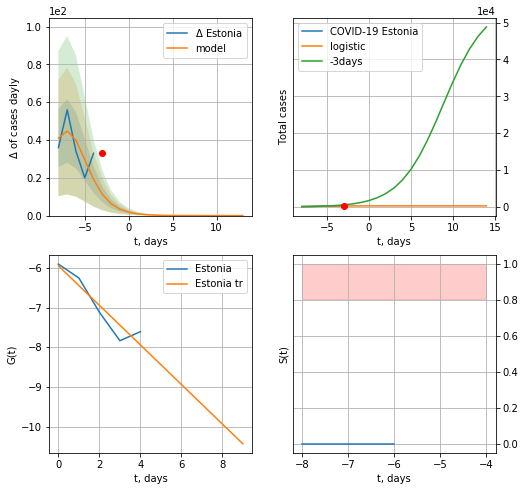

Estonia data at: 2020-10-13
+3 day model MAPE: 0.6707560325989319
model: logistic
coeffs:  [277.64023437   0.65084323  -6.57074778]
rational stdev:  0.028784635369283593
forecast at the end of period: +17 days
	 deltaDaycases:  0
	 total cases:  277 ± 7
	 total death:  4 ± 0
trend coefficient of determination: 0.881874
 intercept: -5.949047
 slope: -0.498463


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


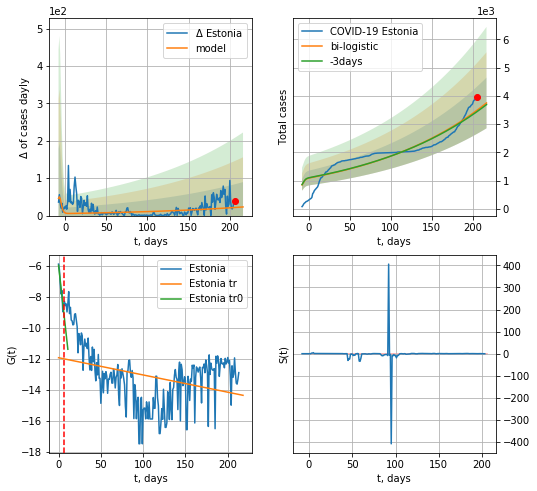

Estonia data at: 2020-10-13
+3 day model MAPE: 0.014201389479337993
model: bi-logistic
coeffs:  [1.39573700e+06 6.70056401e-03 1.11166706e+03] [277.64023437   0.65084323  -6.57074778]
rational stdev:  0.23948500563025946
forecast at the end of period: +11 days
	 deltaDaycases:  23
	 total cases:  3746 ± 897
	 total death:  64 ± 45
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.894917
 intercept: -5.986038
 slope: -0.491580
trend coefficient of determination: 0.120504
 intercept: -11.938153
 slope: -0.011107


In [569]:
shift = 1.0
try:
    dfES = read_df(pd.DataFrame(),"ES")
    x = forecast('Estonia',dfES[1:7],d1,17,1.)
    xx = forecast2('Estonia',dfES[1:],d1,T18*7-dT,x,1.,addpred=False,xcoef=[0.25,1.,3.5],vL=7)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


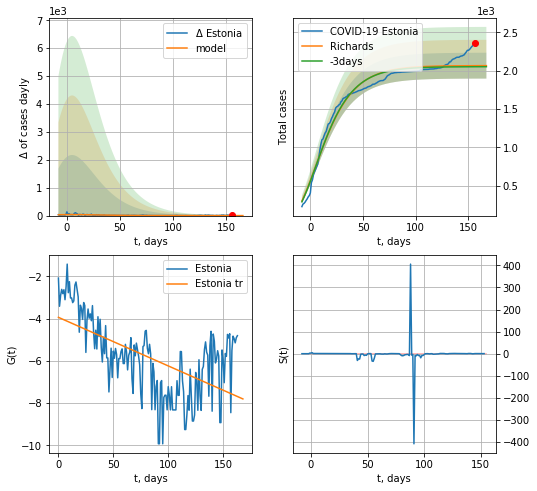

Estonia data at: 2020-10-13
+3 day model MAPE: 0.006696
model: Richards
coeffs: [ 2.06547249e+03  1.08705444e+01 -1.03315442e+02  4.56197694e-03]
rational stdev: 0.081619
forecast at the end of period: +11 days
	 deltaDaycases: 0
	 total cases: 2064 ± 168
	 total death: 35 ± 8
trend coefficient of determination: 0.348386
 intercept: -3.939276
 slope: -0.022998


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


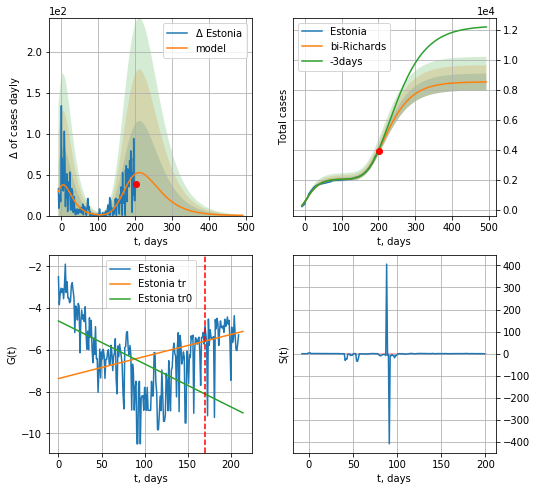

Estonia data at: 2020-10-13
+3 day model MAPE: 0.017385
model: bi-Richards
coeffs: [6.45832047e+03 2.89135294e-01 1.01354295e+02 7.93584160e-02]
rational stdev: 0.065439
forecast at the end of period: +291 days
	 deltaDaycases: 0
	 total cases: 8513 ± 557
	 total death: 146 ± 28
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.300010
 intercept: -4.612173
 slope: -0.020568
trend coefficient of determination: 0.013504
 intercept: -7.371661
 slope: 0.010560


In [570]:
iL = 5
vL=170+iL
x = forecastRR('Estonia',dfES[iL:vL-iL],d1,7*T18-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
#x = forecastQR('Estonia',dfES[10:],d1,7*10-dT,1.)
xx = forecast2RR('Estonia',dfES[iL:],d1,7*70-dT,x,1.,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [571]:
#x = forecastRRR('Estonia',dfES[:],d1,7*T18-dT,1.,addpred=True,xcoef=[0.35/8,.5,4.,1])

LV
           date   cases  active  death
216 2020-10-09  2596.0    1234   40.0
217 2020-10-10  2670.0    1308   40.0
218 2020-10-11  2765.0    1325   40.0
219 2020-10-12  2840.0    1474   41.0
220 2020-10-13  2840.0    1474   41.0


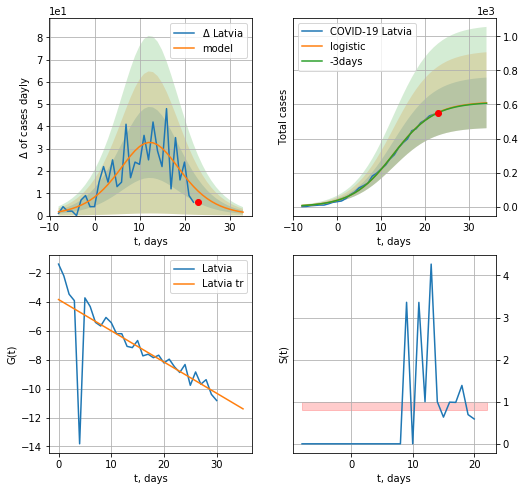

Latvia data at: 2020-10-13
+3 day model MAPE: 0.003263338184172393
model: logistic
coeffs:  [6.16080291e+02 2.13516215e-01 1.27871959e+01]
rational stdev:  0.24373797630646024
forecast at the end of period: +11 days
	 deltaDaycases:  1
	 total cases:  609 ± 148
	 total death:  8 ± 5
trend coefficient of determination: 0.538666
 intercept: -3.837099
 slope: -0.216023
Exception occurs


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:485: RuntimeWarning: divide by zero encountered in log


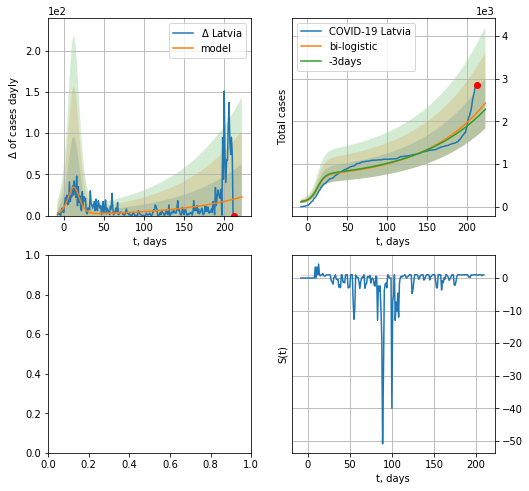

In [572]:
vL=32
dfLV = read_df(pd.DataFrame(),"LV")
try:
    x = forecast('Latvia',dfLV[:vL],d1,T18*7-dT,1.)
    xx=forecast2('Latvia',dfLV[:],d1,T18*7-dT,x,1.,addpred=False,xcoef=[0.25,1.,3.],vL=vL)
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


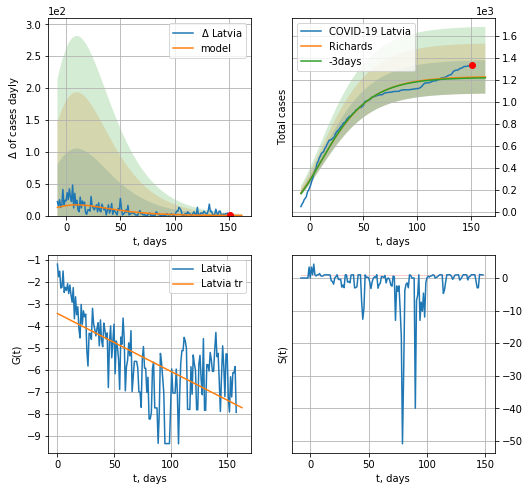

Latvia data at: 2020-10-12
+3 day model MAPE: 0.006562
model: Richards
coeffs: [ 1.23229972e+03  6.06162797e+00 -1.26146888e+02  6.15560092e-03]
rational stdev: 0.123538
forecast at the end of period: +12 days
	 deltaDaycases: 0
	 total cases: 1228 ± 151
	 total death: 17 ± 6
trend coefficient of determination: 0.434331
 intercept: -3.443474
 slope: -0.026259


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


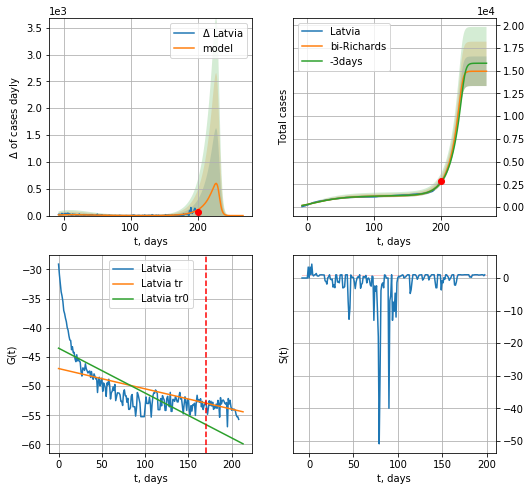

Latvia data at: 2020-10-12
+3 day model MAPE: 0.031156
model: bi-Richards
coeffs: [1.37072105e+04 6.88079277e-02 2.32382578e+02 6.54714359e+00]
rational stdev: 0.108841
forecast at the end of period: +68 days
	 deltaDaycases: 0
	 total cases: 14939 ± 1626
	 total death: 216 ± 70
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.578108
 intercept: -43.488464
 slope: -0.076977
trend coefficient of determination: 0.129578
 intercept: -46.981249
 slope: -0.034821


In [388]:
iL=10
vL = 170+iL
x = forecastRR('Latvia',dfLV[iL:vL-iL],d1,7*T18-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Latvia',dfLV[iL:],d1,7*38-dT,x,1.,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)
#x = forecastQR('Latvia',dfLV[:],d1,7*16-dT,1.)
#xx=forecast2R('Latvia',dfLV[:],d1,10*7-dT,x)

In [4363]:
#trend3(dfCA[12:],dfPT,dfTR[4:],'CA','PT','TR',40,40,40)
#x = forecastRRR('Latvia',dfLV[:],d1,7*T18-dT,1.,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


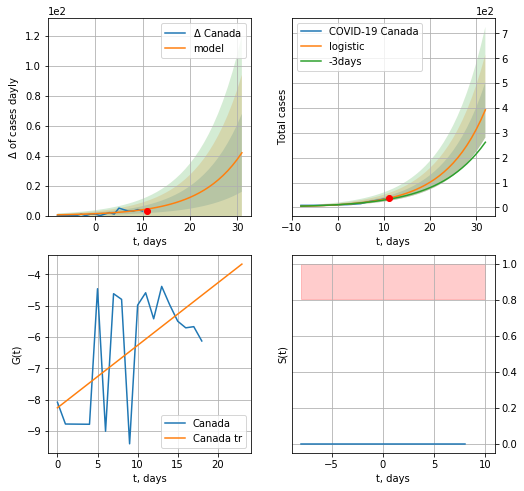

Canada data at: 2020-10-13
+3 day model MAPE: 0.14133490187696762
model: logistic
coeffs:  [1.25342997e+05 1.13222116e-01 8.29018541e+01]
rational stdev:  0.2833740936364515
forecast at the end of period: +21 days
	 deltaDaycases:  41
	 total cases:  392 ± 111
	 total death:  20 ± 17
trend coefficient of determination: 0.348503
 intercept: -8.254919
 slope: 0.199271


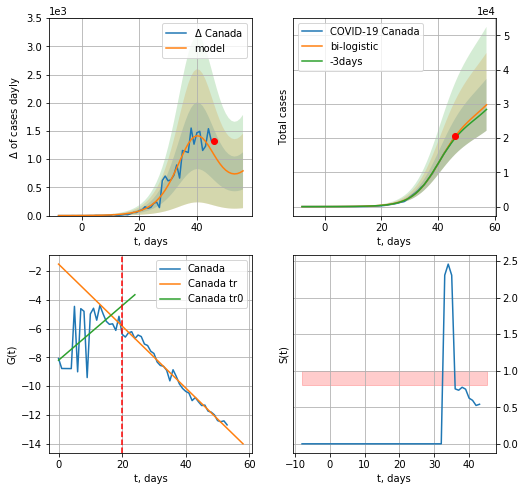

Canada data at: 2020-10-13
+3 day model MAPE: 0.029367009846107475
model: bi-logistic
coeffs:  [2.40153999e+04 2.16961374e-01 4.02658690e+01] [1.25342997e+05 1.13222116e-01 8.29018541e+01]
rational stdev:  0.2549294005106464
forecast at the end of period: +11 days
	 deltaDaycases:  793
	 total cases:  29733 ± 7579
	 total death:  1535 ± 1173
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.359029
 intercept: -8.196978
 slope: 0.189614
trend coefficient of determination: 0.982767
 intercept: -1.518979
 slope: -0.215271


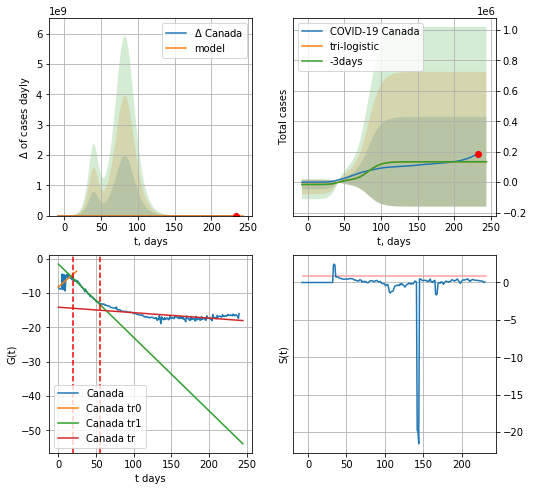

Canada data at: 2020-10-13
+3 day model MAPE: 0.004616319936878927
model: tri-logistic
coeffs:  [-1.47676213e+04  1.70205292e+00 -2.83556186e+01] [1.25342997e+05 1.13222116e-01 8.29018541e+01 2.40153999e+04
 2.16961374e-01 4.02658690e+01]
forecast rational stdev:  2.1917634978704594
forecast at the end of period: +11 days
	 deltaDaycases:  0
	 total cases:  134590 ± 294991
	 total death:  6952 ± 45711
tri-logistic approximation splitting points: 20,55
trend0 coefficient of determination: 0.359029
 intercept: -8.196978
 slope: 0.189614
trend1 coefficient of determination: 0.983223
 intercept: -1.572806
 slope: -0.213535
trend coefficient of determination: 0.446982
 intercept: -14.126787
 slope: -0.015838


In [573]:
vL=20
vL1=55
x = forecast('Canada',dfCA[:vL],d1,3*7,1.)
xx=forecast2('Canada',dfCA[:vL1],d1,T18*7-dT,x,1.,vL=vL)#,addpred=True,xcoef=[0.25,1.,2.]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Canada",dfCA[:],d1,T18*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

CA
           date     cases  active   death
237 2020-10-09  178117.0   19008  9585.0
238 2020-10-10  180179.0   19214  9608.0
239 2020-10-11  181864.0   19032  9613.0
240 2020-10-12  182839.0   18954  9627.0
241 2020-10-13  186881.0   19741  9654.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:86: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


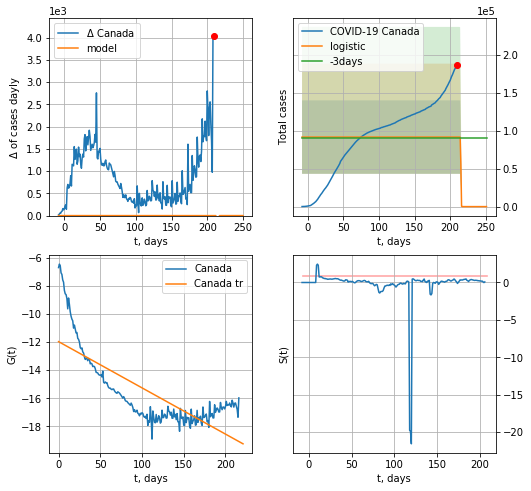

Canada data at: 2020-10-13
+3 day model MAPE: 0.014292352284044333
model: logistic
coeffs:  [ 9.14800321e+04 -5.78868866e+00  2.15078769e+02]
rational stdev:  0.5283650506737468
forecast at the end of period: +42 days
	 deltaDaycases:  0
	 total cases:  0 ± 0
	 total death:  0 ± 0
trend coefficient of determination: 0.585434
 intercept: -11.965784
 slope: -0.032924


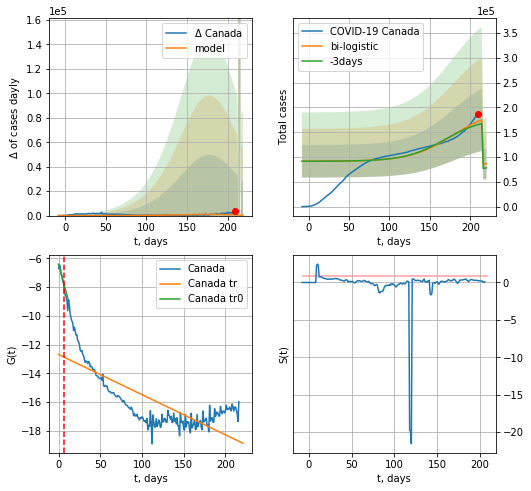

Canada data at: 2020-10-13
+3 day model MAPE: 0.039107051964612054
model: bi-logistic
coeffs:  [1.04294096e+05 3.84313655e-02 1.77976018e+02] [ 9.14800321e+04 -5.78868866e+00  2.15078769e+02]
rational stdev:  0.35816501458336264
forecast at the end of period: +11 days
	 deltaDaycases:  561
	 total cases:  86992 ± 31157
	 total death:  4493 ± 4827
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.859073
 intercept: -6.392122
 slope: -0.214001
trend coefficient of determination: 0.572626
 intercept: -12.686201
 slope: -0.027967


In [574]:
dfCA = read_df(pd.DataFrame(),"CA")
x = forecast('Canada',dfCA[24:],d1,6*7,1.,cases='cases')
xx=forecast2('Canada',dfCA[24:],d1,T18*7-dT,x,1.,vL=31-24,cases='cases')

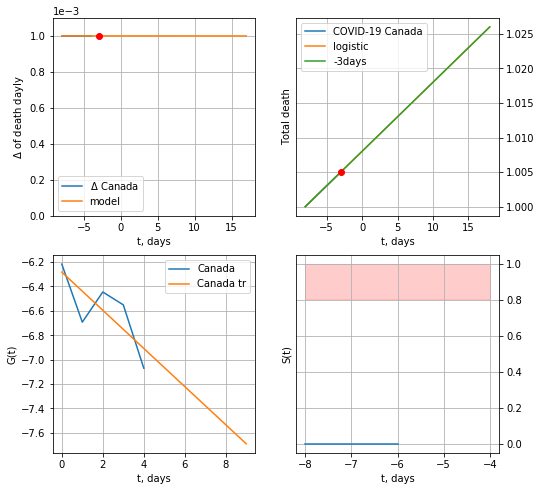

Canada data at: 2020-10-13
+3 day model MAPE: 6.189159426418585e-07
model: logistic
coeffs:  [2.01800807e+00 1.98223827e-03 1.00386171e+00]
rational stdev:  1.593569349221903e-08
forecast at the end of period: +21 days
	 total death:  1 ± 0
trend coefficient of determination: 0.608158
 intercept: -6.282802
 slope: -0.156326


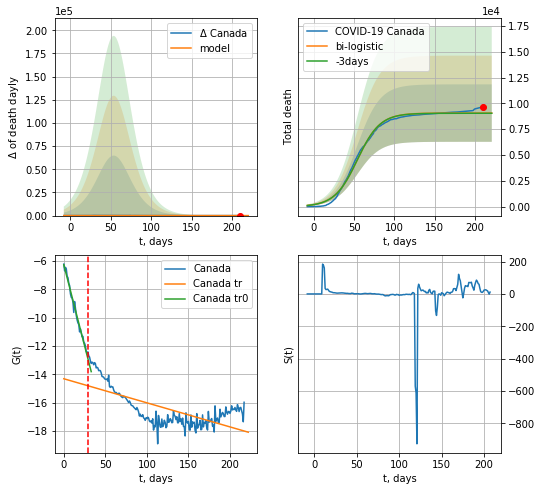

Canada data at: 2020-10-13
+3 day model MAPE: 0.0019304932551512581
model: bi-logistic
coeffs:  [9.06083920e+03 7.07039778e-02 5.41279206e+01] [2.01800807e+00 1.98223827e-03 1.00386171e+00]
rational stdev:  0.3070795423637615
forecast at the end of period: +11 days
	 deltaDaydeath:  0
	 total death:  9061 ± 2782
bi-logistic approximation splitting point: 29
trend0 coefficient of determination: 0.986075
 intercept: -6.260314
 slope: -0.228750
trend coefficient of determination: 0.471963
 intercept: -14.311147
 slope: -0.016999


In [575]:
vL=29
vL1=50
x = forecast('Canada',dfCA[23:vL],d1,3*7,1.,cases='death')
xx=forecast2('Canada',dfCA[23:],d1,T18*7-dT,x,1.,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,2.]
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Canada",dfCA[24:],d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


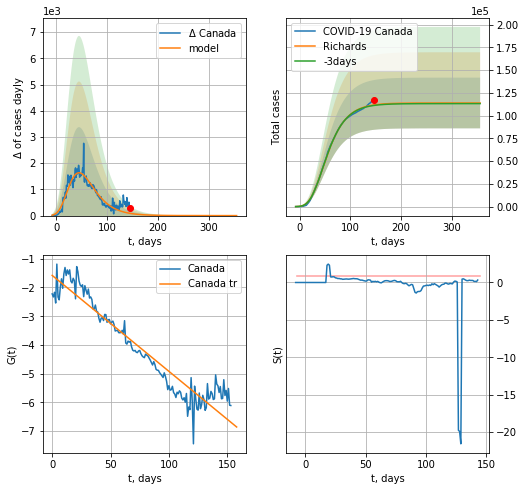

Canada data at: 2020-10-13
+3 day model MAPE: 0.004991
model: Richards
coeffs: [ 1.13901342e+05  5.10785279e+00 -7.91415351e+01  7.66667602e-03]
rational stdev: 0.244657
forecast at the end of period: +210 days
	 deltaDaycases: 0
	 total cases: 113900 ± 27866
	 total death: 5883 ± 4317
trend coefficient of determination: 0.904676
 intercept: -1.579387
 slope: -0.033378


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


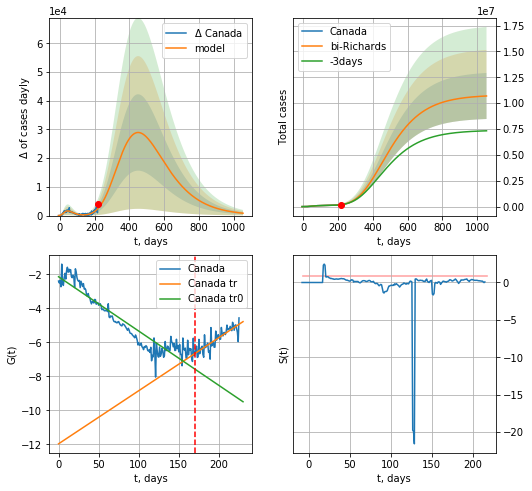

Canada data at: 2020-10-13
+3 day model MAPE: 0.005831
model: bi-Richards
coeffs: [1.06869743e+07 1.26747800e-01 7.92771888e+01 5.98253528e-02]
rational stdev: 0.208107
forecast at the end of period: +837 days
	 deltaDaycases: 823
	 total cases: 10692126 ± 2225105
	 total death: 552339 ± 344836
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.882381
 intercept: -2.136998
 slope: -0.031984
trend coefficient of determination: 0.678772
 intercept: -11.969197
 slope: 0.031259


In [576]:
iL = 15
vL = 170 + iL
x = forecastRR('Canada',dfCA[iL:vL-iL],d1,T18*7,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Canada',dfCA[iL:],d1,148*7-dT,x,1.,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)
#x = forecastQR('Canada',dfCA[28:],d1,16*7,1.)

In [577]:
#x = forecastRRR('Canada',dfCA[15:],d1,7*28,1.,addpred=True,xcoef=koreaCoeffs)

PT
           date  cases  active   death
221 2020-10-09  83928   29702  2062.0
222 2020-10-10  85574   30704  2067.0
223 2020-10-11  86664   31397  2080.0
224 2020-10-12  87913   32321  2094.0
225 2020-10-13  89121   32964  2110.0


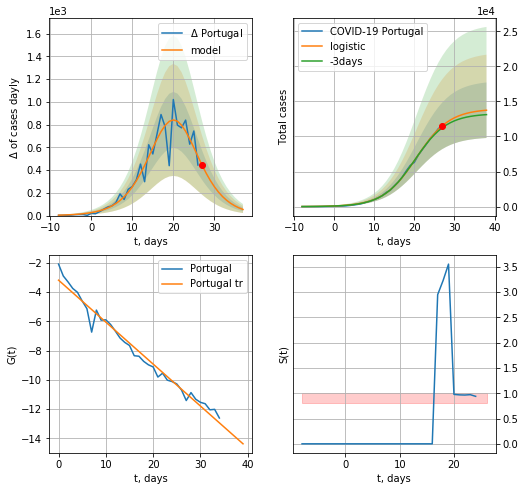

Portugal data at: 2020-10-13
+3 day model MAPE: 0.02876881186141646
model: logistic
coeffs:  [1.39435560e+04 2.41732854e-01 2.05234131e+01]
rational stdev:  0.28806592053196767
forecast at the end of period: +11 days
	 deltaDaycases:  53
	 total cases:  13742 ± 3958
	 total death:  325 ± 280
trend coefficient of determination: 0.976552
 intercept: -3.178197
 slope: -0.287215


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


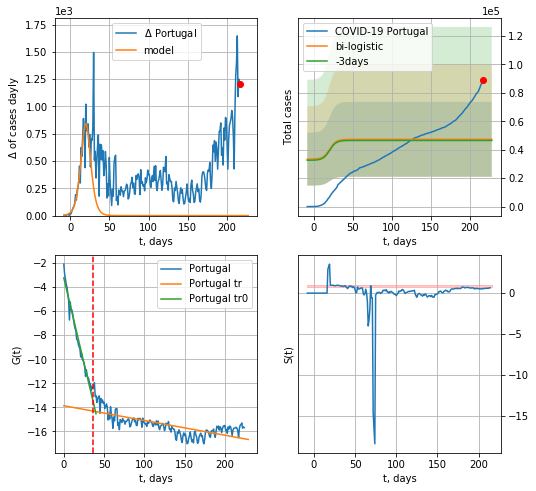

Portugal data at: 2020-10-13
+3 day model MAPE: 0.017086489091144328
model: bi-logistic
coeffs:  [ 2.66929758e+04 -9.68515345e+00  2.41824726e+02] [1.39435560e+04 2.41732854e-01 2.05234131e+01]
scenario coeffs:  [0.25, 1.0, 1.2]
rational stdev:  0.5570981191472534
forecast at the end of period: +11 days
	 deltaDaycases:  0
	 total cases:  47309 ± 26356
	 total death:  1120 ± 1871
bi-logistic approximation splitting point: 36
trend0 coefficient of determination: 0.975262
 intercept: -3.226992
 slope: -0.282910
trend coefficient of determination: 0.512147
 intercept: -13.872412
 slope: -0.012278


In [578]:
vL = 36
dfPT = read_df(pd.DataFrame(),"PT")
x = forecast('Portugal',dfPT[:vL],d1,T18*7-dT,1.)
xx=forecast2('Portugal',dfPT[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,1.2],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


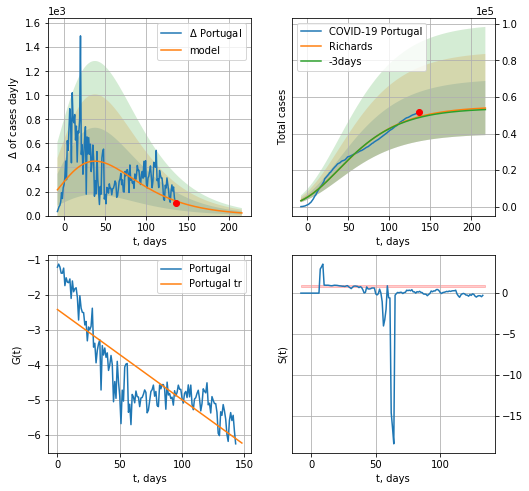

Portugal data at: 2020-10-13
+3 day model MAPE: 0.009022
model: Richards
coeffs: [ 5.49563957e+04  3.61472293e+00 -1.88142914e+02  6.21530343e-03]
rational stdev: 0.274071
forecast at the end of period: +81 days
	 deltaDaycases: 21
	 total cases: 53980 ± 14794
	 total death: 1278 ± 1050
trend coefficient of determination: 0.709889
 intercept: -2.420296
 slope: -0.025758


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


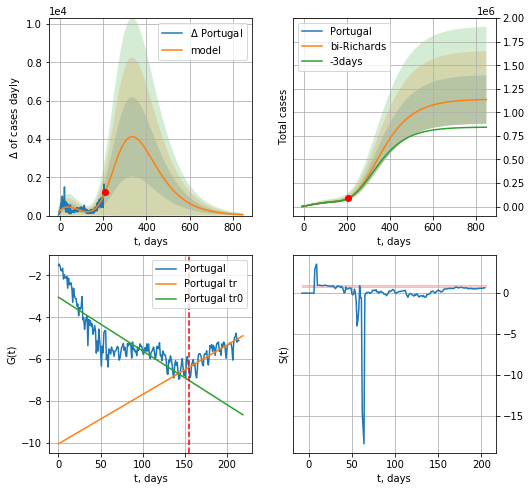

Portugal data at: 2020-10-13
+3 day model MAPE: 0.005435
model: bi-Richards
coeffs: [1.08545135e+06 1.48978809e-01 8.75900205e+01 7.16540932e-02]
rational stdev: 0.226211
forecast at the end of period: +641 days
	 deltaDaycases: 48
	 total cases: 1135898 ± 256953
	 total death: 26893 ± 18250
bi-Richards approximation splitting point: 155
trend coefficient of determination: 0.719485
 intercept: -3.041885
 slope: -0.025653
trend coefficient of determination: 0.654326
 intercept: -10.047494
 slope: 0.023586


In [579]:
iL = 10
vL=155+iL
x = forecastRR('Portugal',dfPT[iL:vL-iL],d1,40*7-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Portugal',dfPT[iL:],d1,120*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [580]:
#x = forecastRRR('Portugal',dfPT[:],d1,T18*7-dT,1.,addpred=True,xcoef=koreaCoeffs)

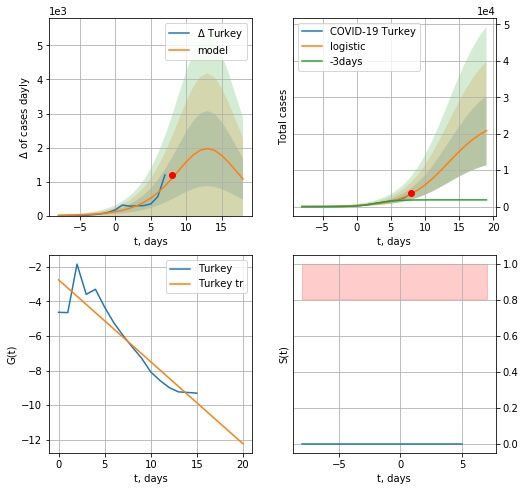

Turkey data at: 2020-10-13
+3 day model MAPE: 1.5246812178063545
model: logistic
coeffs:  [2.42671393e+04 3.25610709e-01 1.34529674e+01]
rational stdev:  0.45520285261707166
forecast at the end of period: +11 days
	 deltaDaycases:  1073
	 total cases:  20843 ± 9487
	 total death:  551 ± 752
trend coefficient of determination: 0.850665
 intercept: -2.746555
 slope: -0.474541


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:195: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


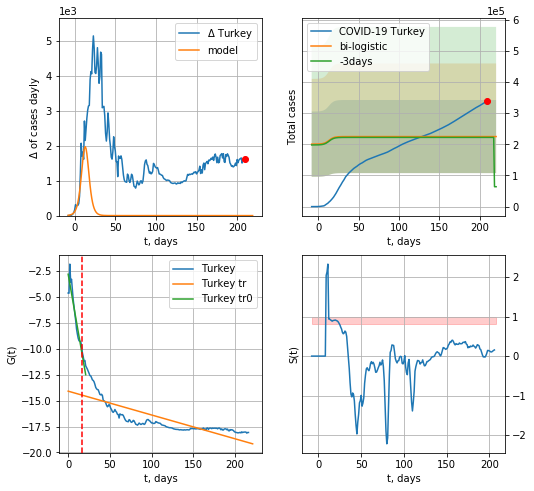

Turkey data at: 2020-10-13
+3 day model MAPE: 0.011982906659159014
model: bi-logistic
coeffs:  [ 1.60343109e+05 -7.20039654e+01  2.26933216e+02] [2.42671393e+04 3.25610709e-01 1.34529674e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.5218833762471972
forecast at the end of period: +11 days
	 deltaDaycases:  0
	 total cases:  224696 ± 117265
	 total death:  5940 ± 9299
bi-logistic approximation splitting point: 17
trend0 coefficient of determination: 0.862807
 intercept: -2.813054
 slope: -0.461241
trend coefficient of determination: 0.627827
 intercept: -14.087447
 slope: -0.022969


In [581]:
vL=17
x = forecast('Turkey',dfTR[:vL],d1,7*T18-dT,1.)
xx=forecast2('Turkey',dfTR[:],d1,T18*7-dT,x,1.,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


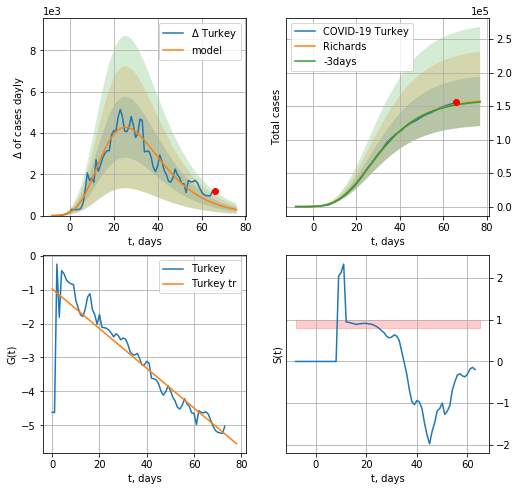

Turkey data at: 2020-10-13
+3 day model MAPE: 0.006544
model: Richards
coeffs: [ 1.61234279e+05  5.77618311e+00 -3.44308441e+01  1.25694326e-02]
rational stdev: 0.235075
forecast at the end of period: +11 days
	 deltaDaycases: 288
	 total cases: 157350 ± 36989
	 total death: 4160 ± 2933
trend coefficient of determination: 0.775259
 intercept: -0.978843
 slope: -0.058549


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


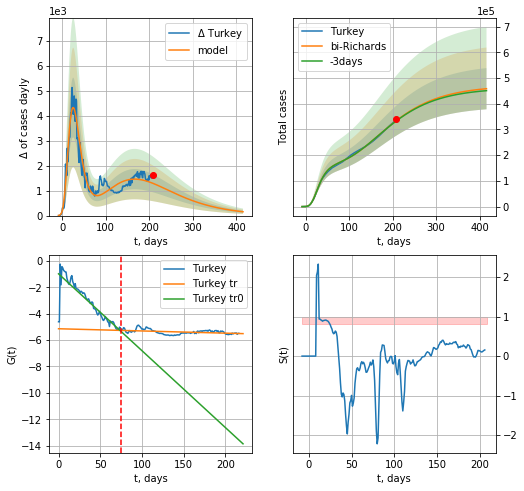

Turkey data at: 2020-10-13
+3 day model MAPE: 0.003307
model: bi-Richards
coeffs: [ 3.09266995e+05  1.04479862e+00 -1.72343169e+02  1.23835441e-02]
rational stdev: 0.174683
forecast at the end of period: +207 days
	 deltaDaycases: 154
	 total cases: 458400 ± 80074
	 total death: 12119 ± 6350
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.780259
 intercept: -0.983887
 slope: -0.058277
trend coefficient of determination: 0.153890
 intercept: -5.145350
 slope: -0.001671


In [582]:
vL = 75
x = forecastRR('Turkey',dfTR[:vL],d1,T18*7-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Turkey',dfTR[:],d1,58*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

In [583]:
#x = forecastQR('Turkey',dfTR[:],d1,16*7,1.,addpred=False,xcoef=[0.35,.5,3,1,1])

In [584]:
#x = forecastRRR('Turkey',dfTR[:],d1,T18*7,1.,addpred=True,xcoef=koreaCoeffs)

#xx=forecast2R('Turkey',dfTR[:],d1,14*7-dT,x,1.)

In [585]:
dfTT[dfTT.Country=='%s'%("Latvia")][0].values[0]

0.014436619718309859

In [586]:
#trend3(dfPL[1:],dfIS[7:],dfSW,'PL','IS','SW',40,40,40)

PL
           date     cases  active   death
219 2020-10-09  116338.0   34437  2919.0
220 2020-10-10  121638.0   38364  2972.0
221 2020-10-11  130210.0   45970  3039.0
222 2020-10-12  135278.0   50173  3101.0
223 2020-10-13  141804.0   54740  3217.0


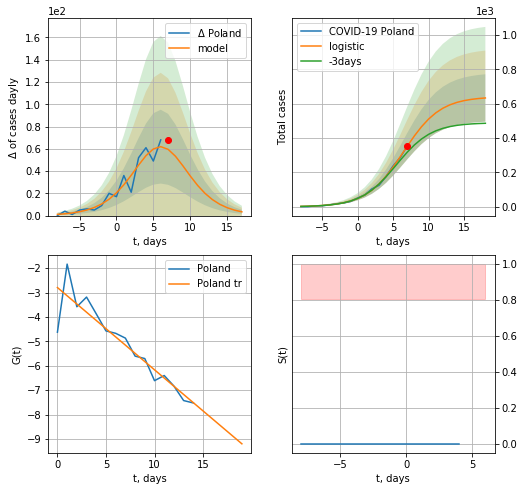

Poland data at: 2020-10-13
+3 day model MAPE: 0.14646235252259687
model: logistic
coeffs:  [6.41107575e+02 3.87606717e-01 6.46563504e+00]
rational stdev:  0.2177068805945458
forecast at the end of period: +11 days
	 deltaDaycases:  3
	 total cases:  633 ± 137
	 total death:  14 ± 9
trend coefficient of determination: 0.843228
 intercept: -2.795749
 slope: -0.337043


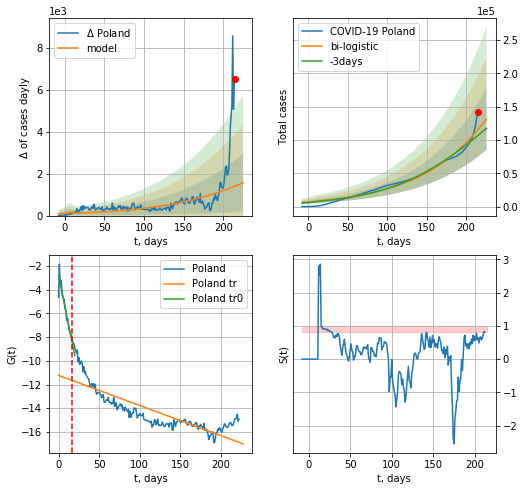

Poland data at: 2020-10-13
+3 day model MAPE: 0.08370404201094465
model: bi-logistic
coeffs:  [1.06364471e+06 1.36836821e-02 3.69639943e+02] [6.41107575e+02 3.87606717e-01 6.46563504e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.350383339910274
forecast at the end of period: +11 days
	 deltaDaycases:  1563
	 total cases:  131568 ± 46099
	 total death:  3015 ± 3169
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.867285
 intercept: -2.795308
 slope: -0.337138
trend coefficient of determination: 0.690975
 intercept: -11.226380
 slope: -0.025468


In [775]:
vL=16
vL1=38
try:
    dfPL = read_df(pd.DataFrame(),"PL")
    x =  forecast('Poland',dfPL[:vL],d1,7*T18-dT,1.)
    xx = forecast2('Poland',dfPL[:],d1,T18*7-dT,x,1.,vL=vL,addpred=True,xcoef=[0.25,1.,2.])
    #xx = np.concatenate((x, xx), axis=0)
    #xxx = forecast3("Poland",dfPL,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.5,1.,1.3],vL=[vL,vL1])
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


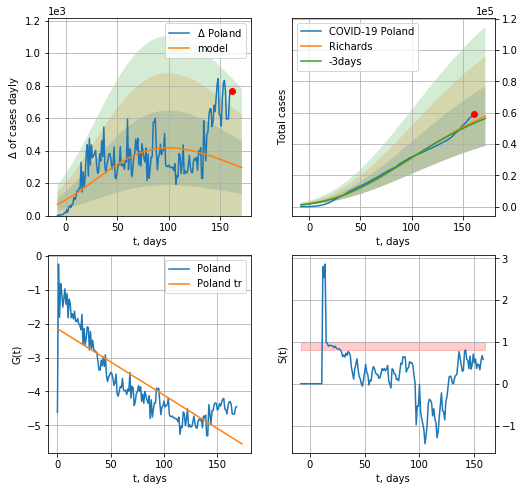

Poland data at: 2020-10-13
+3 day model MAPE: 0.021663
model: Richards
coeffs: [ 8.41741058e+04  1.47966569e+00 -2.46676717e+02  9.14859854e-03]
rational stdev: 0.328700
forecast at the end of period: +11 days
	 deltaDaycases: 295
	 total cases: 57728 ± 18975
	 total death: 1323 ± 1304
trend coefficient of determination: 0.711205
 intercept: -2.146265
 slope: -0.019650


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


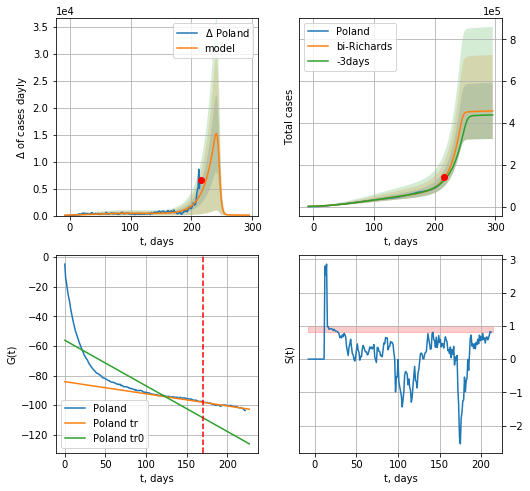

Poland data at: 2020-10-13
+3 day model MAPE: 0.074235
model: bi-Richards
coeffs: [3.79441346e+05 5.79211929e-02 2.45839534e+02 8.47784724e+00]
rational stdev: 0.292659
forecast at the end of period: +81 days
	 deltaDaycases: 75
	 total cases: 457886 ± 134004
	 total death: 10496 ± 9215
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.660383
 intercept: -56.169425
 slope: -0.308324
trend coefficient of determination: 0.888558
 intercept: -84.155120
 slope: -0.082026


In [776]:
vL = 170
x =  forecastRR('Poland',dfPL[:vL],d1,30*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx =  forecast2RR('Poland',dfPL[:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#xx = forecast2R('Poland',dfPL[:],d1,8*7-dT,x)

In [4167]:
#x =  forecastRRR('Poland',dfPL[:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

IS
           date     cases  active   death
230 2020-10-09  287858.0   60724  1886.0
231 2020-10-10  290003.0   62136  1941.0
232 2020-10-11  291828.0   51700  1983.0
233 2020-10-12  295037.0   51252  2021.0
234 2020-10-13  297274.0   48017  2055.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


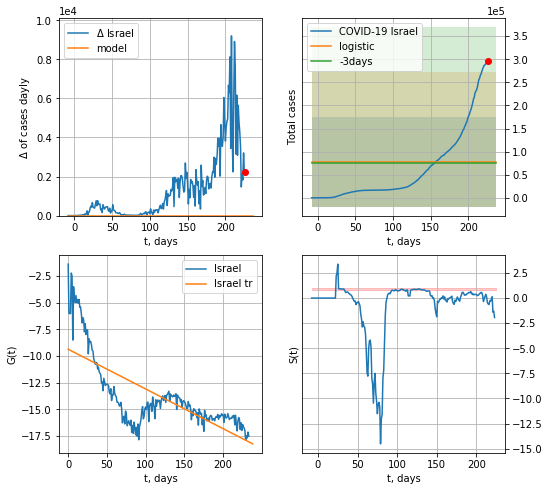

Israel data at: 2020-10-13
+3 day model MAPE: 0.05033528913512522
model: logistic
coeffs:  [ 6.26242728e+04 -2.67147133e+01  6.48751173e+02]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  1.2428462100216222
forecast at the end of period: +11 days
	 deltaDaycases:  0
	 total cases:  78280 ± 97290
	 total death:  541 ± 2017
trend coefficient of determination: 0.545801
 intercept: -9.360299
 slope: -0.037203


In [588]:
dfIS = read_df(pd.DataFrame(),"IS")
try:
    x = forecast('Israel',dfIS[:],d1,T18*7-dT,addpred=True,xcoef=[0.25,1.,1.8])
except:
    print ("Exception occurs")
#xx = forecast2('Israel',dfIS[:],d1,20-dT,x)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


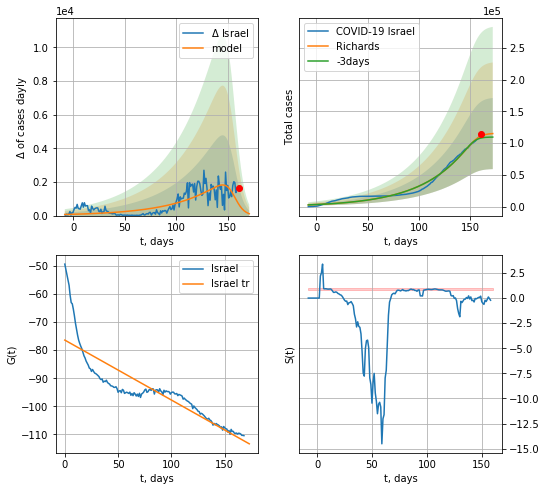

Israel data at: 2020-10-13
+3 day model MAPE: 0.033140
model: Richards
coeffs: [1.15563805e+05 2.25330067e-02 1.56407063e+02 9.12446098e+00]
rational stdev: 0.486291
forecast at the end of period: +11 days
	 deltaDaycases: 111
	 total cases: 115061 ± 55953
	 total death: 795 ± 1159
trend coefficient of determination: 0.746523
 intercept: -76.420467
 slope: -0.213474


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


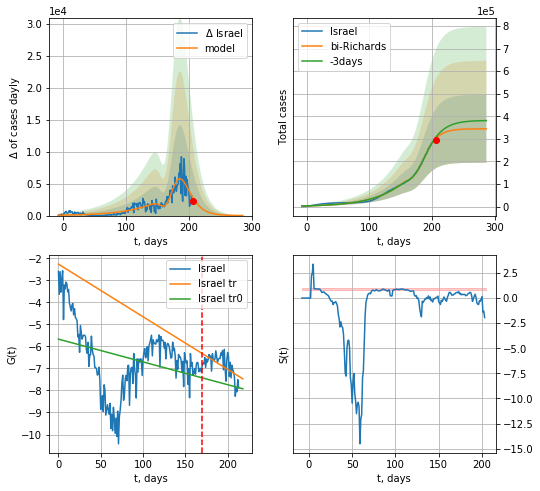

Israel data at: 2020-10-13
+3 day model MAPE: 0.020661
model: bi-Richards
coeffs: [2.29151849e+05 3.21475510e-01 1.67250620e+02 2.37323481e-01]
rational stdev: 0.436599
forecast at the end of period: +81 days
	 deltaDaycases: 8
	 total cases: 344611 ± 150457
	 total death: 2382 ± 3119
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.105070
 intercept: -5.670158
 slope: -0.010343
trend coefficient of determination: 0.341090
 intercept: -2.264835
 slope: -0.023895


In [589]:
vL = 170+20
x = forecastRR('Israel',dfIS[20:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Israel',dfIS[20:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-20)

In [590]:
#x = forecastRRR('Israel',dfIS[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs)

In [591]:
#x = forecastRRR('Israel',dfIS[27:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

SZ
           date    cases  active   death
227 2020-10-09  60368.0    9880  2088.0
228 2020-10-10  61694.0    9880  2088.0
229 2020-10-11  63050.0    9880  2088.0
230 2020-10-12  64436.0   12839  2097.0
231 2020-10-13  65881.0   13978  2103.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


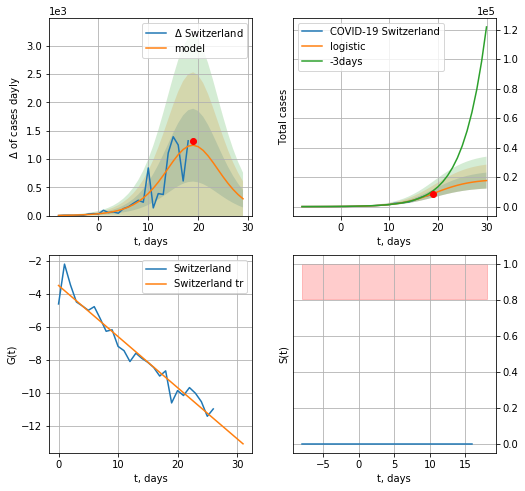

Switzerland data at: 2020-10-13
+3 day model MAPE: 0.24949882905970236
model: logistic
coeffs:  [1.87061213e+04 2.66466230e-01 1.93986309e+01]
rational stdev:  0.3060478989718857
forecast at the end of period: +11 days
	 deltaDaycases:  296
	 total cases:  17658 ± 5404
	 total death:  563 ± 516
trend coefficient of determination: 0.944448
 intercept: -3.508672
 slope: -0.309041


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


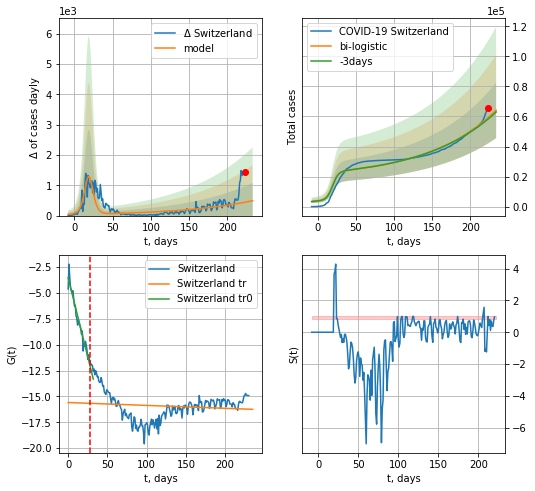

Switzerland data at: 2020-10-13
+3 day model MAPE: 0.015740033091500696
model: bi-logistic
coeffs:  [5.52279935e+07 1.08814698e-02 8.86745777e+02] [1.87061213e+04 2.66466230e-01 1.93986309e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.28860996964534036
forecast at the end of period: +11 days
	 deltaDaycases:  490
	 total cases:  64109 ± 18502
	 total death:  2046 ± 1771
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.947988
 intercept: -3.537068
 slope: -0.305765
trend coefficient of determination: 0.014320
 intercept: -15.587501
 slope: -0.002792


In [592]:
vL= 28
try:
    dfSZ = read_df(pd.DataFrame(),"SZ")
    x = forecast('Switzerland',dfSZ[:vL],d1,7*T18-dT)
    xx = forecast2('Switzerland',dfSZ[:],d1,7*T18-dT,x,vL=vL,addpred=True,xcoef=[0.25,1.,2.])#,addpred=False,xcoef=[0.25,1.,2.5]
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


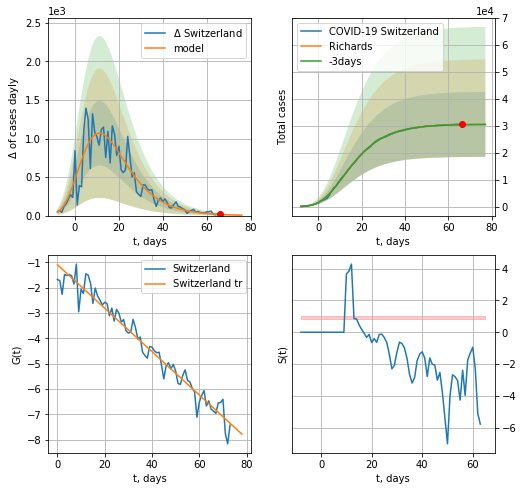

Switzerland data at: 2020-10-13
+3 day model MAPE: 0.000864
model: Richards
coeffs: [ 3.06308865e+04  7.16537801e+00 -3.34375097e+01  1.33541414e-02]
rational stdev: 0.394656
forecast at the end of period: +11 days
	 deltaDaycases: 5
	 total cases: 30571 ± 12065
	 total death: 975 ± 1154
trend coefficient of determination: 0.958074
 intercept: -1.096880
 slope: -0.085687


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


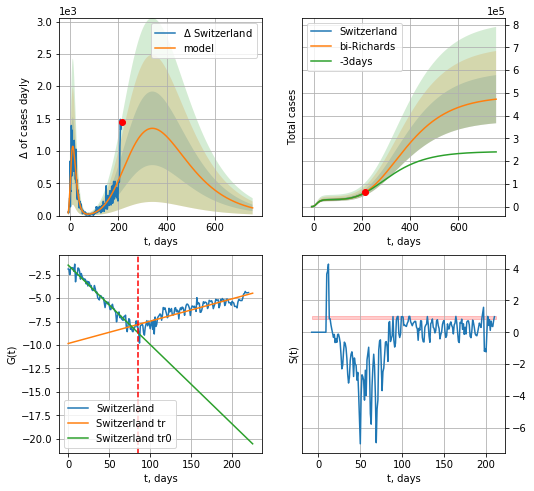

Switzerland data at: 2020-10-13
+3 day model MAPE: 0.024944
model: bi-Richards
coeffs: [ 4.56637387e+05  1.52707116e-01 -1.33168529e+01  5.40034876e-02]
rational stdev: 0.224146
forecast at the end of period: +543 days
	 deltaDaycases: 118
	 total cases: 472666 ± 105946
	 total death: 15088 ± 10145
bi-Richards approximation splitting point: 85
trend coefficient of determination: 0.964304
 intercept: -1.491097
 slope: -0.084619
trend coefficient of determination: 0.761621
 intercept: -9.842258
 slope: 0.023816


In [593]:
iL = 10
vL = 85 + iL
x = forecastRR('Switzerland',dfSZ[iL:vL-iL],d1,7*30-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Switzerland',dfSZ[iL:],d12f(1),7*106-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)
#xx = forecastR('Switzerland',dfSZ[:],d1,7*5-dT,x,vL=15)

In [594]:
#x = forecastRRR('Switzerland',dfSZ[:],d1,7*T18-dT,addpred=False,xcoef=koreaCoeffs)

In [595]:
#trend3(dfUR[5:],dfIN[7:],dfRS[5:],'UR','IN','RS',40,40,40)

Ukr
           date     cases  active   death
213 2020-10-09  250538.0  138809  4887.0
214 2020-10-10  256266.0  142555  4972.0
215 2020-10-11  261034.0  146029  5015.0
216 2020-10-12  265454.0  148903  5122.0
217 2020-10-13  270587.0  152249  5229.0


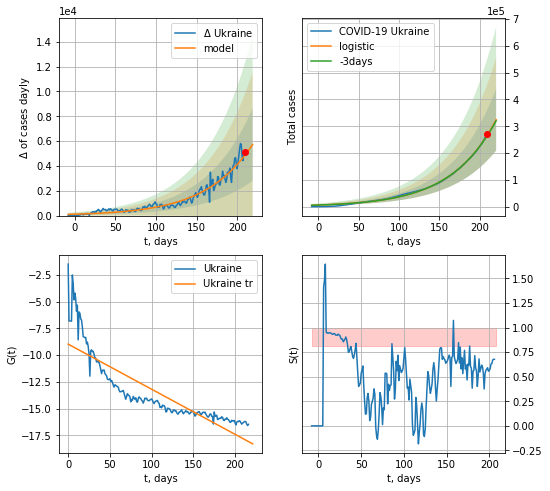

Ukraine data at: 2020-10-13
+3 day model MAPE: 0.008793080388363139
model: logistic
coeffs:  [8.85142312e+06 1.84850582e-02 3.96828393e+02]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.35551336532385497
forecast at the end of period: +11 days
	 deltaDaycases:  5730
	 total cases:  324559 ± 115385
	 total death:  6145 ± 6553
trend coefficient of determination: 0.732360
 intercept: -8.980627
 slope: -0.042141


In [597]:
dfUR = read_df(pd.DataFrame(),"Ukr")
try:
    x=forecast('Ukraine',dfUR[:],d1,T18*7-dT,addpred=True,xcoef=[0.25,1.,2.])
except:
      print("Exaption occurs") 

#xx=forecast2('Ukraine',dfUR[:],d1,14-dT,x)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: invalid value encountered in true_divide


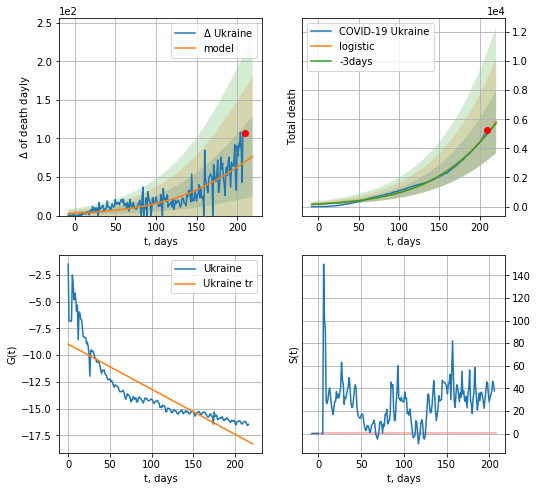

Ukraine data at: 2020-10-13
+3 day model MAPE: 0.014398967328954503
model: logistic
coeffs:  [2.57010998e+04 1.70029970e-02 2.91887412e+02]
rational stdev:  0.3702874399173193
forecast at the end of period: +11 days
	 total death:  5847 ± 2165
trend coefficient of determination: 0.732360
 intercept: -8.980627
 slope: -0.042141


In [598]:
x=forecast('Ukraine',dfUR[:],d1,T18*7-dT,addpred=False,xcoef=[0.25,1.,2.],cases='death')
#xx=forecast2('Ukraine',dfUR[:],d1,14-dT,x)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


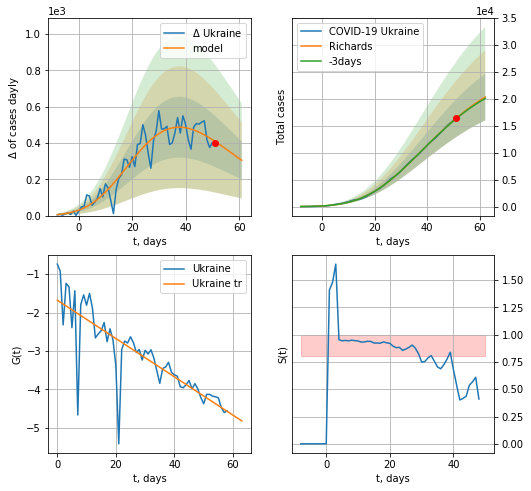

Ukraine data at: 2020-10-13
+3 day model MAPE: 0.005756
model: Richards
coeffs: [ 2.73152267e+04  5.78390591e-01 -1.00505553e+01  8.74755349e-02]
rational stdev: 0.213278
forecast at the end of period: +11 days
	 deltaDaycases: 304
	 total cases: 20343 ± 4338
	 total death: 385 ± 246
trend coefficient of determination: 0.678475
 intercept: -1.678868
 slope: -0.049847


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


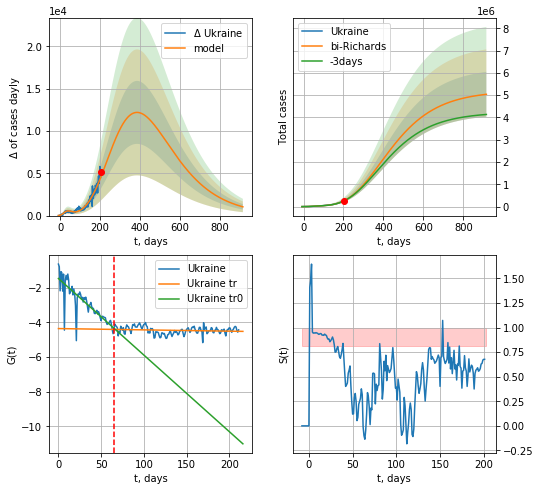

Ukraine data at: 2020-10-13
+3 day model MAPE: 0.009311
model: bi-Richards
coeffs: [ 5.17276020e+06  1.72596919e-01 -1.16551918e+02  3.78079093e-02]
rational stdev: 0.199995
forecast at the end of period: +711 days
	 deltaDaycases: 1033
	 total cases: 5039517 ± 1007876
	 total death: 95415 ± 57247
bi-Richards approximation splitting point: 65
trend coefficient of determination: 0.689205
 intercept: -1.472472
 slope: -0.044148
trend coefficient of determination: 0.023127
 intercept: -4.361004
 slope: -0.000750


In [599]:
vL = 70#65+5 +55
x=forecastRR('Ukraine',dfUR[5:vL-5],d1,7*T18-dT,addpred=False,xcoef=RkoreaCoeffs)
xx=forecast2RR('Ukraine',dfUR[5:],d1,7*130-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-5)

In [600]:
#x=forecastRRR('Ukraine',dfUR[5:],d1,7*86-dT,addpred=True,xcoef=koreaCoeffs)

In [601]:
#np.log(np.diff(dfIS["cases"].values)[:]/dfIS["cases"].values[1:]**2)

IN
           date   cases  active    death
233 2020-10-09  492378   62901  28098.0
234 2020-10-10  496253   64010  28293.0
235 2020-10-11  500075   65142  28544.0
236 2020-10-12  504281   66344  28816.0
237 2020-10-13  508389   67479  29070.0


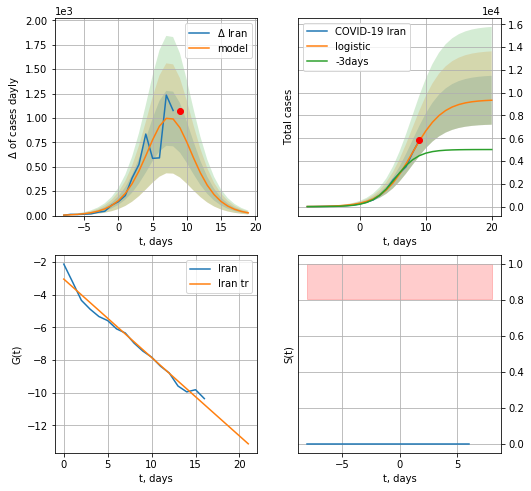

Iran data at: 2020-10-13
+3 day model MAPE: 0.4176898990261385
model: logistic
coeffs:  [9.38566043e+03 4.29600562e-01 7.92981700e+00]
rational stdev:  0.2297342183396625
forecast at the end of period: +11 days
	 deltaDaycases:  27
	 total cases:  9333 ± 2144
	 total death:  533 ± 367
trend coefficient of determination: 0.980602
 intercept: -3.037586
 slope: -0.480406


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:195: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


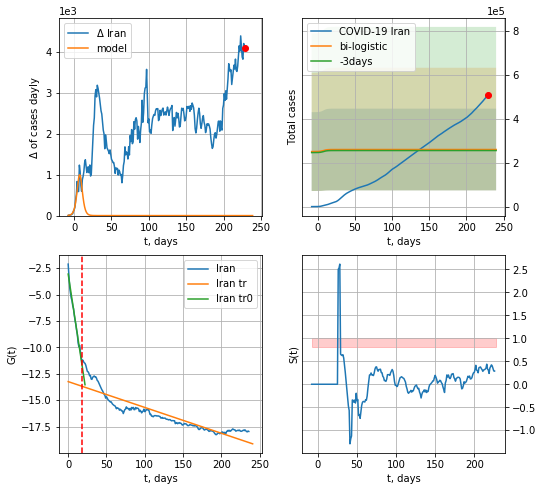

Iran data at: 2020-10-13
+3 day model MAPE: 0.01838205257407633
model: bi-logistic
coeffs:  [ 2.00604324e+05 -4.06491331e+01  2.42725209e+02] [9.38566043e+03 4.29600562e-01 7.92981700e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.7156792505421591
forecast at the end of period: +11 days
	 deltaDaycases:  0
	 total cases:  260141 ± 186177
	 total death:  14875 ± 31937
bi-logistic approximation splitting point: 18
trend0 coefficient of determination: 0.982944
 intercept: -3.059655
 slope: -0.476268
trend coefficient of determination: 0.818905
 intercept: -13.240659
 slope: -0.024433


In [602]:
dfIN = read_df(pd.DataFrame(),"IN")
x = forecast('Iran',dfIN[:18],d1,7*T18-dT)
xx = forecast2('Iran',dfIN[:],d1,T18*7-dT,x,vL=18,addpred=True,xcoef=[0.25,1.,2.0])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


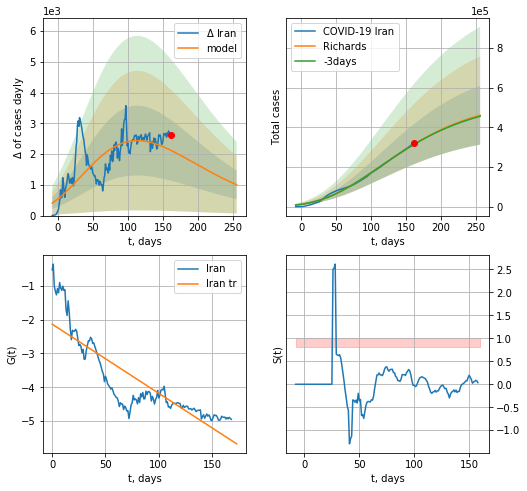

Iran data at: 2020-10-13
+3 day model MAPE: 0.004493
model: Richards
coeffs: [ 5.51823007e+05  1.04808501e+00 -2.55847777e+02  1.15235351e-02]
rational stdev: 0.321811
forecast at the end of period: +95 days
	 deltaDaycases: 1002
	 total cases: 461317 ± 148456
	 total death: 26378 ± 25466
trend coefficient of determination: 0.738838
 intercept: -2.133047
 slope: -0.020440


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


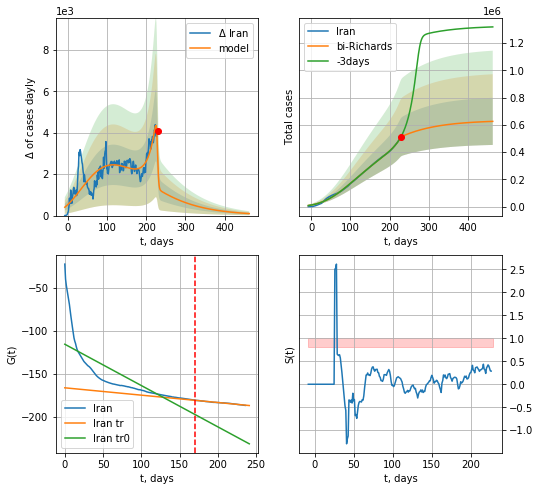

Iran data at: 2020-10-13
+3 day model MAPE: 0.011407
model: bi-Richards
coeffs: [8.18092331e+04 4.82998427e-02 2.29151535e+02 1.38548407e+01]
rational stdev: 0.276471
forecast at the end of period: +235 days
	 deltaDaycases: 96
	 total cases: 625666 ± 172978
	 total death: 35775 ± 29672
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.629402
 intercept: -115.829937
 slope: -0.479766
trend coefficient of determination: 0.990424
 intercept: -166.426721
 slope: -0.085388


In [603]:
vL = 170
x = forecastRR('Iran',dfIN[:vL],d1,42*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Iran',dfIN[:],d1,62*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

In [604]:
#x = forecastRRR('Iran',dfIN[:17],d1,T18*7-dT,addpred=False,xcoef=koreaCoeffs)
#xx = forecast2RRR('Iran',dfIN[:],d1,66*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=17)

RS
           date      cases  active    death
223 2020-10-09  1272238.0  246428  22454.0
224 2020-10-10  1285084.0  246428  22454.0
225 2020-10-11  1298718.0  265353  22722.0
226 2020-10-12  1312310.0  271427  22966.0
227 2020-10-13  1326178.0  271427  22966.0


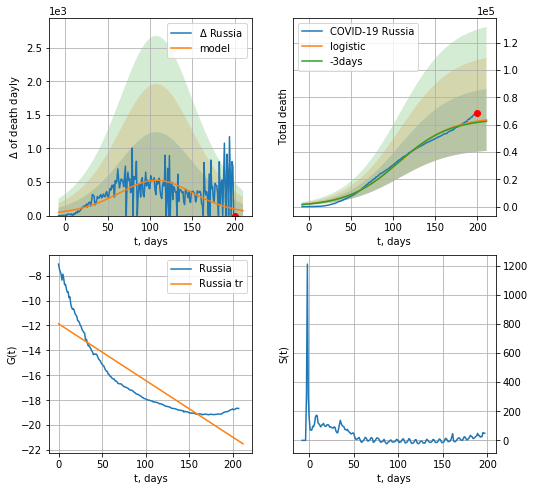

Russia data at: 2020-10-13
+3 day model MAPE: 0.0149749385810671
model: logistic
coeffs:  [6.58300515e+04 3.20317017e-02 1.07830303e+02]
rational stdev:  0.3576533415108132
forecast at the end of period: +11 days
	 total death:  63498 ± 22710
trend coefficient of determination: 0.757594
 intercept: -11.862873
 slope: -0.045433


In [605]:
try:
    dfRS = read_df(pd.DataFrame(),"RS")
    x = forecast('Russia',dfRS[19:],d1,T18*7-dT,shift=3.,cases='death')
    #xx = forecast2('Russia',dfRS[:],d1,9*7-dT,x,vL=14)#,addpred=True,xcoef=[0.5,1.,3.5]
except:
    print ("Exeption occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


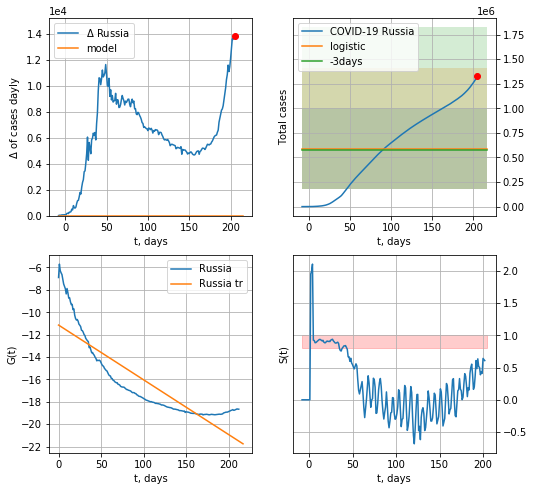

Russia data at: 2020-10-13
+3 day model MAPE: 0.017774102670051552
model: logistic
coeffs:  [ 5.88975257e+05 -1.49237279e+01  3.68344121e+02]
rational stdev:  0.7014214241954917
forecast at the end of period: +11 days
	 deltaDaycases:  0
	 total cases:  588975 ± 413119
	 total death:  10199 ± 21461
trend coefficient of determination: 0.754758
 intercept: -11.146430
 slope: -0.048870


In [606]:
x = forecast('Russia',dfRS[14:],d1,T18*7-dT,shift=1.)
#xx = forecast2('Russia',dfRS[:],d1,9*7-dT,x,vL=14,shift=1.)#,addpred=True,xcoef=[0.5,1.,3.5]

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


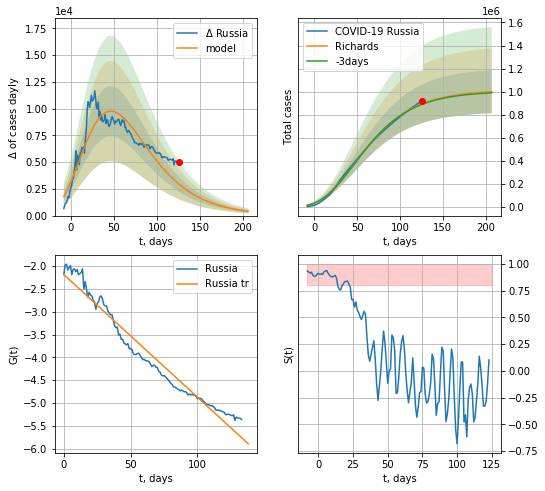

Russia data at: 2020-10-13
+3 day model MAPE: 0.005868
model: Richards
coeffs: [ 1.01532090e+06  2.66815048e+00 -1.28940873e+02  9.84509575e-03]
rational stdev: 0.186876
forecast at the end of period: +81 days
	 deltaDaycases: 397
	 total cases: 1000266 ± 186926
	 total death: 17322 ± 9711
trend coefficient of determination: 0.959018
 intercept: -2.187740
 slope: -0.026848


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


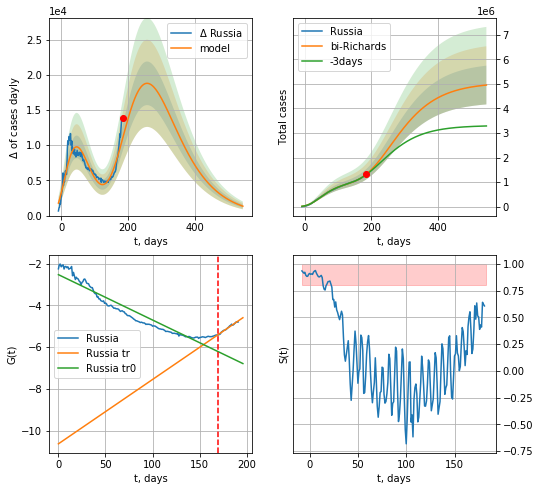

Russia data at: 2020-10-13
+3 day model MAPE: 0.009821
model: bi-Richards
coeffs: [ 4.04307899e+06  7.83838328e-01 -6.68569810e+01  1.61605098e-02]
rational stdev: 0.159273
forecast at the end of period: +361 days
	 deltaDaycases: 1336
	 total cases: 4952135 ± 788739
	 total death: 85758 ± 40976
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.912010
 intercept: -2.521110
 slope: -0.021756
trend coefficient of determination: 0.980290
 intercept: -10.634407
 slope: 0.030855


In [607]:
vL = 170 + 35
x = forecastRR('Russia',dfRS[35:vL-35],d1,40*7-dT,addpred=False,xcoef=RkoreaCoeffs)#,addpred=True,xcoef=[0.25,1.,1.5,1]
xx = forecast2RR('Russia',dfRS[35:],d1,80*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-35)
#x = forecastQR('Russia',dfRS[20:],d1,30*7-dT)#,addpred=True,xcoef=[0.25,1.,1.5,1]

In [608]:
#x = forecastRRR('Russia',dfRS[:],d1,68*7-dT,addpred=True,xcoef=koreaCoeffs)

JP
           date    cases  active   death
261 2020-10-09  87639.0    5290  1616.0
262 2020-10-10  88233.0    5253  1624.0
263 2020-10-11  88912.0    5461  1627.0
264 2020-10-12  89347.0    5605  1629.0
265 2020-10-13  89673.0    5418  1634.0


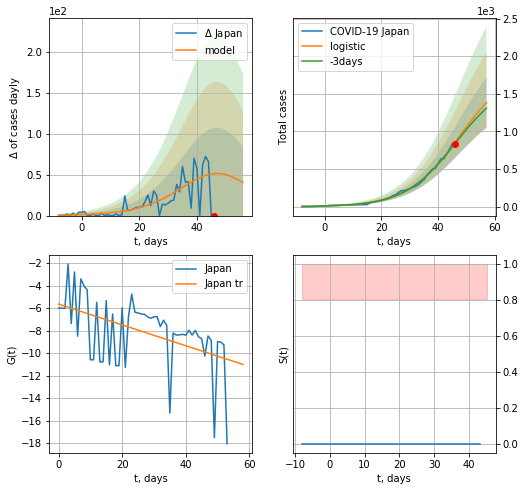

Japan data at: 2020-10-13
+3 day model MAPE: 0.024413899387998084
model: logistic
coeffs:  [1.86668600e+03 1.09971339e-01 4.74124631e+01]
rational stdev:  0.24188431732788906
forecast at the end of period: +11 days
	 deltaDaycases:  40
	 total cases:  1384 ± 334
	 total death:  25 ± 18
trend coefficient of determination: 0.226001
 intercept: -5.646499
 slope: -0.092589


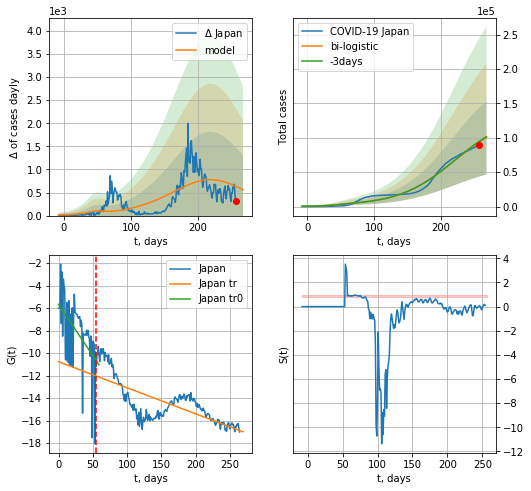

Japan data at: 2020-10-13
+3 day model MAPE: 0.010699455483883891
model: bi-logistic
coeffs:  [1.28178320e+05 2.43004187e-02 2.18809335e+02] [1.86668600e+03 1.09971339e-01 4.74124631e+01]
rational stdev:  0.5346928721631805
forecast at the end of period: +11 days
	 deltaDaycases:  559
	 total cases:  100268 ± 53613
	 total death:  1827 ± 2930
bi-logistic approximation splitting point: 55
trend0 coefficient of determination: 0.229818
 intercept: -5.672459
 slope: -0.091119
trend coefficient of determination: 0.546889
 intercept: -10.773188
 slope: -0.023148


In [609]:
dfJP = read_df(pd.DataFrame(),"JP")
try:
    x = forecast('Japan',dfJP[:55],d1,7*T18-dT)
    xx = forecast2('Japan',dfJP[:],d1,T18*7-dT,x,addpred=False,xcoef=[0.25,1.,1.25],vL=55)
except:
    print ("Exception occurs")

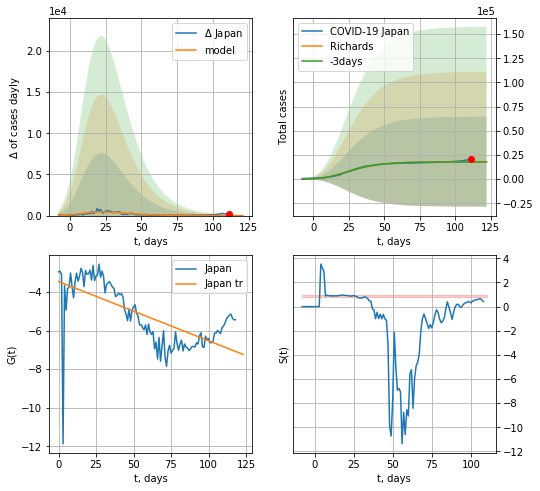

Japan data at: 2020-10-13
+3 day model MAPE: 0.014160
model: Richards
coeffs: [ 1.80899741e+04  8.76063151e-01 -1.40637335e+01  7.97075842e-02]
rational stdev: 2.570143
forecast at the end of period: +11 days
	 deltaDaycases: 1
	 total cases: 18073 ± 46450
	 total death: 329 ± 2536
trend coefficient of determination: 0.437220
 intercept: -3.449083
 slope: -0.030740


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


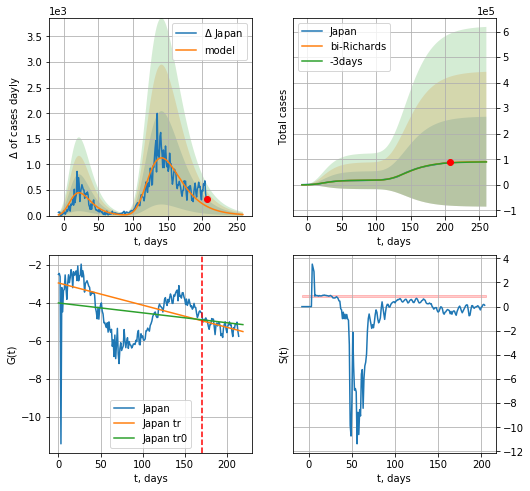

Japan data at: 2020-10-13
+3 day model MAPE: 0.007863
model: bi-Richards
coeffs: [7.29772077e+04 3.16433181e+00 3.97030114e+01 1.33724111e-02]
rational stdev: 1.941361
forecast at the end of period: +53 days
	 deltaDaycases: 20
	 total cases: 90580 ± 175849
	 total death: 1650 ± 9609
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.035500
 intercept: -4.016855
 slope: -0.005198
trend coefficient of determination: 0.271673
 intercept: -2.963977
 slope: -0.011672


In [610]:
iL = 50
vL = 170+iL
x = forecastRR('Japan',dfJP[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Japan',dfJP[iL:],d1,36*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


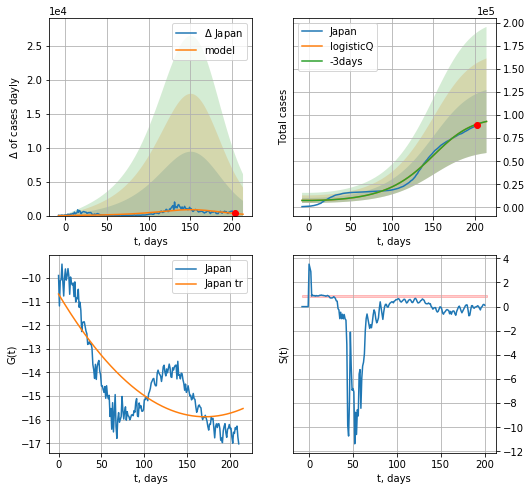

Japan data at: 2020-10-13
+3 day model MAPE: 0.000307
model: logisticQ
coeffs: [ 9.61809639e+04  1.22343967e-04  1.41041579e+02 -1.44350079e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.367069
forecast at the end of period: +11 days
	 deltaDaycases: 201
	 total cases: 93129 ± 34185
	 total death: 1696 ± 1867
trend coefficient of determination: 0.648285
 intercept_: -10.6793245910767
 coeffs_: [ 0.         -0.06086207  0.00017823]


In [611]:
x = forecastRRR('Japan',dfJP[54:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)

NL
           date     cases  active   death
225 2020-10-09  161781.0       0  6544.0
226 2020-10-10  168280.0       0  6567.0
227 2020-10-11  174653.0       0  6584.0
228 2020-10-12  181498.0       0  6596.0
229 2020-10-13  188876.0       0  6631.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


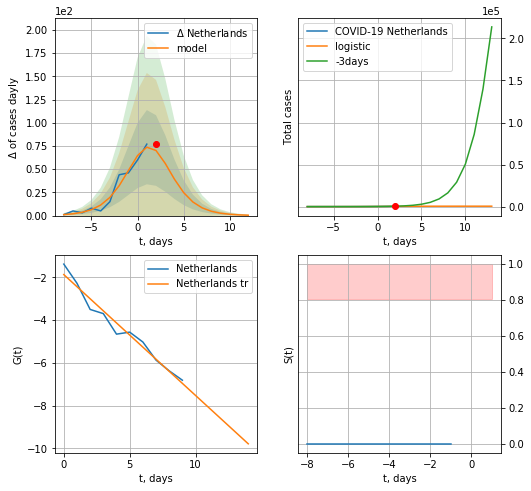

Netherlands data at: 2020-10-13
model: logistic
coeffs:  [487.7470779    0.61204075   1.72557626]
rational stdev:  0.23761281134430468
forecast at the end of period: +11 days
	 deltaDaycases:  0
	 total cases:  487 ± 115
	 total death:  17 ± 12
trend coefficient of determination: 0.966773
 intercept: -1.876651
 slope: -0.565279


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


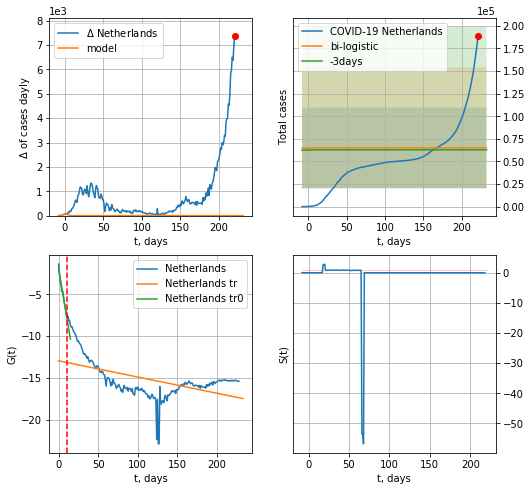

Netherlands data at: 2020-10-13
+3 day model MAPE: 0.03407243631199697
model: bi-logistic
coeffs:  [ 5.15902808e+04 -9.80424820e+00  2.63611759e+02] [487.7470779    0.61204075   1.72557626]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.6868894345171794
forecast at the end of period: +11 days
	 deltaDaycases:  0
	 total cases:  64975 ± 44631
	 total death:  2281 ± 4700
bi-logistic approximation splitting point: 11
trend0 coefficient of determination: 0.974821
 intercept: -1.878275
 slope: -0.564738
trend coefficient of determination: 0.281255
 intercept: -12.938666
 slope: -0.019372


In [612]:
vL=11
vL1=32
dfNL = read_df(pd.DataFrame(),"NL")
x = forecast('Netherlands',dfNL[:vL],d1,T18*7-dT,pMAPE=False)
xx = forecast2('Netherlands',dfNL[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Philippines",dfPH,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: invalid value encountered in true_divide


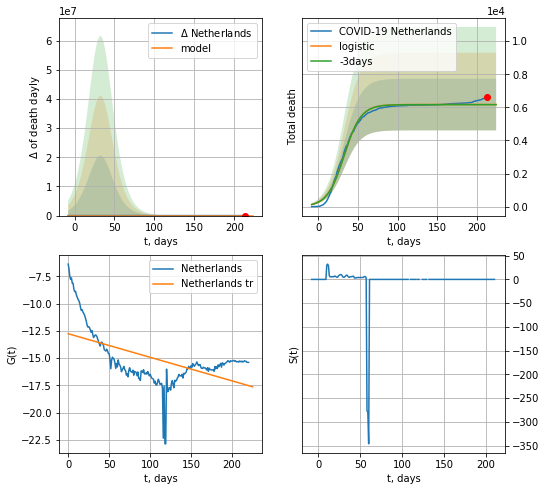

Netherlands data at: 2020-10-13
+3 day model MAPE: 0.0015455513412278288
model: logistic
coeffs:  [6.17421674e+03 9.45928586e-02 3.28636065e+01]
rational stdev:  0.25322430502666227
forecast at the end of period: +11 days
	 total death:  6174 ± 1563
trend coefficient of determination: 0.309692
 intercept: -12.760918
 slope: -0.021631


In [613]:
x = forecast('Netherlands',dfNL[8:],d1,T18*7-dT,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


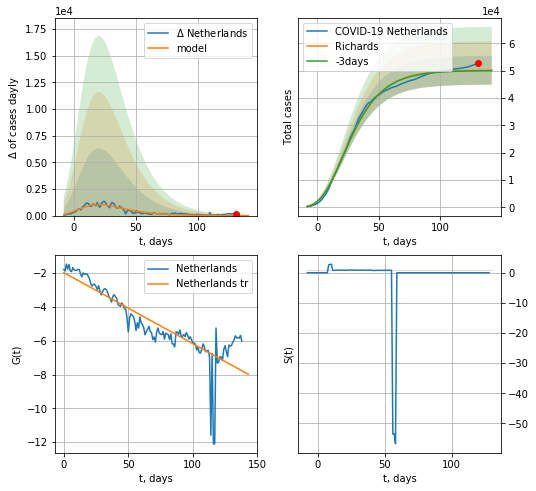

Netherlands data at: 2020-10-13
+3 day model MAPE: 0.003437
model: Richards
coeffs: [ 5.02415869e+04  8.73155449e+00 -6.99416502e+01  6.38067202e-03]
rational stdev: 0.105306
forecast at the end of period: +11 days
	 deltaDaycases: 3
	 total cases: 50182 ± 5284
	 total death: 1761 ± 556
trend coefficient of determination: 0.744376
 intercept: -1.967578
 slope: -0.042068


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


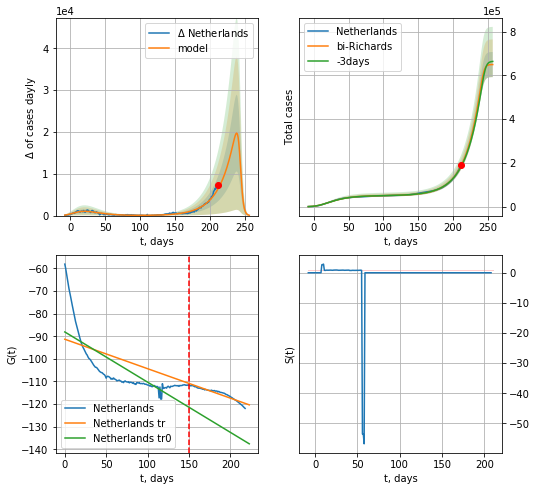

Netherlands data at: 2020-10-13
+3 day model MAPE: 0.021249
model: bi-Richards
coeffs: [5.99614355e+05 4.63376045e-02 2.43494893e+02 9.76728980e+00]
rational stdev: 0.088289
forecast at the end of period: +46 days
	 deltaDaycases: 77
	 total cases: 649720 ± 57363
	 total death: 22810 ± 6041
bi-Richards approximation splitting point: 150
trend coefficient of determination: 0.589194
 intercept: -88.105157
 slope: -0.221749
trend coefficient of determination: 0.911058
 intercept: -91.320938
 slope: -0.130106


In [614]:
iL = 10
vL = 150+iL
x = forecastRR('Netherlands',dfNL[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Netherlands',dfNL[iL:],d1,35*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [615]:
#x = forecastQR('Netherlands',dfNL[7:],d1,16*7-dT)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


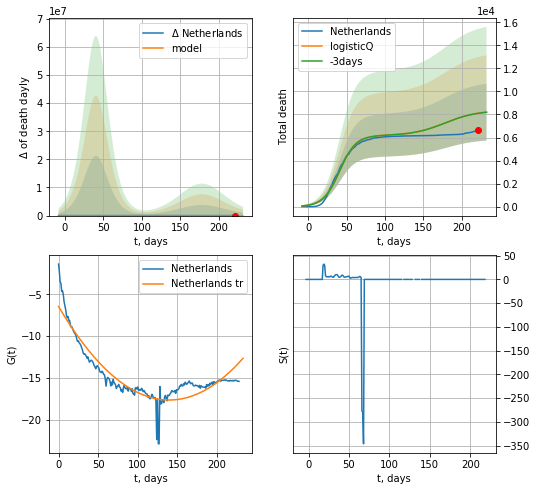

Netherlands data at: 2020-10-13
+3 day model MAPE: 0.001024
model: logisticQ
coeffs: [ 6.17359215e+03  2.33750575e-07  4.08661736e+01 -4.05771922e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.300590
forecast at the end of period: +11 days
	 total death: 8204 ± 2466
trend coefficient of determination: 0.854839
 intercept_: -6.45595767734557
 coeffs_: [ 0.         -0.15991889  0.00057238]


In [616]:
#x = forecastRRR('Netherlands',dfNL[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)
x = forecastRRR('Netherlands',dfNL[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

In [617]:
#trend3(dfAT[1:],dfSG[:],dfBG[:],'AT','SG','BG',40,35,35)

AT
           date    cases  active  death
226 2020-10-09  54423.0   10742  852.0
227 2020-10-10  54869.0   10742  852.0
228 2020-10-11  55319.0   11020  851.0
229 2020-10-12  56298.0   11378  855.0
230 2020-10-13  57326.0   11516  861.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:86: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


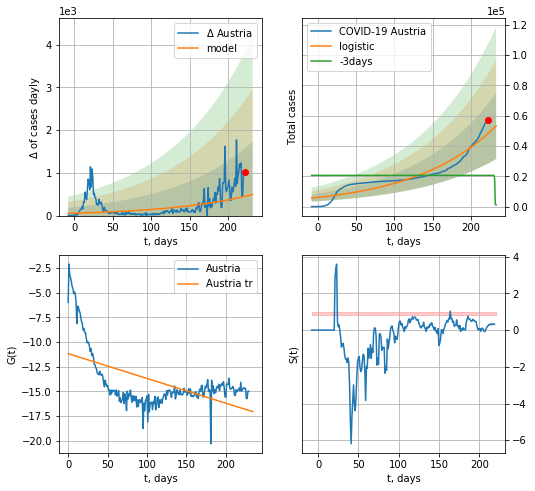

Austria data at: 2020-10-13
+3 day model MAPE: 1.3513813626119782
model: logistic
coeffs:  [1.17208471e+08 9.35283467e-03 1.05604290e+03]
scenario coeffs:  [0.0625, 1.0, 2.0]
rational stdev:  0.4093873209377774
forecast at the end of period: +11 days
	 deltaDaycases:  494
	 total cases:  53168 ± 21766
	 total death:  798 ± 980
trend coefficient of determination: 0.310824
 intercept: -11.186722
 slope: -0.025058


In [618]:
dfAT = read_df(pd.DataFrame(),"AT")
try:
    x = forecast('Austria',dfAT[:],d1,7*T18-dT,addpred=True,xcoef=[0.25/4,1.,2.0])
except:
    print ("Exception occurs")
#xx = forecast2('Austria',dfAT[:],d1,7*7-dT,x,addpred=True,xcoef=[0.35*2,1.,1.5],vL=36)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


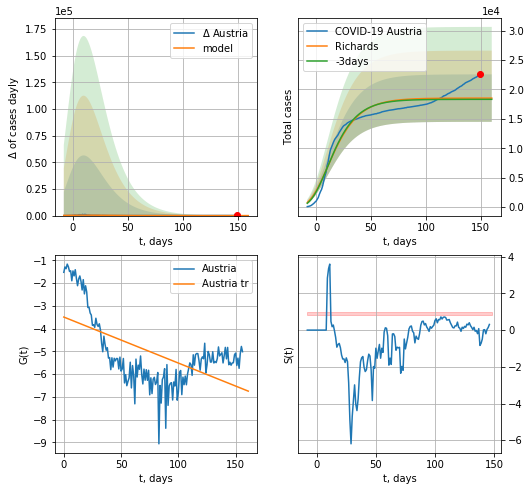

Austria data at: 2020-10-13
+3 day model MAPE: 0.011248
model: Richards
coeffs: [ 1.85372562e+04  2.13083483e+01 -8.31073338e+01  2.92776716e-03]
rational stdev: 0.217548
forecast at the end of period: +11 days
	 deltaDaycases: 0
	 total cases: 18535 ± 4032
	 total death: 278 ± 181
trend coefficient of determination: 0.338882
 intercept: -3.488096
 slope: -0.020227


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


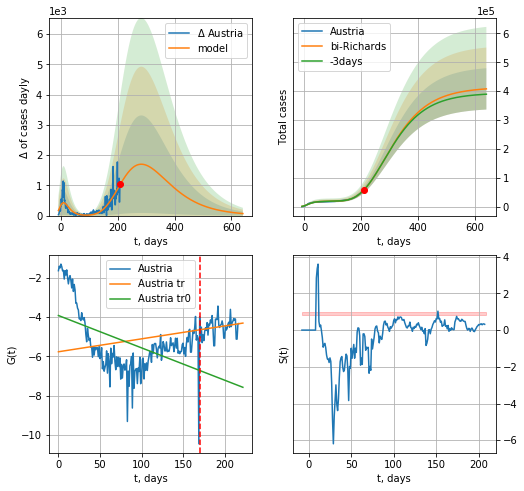

Austria data at: 2020-10-13
+3 day model MAPE: 0.001880
model: bi-Richards
coeffs: [ 3.94887896e+05  4.09906263e-01 -1.52520325e+01  2.89218274e-02]
rational stdev: 0.175389
forecast at the end of period: +431 days
	 deltaDaycases: 67
	 total cases: 407760 ± 71516
	 total death: 6124 ± 3222
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.257441
 intercept: -3.927134
 slope: -0.016433
trend coefficient of determination: 0.043051
 intercept: -5.769485
 slope: 0.006564


In [619]:
vL=170+12
x = forecastRR('Austria',dfAT[12:vL-12],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Austria',dfAT[12:],d12f(1),90*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12)
#xx = forecast2R('Austria',dfAT[:],d1,8*7-dT,x)

In [620]:
#vL = 68
#x = forecastRRR('Austria',dfAT[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)
#xx = forecast2RRR('Austria',dfAT[:],d1,18*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=vL)

BG
           date     cases  active    death
222 2020-10-09  148981.0  118758  10151.0
223 2020-10-10  156931.0  126554  10175.0
224 2020-10-11  162258.0  131795  10191.0
225 2020-10-12  165880.0  135345  10211.0
226 2020-10-13  173240.0  142544  10244.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


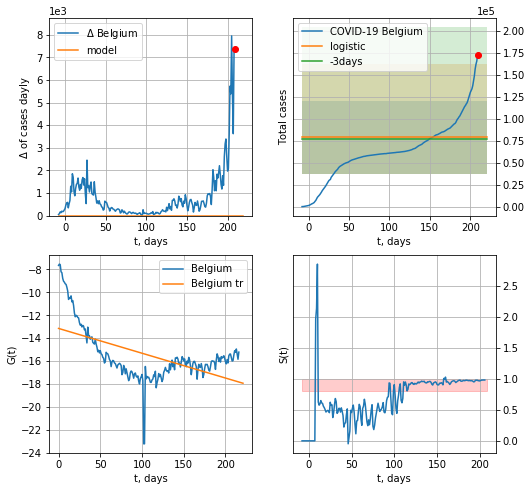

Belgium data at: 2020-10-13
+3 day model MAPE: 0.023487932980697027
model: logistic
coeffs:  [ 6.31934720e+04 -1.37671153e+01  3.94975661e+02]
scenario coeffs:  [0.25, 1.0, 3.0]
rational stdev:  0.5307200456782954
forecast at the end of period: +11 days
	 deltaDaycases:  0
	 total cases:  78991 ± 41922
	 total death:  4670 ± 7435
trend coefficient of determination: 0.320563
 intercept: -13.150406
 slope: -0.021663


In [621]:
vL=9
try:
    dfBG = read_df(pd.DataFrame(),"BG")
    x = forecast('Belgium',dfBG[vL:],d1,T18*7-dT,addpred=True,xcoef=[0.25,1.,3.])
    #xx = forecast2('Belgium',dfBG[vL:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)
except:
    print("Exception occurs")

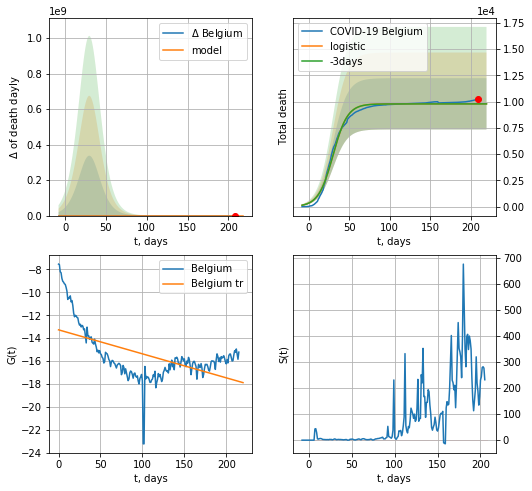

Belgium data at: 2020-10-13
+3 day model MAPE: 0.0009281682542069635
model: logistic
coeffs:  [9.79720875e+03 1.11779627e-01 3.01109908e+01]
rational stdev:  0.24930010397318667
forecast at the end of period: +11 days
	 total death:  9797 ± 2442
trend coefficient of determination: 0.311164
 intercept: -13.273953
 slope: -0.020952


In [622]:
#dfBG = read_df(pd.DataFrame(),"BG")
x = forecast('Belgium',dfBG[10:],d1,T18*7-dT,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


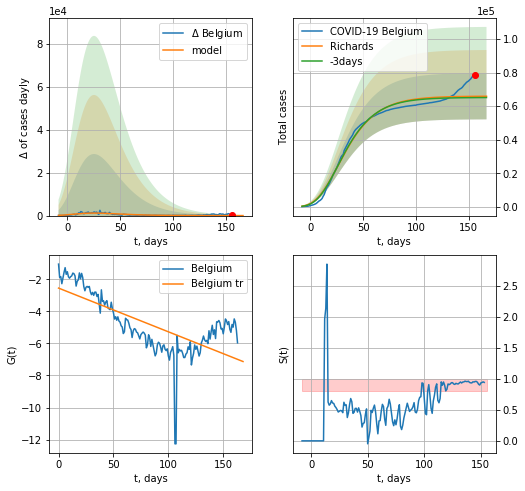

Belgium data at: 2020-10-13
+3 day model MAPE: 0.011690
model: Richards
coeffs: [ 6.59502350e+04  1.16564107e+01 -8.64901843e+01  4.18089404e-03]
rational stdev: 0.209120
forecast at the end of period: +11 days
	 deltaDaycases: 3
	 total cases: 65882 ± 13777
	 total death: 3895 ± 2443
trend coefficient of determination: 0.496391
 intercept: -2.551765
 slope: -0.027253


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


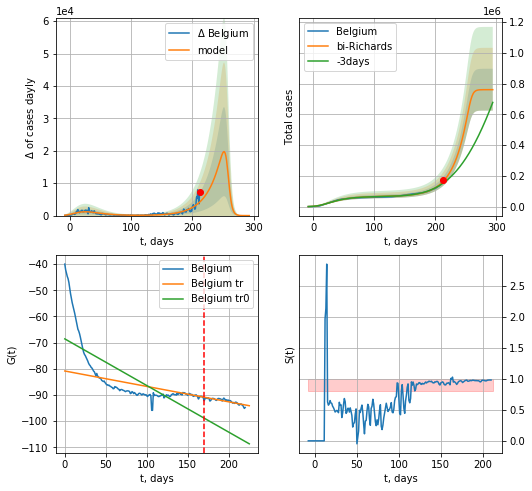

Belgium data at: 2020-10-13
+3 day model MAPE: 0.082521
model: bi-Richards
coeffs: [6.93983499e+05 4.27622281e-02 2.58535291e+02 7.59707372e+00]
rational stdev: 0.178886
forecast at the end of period: +81 days
	 deltaDaycases: 0
	 total cases: 759932 ± 135941
	 total death: 44936 ± 24115
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.549601
 intercept: -68.574726
 slope: -0.178172
trend coefficient of determination: 0.724248
 intercept: -80.841684
 slope: -0.058947


In [623]:
iL = 5
vL = 170+ iL
x = forecastRR('Belgium',dfBG[iL:vL-iL],d1,30*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Belgium',dfBG[iL:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [624]:
#x = forecastRRR('Belgium',dfBG[:],d1,34*7-dT,addpred=True,xcoef=koreaCoeffs)

In [625]:
dfBZ.tail()

,date,cases,active,death
227,2020-10-09,5057190.0,473903,149692.0
228,2020-10-10,5091840.0,487882,150236.0
229,2020-10-11,5094979.0,474308,150506.0
230,2020-10-12,5103408.0,457430,150709.0
231,2020-10-13,5114823.0,436785,151063.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


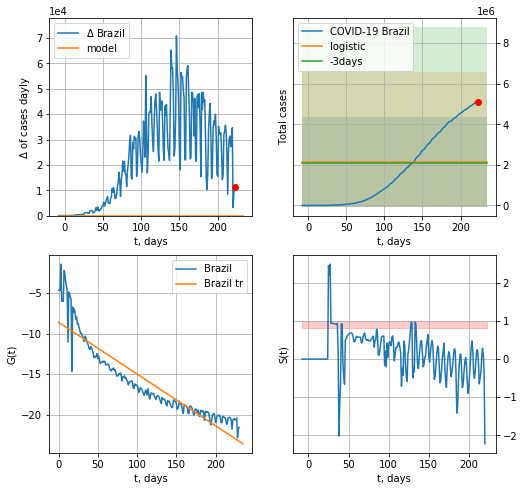

Brazil data at: 2020-10-13
+3 day model MAPE: 0.026346249956363133
model: logistic
coeffs:  [ 1.72476783e+06 -3.06323242e+01  7.32340154e+02]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  1.0262027501685749
forecast at the end of period: +11 days
	 deltaDaycases:  0
	 total cases:  2155959 ± 2212451
	 total death:  63674 ± 196027
trend coefficient of determination: 0.845361
 intercept: -8.596188
 slope: -0.063821


In [626]:
x = forecast('Brazil',dfBZ[:],d1,T18*7-dT,addpred=True,xcoef=[0.25,1.,2.])
#xx = forecast2('Brazil',dfBZ[:],d1,4*7-dT,x)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


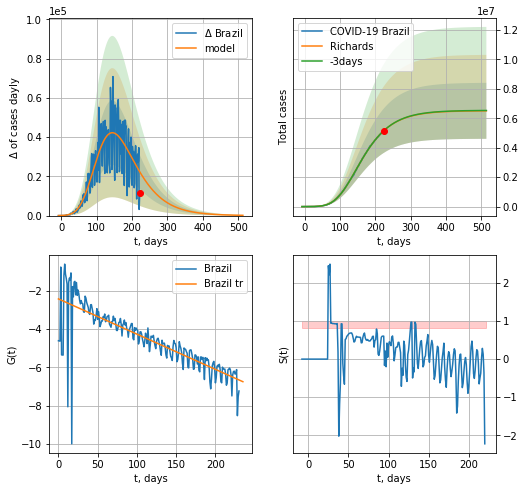

Brazil data at: 2020-10-13
+3 day model MAPE: 0.000832
model: Richards
coeffs: [6.51607976e+06 2.49430970e-01 1.59496958e+00 7.32409509e-02]
rational stdev: 0.292085
forecast at the end of period: +291 days
	 deltaDaycases: 140
	 total cases: 6508431 ± 1901016
	 total death: 192222 ± 168435
trend coefficient of determination: 0.661272
 intercept: -2.435844
 slope: -0.018365


In [627]:
x = forecastRR('Brazil',dfBZ[:],d1,70*7-dT,addpred=False,xcoef=RkoreaCoeffs)
#x = forecastQR('Brazil',dfBZ[10:],d1,50*7-dT)

In [628]:
#x = forecastRRR('Brazil',dfBZ[6:],d1,70*7-dT,addpred=True,xcoef=koreaCoeffs)

In [629]:
#x = forecastRRR('Brazil',dfBZ[5:],d1,25*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

AS
           date    cases  active  death
237 2020-10-09  27244.0    1360  897.0
238 2020-10-10  27265.0    1369  898.0
239 2020-10-11  27285.0    1389  898.0
240 2020-10-12  27310.0    1396  899.0
241 2020-10-13  27337.0    1392  904.0


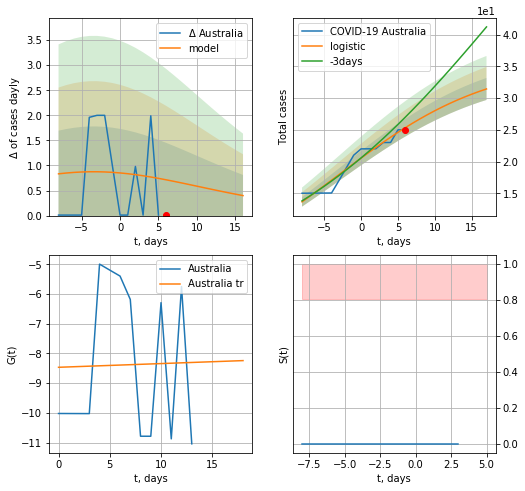

Australia data at: 2020-10-13
model: logistic
coeffs:  [35.98148465  0.0972901  -2.93370788]
rational stdev:  0.05518162900834631
forecast at the end of period: +11 days
	 deltaDaycases:  0
	 total cases:  31 ± 1
	 total death:  1 ± 0
trend coefficient of determination: 0.000431
 intercept: -8.467221
 slope: 0.012491


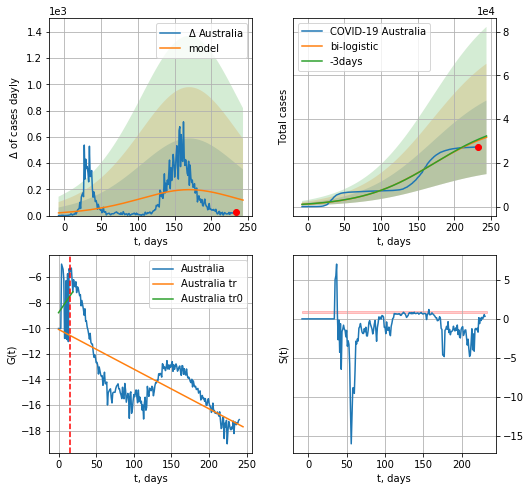

Australia data at: 2020-10-13
+3 day model MAPE: 0.015980586613168778
model: bi-logistic
coeffs:  [3.87012532e+04 2.04160951e-02 1.70178439e+02] [35.98148465  0.0972901  -2.93370788]
rational stdev:  0.5307453424520393
forecast at the end of period: +11 days
	 deltaDaycases:  118
	 total cases:  31718 ± 16834
	 total death:  1048 ± 1668
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.022779
 intercept: -8.785888
 slope: 0.086030
trend coefficient of determination: 0.513146
 intercept: -10.091067
 slope: -0.031029


In [630]:
dfAS = read_df(pd.DataFrame(),"AS")
try:
    x = forecast('Australia',dfAS[:15],d1,T18*7-dT,pMAPE=False)
    xx = forecast2('Australia',dfAS[:],d1,T18*7-dT,x,vL=15,addpred=False,xcoef=[0.25/4,1.,1.8])
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


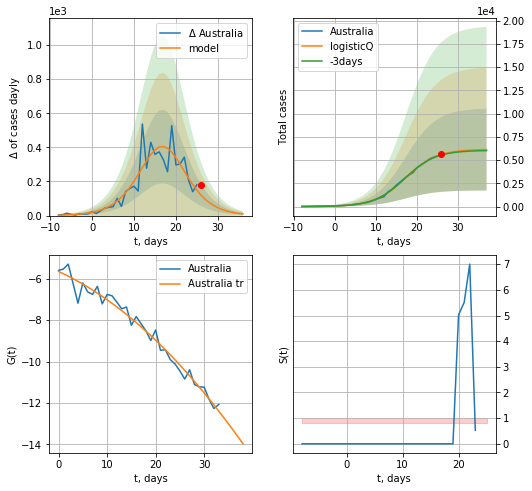

Australia data at: 2020-10-13
+3 day model MAPE: 0.012936
model: logisticQ
coeffs: [ 6.16826027e+03  4.63150668e-05  1.72354354e+01 -5.67232010e+03]
rational stdev: 0.716727
forecast at the end of period: +11 days
	 deltaDaycases: 9
	 total cases: 6135 ± 4397
	 total death: 202 ± 434
trend coefficient of determination: 0.975101
 intercept_: -5.657250296853678
 coeffs_: [ 0.         -0.10702975 -0.00294069]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


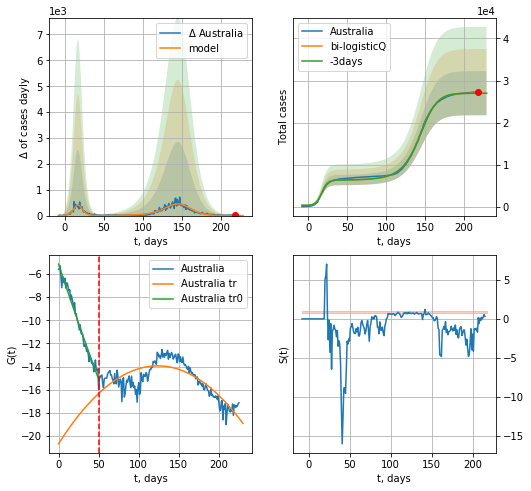

Australia data at: 2020-10-13
+3 day model MAPE: 0.000980
model: bi-logisticQ
coeffs: [ 2.08255700e+04  3.88385799e-04  1.42700528e+02 -7.82521772e+01]
rational stdev: 0.194505
forecast at the end of period: +11 days
	 deltaDaycases: 0
	 total cases: 26993 ± 5250
	 total death: 892 ± 520
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.978786
 intercept_: -5.1508340728883
 coeffs_: [ 0.00000000e+00 -2.09278795e-01  2.06303704e-04]
trend coefficient of determination: 0.642893
 intercept_: -20.680864817341217
 coeffs_: [ 0.          0.1089465  -0.00044048]


In [631]:
#axcoef = [koreaCoeffs[0],koreaCoeffs[1],koreaCoeffs[2],koreaCoeffs[3]]
vL = 50
x = forecastRRR('Australia',dfAS[15:vL],d1,T18*7-dT,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Australia',dfAS[15:],d1,T18*7-dT,x,addpred=False,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


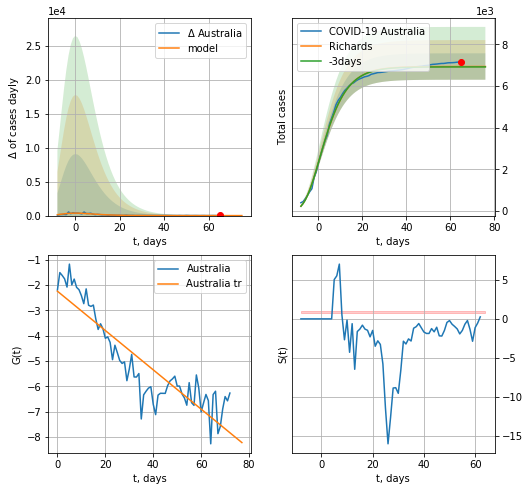

Australia data at: 2020-10-13
+3 day model MAPE: 0.002782
model: Richards
coeffs: [ 6.93376739e+03  1.41182137e+01 -3.14466269e+01  1.01384170e-02]
rational stdev: 0.091309
forecast at the end of period: +11 days
	 deltaDaycases: 0
	 total cases: 6933 ± 633
	 total death: 229 ± 62
trend coefficient of determination: 0.809708
 intercept: -2.241214
 slope: -0.077557


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


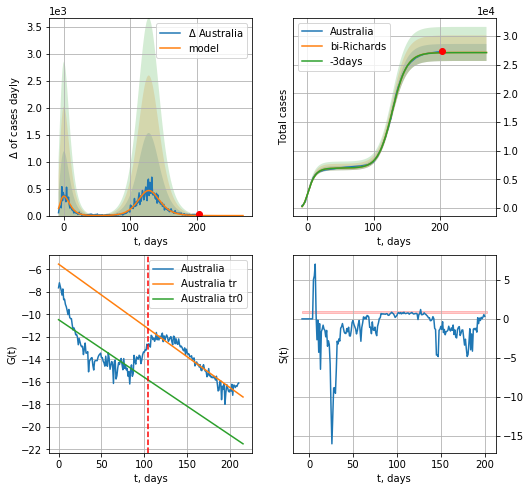

Australia data at: 2020-10-13
+3 day model MAPE: 0.000967
model: bi-Richards
coeffs: [2.01804156e+04 9.94921185e-02 1.26707200e+02 8.99773628e-01]
rational stdev: 0.054812
forecast at the end of period: +67 days
	 deltaDaycases: 0
	 total cases: 27114 ± 1486
	 total death: 896 ± 147
bi-Richards approximation splitting point: 104
trend coefficient of determination: 0.544947
 intercept: -10.474886
 slope: -0.051363
trend coefficient of determination: 0.900913
 intercept: -5.530626
 slope: -0.054985


In [632]:
iL = 20+10
vL = 104+iL
x = forecastRR('Australia',dfAS[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Australia',dfAS[iL:],d1,38*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

ML
           date    cases  active  death
225 2020-10-09  14722.0    3863  152.0
226 2020-10-10  15096.0    4161  155.0
227 2020-10-11  15657.0    4587  157.0
228 2020-10-12  16220.0    5039  159.0
229 2020-10-13  16880.0    5345  163.0


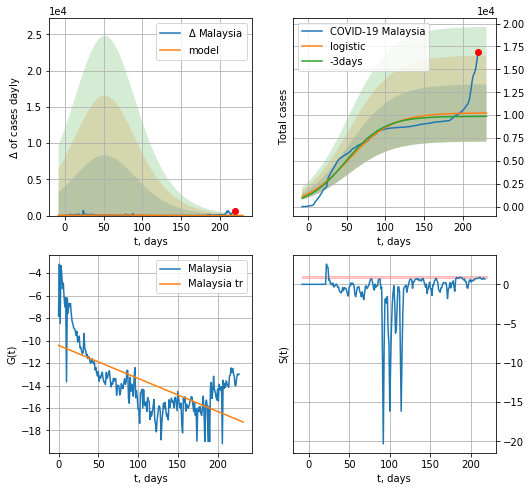

Malaysia data at: 2020-10-13
+3 day model MAPE: 0.03699816166241854
model: logistic
coeffs:  [1.02543865e+04 3.51005725e-02 5.21172046e+01]
rational stdev:  0.3061417670375615
forecast at the end of period: +11 days
	 deltaDaycases:  0
	 total cases:  10235 ± 3133
	 total death:  98 ± 90
trend coefficient of determination: 0.432283
 intercept: -10.429275
 slope: -0.029374


In [633]:
try:
    dfML = read_df(pd.DataFrame(),"ML")
    x = forecast('Malaysia',dfML[1:],d1,T18*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


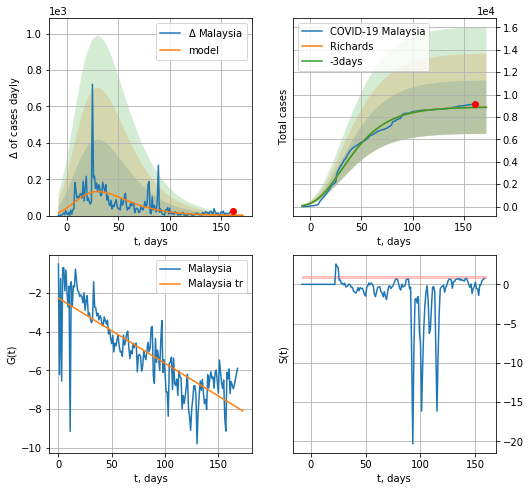

Malaysia data at: 2020-10-13
+3 day model MAPE: 0.002240
model: Richards
coeffs: [ 8.90988900e+03  9.44653085e+00 -1.04060324e+02  4.28353192e-03]
rational stdev: 0.268624
forecast at the end of period: +11 days
	 deltaDaycases: 1
	 total cases: 8880 ± 2385
	 total death: 85 ± 68
trend coefficient of determination: 0.661509
 intercept: -2.276525
 slope: -0.033689


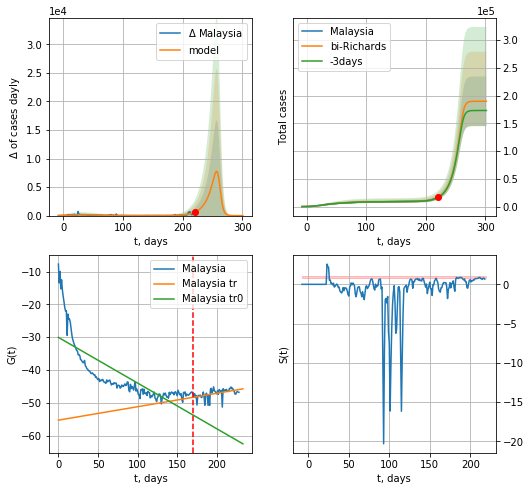

Malaysia data at: 2020-10-13
+3 day model MAPE: 0.004932
model: bi-Richards
coeffs: [1.80904788e+05 7.67344981e-02 2.61834520e+02 4.47463356e+00]
rational stdev: 0.235409
forecast at the end of period: +81 days
	 deltaDaycases: 0
	 total cases: 189814 ± 44684
	 total death: 1832 ± 1293
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.618479
 intercept: -30.052750
 slope: -0.139257
trend coefficient of determination: 0.246764
 intercept: -55.283506
 slope: 0.040937


In [634]:
vL = 170
x = forecastRR('Malaysia',dfML[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Malaysia',dfML[:],d12f(1),40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

In [635]:
#x = forecastRRR('Malaysia',dfML[:],d1,25*7-dT,addpred=True,xcoef=koreaCoeffs)

ZL
           date   cases  active  death
224 2020-10-09  1870.0      44   25.0
225 2020-10-10  1871.0      45   25.0
226 2020-10-11  1871.5      45   25.0
227 2020-10-12  1872.0      39   25.0
228 2020-10-13  1874.0      40   25.0


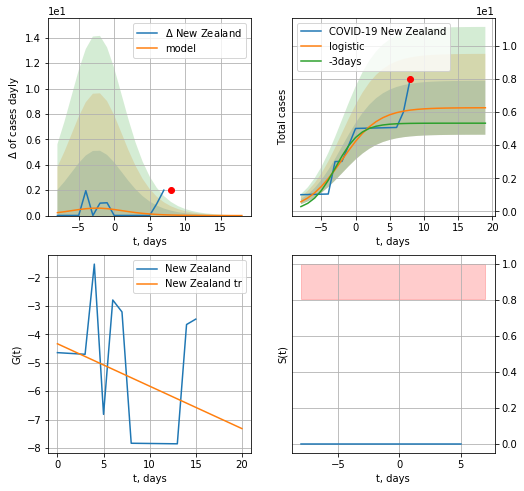

New Zealand data at: 2020-10-13
model: logistic
coeffs:  [ 6.26235964  0.37662733 -1.95315912]
rational stdev:  0.26005250706023997
forecast at the end of period: +11 days
	 deltaDaycases:  0
	 total cases:  6 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.103357
 intercept: -4.332661
 slope: -0.149156


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


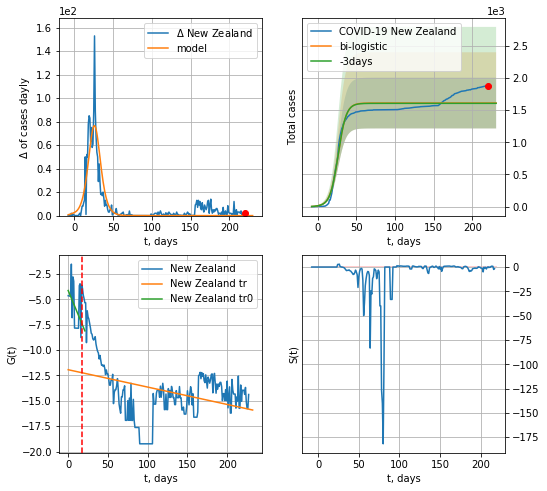

New Zealand data at: 2020-10-13
+3 day model MAPE: 0.0029398743300170596
model: bi-logistic
coeffs:  [1.60322266e+03 1.91378371e-01 2.63510375e+01] [ 6.26235964  0.37662733 -1.95315912]
rational stdev:  0.24486575336253485
forecast at the end of period: +11 days
	 deltaDaycases:  0
	 total cases:  1609 ± 394
	 total death:  21 ± 15
bi-logistic approximation splitting point: 17
trend0 coefficient of determination: 0.175036
 intercept: -4.131936
 slope: -0.189301
trend coefficient of determination: 0.118956
 intercept: -11.936529
 slope: -0.017117


In [638]:
vL=17
dfZL = read_df(pd.DataFrame(),"ZL")
try:
    x = forecast('New Zealand',dfZL[:vL],d1,T18*7-dT,pMAPE=False)
    xx = forecast2('New Zealand',dfZL[:],d1,T18*7-dT,x,addpred=False,xcoef=[0.25,1.,2.],vL=vL)#
except:
    print ("Exception occurs")

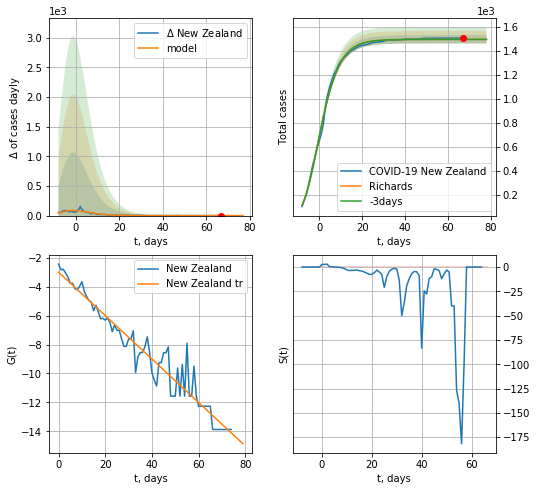

New Zealand data at: 2020-10-13
+3 day model MAPE: 0.000505
model: Richards
coeffs: [ 1.49487953e+03  6.79159620e-01 -8.03485752e+00  2.67314239e-01]
rational stdev: 0.023076
forecast at the end of period: +11 days
	 deltaDaycases: 0
	 total cases: 1494 ± 34
	 total death: 19 ± 1
trend coefficient of determination: 0.938641
 intercept: -2.993592
 slope: -0.150300


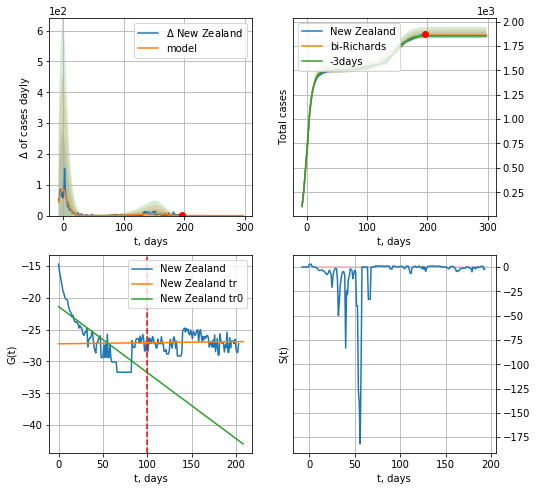

New Zealand data at: 2020-10-13
+3 day model MAPE: 0.002950
model: bi-Richards
coeffs: [3.65304527e+02 4.04339693e-02 1.60668362e+02 2.70264341e+00]
rational stdev: 0.015262
forecast at the end of period: +102 days
	 deltaDaycases: 0
	 total cases: 1860 ± 28
	 total death: 24 ± 1
bi-Richards approximation splitting point: 100
trend coefficient of determination: 0.563834
 intercept: -21.383373
 slope: -0.103548
trend coefficient of determination: 0.001724
 intercept: -27.228044
 slope: 0.001673


In [639]:
iL = 24
vL = 100+iL
x = forecastRR('New Zealand',dfZL[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('New Zealand',dfZL[iL:],d12f(1),43*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [640]:
#x = forecastRRR('New Zealand',dfZL[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)

BR
           date    cases  active  death
224 2020-10-09  82471.0    5043  885.0
225 2020-10-10  83023.0    5149  891.0
226 2020-10-11  83534.0    5418  896.0
227 2020-10-12  83998.0    5674  901.0
228 2020-10-13  84524.0    5821  906.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


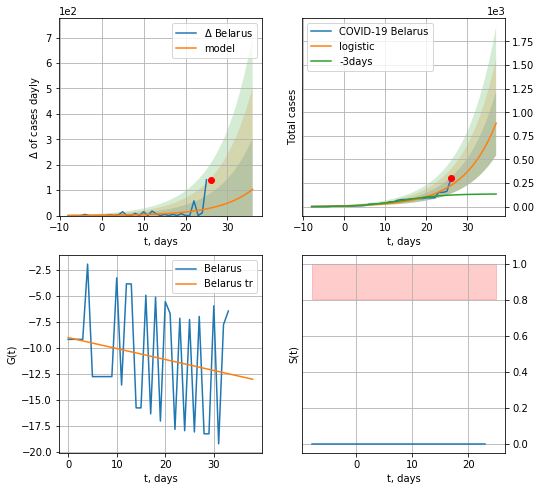

Belarus data at: 2020-10-13
+3 day model MAPE: 1.0426305188408567
model: logistic
coeffs:  [1.42197385e+06 1.24002039e-01 9.65328876e+01]
rational stdev:  0.3845289039536378
forecast at the end of period: +11 days
	 deltaDaycases:  103
	 total cases:  884 ± 340
	 total death:  9 ± 10
trend coefficient of determination: 0.039182
 intercept: -9.040329
 slope: -0.105417


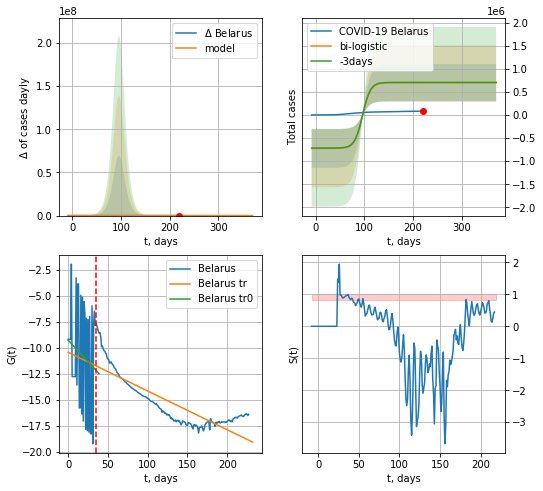

Belarus data at: 2020-10-13
+3 day model MAPE: 0.01153855976486595
model: bi-logistic
coeffs:  [-7.25386405e+05  1.22975929e+01 -2.76623060e+02] [1.42197385e+06 1.24002039e-01 9.65328876e+01]
rational stdev:  0.5782672306056637
forecast at the end of period: +151 days
	 deltaDaycases:  0
	 total cases:  696587 ± 402813
	 total death:  7466 ± 12952
bi-logistic approximation splitting point: 35
trend0 coefficient of determination: 0.026128
 intercept: -9.289300
 slope: -0.082783
trend coefficient of determination: 0.712764
 intercept: -10.454717
 slope: -0.037237


In [641]:
dfBR = read_df(pd.DataFrame(),"BR")
x = forecast('Belarus',dfBR[:35],d1,7*T18-dT)
xx = forecast2('Belarus',dfBR[:],d1,50*7-dT,x,addpred=False,xcoef=[0.25,1.,1.8],vL=35)

BR
           date    cases  active  death
224 2020-10-09  82471.0    5043  885.0
225 2020-10-10  83023.0    5149  891.0
226 2020-10-11  83534.0    5418  896.0
227 2020-10-12  83998.0    5674  901.0
228 2020-10-13  84524.0    5821  906.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: invalid value encountered in true_divide


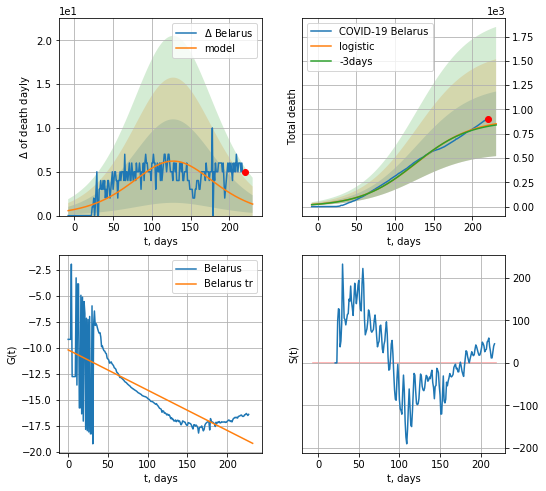

Belarus data at: 2020-10-13
+3 day model MAPE: 0.01273347140458435
model: logistic
coeffs:  [9.02254489e+02 2.75665558e-02 1.27924446e+02]
rational stdev:  0.3899510676290718
forecast at the end of period: +11 days
	 total death:  852 ± 332
trend coefficient of determination: 0.541237
 intercept: -10.224183
 slope: -0.038739


In [642]:
dfBR = read_df(pd.DataFrame(),"BR")
x = forecast('Belarus',dfBR[:],d1,T18*7-dT,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


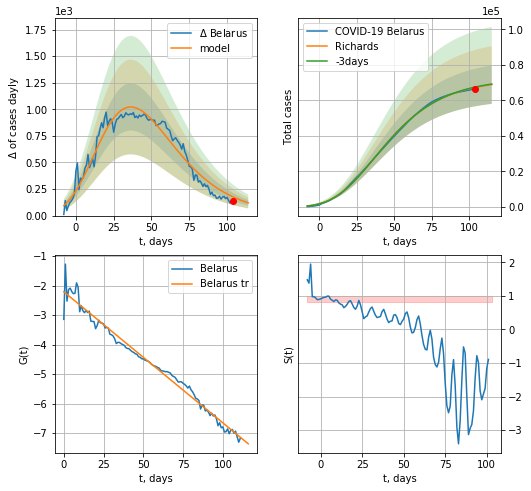

Belarus data at: 2020-10-13
+3 day model MAPE: 0.003761
model: Richards
coeffs: [ 7.18037592e+04  4.57951913e-01 -2.34141452e+01  8.81440501e-02]
rational stdev: 0.157351
forecast at the end of period: +11 days
	 deltaDaycases: 119
	 total cases: 68821 ± 10829
	 total death: 737 ± 347
trend coefficient of determination: 0.978684
 intercept: -2.208926
 slope: -0.044428


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


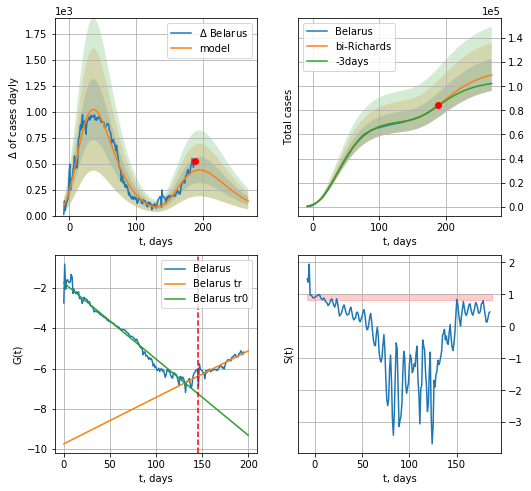

Belarus data at: 2020-10-13
+3 day model MAPE: 0.005721
model: bi-Richards
coeffs: [4.30339008e+04 2.93442380e+00 2.69307936e+01 9.41082550e-03]
rational stdev: 0.121231
forecast at the end of period: +81 days
	 deltaDaycases: 139
	 total cases: 109483 ± 13272
	 total death: 1173 ± 426
bi-Richards approximation splitting point: 145
trend coefficient of determination: 0.967313
 intercept: -1.751564
 slope: -0.037787
trend coefficient of determination: 0.805626
 intercept: -9.732068
 slope: 0.023041


In [643]:
iL=32
vL = 145+iL
x = forecastRR('Belarus',dfBR[iL:vL-iL],d1,30*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Belarus',dfBR[iL:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)
#x = forecastRRR('Belarus',dfBR[iL:],d1,30*7-dT,addpred=False,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


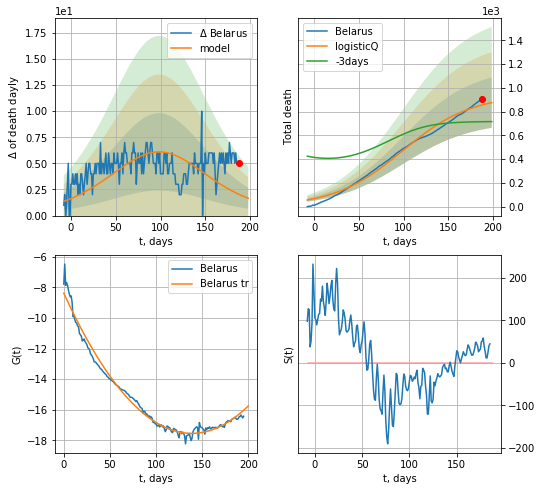

Belarus data at: 2020-10-13
+3 day model MAPE: 0.199303
model: logisticQ
coeffs: [ 9.16644807e+02  3.96005576e-06  9.75381401e+01 -6.56238063e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.242330
forecast at the end of period: +11 days
	 total death: 875 ± 212
trend coefficient of determination: 0.982612
 intercept_: -8.383614798655875
 coeffs_: [ 0.         -0.13210844  0.00047634]


In [644]:
x = forecastRRR('Belarus',dfBR[32:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

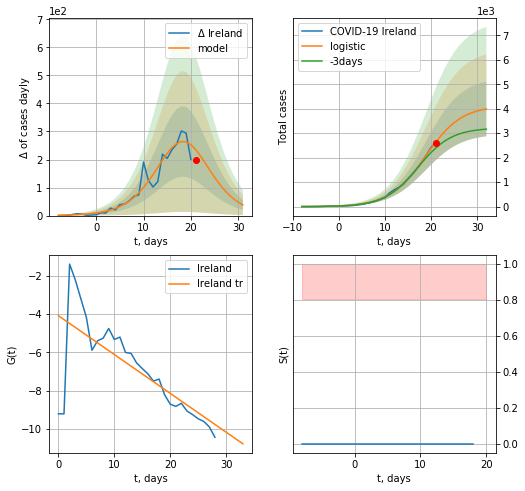

Ireland data at: 2020-10-13
+3 day model MAPE: 0.12282208937722881
model: logistic
coeffs:  [4.12730398e+03 2.56984382e-01 1.88154165e+01]
rational stdev:  0.27980533262906077
forecast at the end of period: +11 days
	 deltaDaycases:  37
	 total cases:  3992 ± 1117
	 total death:  165 ± 138
trend coefficient of determination: 0.521820
 intercept: -4.083344
 slope: -0.202899


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


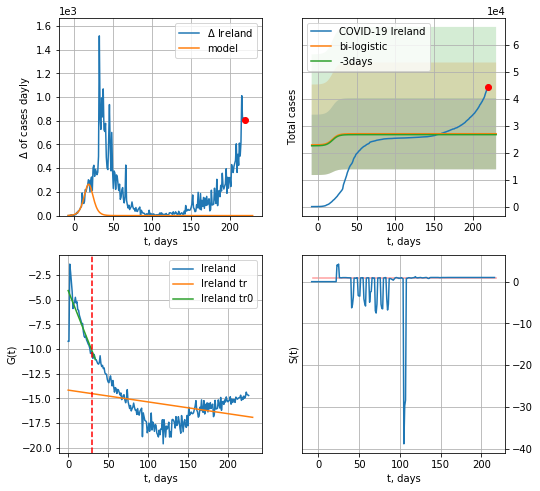

Ireland data at: 2020-10-13
+3 day model MAPE: 0.013078546500374134
model: bi-logistic
coeffs:  [ 1.83016186e+04 -1.36313680e+01  3.38018836e+02] [4.12730398e+03 2.56984382e-01 1.88154165e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.4884807340236483
forecast at the end of period: +11 days
	 deltaDaycases:  0
	 total cases:  27004 ± 13191
	 total death:  1119 ± 1639
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.551550
 intercept: -4.065434
 slope: -0.204818
trend coefficient of determination: 0.120514
 intercept: -14.153484
 slope: -0.011934


In [645]:
vL=30
x = forecast('Ireland',dfIR[:vL],d1,T18*7-dT)
xx = forecast2('Ireland',dfIR[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


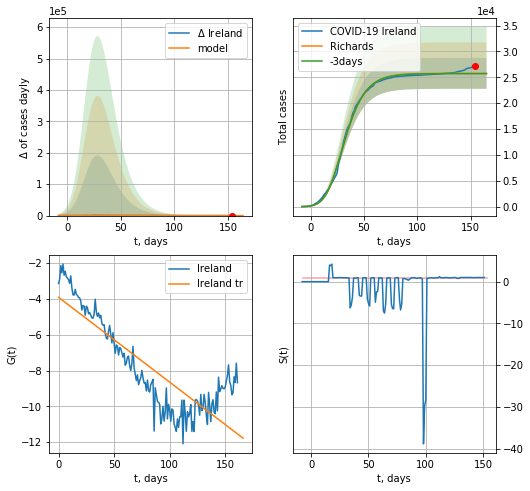

Ireland data at: 2020-10-13
+3 day model MAPE: 0.002433
model: Richards
coeffs: [2.57657943e+04 3.18771220e-01 1.26344801e+01 2.60248569e-01]
rational stdev: 0.115969
forecast at the end of period: +11 days
	 deltaDaycases: 0
	 total cases: 25765 ± 2987
	 total death: 1067 ± 371
trend coefficient of determination: 0.719937
 intercept: -3.912376
 slope: -0.047358


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


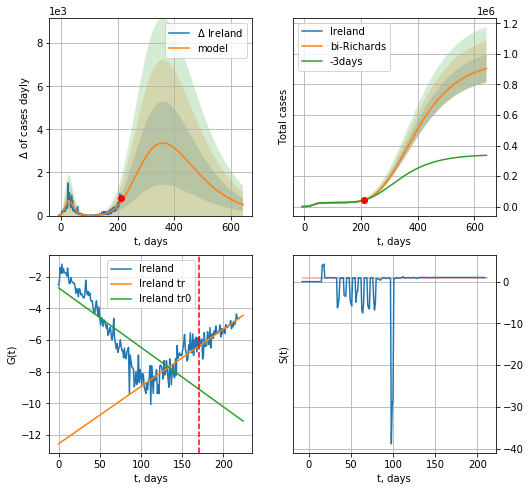

Ireland data at: 2020-10-13
+3 day model MAPE: 0.019797
model: bi-Richards
coeffs: [9.30223031e+05 1.66959644e-01 8.36590437e+01 6.06621990e-02]
rational stdev: 0.100434
forecast at the end of period: +431 days
	 deltaDaycases: 508
	 total cases: 904432 ± 90836
	 total death: 37480 ± 11292
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.633467
 intercept: -2.706166
 slope: -0.037528
trend coefficient of determination: 0.713425
 intercept: -12.550301
 slope: 0.036163


In [646]:
ivL = 7
vL = 170 +ivL
x = forecastRR('Ireland',dfIR[ivL:vL-ivL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Ireland',dfIR[ivL:],d1,90*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-ivL)
#x = forecastRRR('Ireland',dfIR[3:],d1,66*7-dT,addpred=True,xcoef=koreaCoeffs)

CL
           date   cases  active    death
220 2020-10-09  477769   14252  13220.0
221 2020-10-10  479595   14269  13272.0
222 2020-10-11  481371   14701  13318.0
223 2020-10-12  482888   15025  13379.0
224 2020-10-13  484280   14385  13396.0


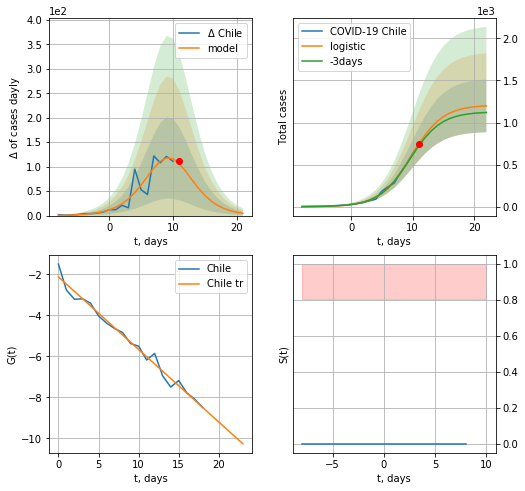

Chile data at: 2020-10-13
+3 day model MAPE: 0.03908993891192624
model: logistic
coeffs:  [1.20759839e+03 3.93191843e-01 9.80781865e+00]
rational stdev:  0.2610672451056305
forecast at the end of period: +11 days
	 deltaDaycases:  4
	 total cases:  1197 ± 312
	 total death:  33 ± 25
trend coefficient of determination: 0.982168
 intercept: -2.127319
 slope: -0.354074


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


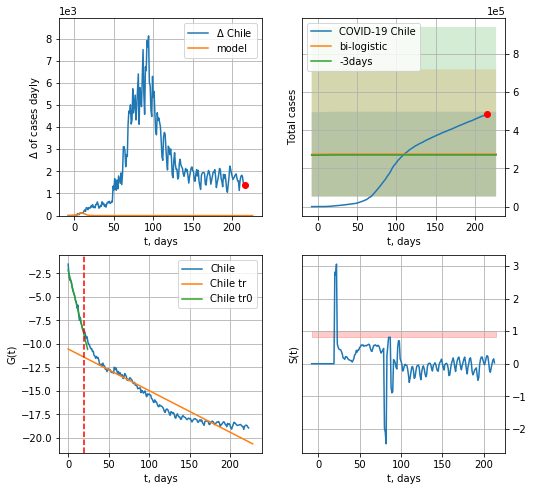

Chile data at: 2020-10-13
+3 day model MAPE: 0.016403989712661812
model: bi-logistic
coeffs:  [ 2.18969187e+05 -4.32472101e+01  1.03415970e+03] [1.20759839e+03 3.93191843e-01 9.80781865e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.8077877878666629
forecast at the end of period: +11 days
	 deltaDaycases:  0
	 total cases:  274919 ± 222076
	 total death:  7604 ± 18427
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.984051
 intercept: -2.144368
 slope: -0.351232
trend coefficient of determination: 0.899399
 intercept: -10.543902
 slope: -0.044265


In [647]:
vL=20
dfCL = read_df(pd.DataFrame(),"CL")
x = forecast('Chile',dfCL[:vL],d1,7*T18-dT)
xx = forecast2('Chile',dfCL[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


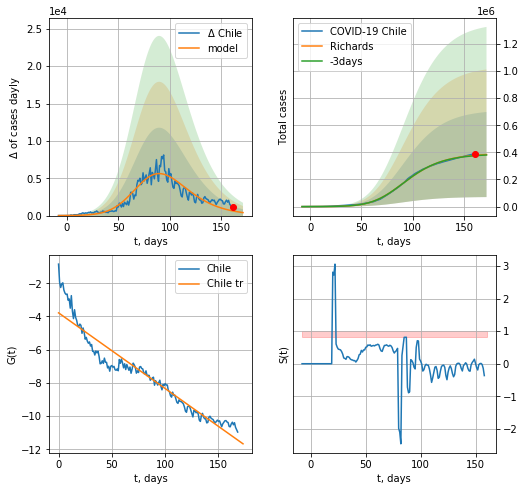

Chile data at: 2020-10-13
+3 day model MAPE: 0.007583
model: Richards
coeffs: [3.92652491e+05 1.16049666e-01 7.04582771e+01 4.00939983e-01]
rational stdev: 0.816952
forecast at the end of period: +11 days
	 deltaDaycases: 401
	 total cases: 384094 ± 313787
	 total death: 10624 ± 26037
trend coefficient of determination: 0.916357
 intercept: -3.781163
 slope: -0.045598


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: RuntimeWarning: overflow encountered in power


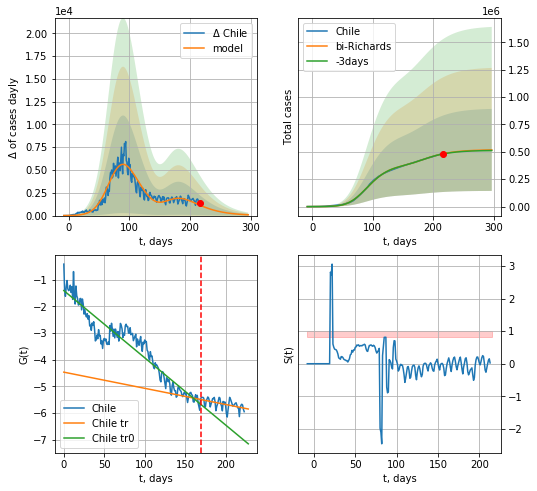

Chile data at: 2020-10-13
+3 day model MAPE: 0.003087
model: bi-Richards
coeffs: [1.27115413e+05 4.95933995e+00 4.92274130e+01 7.24565878e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.723256
forecast at the end of period: +81 days
	 deltaDaycases: 86
	 total cases: 517379 ± 374198
	 total death: 14311 ± 31051
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.912199
 intercept: -1.405397
 slope: -0.025196
trend coefficient of determination: 0.260782
 intercept: -4.463227
 slope: -0.006059


In [648]:
vL = 170
x = forecastRR('Chile',dfCL[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Chile',dfCL[:],d1,40*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastRRR('Chile',dfCL[:],d1,24*7-dT,addpred=False,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


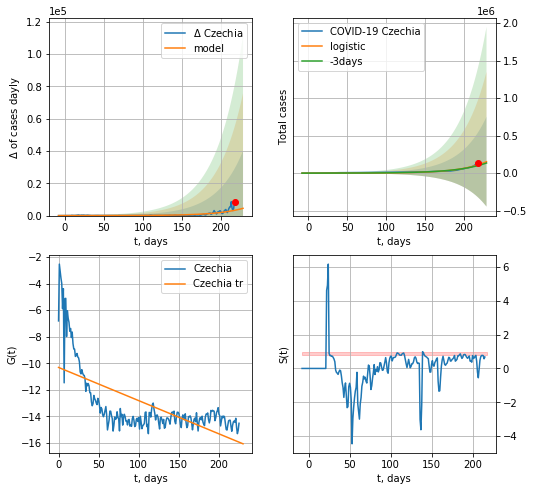

Czechia data at: 2020-10-13
+3 day model MAPE: 0.09654718680997515
model: logistic
coeffs:  [8.10590073e+08 2.98206789e-02 5.16514490e+02]
rational stdev:  3.9105277027082006
forecast at the end of period: +11 days
	 deltaDaycases:  4498
	 total cases:  153155 ± 598917
	 total death:  1305 ± 15309
trend coefficient of determination: 0.432478
 intercept: -10.312769
 slope: -0.025016


In [649]:
x = forecast('Czechia',dfCH[:],d1,T18*7-dT,shift=1.,addpred=False,xcoef=[0.25,1.,2.4])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


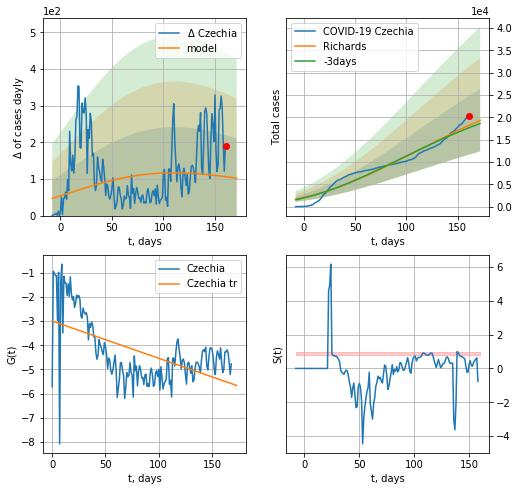

Czechia data at: 2020-10-13
+3 day model MAPE: 0.031157
model: Richards
coeffs: [ 3.38081424e+04  9.01119025e-01 -3.72638095e+02  1.04670007e-02]
rational stdev: 0.360620
forecast at the end of period: +11 days
	 deltaDaycases: 101
	 total cases: 19318 ± 6966
	 total death: 164 ± 177
trend coefficient of determination: 0.316668
 intercept: -3.000409
 slope: -0.015392


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


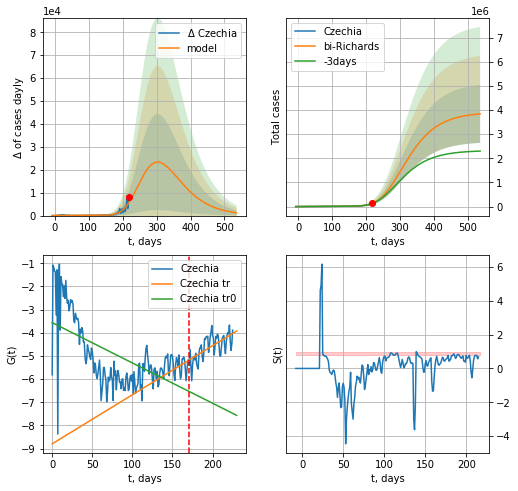

Czechia data at: 2020-10-13
+3 day model MAPE: 0.021772
model: bi-Richards
coeffs: [3.87595665e+06 1.76964818e-01 1.67474705e+02 9.68856557e-02]
rational stdev: 0.312669
forecast at the end of period: +319 days
	 deltaDaycases: 1207
	 total cases: 3838979 ± 1200329
	 total death: 32724 ± 30695
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.356972
 intercept: -3.563107
 slope: -0.017392
trend coefficient of determination: 0.425120
 intercept: -8.792667
 slope: 0.021174


In [650]:
vL= 170
x = forecastRR('Czechia',dfCH[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Czechia',dfCH[:],d1,74*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastRRR('Czechia',dfCH[:],d1,60*7-dT,addpred=True,xcoef=koreaCoeffs)

In [651]:
dfMX = read_df(pd.DataFrame(),"MX")
#x = forecast('Mexico',dfMX[:],d1,T18*7-dT,addpred=True,xcoef=[.25,1.,2.])#

MX
           date   cases    active    death
215 2020-10-09  809751  138159.0  83507.0
216 2020-10-10  814328  139536.0  83642.0
217 2020-10-11  817503  139542.0  83781.0
218 2020-10-12  821045  139109.0  83945.0
219 2020-10-13  825340  139349.0  84420.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


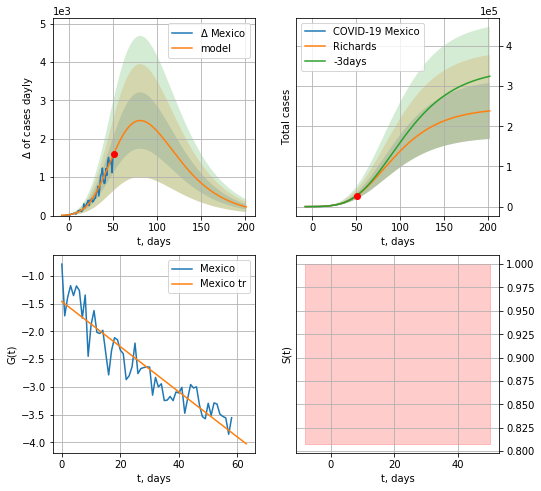

Mexico data at: 2020-10-13
+3 day model MAPE: 0.013781
model: Richards
coeffs: [ 2.46197399e+05  4.05650878e-01 -1.28761086e+01  6.97244909e-02]
rational stdev: 0.292607
forecast at the end of period: +151 days
	 deltaDaycases: 224
	 total cases: 238238 ± 69710
	 total death: 24368 ± 21390
trend coefficient of determination: 0.864363
 intercept: -1.463809
 slope: -0.040682


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


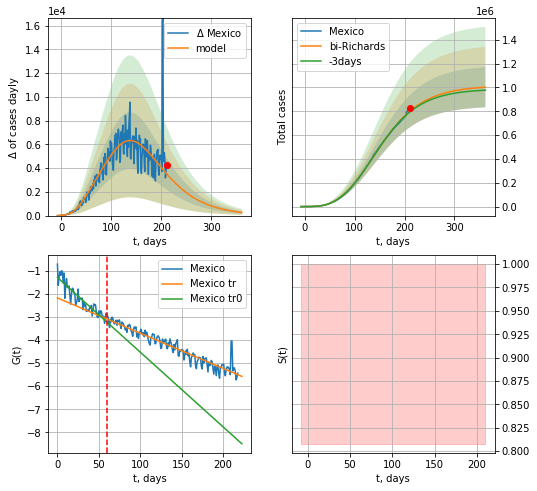

Mexico data at: 2020-10-13
+3 day model MAPE: 0.007859
model: bi-Richards
coeffs: [ 7.69952377e+05  1.45982012e+00 -7.90183042e+01  1.29900998e-02]
rational stdev: 0.168311
forecast at the end of period: +151 days
	 deltaDaycases: 262
	 total cases: 1002358 ± 168707
	 total death: 102526 ± 51768
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.824003
 intercept: -1.288229
 slope: -0.032322
trend coefficient of determination: 0.896730
 intercept: -2.176195
 slope: -0.015244


In [652]:
vL = 60
x = forecastRR('Mexico',dfMX[:vL],d1,50*7-dT,addpred=False,xcoef=RkoreaCoeffs)#
xx = forecast2RR('Mexico',dfMX[:],d12f(1),50*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastRRR('Mexico',dfMX[10:],d1,66*7-dT,addpred=False,xcoef=koreaCoeffs)#

LT
           date   cases  active  death     tests
214 2020-10-09  5963.0    3109  103.0  838501.0
215 2020-10-10  6122.0    3220  103.0  842423.0
216 2020-10-11  6248.0    3352  103.0  844742.0
217 2020-10-12  6366.0    3418  106.0  852008.0
218 2020-10-13  6505.0    3493  109.0  860147.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


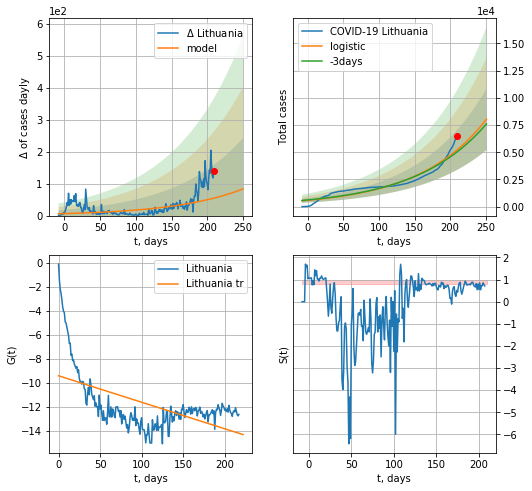

Lithuania data at: 2020-10-13
+3 day model MAPE: 0.037735086938526494
model: logistic
coeffs:  [1.71935725e+07 1.04709153e-02 9.83314264e+02]
rational stdev:  0.35201065578251245
forecast at the end of period: +41 days
	 deltaDaycases:  83
	 total cases:  8035 ± 2828
	 total death:  133 ± 140
trend coefficient of determination: 0.306537
 intercept: -9.405145
 slope: -0.022064


In [654]:
vL = 1
dfLT = read_df(pd.DataFrame(),"LT")
try:
    x = forecast('Lithuania',dfLT[:],d1,6*7-1)
except:
    print("Exception occurs")
#xx = forecast2('Lithuania',dfLT[:],d1,8*7-1,x,shift=1.0,addpred=True,xcoef=[.25,1.,2.],vL=vL)

In [655]:
#dfLT = read_df(pd.DataFrame(),"LT")
#plt.plot(range(len(dfLT[3:])),dfLT[3:].cases/dfLT[3:].tests)

#plt.grid()#

In [656]:
#np.diff(dfLT["cases"])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: invalid value encountered in true_divide


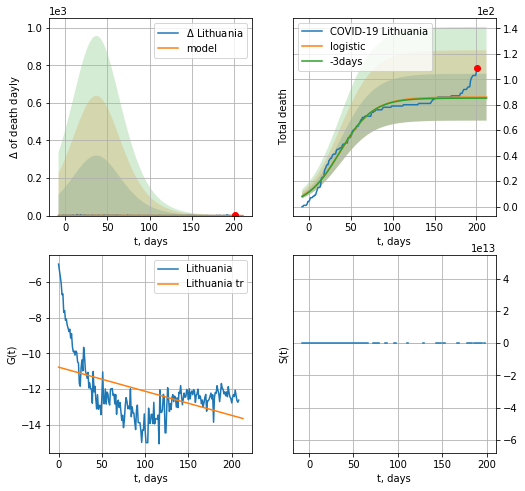

Lithuania data at: 2020-10-13
+3 day model MAPE: 0.009071115329201011
model: logistic
coeffs:  [8.59593751e+01 4.95295662e-02 3.73960324e+01]
rational stdev:  0.2139497987853072
forecast at the end of period: +11 days
	 total death:  85 ± 18
trend coefficient of determination: 0.228296
 intercept: -10.776465
 slope: -0.013518


In [657]:
x = forecast('Lithuania',dfLT[9:],d1,7*T18-dT,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


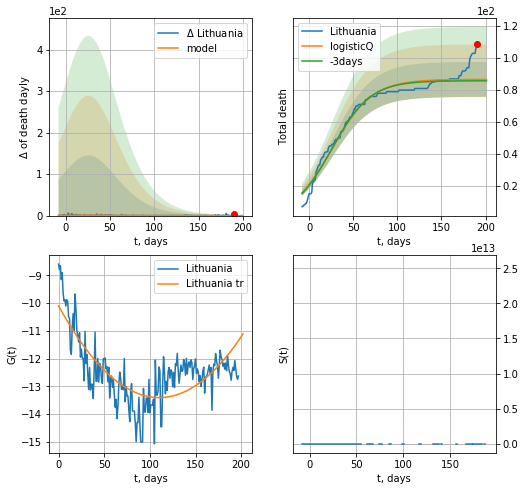

Lithuania data at: 2020-10-13
+3 day model MAPE: 0.009962
model: logisticQ
coeffs: [ 8.67171771e+01  4.84402854e-08  2.61142312e+01 -9.13899966e+05]
rational stdev: 0.126479
forecast at the end of period: +11 days
	 total death: 86 ± 10
trend coefficient of determination: 0.572501
 intercept_: -10.09658780590782
 coeffs_: [ 0.         -0.0600537   0.00027247]


In [658]:
#x = forecast('Lithuania',dfLT[10-4:],d1,6*7-1,cases='active')
#x = forecastRRR('Lithuania',dfLT[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)
x = forecastRRR('Lithuania',dfLT[20:],d1,T18*7-dT,addpred=False,xcoef=koreaCoeffs,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


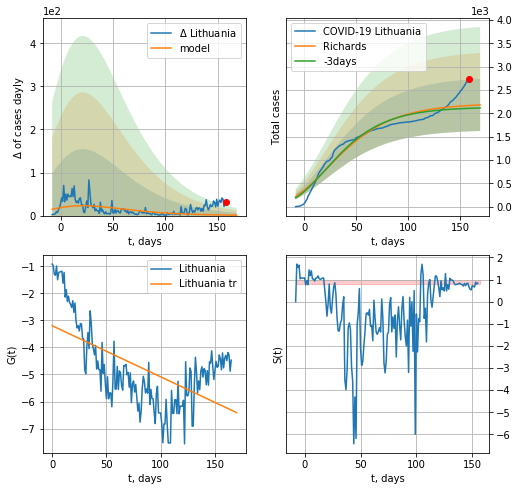

Lithuania data at: 2020-10-13
+3 day model MAPE: 0.028743
model: Richards
coeffs: [ 2.21447060e+03  8.09091427e+00 -1.77897609e+02  3.50116162e-03]
rational stdev: 0.255572
forecast at the end of period: +11 days
	 deltaDaycases: 0
	 total cases: 2180 ± 557
	 total death: 36 ± 27
trend coefficient of determination: 0.347472
 intercept: -3.198530
 slope: -0.018898


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


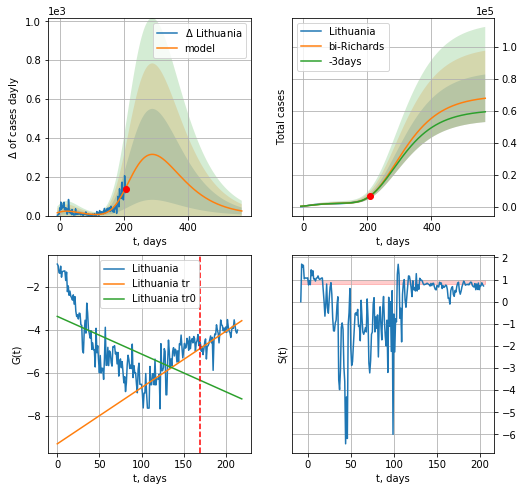

Lithuania data at: 2020-10-13
+3 day model MAPE: 0.007999
model: bi-Richards
coeffs: [ 6.76076156e+04  6.41187480e-01 -1.71647988e+01  1.99630841e-02]
rational stdev: 0.219547
forecast at the end of period: +361 days
	 deltaDaycases: 23
	 total cases: 67957 ± 14919
	 total death: 1131 ± 744
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.315316
 intercept: -3.383429
 slope: -0.017539
trend coefficient of determination: 0.485260
 intercept: -9.316417
 slope: 0.026180


In [659]:
iL = 3
vL =170+iL
x = forecastRR('Lithuania',dfLT[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)#
xx = forecast2RR('Lithuania',dfLT[iL:],d1,80*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)#
#xx = forecast2R('Lithuania',dfLT[:],d1,2*7-1,x,shift=1.0,addpred=True,xcoef=[0.25,1.,1.5])

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:75: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:75: RuntimeWarning: invalid value encountered in true_divide


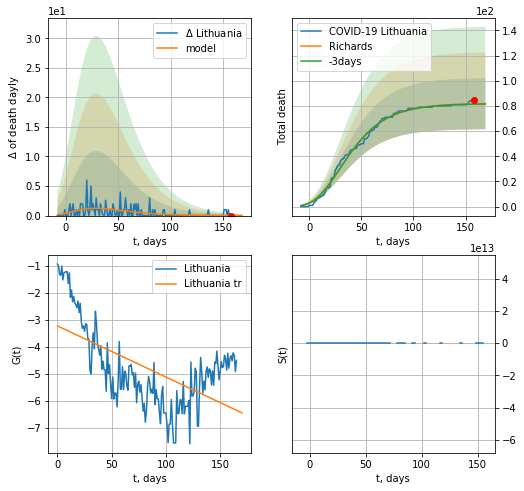

Lithuania data at: 2020-10-13
+3 day model MAPE: 0.002731
model: Richards
coeffs: [ 8.20018119e+01  5.93207109e+00 -9.07405318e+01  6.96219241e-03]
rational stdev: 0.248697
forecast at the end of period: +11 days
	 total death: 81 ± 20
trend coefficient of determination: 0.348164
 intercept: -3.218562
 slope: -0.018952


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:209: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:209: RuntimeWarning: invalid value encountered in true_divide


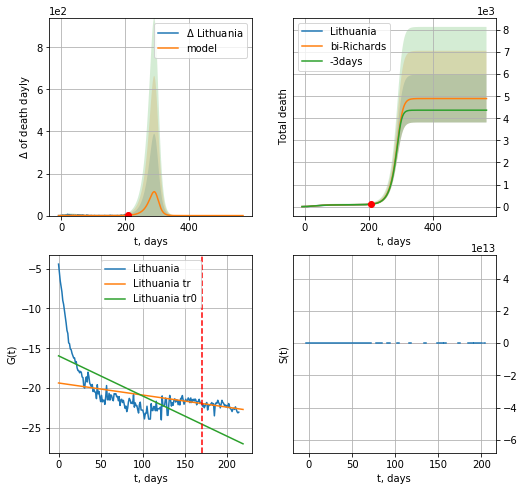

Lithuania data at: 2020-10-13
+3 day model MAPE: 0.002663
model: bi-Richards
coeffs: [4.81427627e+03 5.84898987e-02 2.96680102e+02 2.18274646e+00]
rational stdev: 0.221043
forecast at the end of period: +361 days
	 total death: 4896 ± 1082
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.460183
 intercept: -15.945028
 slope: -0.050437
trend coefficient of determination: 0.216335
 intercept: -19.353850
 slope: -0.015162


In [660]:
iL = 3
vL =170+iL
x = forecastRR('Lithuania',dfLT[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs,cases='death')#
xx = forecast2RR('Lithuania',dfLT[iL:],d1,80*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL,cases='death')#

In [661]:
#x = forecastQR('Lithuania',dfLT[:],d1,16*7-dT,addpred=False,xcoef=[0.35,.52,4.,1.,1.])

LX
           date   cases  active  death
216 2020-10-09  9360.0    1192  130.0
217 2020-10-10  9514.0    1345  131.0
218 2020-10-11  9722.0    1552  132.0
219 2020-10-12  9731.0    1364  133.0
220 2020-10-13  9840.0    1459  133.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


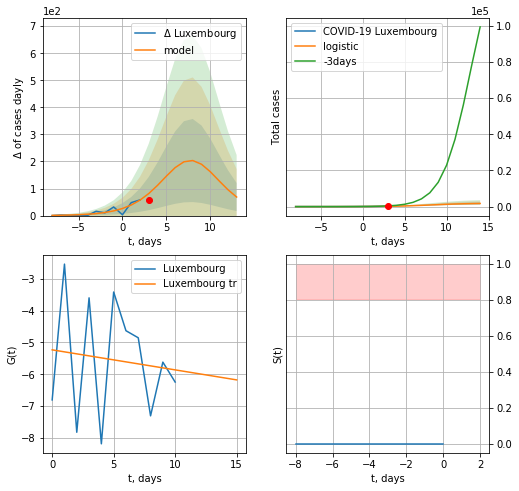

Luxembourg data at: 2020-10-13
model: logistic
coeffs:  [1.87757966e+03 4.36654344e-01 8.24919508e+00]
rational stdev:  0.35795936969501296
forecast at the end of period: +11 days
	 deltaDaycases:  68
	 total cases:  1736 ± 621
	 total death:  23 ± 24
trend coefficient of determination: 0.012091
 intercept: -5.231862
 slope: -0.063083


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


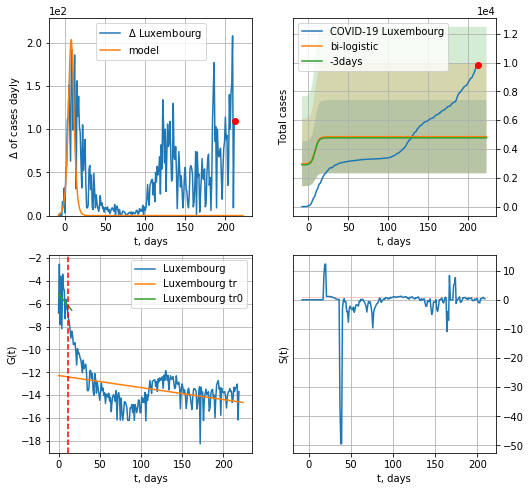

Luxembourg data at: 2020-10-13
+3 day model MAPE: 0.01699422113995046
model: bi-logistic
coeffs:  [2646.5394329   -15.25726694  394.08890729] [1.87757966e+03 4.36654344e-01 8.24919508e+00]
scenario coeffs:  [0.125, 1.0, 2.0]
rational stdev:  0.5229170132999478
forecast at the end of period: +11 days
	 deltaDaycases:  0
	 total cases:  4854 ± 2538
	 total death:  65 ± 101
bi-logistic approximation splitting point: 12
trend0 coefficient of determination: 0.030158
 intercept: -5.146907
 slope: -0.088569
trend coefficient of determination: 0.149762
 intercept: -12.279759
 slope: -0.010518


In [662]:
try:
    dfLX = read_df(pd.DataFrame(),"LX")
    x = forecast("Luxembourg",dfLX[:12],d1,T18*7-dT,pMAPE=False)
    xx = forecast2("Luxembourg",dfLX[:],d1,T18*7-dT,x,vL=12,addpred=True,xcoef=[0.25/2,1.,2.])
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


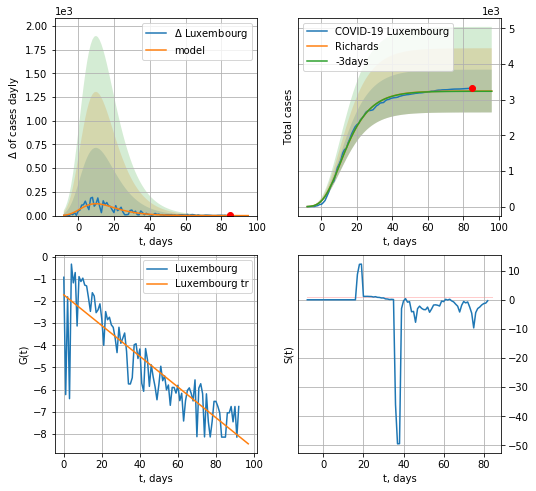

Luxembourg data at: 2020-10-13
+3 day model MAPE: 0.002007
model: Richards
coeffs: [ 3.24138545e+03  2.02715004e+01 -3.96622957e+01  5.18542030e-03]
rational stdev: 0.184858
forecast at the end of period: +11 days
	 deltaDaycases: 0
	 total cases: 3240 ± 599
	 total death: 43 ± 23
trend coefficient of determination: 0.764532
 intercept: -1.723997
 slope: -0.069294


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


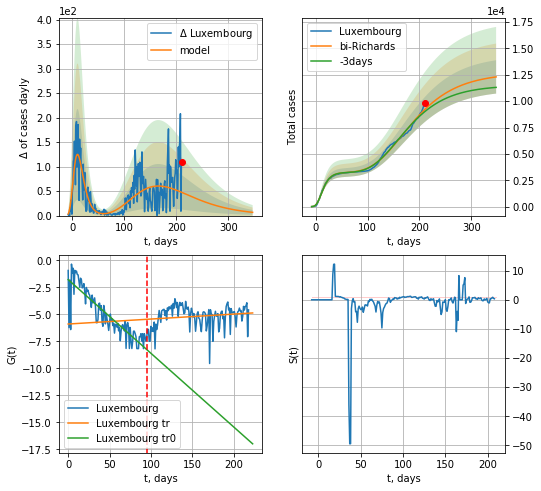

Luxembourg data at: 2020-10-13
+3 day model MAPE: 0.022921
model: bi-Richards
coeffs: [ 9.44029210e+03  1.89194961e+00 -1.02186383e+02  9.23449310e-03]
rational stdev: 0.128470
forecast at the end of period: +137 days
	 deltaDaycases: 6
	 total cases: 12297 ± 1579
	 total death: 166 ± 63
bi-Richards approximation splitting point: 95
trend coefficient of determination: 0.767495
 intercept: -1.784273
 slope: -0.068218
trend coefficient of determination: 0.026600
 intercept: -5.898044
 slope: 0.004596


In [663]:
iL=1
vL = 105+iL-10
x = forecastRR("Luxembourg",dfLX[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Luxembourg",dfLX[iL:],d1,48*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


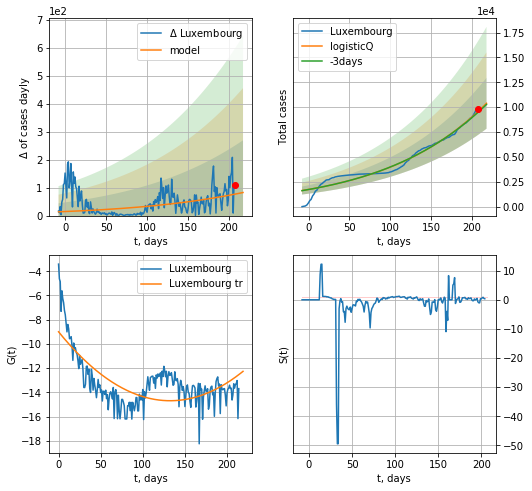

Luxembourg data at: 2020-10-13
+3 day model MAPE: 0.009070
model: logisticQ
coeffs: [ 1.22348607e+05  6.02819086e-07  4.86361304e+02 -1.44744658e+04]
rational stdev: 0.246093
forecast at the end of period: +11 days
	 deltaDaycases: 82
	 total cases: 10394 ± 2557
	 total death: 140 ± 103
trend coefficient of determination: 0.497904
 intercept_: -8.99979216767176
 coeffs_: [ 0.         -0.08597287  0.00032442]


In [664]:
x = forecastRRR("Luxembourg",dfLX[5:],d1,T18*7-dT,addpred=False,xcoef=koreaCoeffs)

In [665]:
dfED = read_df(pd.DataFrame(),"ED")
#x = forecast("Ecuador",dfED[11:],d1,24*7-dT)
#xx = forecast2(c,adf[:],d1,4*7-dT,x)

ED
           date     cases   active    death
223 2020-10-09  145848.0  13162.0  12175.0
224 2020-10-10  146828.0  14129.0  12188.0
225 2020-10-11  147033.0   6708.0  12191.0
226 2020-10-12  147315.0   6963.0  12218.0
227 2020-10-13  148171.0   7802.0  12235.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


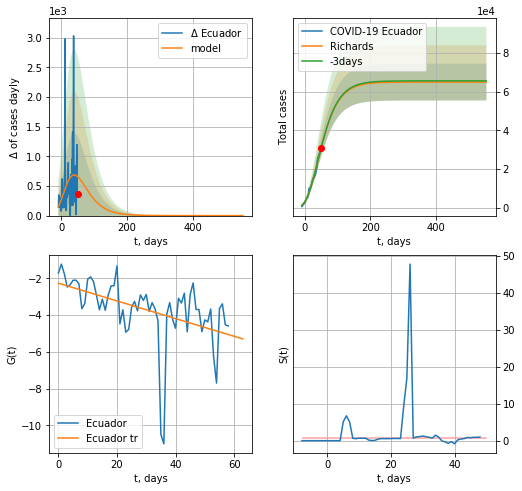

Ecuador data at: 2020-10-13
+3 day model MAPE: 0.001443
model: Richards
coeffs: [ 6.49031363e+04  1.85787235e+00 -1.03613231e+02  1.55703468e-02]
rational stdev: 0.146273
forecast at the end of period: +501 days
	 deltaDaycases: 0
	 total cases: 64903 ± 9493
	 total death: 5359 ± 2351
trend coefficient of determination: 0.218364
 intercept: -2.268609
 slope: -0.048096


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


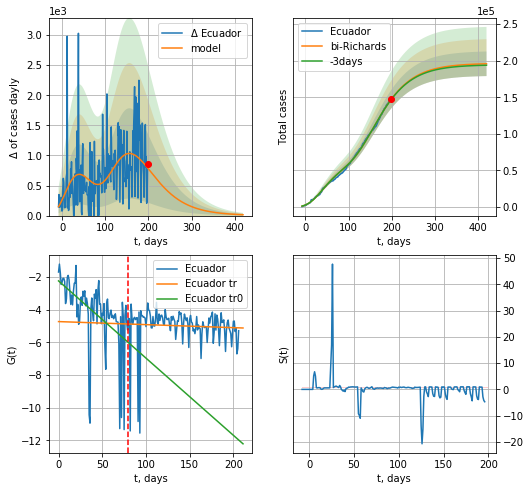

Ecuador data at: 2020-10-13
+3 day model MAPE: 0.002489
model: bi-Richards
coeffs: [ 1.31552640e+05  1.86582973e+00 -6.28722930e+01  1.08442675e-02]
rational stdev: 0.085803
forecast at the end of period: +221 days
	 deltaDaycases: 14
	 total cases: 195763 ± 16797
	 total death: 16164 ± 4160
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.274068
 intercept: -2.227765
 slope: -0.047358
trend coefficient of determination: 0.003503
 intercept: -4.723310
 slope: -0.001860


In [666]:
vL = 80+20
x = forecastRR("Ecuador",dfED[20:vL-20],d1,100*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Ecuador",dfED[20:],d1,60*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-20)

In [667]:
#x = forecastRRR("Ecuador",dfED[:],d1,40*7-dT,addpred=True,xcoef=koreaCoeffs)

FI
           date    cases  active  death
227 2020-10-09  11849.0    3003  346.0
228 2020-10-10  11998.0    3152  346.0
229 2020-10-11  12104.0    3152  346.0
230 2020-10-12  12212.0    3366  346.0
231 2020-10-13  12499.0    3653  346.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


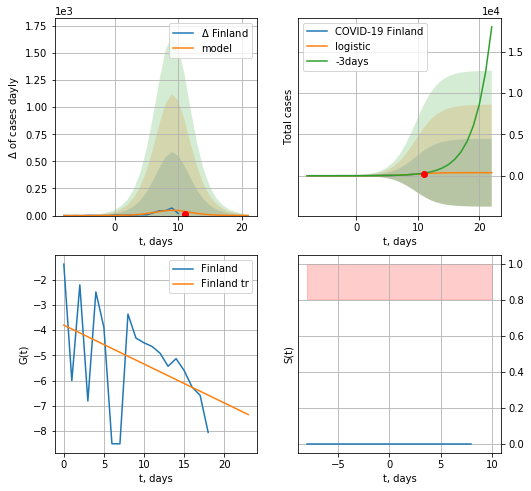

Finland data at: 2020-10-13
+3 day model MAPE: 0.3536795630191518
model: logistic
coeffs:  [373.20900186   0.53490302   9.59276199]
rational stdev:  11.028448708024662
forecast at the end of period: +11 days
	 deltaDaycases:  0
	 total cases:  372 ± 4110
	 total death:  10 ± 330
trend coefficient of determination: 0.182614
 intercept: -3.802910
 slope: -0.153962


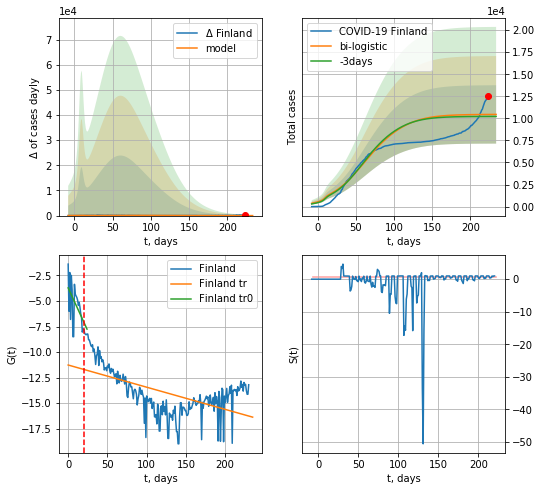

Finland data at: 2020-10-13
+3 day model MAPE: 0.022207648389085004
model: bi-logistic
coeffs:  [8.06363969e+03 4.67433067e-02 5.72866427e+01] [373.20900186   0.53490302   9.59276199]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.31638530961729966
forecast at the end of period: +11 days
	 deltaDaycases:  0
	 total cases:  10446 ± 3305
	 total death:  289 ± 274
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.234981
 intercept: -3.717136
 slope: -0.168257
trend coefficient of determination: 0.331400
 intercept: -11.273435
 slope: -0.021731


In [668]:
try:
    dfFI = read_df(pd.DataFrame(),"FI")
    vL=20
    x = forecast("Finland",dfFI[:vL],d1,7*T18-dT)
    xx = forecast2("Finland",dfFI[:],d1,T18*7-dT,x,vL=vL,addpred=True,xcoef=[0.25,1.,1.8])
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


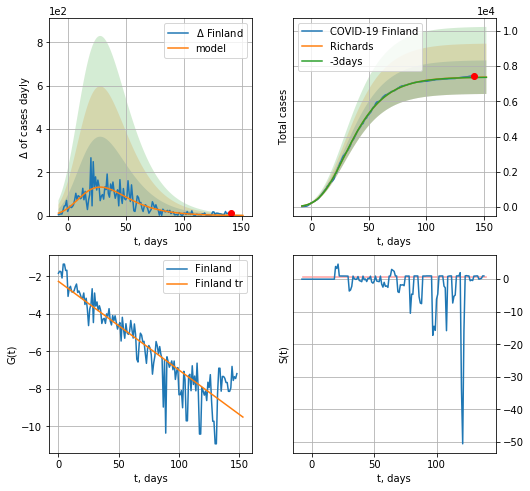

Finland data at: 2020-10-13
+3 day model MAPE: 0.001103
model: Richards
coeffs: [ 7.38854164e+03  5.39963308e-01 -1.81801816e+01  9.38814747e-02]
rational stdev: 0.129256
forecast at the end of period: +11 days
	 deltaDaycases: 0
	 total cases: 7374 ± 953
	 total death: 204 ± 79
trend coefficient of determination: 0.823115
 intercept: -2.267352
 slope: -0.047318


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


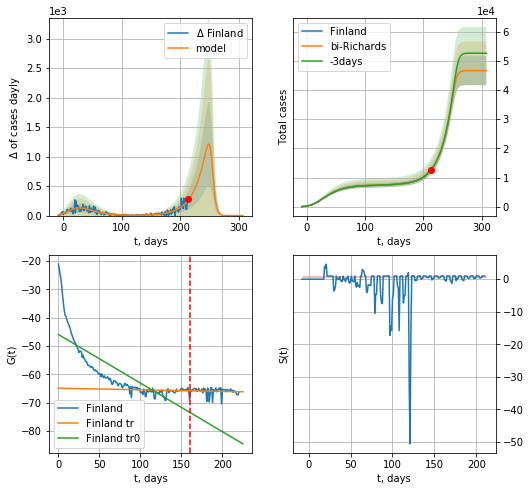

Finland data at: 2020-10-13
+3 day model MAPE: 0.002248
model: bi-Richards
coeffs: [3.92827842e+04 4.82994999e-02 2.55063625e+02 6.64350193e+00]
rational stdev: 0.107055
forecast at the end of period: +95 days
	 deltaDaycases: 0
	 total cases: 46671 ± 4996
	 total death: 1291 ± 414
bi-Richards approximation splitting point: 160
trend coefficient of determination: 0.641553
 intercept: -45.939121
 slope: -0.171328
trend coefficient of determination: 0.006001
 intercept: -64.875493
 slope: -0.005621


In [669]:
vL = 170#96 + 10 + 25
x = forecastRR("Finland",dfFI[10:vL-10],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Finland",dfFI[10:],d1,42*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-10)

In [670]:
## x = forecastRRR("Finland",dfFI[:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

BL
           date  cases  active  death
213 2020-10-09  23871  7271.0  887.0
214 2020-10-10  24319  7610.0  891.0
215 2020-10-11  24402  7663.0  892.0
216 2020-10-12  24989  8099.0  915.0
217 2020-10-13  25774  8712.0  923.0


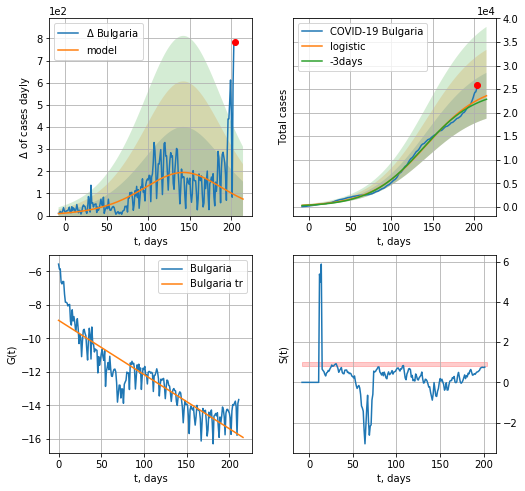

Bulgaria data at: 2020-10-13
+3 day model MAPE: 0.027554192773208232
model: logistic
coeffs:  [2.63759982e+04 2.95296836e-02 1.42695675e+02]
scenario coeffs:  [0.25, 1.0, 3.5]
rational stdev:  0.20658499330213592
forecast at the end of period: +11 days
	 deltaDaycases:  74
	 total cases:  23588 ± 4873
	 total death:  844 ± 523
trend coefficient of determination: 0.802213
 intercept: -8.917124
 slope: -0.032365


In [671]:
dfBL = read_df(pd.DataFrame(),"BL").fillna(0)
try:
    x = forecast('Bulgaria',dfBL[5:],d1,T18*7-dT,shift=1.0,addpred=True,xcoef=[0.25,1.,3.5])
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


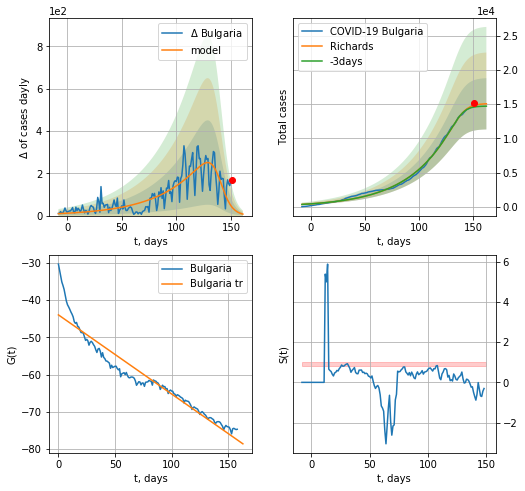

Bulgaria data at: 2020-10-13
+3 day model MAPE: 0.017805
model: Richards
coeffs: [1.50824768e+04 2.52805245e-02 1.39971141e+02 7.29152366e+00]
rational stdev: 0.248593
forecast at the end of period: +11 days
	 deltaDaycases: 7
	 total cases: 15047 ± 3740
	 total death: 538 ± 401
trend coefficient of determination: 0.915098
 intercept: -43.939842
 slope: -0.212540


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


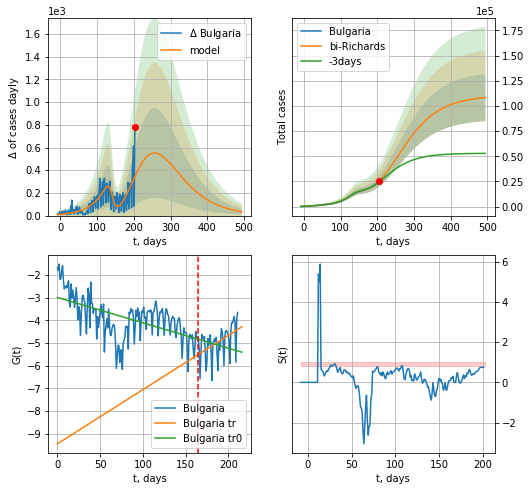

Bulgaria data at: 2020-10-13
+3 day model MAPE: 0.028067
model: bi-Richards
coeffs: [ 9.53674622e+04  9.86708066e-01 -3.88366995e+00  1.60651462e-02]
rational stdev: 0.215798
forecast at the end of period: +291 days
	 deltaDaycases: 34
	 total cases: 108292 ± 23369
	 total death: 3878 ± 2510
bi-Richards approximation splitting point: 165
trend coefficient of determination: 0.334096
 intercept: -2.993524
 slope: -0.011180
trend coefficient of determination: 0.216404
 intercept: -9.452142
 slope: 0.023904


In [672]:
vL = 170#71+5
x = forecastRR('Bulgaria',dfBL[5:vL-5],d1,T18*7-dT,shift=1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Bulgaria',dfBL[5:],d1,70*7-dT,x,shift=1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-5)

In [673]:
#x = forecastRRR('Bulgaria',dfBL[5:],d1,35*7-dT,shift=1.0,addpred=True,xcoef=koreaCoeffs)

TH
           date   cases  active  death
225 2020-10-09  3634.0   130.0   59.0
226 2020-10-10  3636.0   126.0   59.0
227 2020-10-11  3641.0   128.0   59.0
228 2020-10-12  3643.0   127.0   59.0
229 2020-10-13  3652.0   136.0   59.0


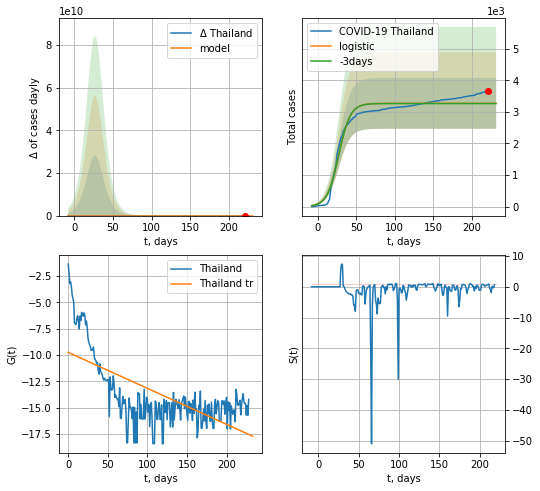

Thailand data at: 2020-10-13
+3 day model MAPE: 0.002219620060811674
model: logistic
coeffs:  [3.27162113e+03 1.32168672e-01 2.72542228e+01]
rational stdev:  0.24637858768357948
forecast at the end of period: +11 days
	 deltaDaycases:  0
	 total cases:  3271 ± 806
	 total death:  52 ± 38
trend coefficient of determination: 0.440081
 intercept: -9.746142
 slope: -0.034129


In [674]:
dfTH = read_df(pd.DataFrame(),"TH")
dfTH = dfTH.fillna(0)
try:
    x = forecast("Thailand",dfTH[:],d1,T18*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])
except:
    print("Exception occurs")
#xx = forecast2("Thailand",dfTH[:],d1,8*7-dT,x,vL=20,addpred=True,xcoef=[0.25,1.,1.8])

In [675]:
#x = forecastRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


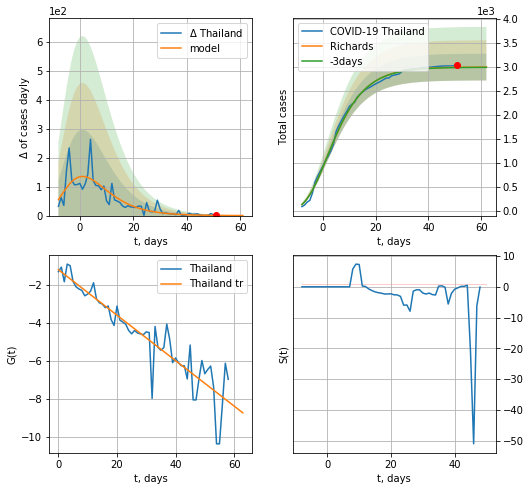

Thailand data at: 2020-10-13
+3 day model MAPE: 0.001958
model: Richards
coeffs: [ 2.99625224e+03  1.57427901e+01 -3.79340304e+01  7.81992540e-03]
rational stdev: 0.093292
forecast at the end of period: +11 days
	 deltaDaycases: 0
	 total cases: 2994 ± 279
	 total death: 48 ± 13
trend coefficient of determination: 0.845848
 intercept: -1.208254
 slope: -0.119672


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


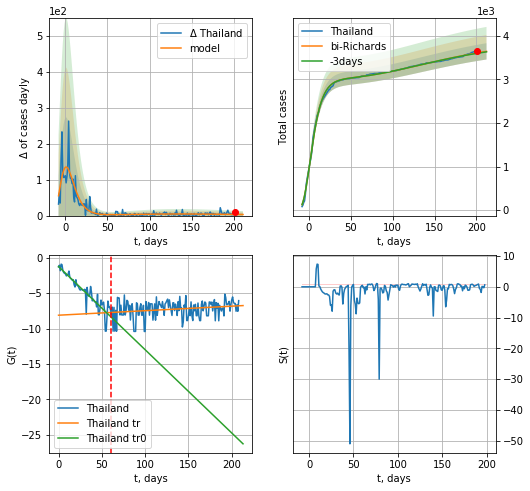

Thailand data at: 2020-10-13
+3 day model MAPE: 0.002518
model: bi-Richards
coeffs: [ 9.22952873e+02  1.88957788e+00 -2.37755253e+02  7.04550011e-03]
rational stdev: 0.051311
forecast at the end of period: +11 days
	 deltaDaycases: 3
	 total cases: 3642 ± 186
	 total death: 58 ± 8
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.843263
 intercept: -1.243932
 slope: -0.117536
trend coefficient of determination: 0.052265
 intercept: -8.120843
 slope: 0.006378


In [676]:
vL = 80
x = forecastRR("Thailand",dfTH[20:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Thailand",dfTH[20:],d12f(1),30*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-20)

In [677]:
#x = forecastRRR("Thailand",dfTH[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)

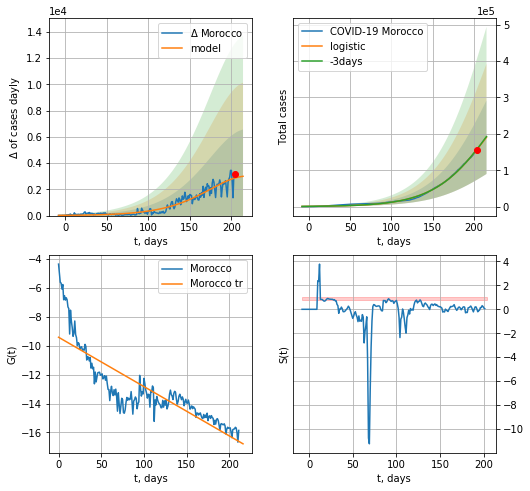

Morocco data at: 2020-10-13
+3 day model MAPE: 0.005943435631896664
model: logistic
coeffs:  [4.12847704e+05 2.92009859e-02 2.20214008e+02]
rational stdev:  0.5297419439056589
forecast at the end of period: +11 days
	 deltaDaycases:  2992
	 total cases:  190739 ± 101042
	 total death:  3263 ± 5185
trend coefficient of determination: 0.724797
 intercept: -9.418237
 slope: -0.034115


In [678]:
x = forecast("Morocco",dfMR[5:],d1,T18*7-dT)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


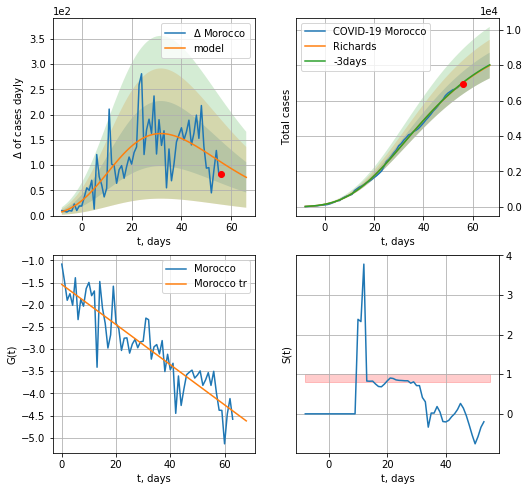

Morocco data at: 2020-10-13
+3 day model MAPE: 0.002854
model: Richards
coeffs: [ 9.80051535e+03  2.80051836e+00 -5.84633428e+01  1.62270604e-02]
rational stdev: 0.090760
forecast at the end of period: +11 days
	 deltaDaycases: 75
	 total cases: 7979 ± 724
	 total death: 136 ± 37
trend coefficient of determination: 0.815717
 intercept: -1.543258
 slope: -0.045268


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


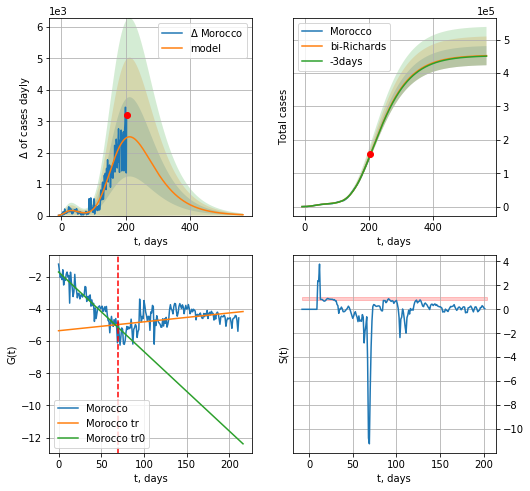

Morocco data at: 2020-10-13
+3 day model MAPE: 0.003853
model: bi-Richards
coeffs: [4.44272922e+05 2.84533727e-01 2.91154104e+01 5.53668902e-02]
rational stdev: 0.063484
forecast at the end of period: +361 days
	 deltaDaycases: 27
	 total cases: 452347 ± 28716
	 total death: 7738 ± 1473
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.859152
 intercept: -1.703973
 slope: -0.049453
trend coefficient of determination: 0.151115
 intercept: -5.355400
 slope: 0.005522


In [679]:
vL = 75 
x = forecastRR("Morocco",dfMR[5:vL-5],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Morocco",dfMR[5:],d1,80*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-5)

In [680]:
#x = forecastRRR("Morocco",dfMR[5:],d1,30*7-dT,addpred=True,xcoef=koreaCoeffs)

In [681]:
dfRM = read_df(pd.DataFrame(),"RM")
#x = forecast("Romania",dfRM[5:],d1,24*7-dT,addpred=True,xcoef=[0.35,.5,3,1])

RM
           date     cases   active   death
226 2020-10-09  148886.0  28795.0  5299.0
227 2020-10-10  152403.0  30417.0  5358.0
228 2020-10-11  155283.0  31930.0  5411.0
229 2020-10-12  157352.0  32973.0  5467.0
230 2020-10-13  160461.0  34411.0  5535.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


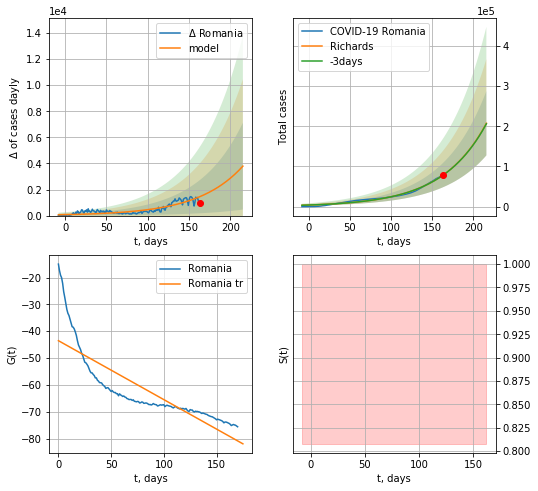

Romania data at: 2020-10-13
+3 day model MAPE: 0.003281
model: Richards
coeffs: [7.35019973e+05 1.84686749e-02 2.84500915e+02 6.31791360e+00]
rational stdev: 0.385355
forecast at the end of period: +53 days
	 deltaDaycases: 3794
	 total cases: 207415 ± 79928
	 total death: 7154 ± 8270
trend coefficient of determination: 0.702168
 intercept: -43.529308
 slope: -0.219687


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


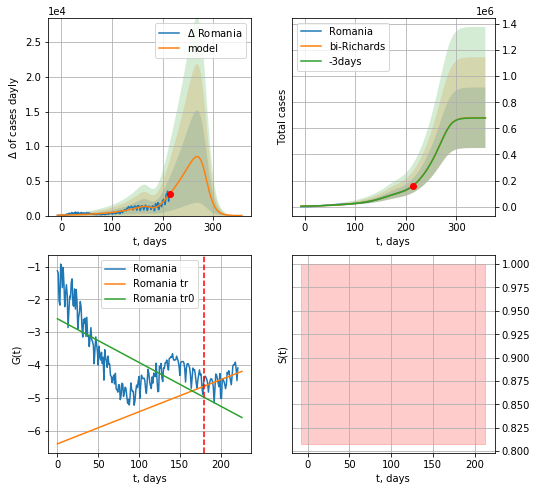

Romania data at: 2020-10-13
+3 day model MAPE: 0.003506
model: bi-Richards
coeffs: [-5.36557005e+04  4.55273628e+00  1.12134549e+02  1.21237974e-02]
rational stdev: 0.340680
forecast at the end of period: +144 days
	 deltaDaycases: 2
	 total cases: 681347 ± 232121
	 total death: 23502 ± 24019
bi-Richards approximation splitting point: 180
trend coefficient of determination: 0.461118
 intercept: -2.590041
 slope: -0.013325
trend coefficient of determination: 0.192724
 intercept: -6.403254
 slope: 0.009776


In [682]:
vL = 180+8#87+8
x = forecastRR("Romania",dfRM[8:vL-8],d1,36*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Romania",dfRM[8:],d12f(1),49*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL = vL-8)

In [683]:
#xx = forecastRRR("Romania",dfRM[8:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

In [684]:
#x = forecastRRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.35/4,.5,2.2,1])

EU
           date    cases   active     death
244 2020-10-09  3407372  1039371  151959.0
245 2020-10-10  3479820  1093369  152308.0
246 2020-10-11  3536389  1136400  152631.0
247 2020-10-12  3605616  1158168  153216.0
248 2020-10-13  3677207  1201633  153858.0


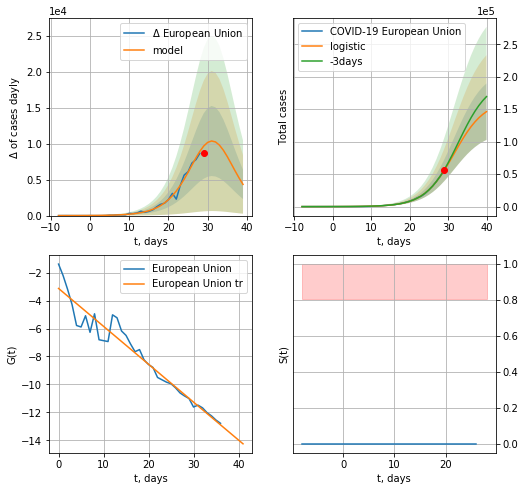

European Union data at: 2020-10-13
+3 day model MAPE: 0.026430260679971996
model: logistic
coeffs:  [1.63557146e+05 2.54069754e-01 3.15927312e+01]
rational stdev:  0.29731227366451135
forecast at the end of period: +11 days
	 deltaDaycases:  4337
	 total cases:  146278 ± 43490
	 total death:  6120 ± 5458
trend coefficient of determination: 0.939076
 intercept: -3.128192
 slope: -0.271364


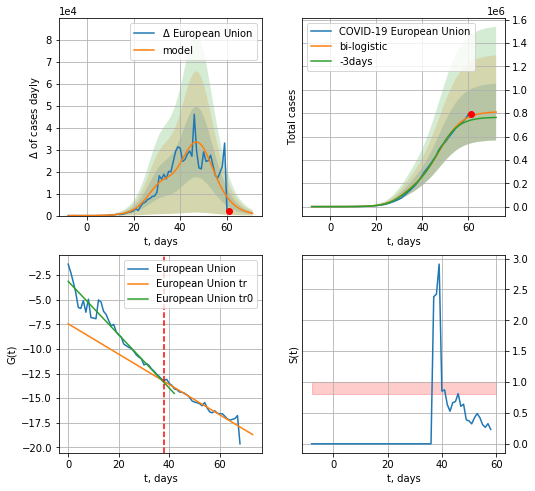

European Union data at: 2020-10-13
+3 day model MAPE: 0.04651915802684479
model: bi-logistic
coeffs:  [6.50647976e+05 2.01824362e-01 4.76677897e+01] [1.63557146e+05 2.54069754e-01 3.15927312e+01]
rational stdev:  0.30016662391822424
forecast at the end of period: +11 days
	 deltaDaycases:  1056
	 total cases:  809441 ± 242967
	 total death:  33867 ± 30497
bi-logistic approximation splitting point: 38
trend0 coefficient of determination: 0.943288
 intercept: -3.133643
 slope: -0.270910
trend coefficient of determination: 0.919558
 intercept: -7.446330
 slope: -0.154010


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


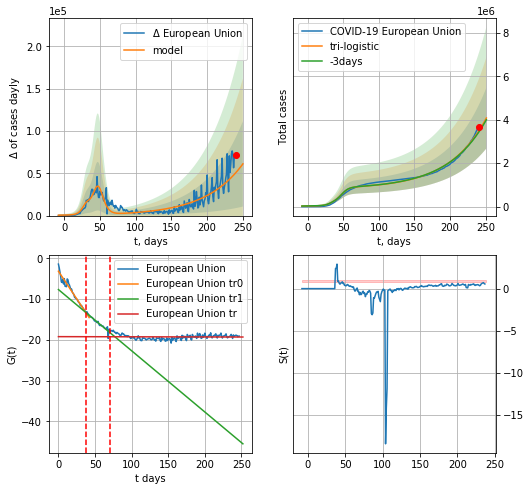

European Union data at: 2020-10-13
+3 day model MAPE: 0.015828017637769042
model: tri-logistic
coeffs:  [7.42883257e+09 1.89199846e-02 6.59544105e+02] [1.63557146e+05 2.54069754e-01 3.15927312e+01 6.50647976e+05
 2.01824362e-01 4.76677897e+01]
forecast rational stdev:  0.34277147985313944
forecast at the end of period: +11 days
	 deltaDaycases:  61152
	 total cases:  4078475 ± 1397985
	 total death:  170647 ± 175478
tri-logistic approximation splitting points: 38,70
trend0 coefficient of determination: 0.943288
 intercept: -3.133643
 slope: -0.270910
trend1 coefficient of determination: 0.917496
 intercept: -7.627918
 slope: -0.150227
trend coefficient of determination: 0.000949
 intercept: -19.186383
 slope: -0.000360


In [685]:
vL=38
vL1=70
dfEU = read_df(pd.DataFrame(),"EU")
x = forecast("European Union",dfEU[:vL],d1,T18*7-dT)
xx = forecast2("European Union",dfEU[:vL1],d1,T18*7-dT,x,vL=38,addpred=False,xcoef=[0.25,1.,1.5])
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("European Union",dfEU,d1,T18*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


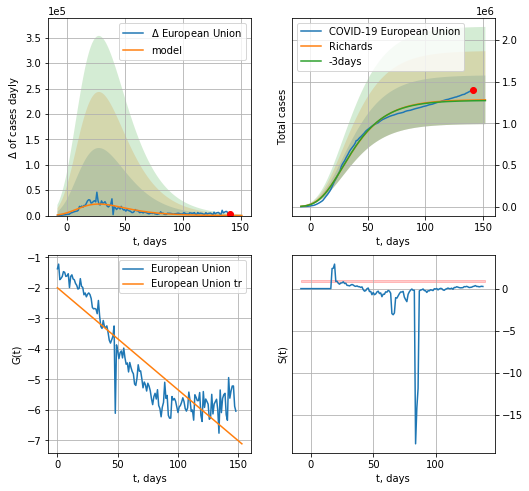

European Union data at: 2020-10-13
+3 day model MAPE: 0.007098
model: Richards
coeffs: [ 1.28357043e+06  9.86008742e+00 -8.20009188e+01  4.89565144e-03]
rational stdev: 0.227514
forecast at the end of period: +11 days
	 deltaDaycases: 160
	 total cases: 1280316 ± 291289
	 total death: 53569 ± 36563
trend coefficient of determination: 0.807039
 intercept: -1.994745
 slope: -0.033434


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


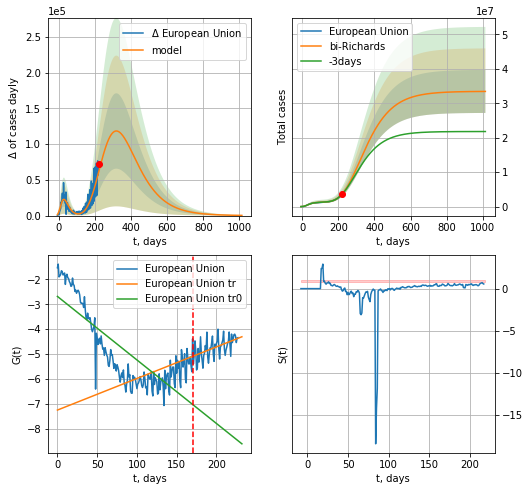

European Union data at: 2020-10-13
+3 day model MAPE: 0.012619
model: bi-Richards
coeffs: [ 3.21950040e+07  3.78772441e-01 -3.90558045e+01  2.67197780e-02]
rational stdev: 0.186746
forecast at the end of period: +795 days
	 deltaDaycases: 285
	 total cases: 33450533 ± 6246740
	 total death: 1399603 ± 784109
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.653900
 intercept: -2.682956
 slope: -0.025538
trend coefficient of determination: 0.280746
 intercept: -7.251511
 slope: 0.012700


In [686]:
vL = 130+60#83+20+17
x = forecastRR("European Union",dfEU[20:vL-20],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("European Union",dfEU[20:],d1,142*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-20)

In [687]:
#x = forecastRRR("European Union",dfEU[16:],d1,30*7-dT,addpred=True,xcoef=koreaCoeffs)

In [688]:
#x = forecastQR("European Union",dfEU[20:],d1,16*7-dT,addpred=True,xcoef=QRkoreaCoeffs)

In [689]:
#x = forecastRR("Romania",dfRM[5:],d1,14*7-dT)

In [690]:
#x = forecastRRR("European Union",dfEU[:],d1,8*7-dT)

In [691]:
#x = forecastRRR("Romania",dfRM[5:],d1,18*7-dT,addpred=True,xcoef=[0.35,.5,3.,1.])

In [692]:
#dfIC[:]

IC
           date   cases  active  death
222 2020-10-09  3373.0     915   10.0
223 2020-10-10  3460.0     984   10.0
224 2020-10-11  3526.0    1017   10.0
225 2020-10-12  3582.0    1022   10.0
226 2020-10-13  3668.0    1071   10.0


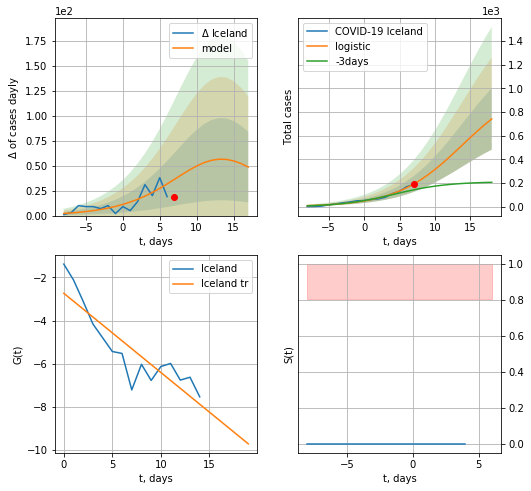

Iceland data at: 2020-10-13
+3 day model MAPE: 0.4751648041928849
model: logistic
coeffs:  [1.04285054e+03 2.17199299e-01 1.38649769e+01]
rational stdev:  0.34947878303574653
forecast at the end of period: +11 days
	 deltaDaycases:  48
	 total cases:  741 ± 258
	 total death:  2 ± 2
trend coefficient of determination: 0.782203
 intercept: -2.736046
 slope: -0.366728


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:195: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


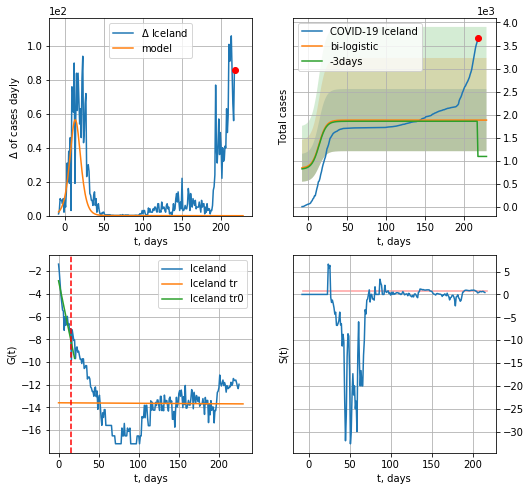

Iceland data at: 2020-10-13
+3 day model MAPE: 0.7236579283768264
model: bi-logistic
coeffs:  [787.75479672  -1.95795473 233.67006392] [1.04285054e+03 2.17199299e-01 1.38649769e+01]
scenario coeffs:  [0.0625, 1.0, 2]
rational stdev:  0.3589273597883406
forecast at the end of period: +11 days
	 deltaDaycases:  0
	 total cases:  1879 ± 674
	 total death:  5 ± 5
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.774693
 intercept: -2.854940
 slope: -0.341251
trend coefficient of determination: 0.000143
 intercept: -13.588503
 slope: -0.000422


In [693]:
dfIC = read_df(pd.DataFrame(),"IC")
vL=16
try:
    x = forecast("Iceland",dfIC[:vL],d1,T18*7-dT,addpred=False,xcoef=[0.25/2,1.,2])
    xx = forecast2("Iceland",dfIC[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25/4,1.,2],vL=vL)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


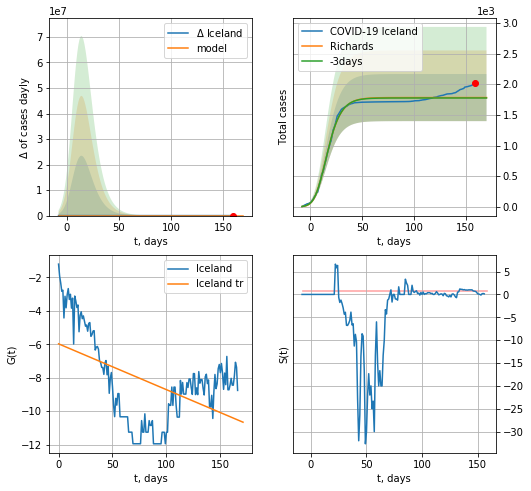

Iceland data at: 2020-10-13
+3 day model MAPE: 0.003798
model: Richards
coeffs: [1.78218704e+03 4.15281218e-01 4.51711528e+00 2.96176572e-01]
rational stdev: 0.215516
forecast at the end of period: +11 days
	 deltaDaycases: 0
	 total cases: 1782 ± 384
	 total death: 4 ± 2
trend coefficient of determination: 0.246093
 intercept: -5.976231
 slope: -0.027410


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


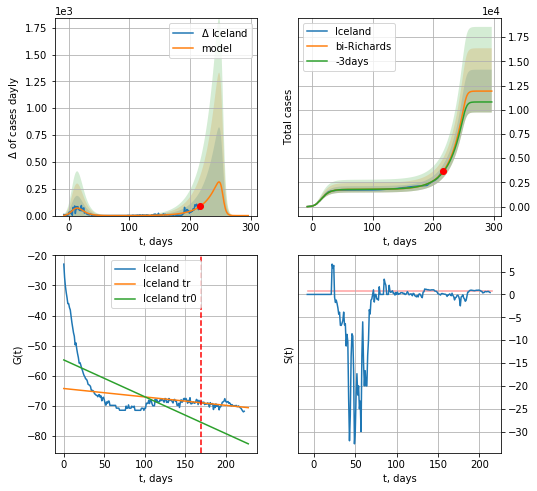

Iceland data at: 2020-10-13
+3 day model MAPE: 0.019915
model: bi-Richards
coeffs: [1.01456569e+04 4.53852463e-02 2.54006576e+02 8.30135721e+00]
rational stdev: 0.185143
forecast at the end of period: +81 days
	 deltaDaycases: 0
	 total cases: 11927 ± 2208
	 total death: 32 ± 17
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.385640
 intercept: -54.798591
 slope: -0.122506
trend coefficient of determination: 0.222172
 intercept: -64.318380
 slope: -0.027944


In [694]:
vL = 170+2
x = forecastRR("Iceland",dfIC[2:vL-2],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Iceland",dfIC[2:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-2)
#x = forecastRRR("Iceland",dfIC[:20],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2])

In [695]:
#x = forecastRRR("Iceland",dfIC[5:],d1,T18*7-dT,addpred=False,xcoef=[0.35/6,.5,4.,1.])

PM
           date   cases   active   death
213 2020-10-09  118841  21405.0  2474.0
214 2020-10-10  119666  21632.0  2482.0
215 2020-10-11  120313  21658.0  2491.0
216 2020-10-12  120802  21625.0  2502.0
217 2020-10-13  121296  21488.0  2511.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


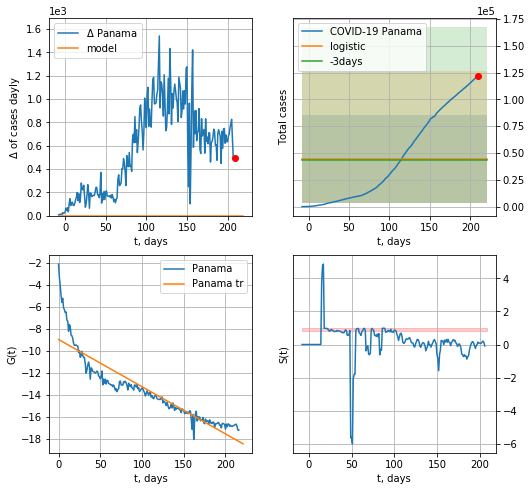

Panama data at: 2020-10-13
+3 day model MAPE: 0.02429508577624127
model: logistic
coeffs:  [ 4.47445872e+04 -3.76792106e+01  9.15934300e+02]
rational stdev:  0.9146710518741821
forecast at the end of period: +11 days
	 deltaDaycases:  0
	 total cases:  44744 ± 40926
	 total death:  926 ± 2540
trend coefficient of determination: 0.828737
 intercept: -8.962158
 slope: -0.042962


In [696]:
dfPM = read_df(pd.DataFrame(),"PM").fillna(0)
x = forecast("Panama",dfPM[:],d1,T18*7-dT)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


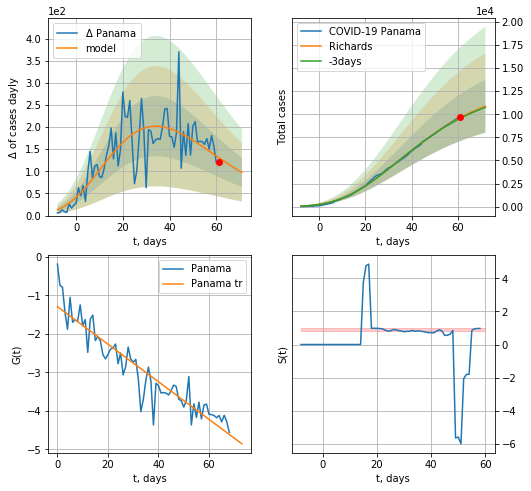

Panama data at: 2020-10-13
+3 day model MAPE: 0.008202
model: Richards
coeffs: [ 1.34884806e+04  2.34095265e+00 -6.38236986e+01  1.75426471e-02]
rational stdev: 0.263123
forecast at the end of period: +11 days
	 deltaDaycases: 97
	 total cases: 10877 ± 2862
	 total death: 225 ± 177
trend coefficient of determination: 0.871686
 intercept: -1.291509
 slope: -0.048815


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


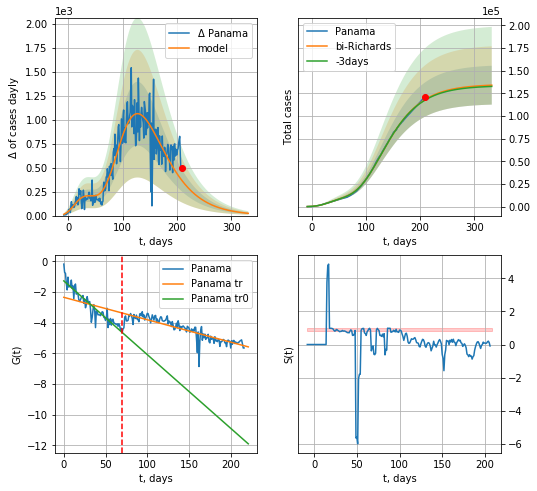

Panama data at: 2020-10-13
+3 day model MAPE: 0.005293
model: bi-Richards
coeffs: [ 1.21421474e+05  1.94447237e+00 -5.77834976e+01  1.21608573e-02]
rational stdev: 0.159920
forecast at the end of period: +123 days
	 deltaDaycases: 23
	 total cases: 133922 ± 21416
	 total death: 2772 ± 1329
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.873812
 intercept: -1.272563
 slope: -0.048089
trend coefficient of determination: 0.762561
 intercept: -2.343456
 slope: -0.014627


In [697]:
vL = 70
x = forecastRR("Panama",dfPM[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Panama",dfPM[:],d1,46*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

In [698]:
#x = forecastRRR("Panama",dfPM[:],d1,34*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


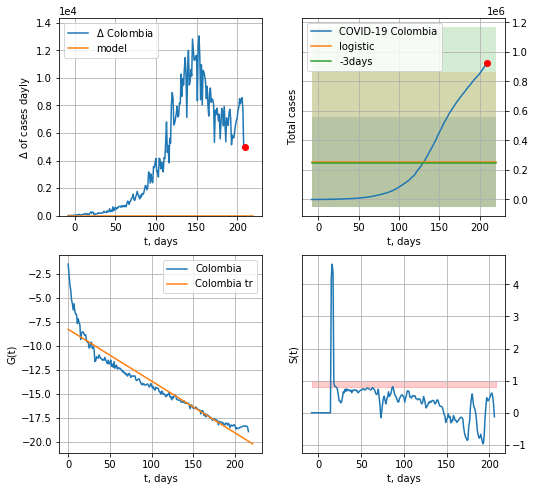

Colombia data at: 2020-10-13
+3 day model MAPE: 0.03743090567840623
model: logistic
coeffs:  [ 2.56058826e+05 -1.89957750e+01  4.59424379e+02]
rational stdev:  1.1884727941275335
forecast at the end of period: +11 days
	 deltaDaycases:  0
	 total cases:  256058 ± 304318
	 total death:  7797 ± 27799
trend coefficient of determination: 0.905280
 intercept: -8.293073
 slope: -0.053999


In [699]:
dfCB = dfCB.fillna(0)
x = forecast("Colombia",dfCB[:],d1,T18*7-dT)

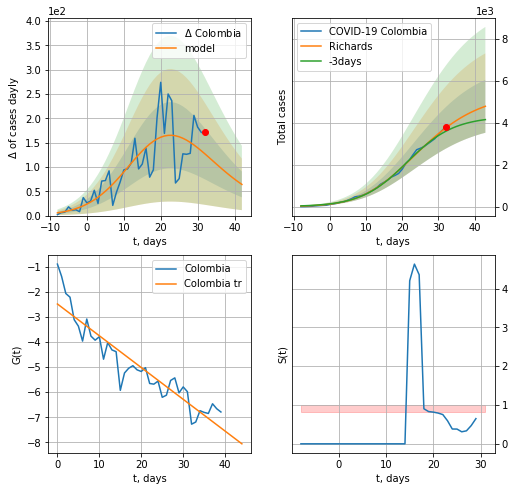

Colombia data at: 2020-10-13
+3 day model MAPE: 0.053959
model: Richards
coeffs: [5.45324012e+03 2.23852503e-01 1.50938863e+01 4.47627095e-01]
rational stdev: 0.263661
forecast at the end of period: +11 days
	 deltaDaycases: 64
	 total cases: 4777 ± 1259
	 total death: 145 ± 114
trend coefficient of determination: 0.864435
 intercept: -2.485430
 slope: -0.126591


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


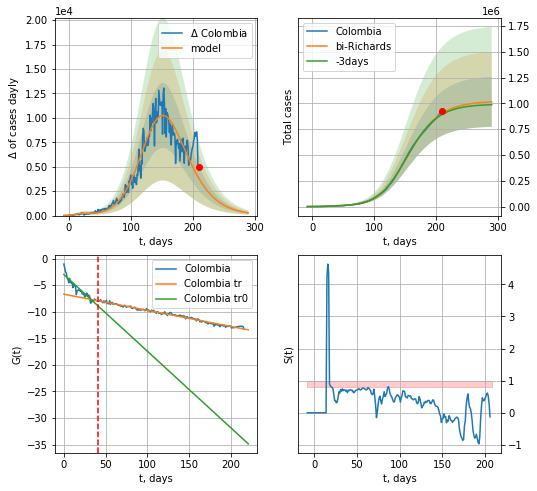

Colombia data at: 2020-10-13
+3 day model MAPE: 0.010829
model: bi-Richards
coeffs: [1.01689087e+06 5.96716889e-02 1.36895215e+02 5.89264334e-01]
rational stdev: 0.238431
forecast at the end of period: +81 days
	 deltaDaycases: 280
	 total cases: 1014469 ± 241880
	 total death: 30893 ± 22097
bi-Richards approximation splitting point: 41
trend coefficient of determination: 0.872945
 intercept: -3.008102
 slope: -0.144118
trend coefficient of determination: 0.985059
 intercept: -6.708717
 slope: -0.030342


In [700]:
vL = 41
x = forecastRR("Colombia",dfCB[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Colombia",dfCB[:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

In [701]:
#x = forecastRRR("Colombia",dfCB[:],d1,84*7-dT,addpred=True,xcoef=koreaCoeffs)

AR
           date    cases   active   death
219 2020-10-09  52804.0  13948.0  1789.0
220 2020-10-10  52940.0  13975.0  1795.0
221 2020-10-11  53072.0  14101.0  1801.0
222 2020-10-12  53225.0  14034.0  1809.0
223 2020-10-13  53399.0  14089.0  1818.0


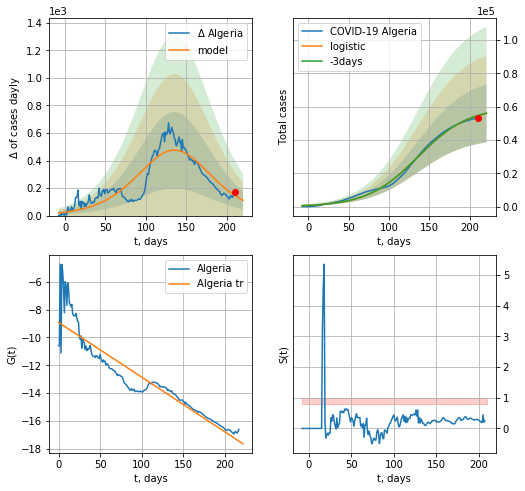

Algeria data at: 2020-10-13
+3 day model MAPE: 0.0033856539219934614
model: logistic
coeffs:  [5.95124809e+04 3.19448923e-02 1.35607956e+02]
rational stdev:  0.30988563883278814
forecast at the end of period: +11 days
	 deltaDaycases:  111
	 total cases:  55861 ± 17310
	 total death:  1901 ± 1767
trend coefficient of determination: 0.862344
 intercept: -8.921421
 slope: -0.039320


In [702]:
dfAR = read_df(pd.DataFrame(),"AR")
dfAR = dfAR.fillna(0)
x = forecast("Algeria",dfAR[5:],d1,T18*7-dT)
#dfAG

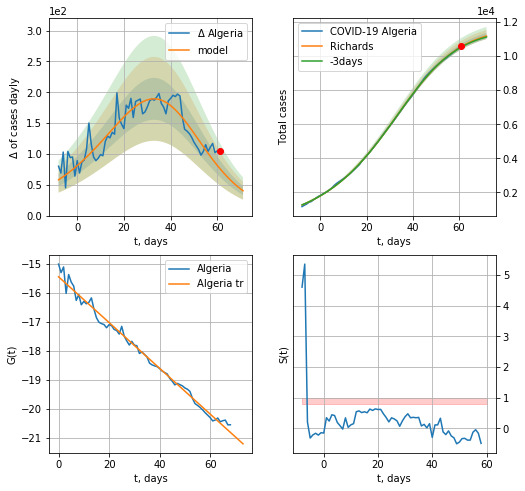

Algeria data at: 2020-10-13
+3 day model MAPE: 0.002873
model: Richards
coeffs: [1.17018124e+04 4.57679581e-02 4.02904334e+01 1.72065937e+00]
rational stdev: 0.015955
forecast at the end of period: +11 days
	 deltaDaycases: 40
	 total cases: 11176 ± 178
	 total death: 380 ± 18
trend coefficient of determination: 0.988499
 intercept: -15.458346
 slope: -0.078873


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


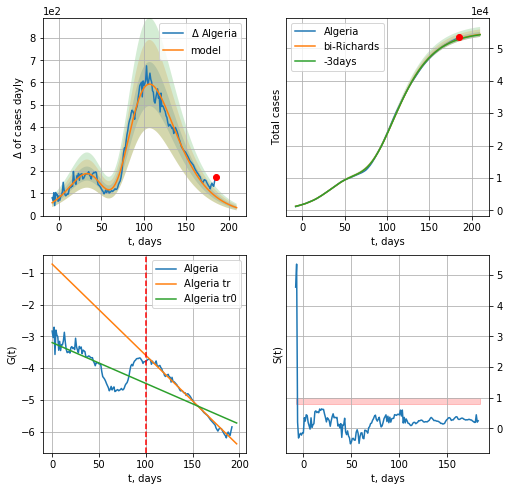

Algeria data at: 2020-10-13
+3 day model MAPE: 0.001597
model: bi-Richards
coeffs: [ 4.35380238e+04  3.25499744e+00 -1.35235939e+01  1.13826083e-02]
rational stdev: 0.014178
forecast at the end of period: +25 days
	 deltaDaycases: 35
	 total cases: 54282 ± 769
	 total death: 1848 ± 78
bi-Richards approximation splitting point: 100
trend coefficient of determination: 0.463876
 intercept: -3.194666
 slope: -0.012865
trend coefficient of determination: 0.989739
 intercept: -0.719955
 slope: -0.028757


In [703]:
iL = 30
vL = 100+iL
x = forecastRR("Algeria",dfAR[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Algeria",dfAR[iL:],d1,32*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [704]:
#x = forecastRRR("Algeria",dfAR[10:],d1,48*7-dT,addpred=True,xcoef=koreaCoeffs)

IE
           date   cases   active    death
214 2020-10-09  324658  65314.0  11677.0
215 2020-10-10  333449  66578.0  11844.0
216 2020-10-11  336716  66578.0  11844.0
217 2020-10-12  338663  66262.0  11935.0
218 2020-10-13  340622  65299.0  12027.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


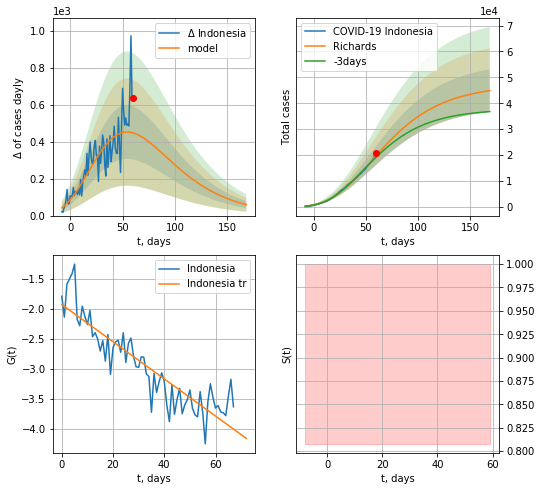

Indonesia data at: 2020-10-13
+3 day model MAPE: 0.038052
model: Richards
coeffs: [ 4.71241400e+04  1.80052285e+00 -1.05975004e+02  1.46057737e-02]
rational stdev: 0.182929
forecast at the end of period: +109 days
	 deltaDaycases: 59
	 total cases: 44847 ± 8203
	 total death: 1583 ± 868
trend coefficient of determination: 0.798542
 intercept: -1.926266
 slope: -0.031064


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


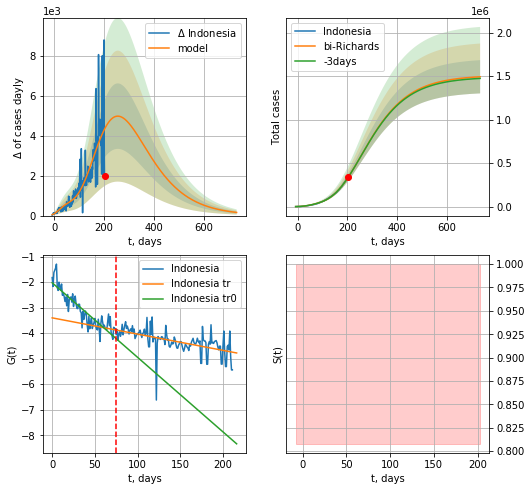

Indonesia data at: 2020-10-13
+3 day model MAPE: 0.000988
model: bi-Richards
coeffs: [ 1.46171147e+06  4.22416102e-01 -1.51661435e+02  2.21300474e-02]
rational stdev: 0.127988
forecast at the end of period: +529 days
	 deltaDaycases: 157
	 total cases: 1492018 ± 190959
	 total death: 52681 ± 20227
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.800635
 intercept: -2.027050
 slope: -0.029202
trend coefficient of determination: 0.323394
 intercept: -3.400787
 slope: -0.006367


In [706]:
dfIE = read_df(pd.DataFrame(),"IE")
try:
    #x = forecast("Indonesia",dfIE[5:],d1,T18*7-dT)
    vL = 75+6
    x = forecastRR("Indonesia",dfIE[6:vL-6],d1,44*7-dT,addpred=False,xcoef=RkoreaCoeffs)
    xx = forecast2RR("Indonesia",dfIE[6:],d12f(1),104*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-6)
except:
    print ("Exception occurs")

In [707]:
#x = forecastRRR("Indonesia",dfIE[13:],d1,46*7-dT,addpred=True,xcoef=koreaCoeffs)

PH
           date   cases   active   death
216 2020-10-09  336926  54594.0  6238.0
217 2020-10-10  339341  39945.0  6321.0
218 2020-10-11  342816  43332.0  6332.0
219 2020-10-12  344713  44958.0  6372.0
220 2020-10-13  346536  46227.0  6449.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


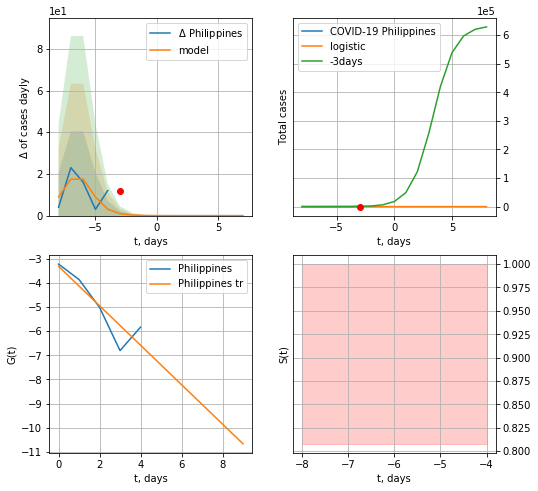

Philippines data at: 2020-10-13
+3 day model MAPE: 0.9724006926427327
model: logistic
coeffs:  [61.5169203   1.2919553  -5.99802409]
rational stdev:  0.193485507182797
forecast at the end of period: +11 days
	 deltaDaycases:  0
	 total cases:  61 ± 11
	 total death:  1 ± 0
trend coefficient of determination: 0.794507
 intercept: -3.309972
 slope: -0.817432


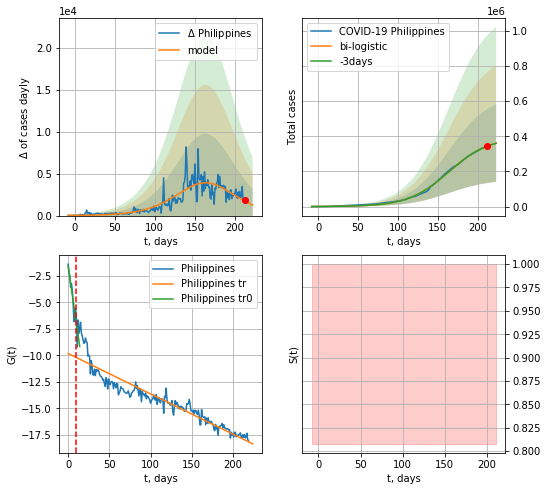

Philippines data at: 2020-10-13
+3 day model MAPE: 0.0020204037144452196
model: bi-logistic
coeffs:  [3.94896913e+05 3.95872924e-02 1.63633460e+02] [61.5169203   1.2919553  -5.99802409]
rational stdev:  0.6107118196970622
forecast at the end of period: +11 days
	 deltaDaycases:  1262
	 total cases:  360581 ± 220211
	 total death:  6665 ± 12211
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.872436
 intercept: -1.560268
 slope: -0.541848
trend coefficient of determination: 0.877749
 intercept: -9.822659
 slope: -0.038005


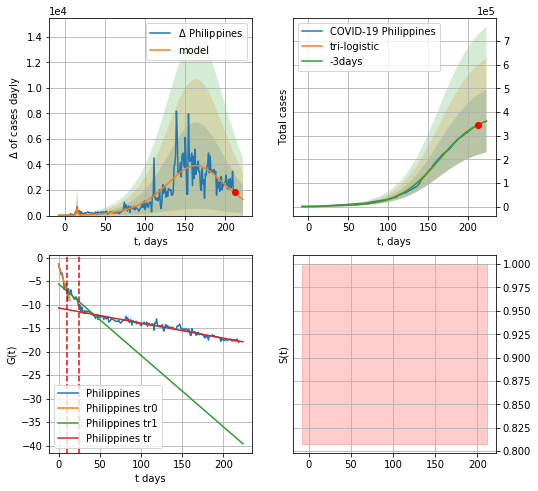

Philippines data at: 2020-10-13
+3 day model MAPE: 4.061370471361409e-05
model: tri-logistic
coeffs:  [1347.99089087    1.88227314   15.77296241] [ 6.15169203e+01  1.29195530e+00 -5.99802409e+00  3.94896913e+05
  3.95872924e-02  1.63633460e+02]
forecast rational stdev:  0.36689311492843896
forecast at the end of period: +11 days
	 deltaDaycases:  1262
	 total cases:  361929 ± 132789
	 total death:  6690 ± 7363
tri-logistic approximation splitting points: 10,25
trend0 coefficient of determination: 0.872436
 intercept: -1.560268
 slope: -0.541848
trend1 coefficient of determination: 0.474240
 intercept: -5.600607
 slope: -0.151865
trend coefficient of determination: 0.942857
 intercept: -10.715863
 slope: -0.032125


In [777]:
vL=10
vL1=25
try:
    dfPH = read_df(pd.DataFrame(),"PH")
    x = forecast("Philippines",dfPH[4:vL],d1,T18*7-dT,addpred=False,xcoef=[0.25,1.,2.3])
    xx = forecast2("Philippines",dfPH[:],d1,T18*7-dT,x,vL=vL,addpred=False,xcoef=[0.25,1.,1.8])
    xx = np.concatenate((x, xx), axis=0)
    xxx = forecast3("Philippines",dfPH,d1,T18*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])
except:
    print ("Exception occurs")

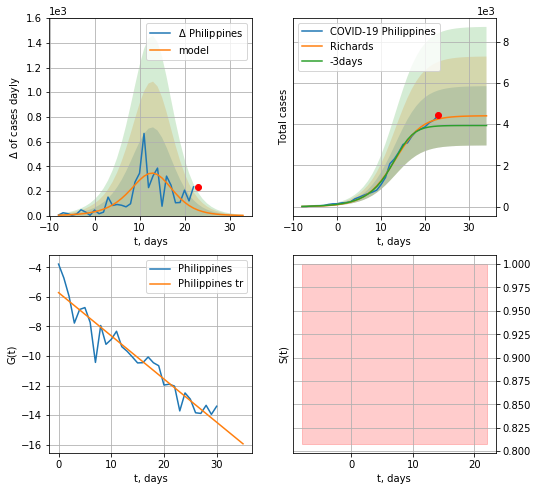

Philippines data at: 2020-10-13
+3 day model MAPE: 0.095041
model: Richards
coeffs: [4.40831989e+03 2.70678377e-01 1.39356489e+01 1.24523177e+00]
rational stdev: 0.326084
forecast at the end of period: +11 days
	 deltaDaycases: 1
	 total cases: 4404 ± 1436
	 total death: 81 ± 79
trend coefficient of determination: 0.911495
 intercept: -5.712821
 slope: -0.292234


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


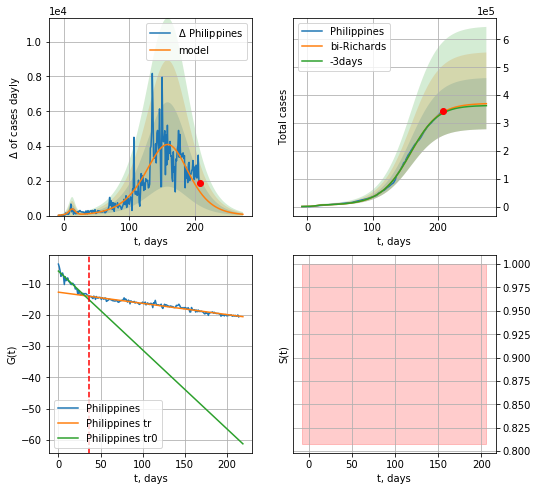

Philippines data at: 2020-10-12
+3 day model MAPE: 0.008708
model: bi-Richards
coeffs: [3.66609868e+05 3.92733994e-02 1.62710922e+02 1.20866758e+00]
rational stdev: 0.248567
forecast at the end of period: +67 days
	 deltaDaycases: 74
	 total cases: 369484 ± 91841
	 total death: 6829 ± 5092
bi-Richards approximation splitting point: 36
trend coefficient of determination: 0.899846
 intercept: -5.926509
 slope: -0.252916
trend coefficient of determination: 0.955012
 intercept: -12.697793
 slope: -0.035887


In [778]:
vL = 36 + 4
x = forecastRR("Philippines",dfPH[4:vL-4],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Philippines",dfPH[4:-1],d12f(2),38*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-4)

In [712]:
#x = forecastRRR("Philippines",dfPH[4:],d1,40*7-dT,addpred=True,xcoef=koreaCoeffs)

GC
           date    cases  active  death
223 2020-10-09  21772.0   11352  431.0
224 2020-10-10  22078.0   11653  436.0
225 2020-10-11  22358.0   11920  449.0
226 2020-10-12  22652.0   12207  456.0
227 2020-10-13  23060.0   12609  462.0


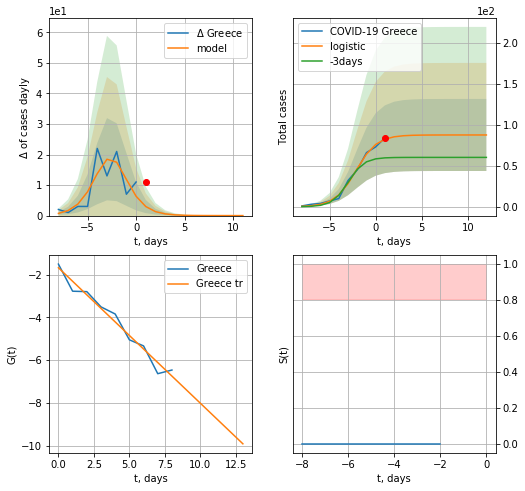

Greece data at: 2020-10-13
+3 day model MAPE: 0.4212876769828872
model: logistic
coeffs:  [87.54984336  0.87627722 -2.15069813]
rational stdev:  0.5018417290456435
forecast at the end of period: +11 days
	 deltaDaycases:  0
	 total cases:  87 ± 43
	 total death:  1 ± 1
trend coefficient of determination: 0.966991
 intercept: -1.674249
 slope: -0.634181


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


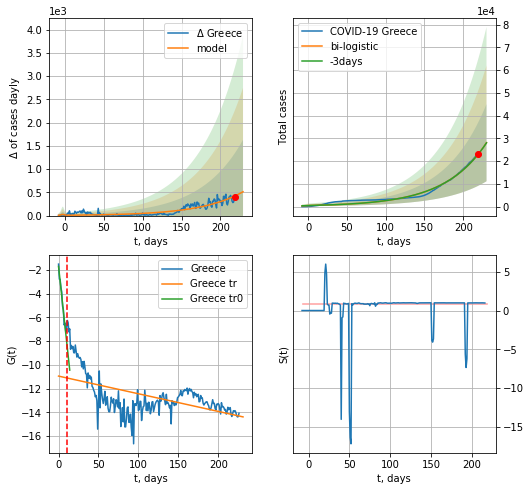

Greece data at: 2020-10-13
+3 day model MAPE: 0.0019928307216164334
model: bi-logistic
coeffs:  [6.02867483e+07 1.84931939e-02 6.44957282e+02] [87.54984336  0.87627722 -2.15069813]
rational stdev:  0.6035196583890279
forecast at the end of period: +11 days
	 deltaDaycases:  512
	 total cases:  28096 ± 16956
	 total death:  562 ± 1017
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.974467
 intercept: -1.699561
 slope: -0.624689
trend coefficient of determination: 0.300993
 intercept: -10.950984
 slope: -0.014900


In [713]:
dfGC = read_df(pd.DataFrame(),"GC")
x = forecast("Greece",dfGC[:10],d1,T18*7-dT)
xx = forecast2("Greece",dfGC[:],d1,T18*7-dT,x,addpred=False,xcoef=[.25/2,1.,2.3],vL=10)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


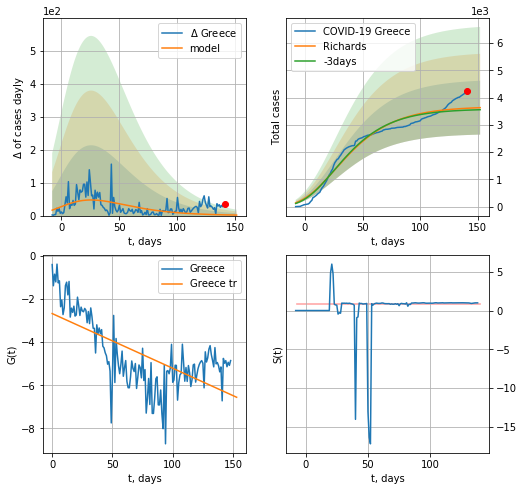

Greece data at: 2020-10-13
+3 day model MAPE: 0.019952
model: Richards
coeffs: [ 3.67300317e+03  8.86166446e+00 -1.31342745e+02  3.96579151e-03]
rational stdev: 0.271998
forecast at the end of period: +11 days
	 deltaDaycases: 1
	 total cases: 3629 ± 987
	 total death: 72 ± 58
trend coefficient of determination: 0.441158
 intercept: -2.678204
 slope: -0.025333


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


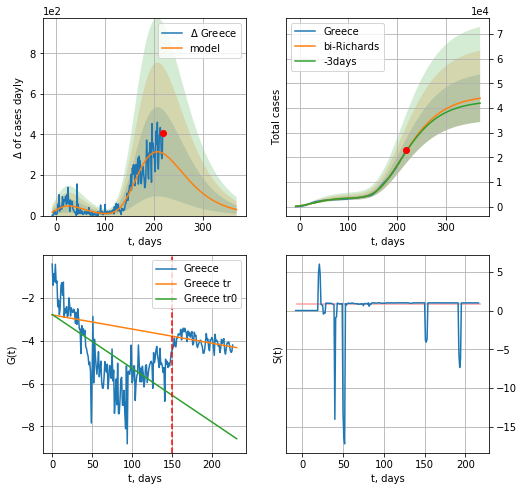

Greece data at: 2020-10-13
+3 day model MAPE: 0.008474
model: bi-Richards
coeffs: [4.17711724e+04 1.26182444e+00 8.23538754e+00 1.63501954e-02]
rational stdev: 0.219383
forecast at the end of period: +151 days
	 deltaDaycases: 29
	 total cases: 44004 ± 9653
	 total death: 881 ± 579
bi-Richards approximation splitting point: 150
trend coefficient of determination: 0.434387
 intercept: -2.775086
 slope: -0.025084
trend coefficient of determination: 0.211280
 intercept: -2.793914
 slope: -0.006605


In [714]:
iL = 0
vL = 150+iL
x = forecastRR("Greece",dfGC[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Greece",dfGC[iL:],d1,50*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [715]:
#x = forecastRRR("Greece",dfGC[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)

HG
           date    cases  active   death
217 2020-10-09  36596.0   25980   933.0
218 2020-10-10  37664.0   25862   954.0
219 2020-10-11  38837.0   26832   968.0
220 2020-10-12  39862.0   27113   996.0
221 2020-10-13  40782.0   27595  1023.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


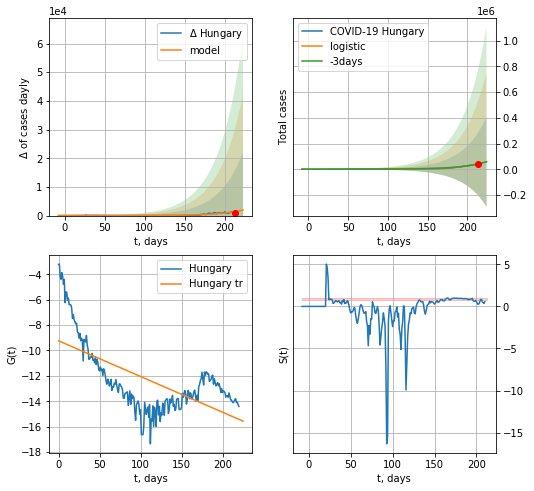

Hungary data at: 2020-10-13
+3 day model MAPE: 0.007149334023974326
model: logistic
coeffs:  [1.73622340e+08 3.35654743e-02 4.61988059e+02]
scenario coeffs:  [0.35, 0.5, 4, 1]
rational stdev:  5.928317663304912
forecast at the end of period: +11 days
	 deltaDaycases:  1944
	 total cases:  58916 ± 349274
	 total death:  1477 ± 26268
trend coefficient of determination: 0.418396
 intercept: -9.236448
 slope: -0.028120


In [716]:
dfHG = read_df(pd.DataFrame(),"HG")
try:
    x = forecast("Hungary",dfHG[:],d1,T18*7-dT,addpred=True,xcoef=[.35,.5,4,1])
except:
    print("Exception occurs")
#xx = forecast2("Hungary",dfHG[:],d1,4*7-dT,x,vL=10)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


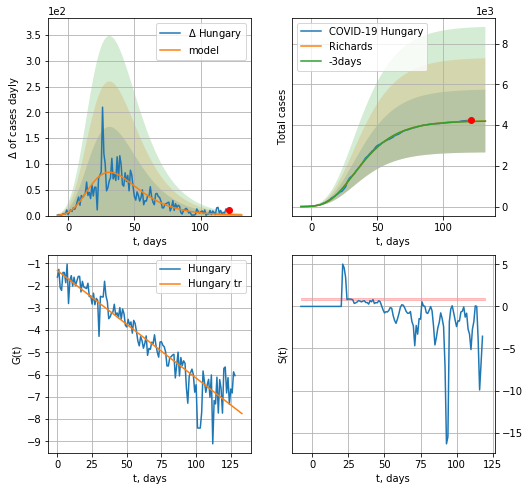

Hungary data at: 2020-10-13
+3 day model MAPE: 0.001493
model: Richards
coeffs: [ 4.22179468e+03  5.32490155e+00 -5.27402788e+01  1.02006678e-02]
rational stdev: 0.366758
forecast at the end of period: +11 days
	 deltaDaycases: 1
	 total cases: 4203 ± 1541
	 total death: 105 ± 115
trend coefficient of determination: 0.884632
 intercept: -1.330170
 slope: -0.048257


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


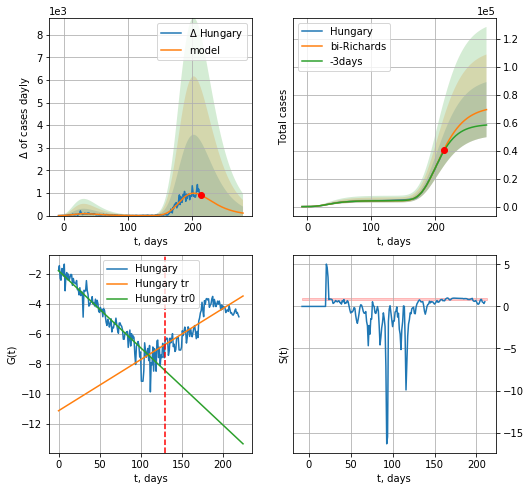

Hungary data at: 2020-10-13
+3 day model MAPE: 0.024812
model: bi-Richards
coeffs: [6.79389756e+04 4.17326895e-01 1.47400294e+02 9.98036723e-02]
rational stdev: 0.284275
forecast at the end of period: +67 days
	 deltaDaycases: 110
	 total cases: 69500 ± 19757
	 total death: 1743 ± 1486
bi-Richards approximation splitting point: 130
trend coefficient of determination: 0.896140
 intercept: -1.779863
 slope: -0.051251
trend coefficient of determination: 0.645813
 intercept: -11.108604
 slope: 0.033963


In [717]:
vL = 130
x = forecastRR("Hungary",dfHG[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Hungary",dfHG[:],d1,38*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

In [718]:
#x = forecastRRR("Hungary",dfHG[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs,cases='cases')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


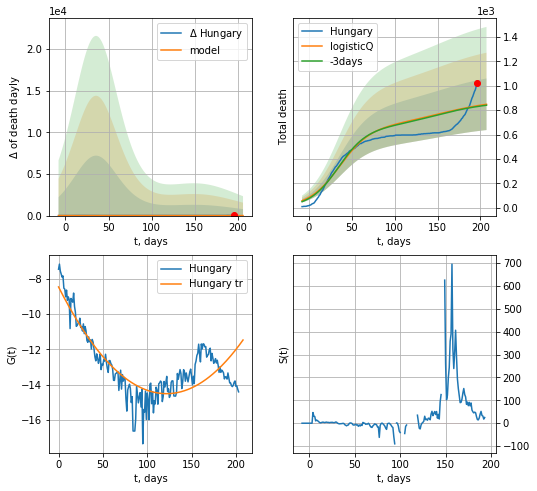

Hungary data at: 2020-10-13
+3 day model MAPE: 0.007929
model: logisticQ
coeffs: [ 6.59176801e+02  3.29885357e-08  3.55383218e+01 -1.68426230e+06]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.249663
forecast at the end of period: +11 days
	 total death: 848 ± 211
trend coefficient of determination: 0.720194
 intercept_: -8.470361520350403
 coeffs_: [ 0.         -0.09928426  0.00040792]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: divide by zero encountered in true_divide


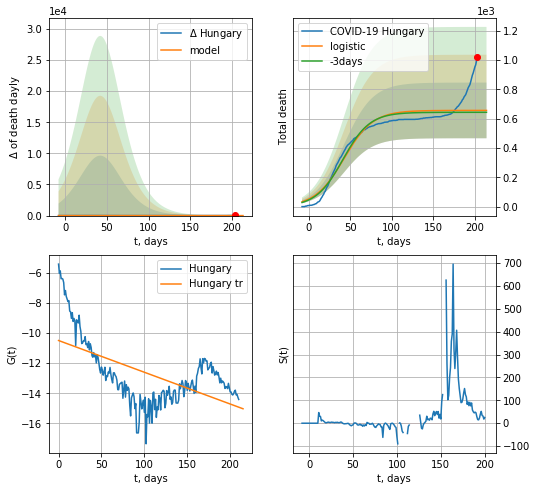

Hungary data at: 2020-10-13
+3 day model MAPE: 0.02001163986755081
model: logistic
coeffs:  [6.57283377e+02 5.76298693e-02 4.24134260e+01]
rational stdev:  0.2889510531610467
forecast at the end of period: +11 days
	 total death:  657 ± 189
trend coefficient of determination: 0.337020
 intercept: -10.494669
 slope: -0.021063


In [719]:
x = forecastRRR("Hungary",dfHG[17:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')
x = forecast("Hungary",dfHG[10:],d1,T18*7-dT,cases='death')

MT
           date   cases  active  death
215 2020-10-09  3581.0     625   41.0
216 2020-10-10  3681.0     703   41.0
217 2020-10-11  3776.0     768   41.0
218 2020-10-12  3844.0     820   43.0
219 2020-10-13  3937.0     881   44.0


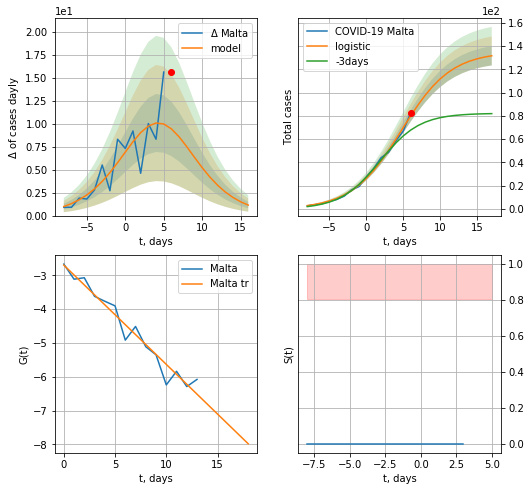

Malta data at: 2020-10-13
model: logistic
coeffs:  [135.01423457   0.29914202   4.75768623]
rational stdev:  0.06279874283082902
forecast at the end of period: +11 days
	 deltaDaycases:  1
	 total cases:  131 ± 8
	 total death:  1 ± 0
trend coefficient of determination: 0.952124
 intercept: -2.695789
 slope: -0.293811


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


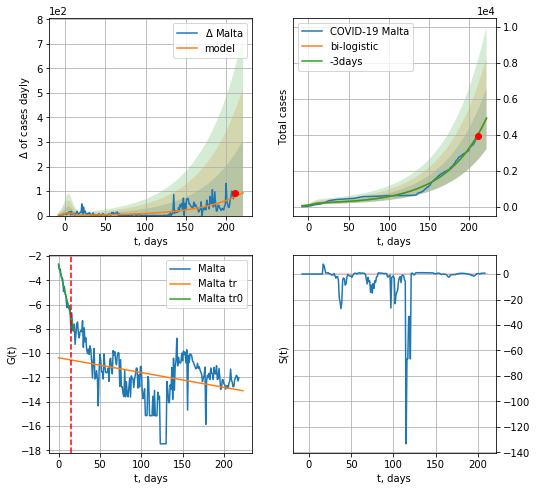

Malta data at: 2020-10-13
+3 day model MAPE: 0.0038562619435502745
model: bi-logistic
coeffs:  [1.59660044e+06 1.98108749e-02 5.15204655e+02] [135.01423457   0.29914202   4.75768623]
scenario coeffs:  [0.125, 1.0, 1.8]
rational stdev:  0.3461889467666241
forecast at the end of period: +11 days
	 deltaDaycases:  93
	 total cases:  4913 ± 1700
	 total death:  54 ± 56
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.953633
 intercept: -2.737437
 slope: -0.284200
trend coefficient of determination: 0.119649
 intercept: -10.374961
 slope: -0.012181


In [720]:
try:
    dfMT = read_df(pd.DataFrame(),"MT")
    x = forecast("Malta",dfMT[:15],d1,7*T18-dT,pMAPE=False)
    xx = forecast2("Malta",dfMT[:],d1,7*T18-dT,x,vL=15,addpred=True,xcoef=[0.25/2,1.,1.8])
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


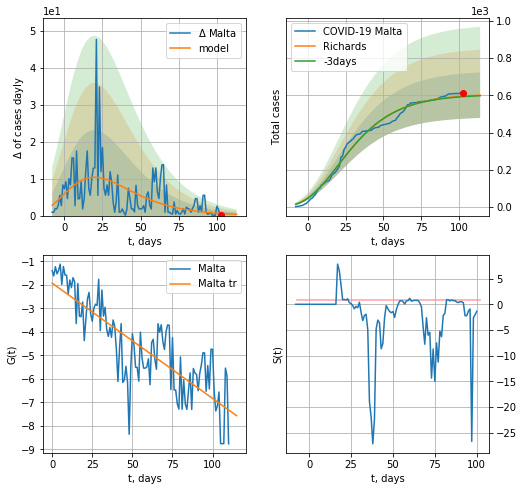

Malta data at: 2020-10-13
+3 day model MAPE: 0.004738
model: Richards
coeffs: [ 6.08571201e+02  8.24808839e+00 -9.10069288e+01  5.64853369e-03]
rational stdev: 0.203304
forecast at the end of period: +11 days
	 deltaDaycases: 0
	 total cases: 600 ± 122
	 total death: 6 ± 3
trend coefficient of determination: 0.678551
 intercept: -1.925365
 slope: -0.049026


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


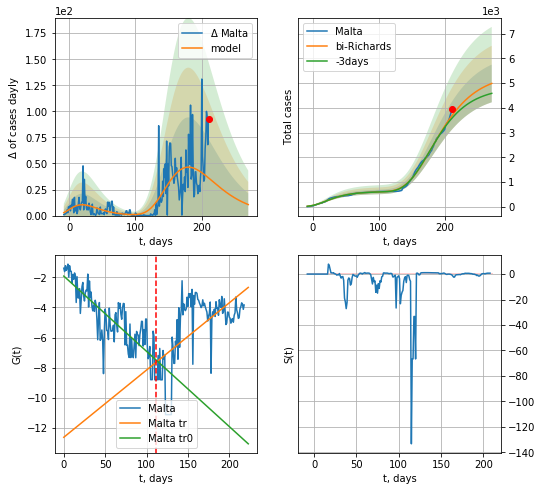

Malta data at: 2020-10-13
+3 day model MAPE: 0.030119
model: bi-Richards
coeffs: [4.79372753e+03 2.37805326e+00 1.05454669e+01 1.11461227e-02]
rational stdev: 0.152921
forecast at the end of period: +60 days
	 deltaDaycases: 10
	 total cases: 4989 ± 763
	 total death: 55 ± 25
bi-Richards approximation splitting point: 112
trend coefficient of determination: 0.688002
 intercept: -1.923622
 slope: -0.049839
trend coefficient of determination: 0.368789
 intercept: -12.604074
 slope: 0.044530


In [721]:
vL = 112
x = forecastRR("Malta",dfMT[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Malta",dfMT[:],d12f(1),37*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

In [722]:
#x = forecastRRR("Malta",dfMT[:30],d1,T18*7-dT,addpred=False,xcoef=[0.35/4,.5,3,1.])
#xx = forecast2RRR("Malta",dfMT[:],d1,40*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=30)

SL
           date    cases   active  death
213 2020-10-09  18797.0  13183.0   61.0
214 2020-10-10  19851.0  14159.0   61.0
215 2020-10-11  20355.0  14263.0   61.0
216 2020-10-12  20886.0  14437.0   61.0
217 2020-10-13  20886.0  14437.0   61.0


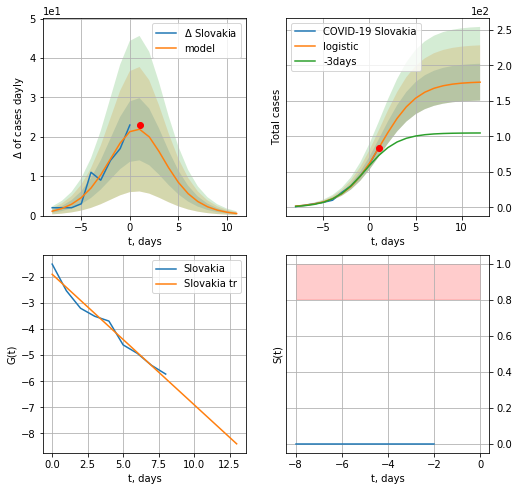

Slovakia data at: 2020-10-13
model: logistic
coeffs:  [177.28786061   0.49967231   1.23158076]
rational stdev:  0.14723855931524674
forecast at the end of period: +11 days
	 deltaDaycases:  0
	 total cases:  176 ± 25
	 total death:  0 ± 0
trend coefficient of determination: 0.974721
 intercept: -1.894823
 slope: -0.500610
Exception ocurs


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:485: RuntimeWarning: divide by zero encountered in log


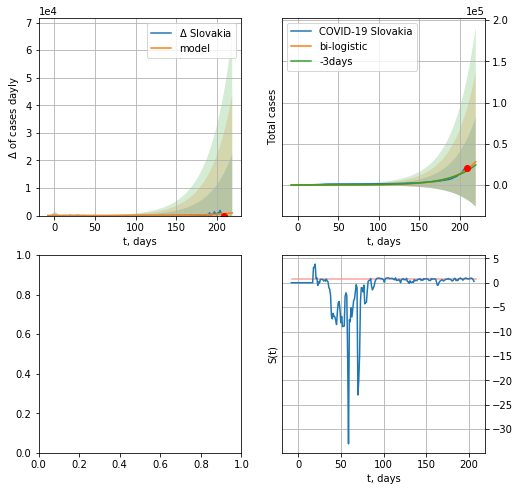

In [723]:
dfSL = read_df(pd.DataFrame(),"SL")
dfSL = dfSL.fillna(0)
try:
    x = forecast("Slovakia",dfSL[:10],d1,T18*7-dT,pMAPE=False)
    xx = forecast2("Slovakia",dfSL[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,1.7],vL=10)
except:
    print("Exception ocurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


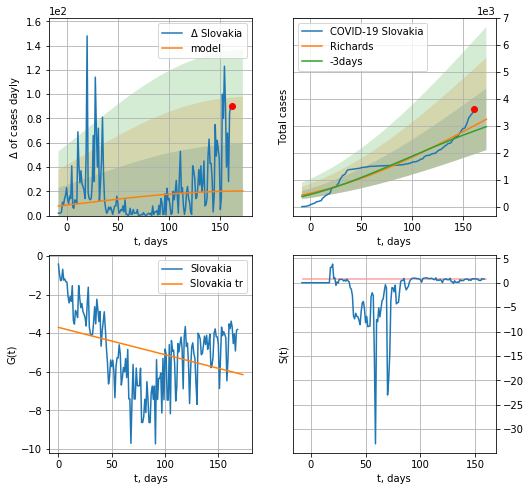

Slovakia data at: 2020-10-12
+3 day model MAPE: 0.071099
model: Richards
coeffs: [ 9.22154238e+03  4.41676744e-01 -5.31921240e+02  1.36332717e-02]
rational stdev: 0.352489
forecast at the end of period: +12 days
	 deltaDaycases: 20
	 total cases: 3245 ± 1143
	 total death: 9 ± 9
trend coefficient of determination: 0.127387
 intercept: -3.700946
 slope: -0.014153


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


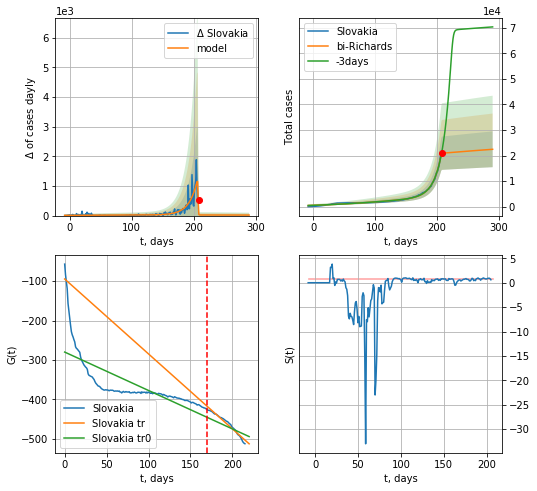

Slovakia data at: 2020-10-12
+3 day model MAPE: 0.087520
model: bi-Richards
coeffs: [1.69487765e+04 7.60527175e-02 2.07315217e+02 5.11834748e+01]
rational stdev: 0.311832
forecast at the end of period: +82 days
	 deltaDaycases: 17
	 total cases: 22441 ± 6997
	 total death: 67 ± 62
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.558143
 intercept: -279.993929
 slope: -0.975532
trend coefficient of determination: 0.962401
 intercept: -94.429573
 slope: -1.902537


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp


In [383]:
vL = 170
x = forecastRR("Slovakia",dfSL[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Slovakia",dfSL[:],d12f(1),40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

In [3925]:
#x = forecastRRR("Slovakia",dfSL[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)

SV
           date   cases  active  death
218 2020-10-09  7872.0  2865.0  165.0
219 2020-10-10  8252.0  3061.0  167.0
220 2020-10-11  8663.0  3314.0  167.0
221 2020-10-12  8832.0  3444.0  169.0
222 2020-10-13  9231.0  3744.0  173.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


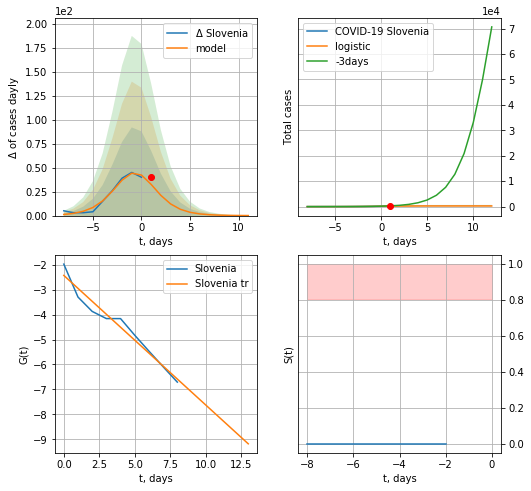

Slovenia data at: 2020-10-13
model: logistic
coeffs:  [ 2.61098711e+02  6.91755378e-01 -2.00021247e-01]
rational stdev:  0.5312441686508605
forecast at the end of period: +11 days
	 deltaDaycases:  0
	 total cases:  261 ± 138
	 total death:  4 ± 6
trend coefficient of determination: 0.958485
 intercept: -2.427236
 slope: -0.519636


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


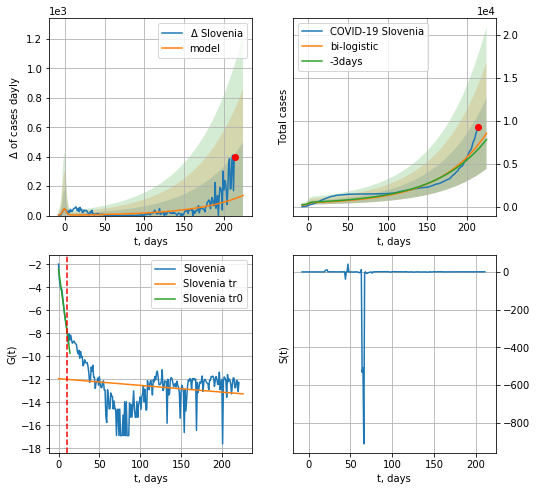

Slovenia data at: 2020-10-13
+3 day model MAPE: 0.07818579409020152
model: bi-logistic
coeffs:  [5.19862059e+07 1.66111525e-02 7.51449469e+02] [ 2.61098711e+02  6.91755378e-01 -2.00021247e-01]
scenario coeffs:  [0.25, 1.0, 3.0]
rational stdev:  0.48423312767792537
forecast at the end of period: +11 days
	 deltaDaycases:  136
	 total cases:  8539 ± 4135
	 total death:  160 ± 232
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.969651
 intercept: -2.421914
 slope: -0.521632
trend coefficient of determination: 0.036568
 intercept: -11.934739
 slope: -0.005853


In [724]:
dfSV = read_df(pd.DataFrame(),"SV").fillna(0)
try:
    x = forecast("Slovenia",dfSV[:10],d1,7*T18-dT,pMAPE=False)
    xx = forecast2("Slovenia",dfSV[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,3.],vL=10)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


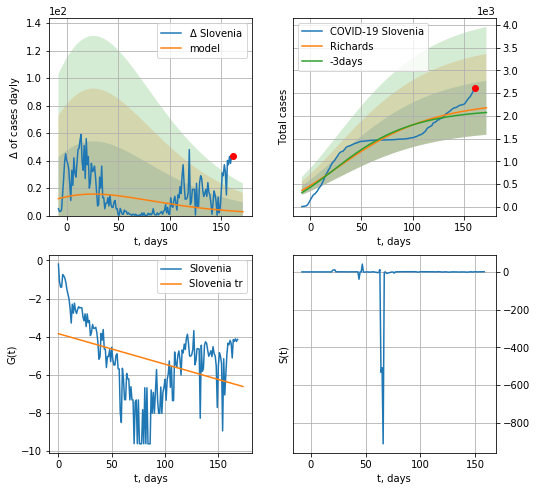

Slovenia data at: 2020-10-13
+3 day model MAPE: 0.044327
model: Richards
coeffs: [ 2.33554946e+03  3.46871169e+00 -2.60038273e+02  5.27582429e-03]
rational stdev: 0.272746
forecast at the end of period: +11 days
	 deltaDaycases: 2
	 total cases: 2178 ± 594
	 total death: 40 ± 32
trend coefficient of determination: 0.142556
 intercept: -3.849268
 slope: -0.016038


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


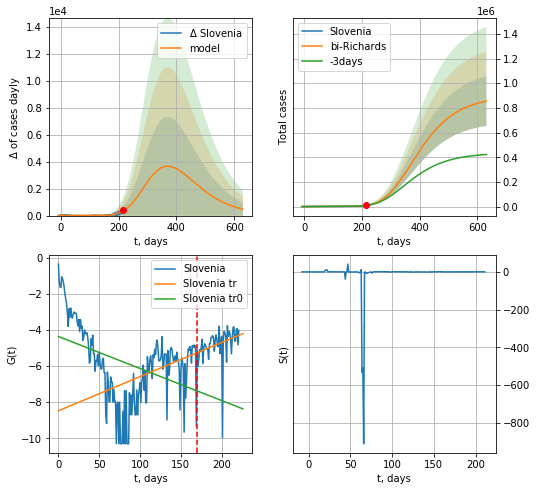

Slovenia data at: 2020-10-13
+3 day model MAPE: 0.020704
model: bi-Richards
coeffs: [8.93345896e+05 1.21038465e-01 1.70478792e+02 9.65976697e-02]
rational stdev: 0.234775
forecast at the end of period: +417 days
	 deltaDaycases: 473
	 total cases: 854340 ± 200578
	 total death: 16011 ± 11276
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.165689
 intercept: -4.362224
 slope: -0.017727
trend coefficient of determination: 0.097686
 intercept: -8.473935
 slope: 0.018901


In [725]:
vL = 170
x = forecastRR("Slovenia",dfSV[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Slovenia",dfSV[:],d12f(1),88*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

In [726]:
#print(koreaCoeffs)
#x = forecastRRR("Slovenia",dfSV[:10],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)
#xx = forecast2RRR("Slovenia",dfSV[:],d1,T18*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=10)

SB
           date  cases  active  death
213 2020-10-09  34517  2220.0  761.0
214 2020-10-10  34685  2387.0  762.0
215 2020-10-11  34787  2488.0  763.0
216 2020-10-12  34854  2553.0  765.0
217 2020-10-13  35006  2703.0  767.0


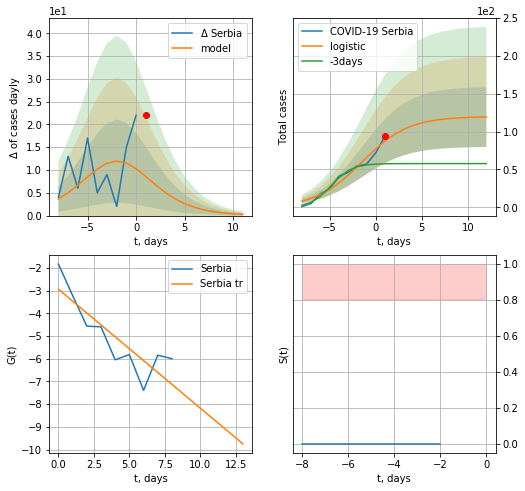

Serbia data at: 2020-10-13
model: logistic
coeffs:  [119.86808879   0.40041875  -1.48148474]
rational stdev:  0.33210329199703215
forecast at the end of period: +11 days
	 deltaDaycases:  0
	 total cases:  119 ± 39
	 total death:  2 ± 1
trend coefficient of determination: 0.723021
 intercept: -2.939233
 slope: -0.523684


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:195: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


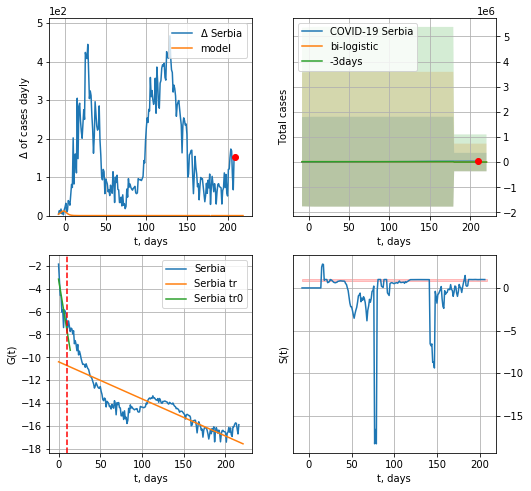

Serbia data at: 2020-10-13
+3 day model MAPE: 1.060734965885771e-10
model: bi-logistic
coeffs:  [14767.89619045   -94.86003454   179.51875093] [119.86808879   0.40041875  -1.48148474]
scenario coeffs:  [0.25, 1.0, 2.2]
rational stdev:  96.14081619727723
forecast at the end of period: +11 days
	 deltaDaycases:  0
	 total cases:  3811 ± 366473
	 total death:  83 ± 23939
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.680312
 intercept: -3.149496
 slope: -0.444835
trend coefficient of determination: 0.711095
 intercept: -10.391299
 slope: -0.032523


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:195: RuntimeWarning: overflow encountered in exp


In [727]:
dfSB = read_df(pd.DataFrame(),"SB")
dfSB = dfSB.fillna(0)
x = forecast("Serbia",dfSB[:10],d1,T18*7-dT,pMAPE=False)
xx = forecast2("Serbia",dfSB[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,2.2],vL=10)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


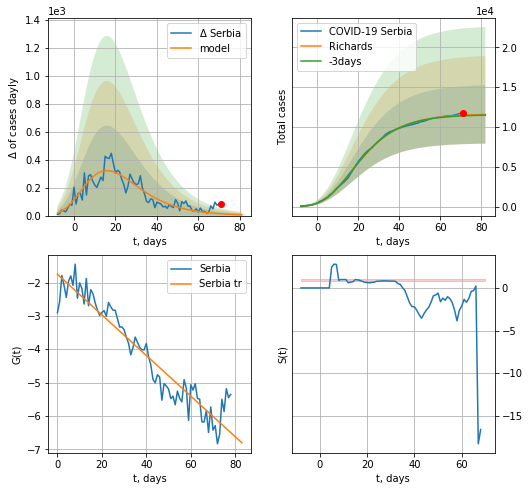

Serbia data at: 2020-10-13
+3 day model MAPE: 0.006988
model: Richards
coeffs: [ 1.16624341e+04  1.86550219e+00 -2.54632436e+01  4.09637438e-02]
rational stdev: 0.315870
forecast at the end of period: +11 days
	 deltaDaycases: 6
	 total cases: 11585 ± 3659
	 total death: 253 ± 239
trend coefficient of determination: 0.902509
 intercept: -1.751737
 slope: -0.060887


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


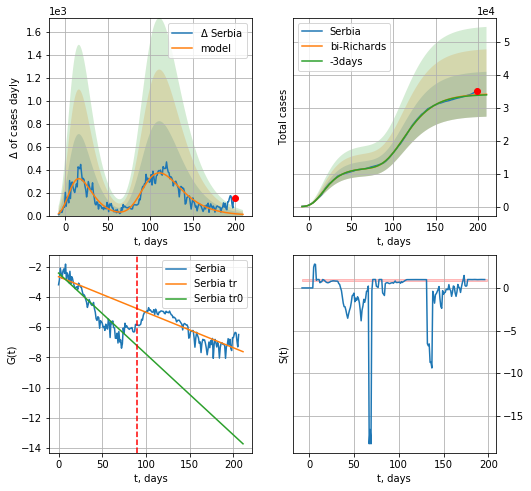

Serbia data at: 2020-10-13
+3 day model MAPE: 0.005093
model: bi-Richards
coeffs: [2.25892204e+04 4.66495545e-01 6.20546980e+01 1.00517095e-01]
rational stdev: 0.199676
forecast at the end of period: +11 days
	 deltaDaycases: 10
	 total cases: 34034 ± 6795
	 total death: 745 ± 446
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.853316
 intercept: -2.427331
 slope: -0.053498
trend coefficient of determination: 0.706564
 intercept: -2.665221
 slope: -0.023502


In [728]:
iL=10
vL=90+iL
x = forecastRR("Serbia",dfSB[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Serbia",dfSB[iL:],d1,30*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [729]:
#x = forecastRRR("Serbia",dfSB[:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs)

CT
           date    cases  active  death
223 2020-10-09  19932.0  2662.0  317.0
224 2020-10-10  20440.0  2818.0  324.0
225 2020-10-11  20621.0  2712.0  327.0
226 2020-10-12  20993.0  2774.0  330.0
227 2020-10-13  21741.0  3210.0  334.0


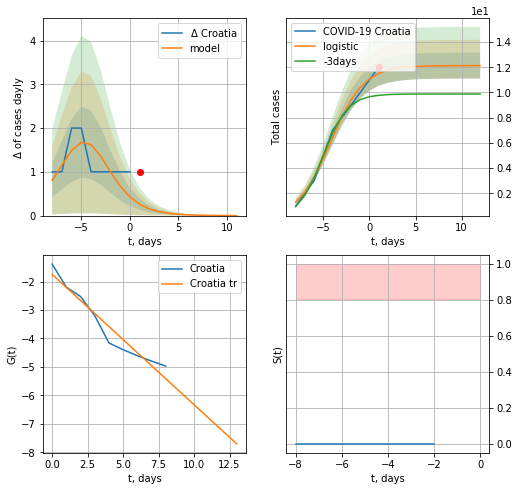

Croatia data at: 2020-10-13
model: logistic
coeffs:  [12.13023855  0.55939634 -4.20963748]
rational stdev:  0.08430442468045289
forecast at the end of period: +11 days
	 deltaDaycases:  0
	 total cases:  12 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.936719
 intercept: -1.749041
 slope: -0.458074


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


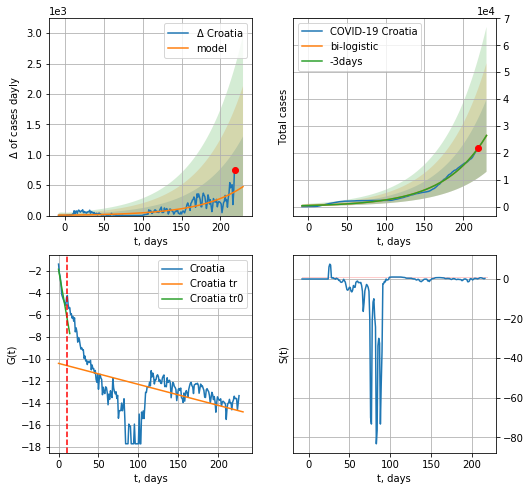

Croatia data at: 2020-10-13
+3 day model MAPE: 0.0016340487058580655
model: bi-logistic
coeffs:  [1.27540815e+07 1.82039930e-02 5.69340294e+02] [12.13023855  0.55939634 -4.20963748]
rational stdev:  0.5097185984632209
forecast at the end of period: +11 days
	 deltaDaycases:  475
	 total cases:  26433 ± 13473
	 total death:  415 ± 634
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.922384
 intercept: -1.856940
 slope: -0.417612
trend coefficient of determination: 0.214581
 intercept: -10.419394
 slope: -0.019107


In [779]:
try:
    dfCT = read_df(pd.DataFrame(),"CT")
    dfCT = dfCT.fillna(0)
    x = forecast("Croatia",dfCT[:10],d1,T18*7-dT,pMAPE=False)
    xx = forecast2("Croatia",dfCT[:],d1,T18*7-dT,x,addpred=False,xcoef=[0.25/2,1.,2.],vL=10)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


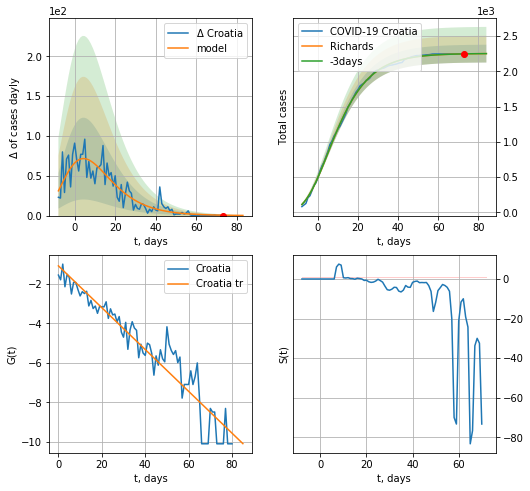

Croatia data at: 2020-10-13
+3 day model MAPE: 0.000062
model: Richards
coeffs: [ 2.25221314e+03  8.22861964e+00 -4.74876633e+01  1.05637631e-02]
rational stdev: 0.056077
forecast at the end of period: +11 days
	 deltaDaycases: 0
	 total cases: 2249 ± 126
	 total death: 35 ± 5
trend coefficient of determination: 0.906222
 intercept: -1.091343
 slope: -0.105900


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


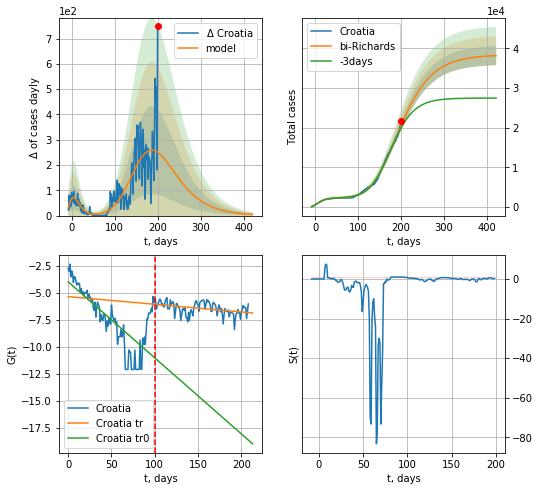

Croatia data at: 2020-10-13
+3 day model MAPE: 0.034673
model: bi-Richards
coeffs: [3.61486377e+04 8.23541889e-02 1.27166711e+02 2.67473798e-01]
rational stdev: 0.063312
forecast at the end of period: +221 days
	 deltaDaycases: 4
	 total cases: 38197 ± 2418
	 total death: 600 ± 113
bi-Richards approximation splitting point: 100
trend coefficient of determination: 0.566786
 intercept: -4.004662
 slope: -0.070132
trend coefficient of determination: 0.151433
 intercept: -5.368564
 slope: -0.007080


In [780]:
iL = 18
vL = 100+iL
x = forecastRR("Croatia",dfCT[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Croatia",dfCT[iL:],d12f(1),60*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [4311]:
#x = forecastRRR("Croatia",dfCT[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)

EG
           date   cases  active   death
217 2020-10-09  104262     641  6029.0
218 2020-10-10  104387     704  6040.0
219 2020-10-11  104516     776  6052.0
220 2020-10-12  104648     843  6062.0
221 2020-10-13  104787     875  6071.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


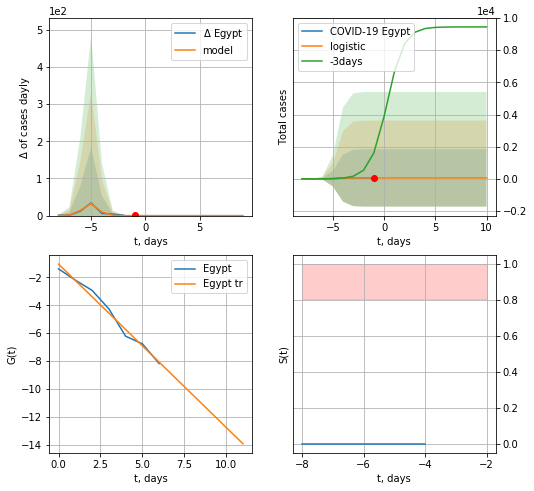

Egypt data at: 2020-10-13
+3 day model MAPE: 0.9848539099062313
model: logistic
coeffs:  [58.57021122  2.53530653 -4.60228222]
rational stdev:  30.428321363178444
forecast at the end of period: +11 days
	 deltaDaycases:  0
	 total cases:  58 ± 1782
	 total death:  3 ± 273
trend coefficient of determination: 0.982412
 intercept: -1.045837
 slope: -1.172929


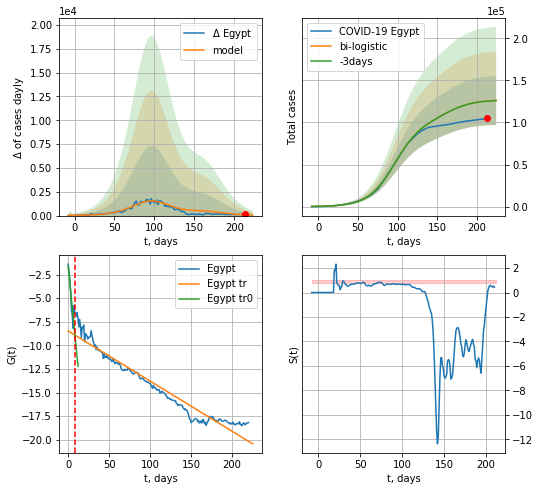

Egypt data at: 2020-10-13
+3 day model MAPE: 0.0015371867150760486
model: bi-logistic
coeffs:  [1.01507877e+05 5.98555820e-02 9.63529110e+01] [58.57021122  2.53530653 -4.60228222]
scenario coeffs:  [0.25, 1.0, 1.7]
rational stdev:  0.23080716932399492
forecast at the end of period: +11 days
	 deltaDaycases:  43
	 total cases:  126221 ± 29132
	 total death:  7312 ± 5062
bi-logistic approximation splitting point: 8
trend0 coefficient of determination: 0.807637
 intercept: -1.627174
 slope: -0.882261
trend coefficient of determination: 0.940104
 intercept: -8.472573
 slope: -0.053179


In [731]:
dfEG = read_df(pd.DataFrame(),"EG")
x = forecast("Egypt",dfEG[:8],d1,7*T18-dT)
xx = forecast2("Egypt",dfEG[:],d1,30*7-dT,x,addpred=True,xcoef=[0.25,1.,1.7],vL=8)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


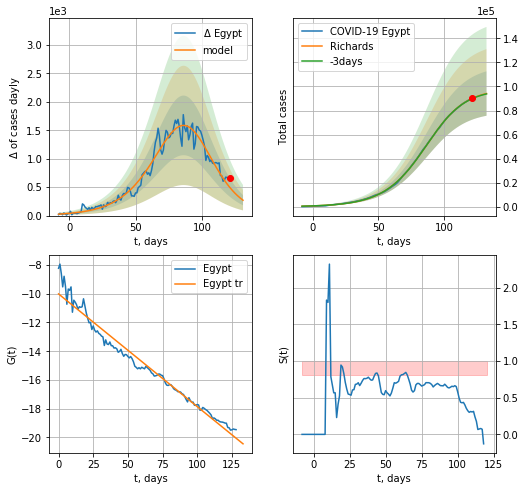

Egypt data at: 2020-10-13
+3 day model MAPE: 0.002349
model: Richards
coeffs: [9.80452652e+04 5.49784423e-02 9.01515288e+01 1.27472002e+00]
rational stdev: 0.196169
forecast at the end of period: +11 days
	 deltaDaycases: 270
	 total cases: 94135 ± 18466
	 total death: 5453 ± 3209
trend coefficient of determination: 0.969341
 intercept: -10.012670
 slope: -0.078415


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in power


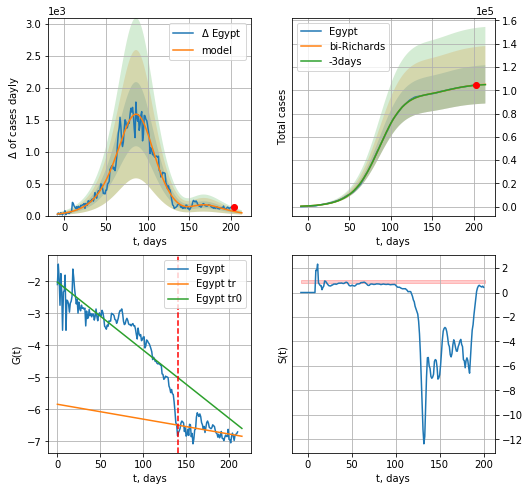

Egypt data at: 2020-10-13
+3 day model MAPE: 0.001520
model: bi-Richards
coeffs: [7.89529141e+03 7.34479435e+00 7.49719512e+01 6.99896612e-03]
rational stdev: 0.156586
forecast at the end of period: +11 days
	 deltaDaycases: 42
	 total cases: 105087 ± 16455
	 total death: 6088 ± 2859
bi-Richards approximation splitting point: 140
trend coefficient of determination: 0.794518
 intercept: -2.022086
 slope: -0.021272
trend coefficient of determination: 0.180484
 intercept: -5.840190
 slope: -0.004652


In [732]:
iL = 10
vL = 140+iL
x = forecastRR("Egypt",dfEG[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Egypt",dfEG[iL:],d1,T18*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [733]:
#x = forecastRRR("Egypt",dfEG[12:],d1,85*7-dT,addpred=True,xcoef=koreaCoeffs)

IQ
           date   cases   active   death
220 2020-10-09  397780  59948.0  9735.0
221 2020-10-10  400124  58004.0  9790.0
222 2020-10-11  402330  56321.0  9852.0
223 2020-10-12  405437  55475.0  9912.0
224 2020-10-13  409358  55180.0  9970.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


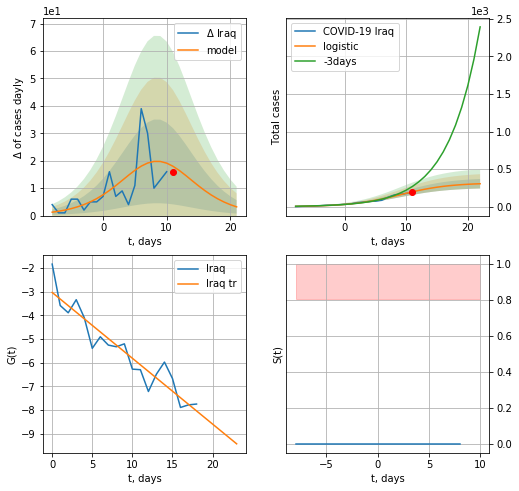

Iraq data at: 2020-10-13
+3 day model MAPE: 0.34474037669474106
model: logistic
coeffs:  [3.17081296e+02 2.50431387e-01 8.98163530e+00]
rational stdev:  0.20777406895257303
forecast at the end of period: +11 days
	 deltaDaycases:  3
	 total cases:  305 ± 63
	 total death:  7 ± 4
trend coefficient of determination: 0.889033
 intercept: -3.031672
 slope: -0.278416


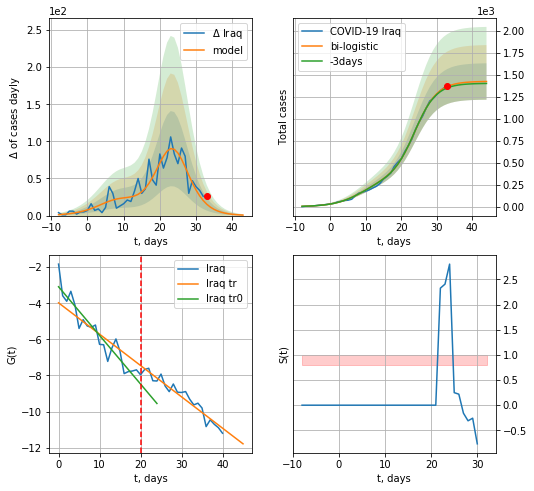

Iraq data at: 2020-10-13
+3 day model MAPE: 0.012548655608678476
model: bi-logistic
coeffs:  [1.10877596e+03 3.20225975e-01 2.39035989e+01] [3.17081296e+02 2.50431387e-01 8.98163530e+00]
rational stdev:  0.14537179336300032
forecast at the end of period: +11 days
	 deltaDaycases:  0
	 total cases:  1424 ± 207
	 total death:  34 ± 14
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.891989
 intercept: -3.086027
 slope: -0.269357
trend coefficient of determination: 0.928562
 intercept: -3.976586
 slope: -0.173518


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:353: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


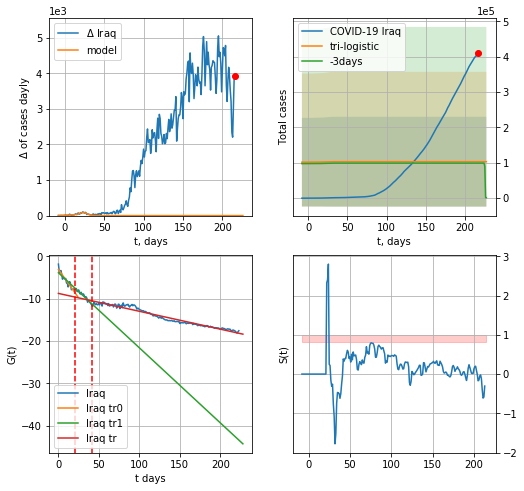

Iraq data at: 2020-10-13
+3 day model MAPE: 0.04124615360673196
model: tri-logistic
coeffs:  [ 1.01773397e+05 -9.45459876e+00  2.33918466e+02] [3.17081296e+02 2.50431387e-01 8.98163530e+00 1.10877596e+03
 3.20225975e-01 2.39035989e+01]
forecast rational stdev:  1.230634889143009
forecast at the end of period: +11 days
	 deltaDaycases:  0
	 total cases:  103199 ± 127000
	 total death:  2513 ± 9277
tri-logistic approximation splitting points: 20,42
trend0 coefficient of determination: 0.891989
 intercept: -3.086027
 slope: -0.269357
trend1 coefficient of determination: 0.937217
 intercept: -3.879636
 slope: -0.177153
trend coefficient of determination: 0.958500
 intercept: -8.751215
 slope: -0.042192


In [734]:
vL=20
vL1=42
dfIQ = read_df(pd.DataFrame(),"IQ")
dfIQ = dfIQ.fillna(0)
x = forecast("Iraq",dfIQ[:vL],d1,T18*7-dT)
xx = forecast2("Iraq",dfIQ[:vL1],d1,T18*7-dT,x,addpred=False,xcoef=[0.25,1.,2.],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Iraq",dfIQ[:],d1,T18*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


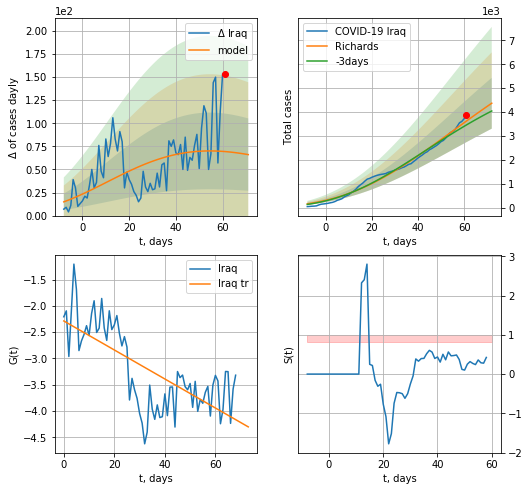

Iraq data at: 2020-10-13
+3 day model MAPE: 0.049876
model: Richards
coeffs: [ 8.66913850e+03  2.11659471e+00 -1.51652885e+02  1.04324891e-02]
rational stdev: 0.242987
forecast at the end of period: +11 days
	 deltaDaycases: 66
	 total cases: 4372 ± 1062
	 total death: 106 ± 77
trend coefficient of determination: 0.498225
 intercept: -2.287589
 slope: -0.027573


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


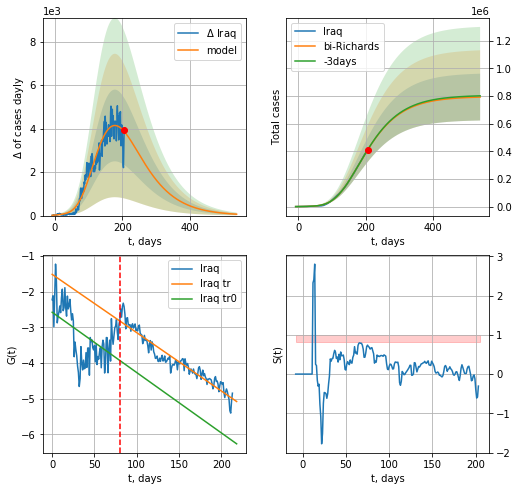

Iraq data at: 2020-10-13
+3 day model MAPE: 0.002352
model: bi-Richards
coeffs: [ 7.87643675e+05  9.50296257e-01 -1.13240923e+02  1.51297994e-02]
rational stdev: 0.213596
forecast at the end of period: +333 days
	 deltaDaycases: 63
	 total cases: 791921 ± 169151
	 total death: 19287 ± 12358
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.280300
 intercept: -2.577242
 slope: -0.016899
trend coefficient of determination: 0.916229
 intercept: -1.516641
 slope: -0.016331


In [735]:
iL = 10
vL=80+iL#25+10
x = forecastRR("Iraq",dfIQ[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Iraq",dfIQ[iL:],d1,76*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [736]:
#x = forecastRRR("Iraq",dfIQ[9:42],d1,T18*7-dT,addpred=False,xcoef=[0.35,.5,4.,1])
#xx = forecast2RRR("Iraq",dfIQ[9:],d1,24*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=42)

In [737]:
#len(dfAR)

AR
           date    cases   active   death
219 2020-10-09  52804.0  13948.0  1789.0
220 2020-10-10  52940.0  13975.0  1795.0
221 2020-10-11  53072.0  14101.0  1801.0
222 2020-10-12  53225.0  14034.0  1809.0
223 2020-10-13  53399.0  14089.0  1818.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


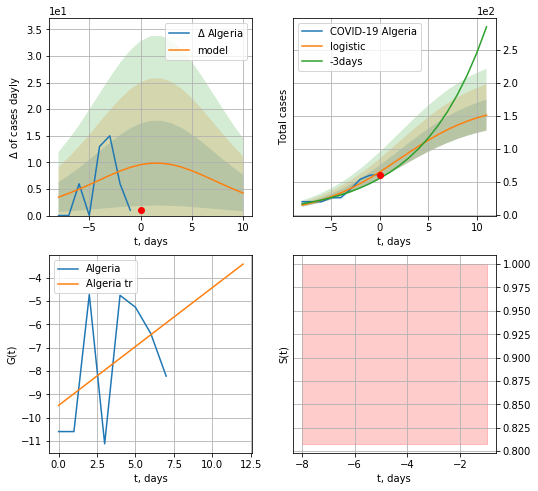

Algeria data at: 2020-10-13
+3 day model MAPE: 0.16392519582549905
model: logistic
coeffs:  [169.67149558   0.23328995   2.04236169]
rational stdev:  0.1546785167835457
forecast at the end of period: +11 days
	 deltaDaycases:  4
	 total cases:  150 ± 23
	 total death:  5 ± 2
trend coefficient of determination: 0.198482
 intercept: -9.477734
 slope: 0.504434


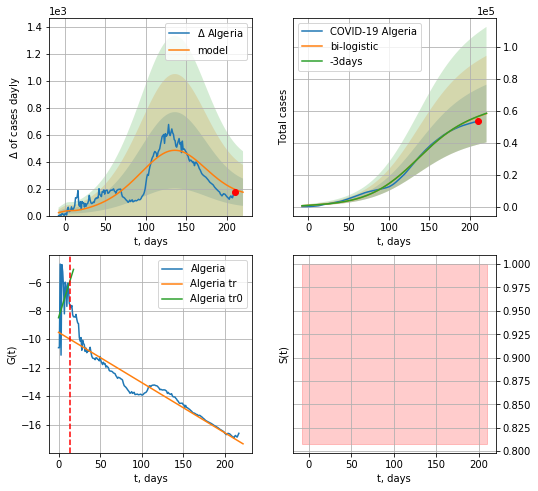

Algeria data at: 2020-10-13
+3 day model MAPE: 0.0028104355207719993
model: bi-logistic
coeffs:  [5.90841307e+04 3.23626997e-02 1.35506863e+02] [169.67149558   0.23328995   2.04236169]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.31015229230674984
forecast at the end of period: +11 days
	 deltaDaycases:  173
	 total cases:  58202 ± 18051
	 total death:  1981 ± 1843
bi-logistic approximation splitting point: 14
trend0 coefficient of determination: 0.134003
 intercept: -8.492024
 slope: 0.188486
trend coefficient of determination: 0.913962
 intercept: -9.519934
 slope: -0.035273


In [738]:
dfAR = read_df(pd.DataFrame(),"AR")
x = forecast("Algeria",dfAR[5:14],d1,7*T18-dT)
xx = forecast2("Algeria",dfAR[5:],d1,7*T18-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=14)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


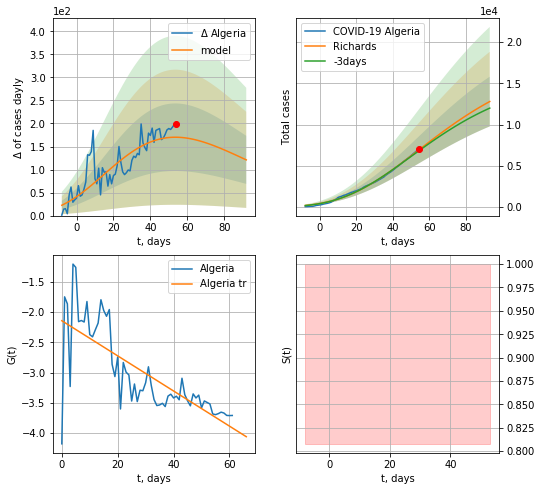

Algeria data at: 2020-10-13
+3 day model MAPE: 0.017361
model: Richards
coeffs: [ 1.86312269e+04  1.59750196e+00 -1.12063742e+02  1.56623086e-02]
rational stdev: 0.235608
forecast at the end of period: +39 days
	 deltaDaycases: 120
	 total cases: 12787 ± 3012
	 total death: 435 ± 307
trend coefficient of determination: 0.563244
 intercept: -2.140644
 slope: -0.029042


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


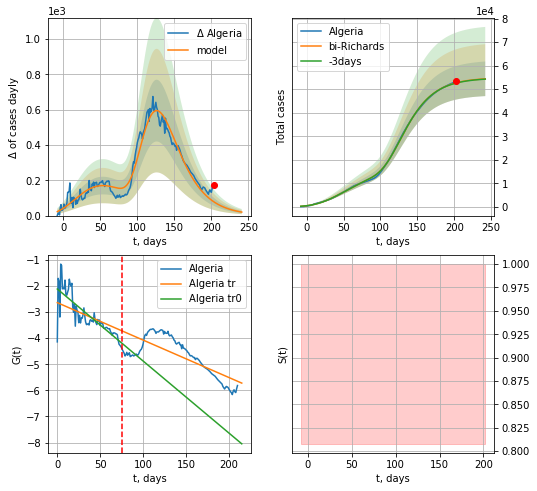

Algeria data at: 2020-10-13
+3 day model MAPE: 0.001960
model: bi-Richards
coeffs: [3.63465905e+04 4.88576026e+00 7.78569768e+00 8.17343944e-03]
rational stdev: 0.135196
forecast at the end of period: +39 days
	 deltaDaycases: 19
	 total cases: 54426 ± 7358
	 total death: 1852 ± 751
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.668813
 intercept: -2.120684
 slope: -0.027563
trend coefficient of determination: 0.574567
 intercept: -2.643407
 slope: -0.014323


In [739]:
vL = 75+12
x = forecastRR("Algeria",dfAR[12:vL-12],d1,34*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Algeria",dfAR[12:],d1,34*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12)

In [740]:
#x = forecastRRR("Algeria",dfAR[12:],d1,48*7-dT,addpred=True,xcoef=koreaCoeffs)

CP
           date   cases  active  death
211 2020-10-09  1951.0   557.0   25.0
212 2020-10-10  1986.0   517.0   25.0
213 2020-10-11  2006.0   537.0   25.0
214 2020-10-12  2047.0   578.0   25.0
215 2020-10-13  2130.0   661.0   25.0


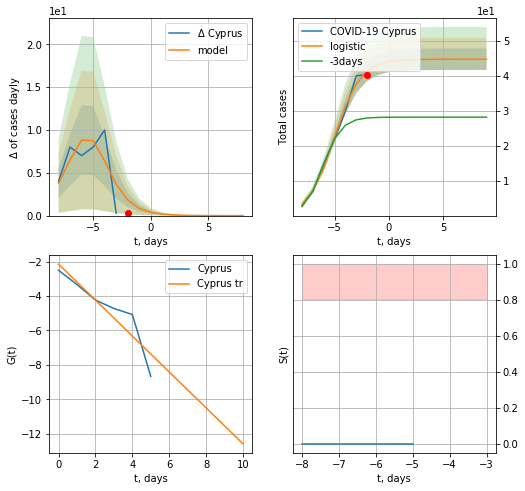

Cyprus data at: 2020-10-13
+3 day model MAPE: 0.5347775670777937
model: logistic
coeffs:  [44.71273924  0.83168064 -5.024159  ]
rational stdev:  0.06852146203610965
forecast at the end of period: +11 days
	 deltaDaycases:  0
	 total cases:  44 ± 3
	 total death:  0 ± 0
trend coefficient of determination: 0.837222
 intercept: -2.149855
 slope: -1.042802


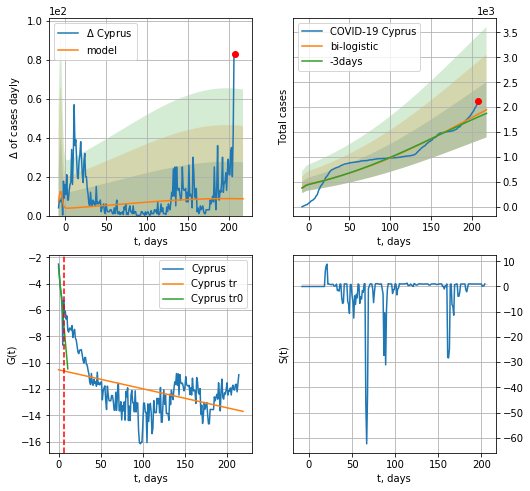

Cyprus data at: 2020-10-13
+3 day model MAPE: 0.03134984804934308
model: bi-logistic
coeffs:  [3.45790569e+03 1.01152074e-02 1.97974504e+02] [44.71273924  0.83168064 -5.024159  ]
rational stdev:  0.28470622991885414
forecast at the end of period: +11 days
	 deltaDaycases:  8
	 total cases:  1948 ± 554
	 total death:  22 ± 18
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.605369
 intercept: -2.714226
 slope: -0.704180
trend coefficient of determination: 0.206934
 intercept: -10.532846
 slope: -0.014441


In [741]:
try:
    dfCP = read_df(pd.DataFrame(),"CP")
    dfCP = dfCP.fillna(0)
    x = forecast("Cyprus",dfCP[:7],d1,7*T18-dT)
    xx = forecast2("Cyprus",dfCP[:],d1,T18*7-dT,x,addpred=False,xcoef=[0.25,1.,2.3],vL=7)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


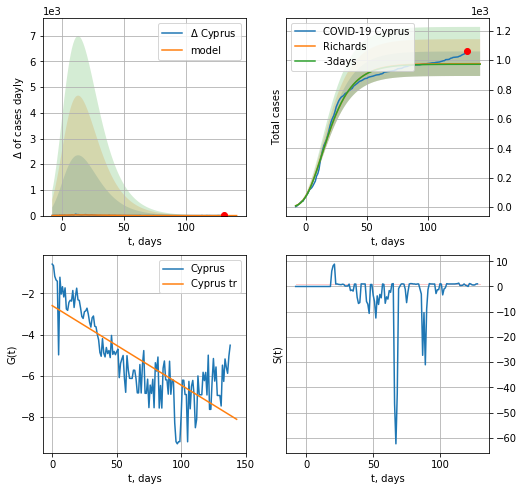

Cyprus data at: 2020-10-13
+3 day model MAPE: 0.003899
model: Richards
coeffs: [ 9.76316968e+02  1.29526584e+01 -5.80116939e+01  5.60254248e-03]
rational stdev: 0.085570
forecast at the end of period: +11 days
	 deltaDaycases: 0
	 total cases: 976 ± 83
	 total death: 11 ± 2
trend coefficient of determination: 0.611365
 intercept: -2.592811
 slope: -0.038703


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


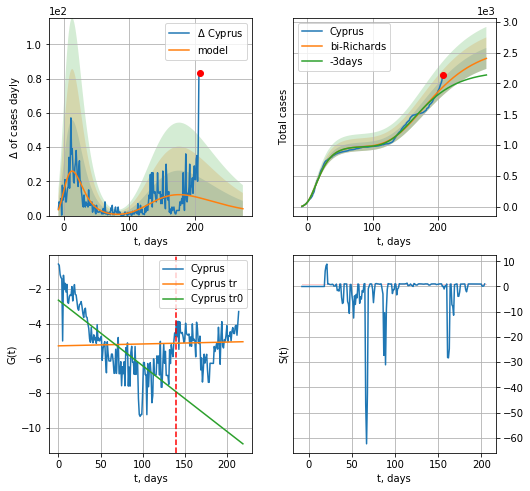

Cyprus data at: 2020-10-13
+3 day model MAPE: 0.036974
model: bi-Richards
coeffs: [ 1.63683044e+03  2.64449934e+00 -6.25457330e+01  7.70454150e-03]
rational stdev: 0.070779
forecast at the end of period: +67 days
	 deltaDaycases: 4
	 total cases: 2404 ± 170
	 total death: 28 ± 5
bi-Richards approximation splitting point: 140
trend coefficient of determination: 0.592948
 intercept: -2.649533
 slope: -0.037746
trend coefficient of determination: 0.000671
 intercept: -5.277678
 slope: 0.001080


In [742]:
iL = 0
vL=140+iL
x = forecastRR("Cyprus",dfCP[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
x = forecast2RR("Cyprus",dfCP[iL:],d1,38*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [743]:
#vL=33
#x = forecastRRR("Cyprus",dfCP[:],d1,T18*7-dT,addpred=False,xcoef=koreaCoeffs)
#xx = forecast2RRR("Cyprus",dfCP[:],d1,20*7-dT,x,addpred=True,xcoef=[0.35,.5,4,1],vL=vL)

PU
           date   cases   active    death
216 2020-10-09  843355  77197.0  33158.0
217 2020-10-10  846088  74676.0  33223.0
218 2020-10-11  849371  72097.0  33305.0
219 2020-10-12  851171  69717.0  33357.0
220 2020-10-13  853974  66596.0  33419.0


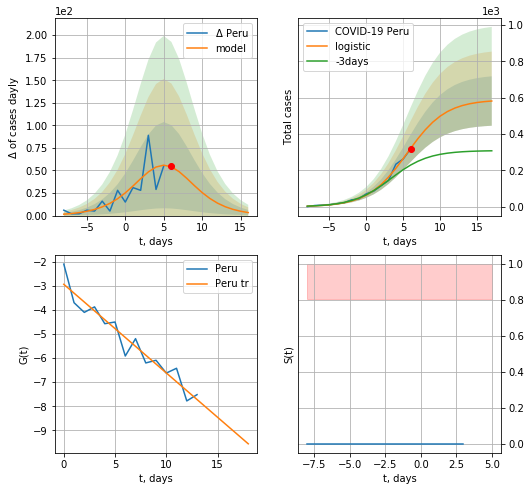

Peru data at: 2020-10-13
+3 day model MAPE: 0.4976759510371563
model: logistic
coeffs:  [5.88914141e+02 3.80777382e-01 5.52424877e+00]
rational stdev:  0.23355774891059702
forecast at the end of period: +11 days
	 deltaDaycases:  3
	 total cases:  581 ± 135
	 total death:  22 ± 15
trend coefficient of determination: 0.924015
 intercept: -2.937528
 slope: -0.367722


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


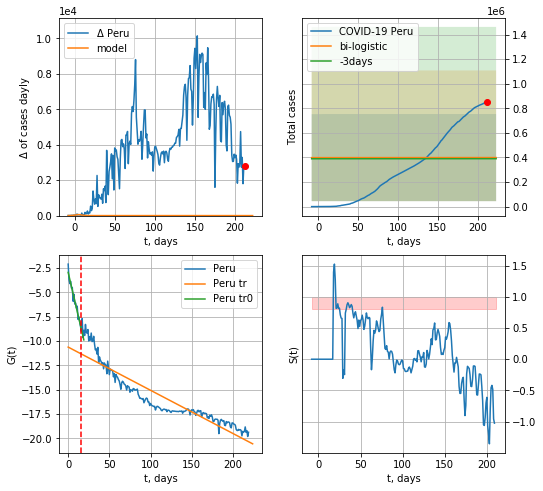

Peru data at: 2020-10-13
+3 day model MAPE: 0.02347280849888015
model: bi-logistic
coeffs:  [ 3.18810577e+05 -3.66437012e+01  8.77101517e+02] [5.88914141e+02 3.80777382e-01 5.52424877e+00]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.8883205671049385
forecast at the end of period: +11 days
	 deltaDaycases:  0
	 total cases:  399102 ± 354530
	 total death:  15618 ± 41621
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.936345
 intercept: -2.948740
 slope: -0.365135
trend coefficient of determination: 0.850862
 intercept: -10.625148
 slope: -0.044361


In [744]:
dfPU = read_df(pd.DataFrame(),"PU")
dfPU = dfPU.fillna(0)
x = forecast("Peru",dfPU[:15],d1,7*T18-dT)
xx = forecast2("Peru",dfPU[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=15)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


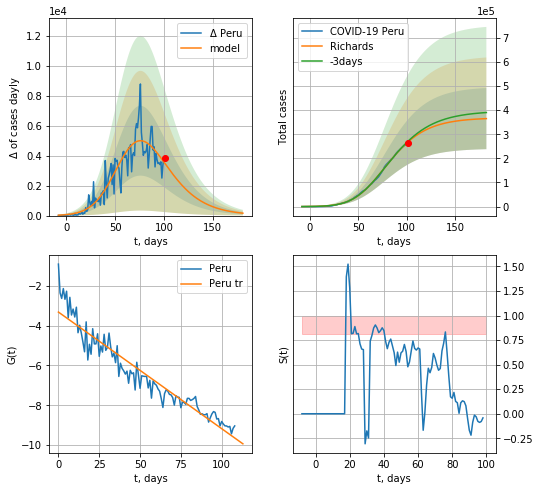

Peru data at: 2020-10-13
+3 day model MAPE: 0.011915
model: Richards
coeffs: [3.68474787e+05 1.13868989e-01 5.48653842e+01 3.85481107e-01]
rational stdev: 0.347400
forecast at the end of period: +81 days
	 deltaDaycases: 159
	 total cases: 364894 ± 126764
	 total death: 14279 ± 14881
trend coefficient of determination: 0.910589
 intercept: -3.314617
 slope: -0.058598


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


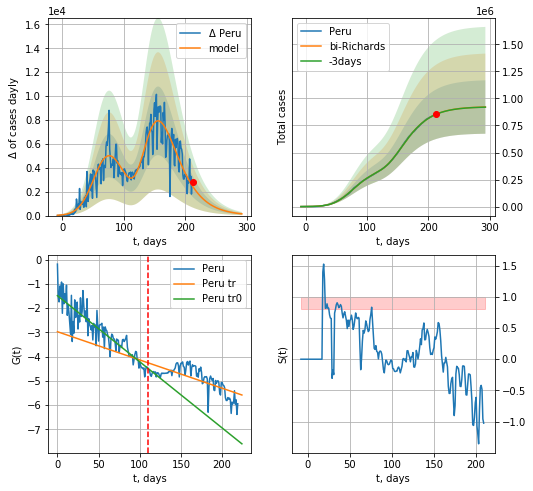

Peru data at: 2020-10-13
+3 day model MAPE: 0.000570
model: bi-Richards
coeffs: [5.56239945e+05 2.25791541e+00 4.62641056e+01 1.63075492e-02]
rational stdev: 0.268151
forecast at the end of period: +81 days
	 deltaDaycases: 145
	 total cases: 920834 ± 246923
	 total death: 36035 ± 28988
bi-Richards approximation splitting point: 110
trend coefficient of determination: 0.807066
 intercept: -1.486006
 slope: -0.027256
trend coefficient of determination: 0.507900
 intercept: -2.971159
 slope: -0.011644


In [745]:
vL = 110
x = forecastRR("Peru",dfPU[:vL],d1,40*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Peru",dfPU[:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastQR("Peru",dfPU[:],d1,36*7-dT)

In [746]:
#x = forecastRRR("Peru",dfPU[:].fillna(0),d1,62*7-dT,addpred=True,xcoef=koreaCoeffs)

ID
           date    cases    active     death
223 2020-10-09  6979423  883151.0  107450.0
224 2020-10-10  7053806  867459.0  108371.0
225 2020-10-11  7120538  861819.0  109184.0
226 2020-10-12  7177783  840571.0  109917.0
227 2020-10-13  7239389  826845.0  110617.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


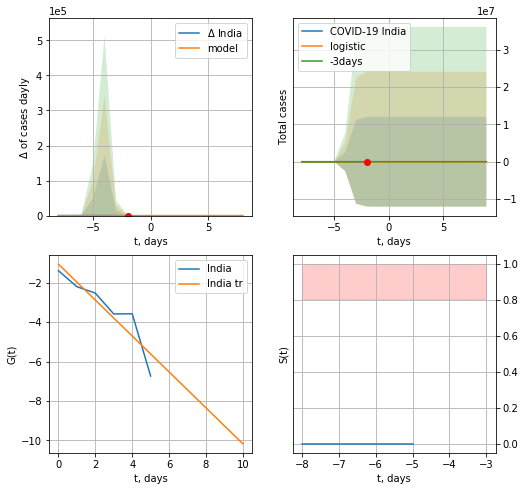

India data at: 2020-10-13
+3 day model MAPE: 0.19486002826260063
model: logistic
coeffs:  [29.4003363   4.01436821 -3.67575825]
rational stdev:  409417.6299021335
forecast at the end of period: +11 days
	 deltaDaycases:  0
	 total cases:  29 ± 12037016
	 total death:  0 ± 0
trend coefficient of determination: 0.835838
 intercept: -1.052904
 slope: -0.912220


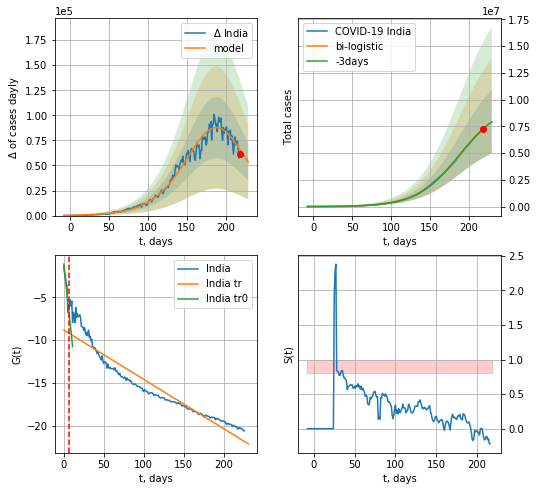

India data at: 2020-10-13
+3 day model MAPE: 0.0004816265919351188
model: bi-logistic
coeffs:  [9.58549195e+06 3.64638859e-02 1.88139872e+02] [29.4003363   4.01436821 -3.67575825]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.3730812703329783
forecast at the end of period: +11 days
	 deltaDaycases:  53434
	 total cases:  7919031 ± 2954442
	 total death:  121001 ± 135429
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.879788
 intercept: -1.115653
 slope: -0.874570
trend coefficient of determination: 0.908254
 intercept: -8.822007
 slope: -0.057551


In [747]:
dfID = read_df(pd.DataFrame(),"ID")
dfID = dfID.fillna(0)
x = forecast("India",dfID[:7],d1,7*T18-dT)
xx = forecast2("India",dfID[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=7)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


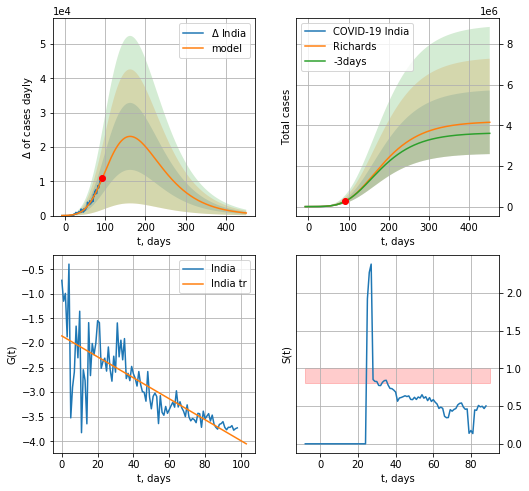

India data at: 2020-10-13
+3 day model MAPE: 0.006994
model: Richards
coeffs: [ 4.19766377e+06  3.32044249e-01 -3.85411502e+01  4.61089241e-02]
rational stdev: 0.377105
forecast at the end of period: +361 days
	 deltaDaycases: 759
	 total cases: 4148135 ± 1564282
	 total death: 63383 ± 71706
trend coefficient of determination: 0.633758
 intercept: -1.855387
 slope: -0.021306


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


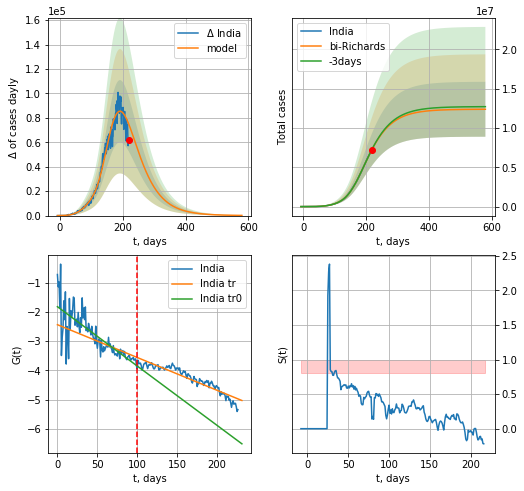

India data at: 2020-10-13
+3 day model MAPE: 0.004097
model: bi-Richards
coeffs: [8.20097232e+06 5.97635720e-01 4.29047223e+01 3.63769030e-02]
rational stdev: 0.282025
forecast at the end of period: +361 days
	 deltaDaycases: 150
	 total cases: 12389706 ± 3494202
	 total death: 189313 ± 160172
bi-Richards approximation splitting point: 100
trend coefficient of determination: 0.619740
 intercept: -1.819224
 slope: -0.020311
trend coefficient of determination: 0.877055
 intercept: -2.435015
 slope: -0.011228


In [748]:
vL = 100
x = forecastRR("India",dfID[:vL],d1,80*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("India",dfID[:],d1,80*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

In [749]:
#x = forecastRRR("India",dfID[31:].fillna(0),d1,86*7-dT,addpred=True,xcoef=koreaCoeffs)

AG
           date     cases    active    death
219 2020-10-09  871468.0  151102.0  23225.0
220 2020-10-10  883882.0  150837.0  23581.0
221 2020-10-11  894206.0  148958.0  23868.0
222 2020-10-12  903730.0  146962.0  24186.0
223 2020-10-13  917035.0  150228.0  24572.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


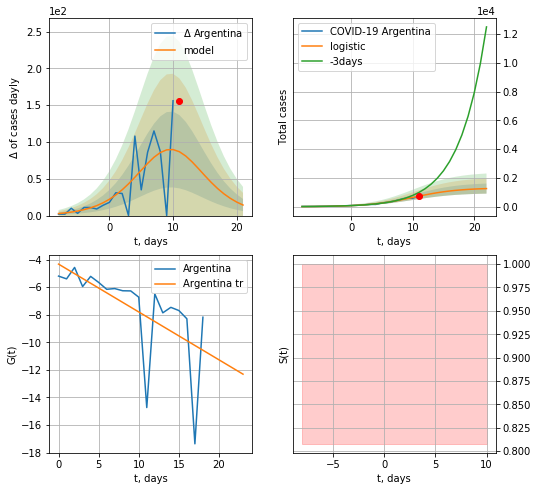

Argentina data at: 2020-10-13
+3 day model MAPE: 0.34277903234874524
model: logistic
coeffs:  [1.30607345e+03 2.75914265e-01 1.01155997e+01]
rational stdev:  0.27772613105407934
forecast at the end of period: +11 days
	 deltaDaycases:  14
	 total cases:  1258 ± 349
	 total death:  33 ± 27
trend coefficient of determination: 0.364190
 intercept: -4.325611
 slope: -0.347113


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


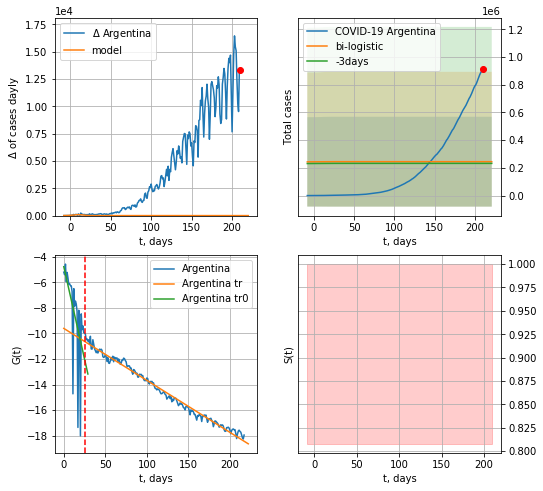

Argentina data at: 2020-10-13
+3 day model MAPE: 0.05295810856226095
model: bi-logistic
coeffs:  [ 1.94732615e+05 -1.63015756e+01  3.95343841e+02] [1.30607345e+03 2.75914265e-01 1.01155997e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  1.325336968859377
forecast at the end of period: +11 days
	 deltaDaycases:  0
	 total cases:  244721 ± 324338
	 total death:  6557 ± 26070
bi-logistic approximation splitting point: 25
trend0 coefficient of determination: 0.360462
 intercept: -4.766843
 slope: -0.290012
trend coefficient of determination: 0.986080
 intercept: -9.603205
 slope: -0.040739


In [750]:
vL = 25
#vL1 = 40
dfAG = read_df(pd.DataFrame(),"AG")
x = forecast('Argentina',dfAG[5:vL],d1,7*T18-dT,1.0)
xx = forecast2('Argentina',dfAG[5:],d1,T18*7-dT,x,1.0,vL=vL,addpred=True,xcoef=[.25,1.,2.0])
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Argentina",dfAG[5:],d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

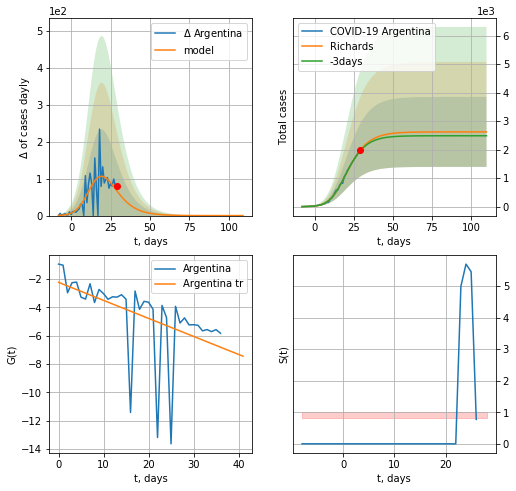

Argentina data at: 2020-10-13
+3 day model MAPE: 0.013138
model: Richards
coeffs: [2.62031767e+03 3.73237042e-01 1.15845098e+01 3.46306086e-01]
rational stdev: 0.468281
forecast at the end of period: +81 days
	 deltaDaycases: 0
	 total cases: 2620 ± 1227
	 total death: 70 ± 98
trend coefficient of determination: 0.244505
 intercept: -2.222432
 slope: -0.127357


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


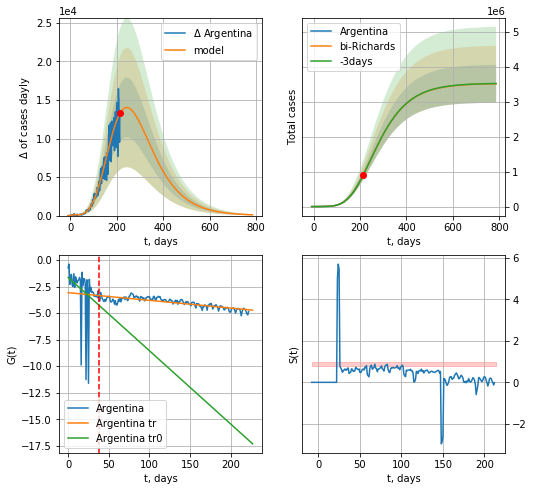

Argentina data at: 2020-10-13
+3 day model MAPE: 0.000285
model: bi-Richards
coeffs: [ 3.51930741e+06  2.47980765e-01 -3.62478381e+01  4.46456548e-02]
rational stdev: 0.154237
forecast at the end of period: +571 days
	 deltaDaycases: 97
	 total cases: 3513165 ± 541860
	 total death: 94135 ± 43557
bi-Richards approximation splitting point: 38
trend coefficient of determination: 0.093929
 intercept: -1.639595
 slope: -0.069067
trend coefficient of determination: 0.697336
 intercept: -3.070442
 slope: -0.007257


In [751]:
vL = 38
x = forecastRR('Argentina',dfAG[:vL].fillna(0),d1,40*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Argentina',dfAG[:].fillna(0),d1,110*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

In [752]:
#x = forecastRRR('Argentina',dfAG[10:],d1,104*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

In [753]:
#vL=33
#x = forecastRRR('Qatar',dfQR[:vL].fillna(0),d1,7*T18-dT,1.0,addpred=False,xcoef=[.35,.5,4.0,1])
#xx = forecast2RRR('Qatar',dfQR[:].fillna(0),d1,38*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

QR
           date   cases  active  death
218 2020-10-09  127600  2822.0  219.0
219 2020-10-10  127778  2792.0  219.0
220 2020-10-11  127985  2787.0  220.0
221 2020-10-12  128191  2795.0  220.0
222 2020-10-13  128405  2812.0  220.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


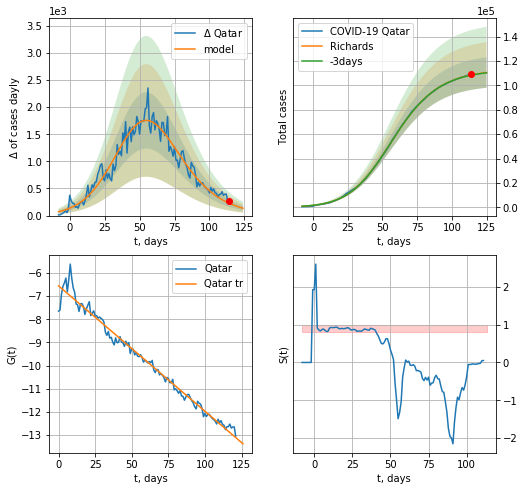

Qatar data at: 2020-10-13
+3 day model MAPE: 0.001883
model: Richards
coeffs: [1.13070089e+05 8.99170413e-02 4.60810469e+01 6.06536184e-01]
rational stdev: 0.112907
forecast at the end of period: +11 days
	 deltaDaycases: 136
	 total cases: 110595 ± 12486
	 total death: 189 ± 64
trend coefficient of determination: 0.979229
 intercept: -6.558422
 slope: -0.054146


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


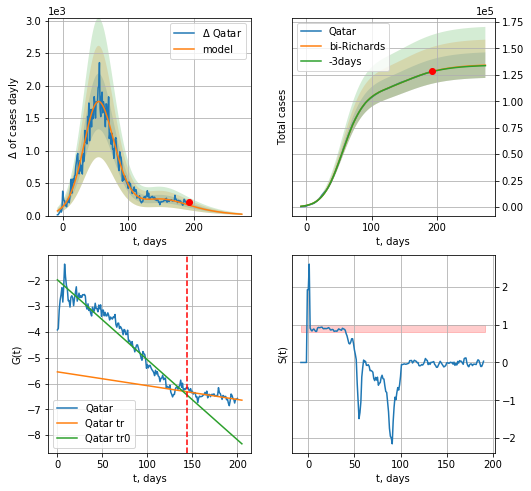

Qatar data at: 2020-10-13
+3 day model MAPE: 0.000989
model: bi-Richards
coeffs: [2.17118691e+04 1.88090357e+00 1.25405530e+01 1.52891648e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.089842
forecast at the end of period: +81 days
	 deltaDaycases: 21
	 total cases: 134024 ± 12041
	 total death: 229 ± 61
bi-Richards approximation splitting point: 144
trend coefficient of determination: 0.919822
 intercept: -1.979419
 slope: -0.031012
trend coefficient of determination: 0.365944
 intercept: -5.546970
 slope: -0.005355


In [754]:
iL = 21
vL = 144 + iL
dfQR = read_df(pd.DataFrame(),"QR")
x = forecastRR('Qatar',dfQR[iL:vL-iL].fillna(0),d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Qatar',dfQR[iL:].fillna(0),d1,40*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL-iL)

In [755]:
#x = forecast('Qatar',dfQR[:],d1,18*7-dT,1.0,addpred=True,xcoef=[.35,.5,4.0,1])

UAE
           date     cases  active  death
237 2020-10-09  104004.0    8659  442.0
238 2020-10-10  105133.0    8717  443.0
239 2020-10-11  106229.0    8500  445.0
240 2020-10-12  107293.0    8292  446.0
241 2020-10-13  108608.0    8153  448.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


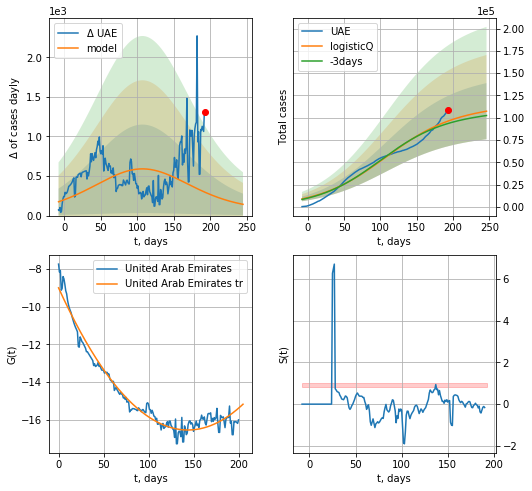

UAE data at: 2020-10-13
+3 day model MAPE: 0.029329
model: logisticQ
coeffs: [ 1.09342788e+05  3.91839705e-08  1.06856786e+02 -5.43476979e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.293622
forecast at the end of period: +53 days
	 deltaDaycases: 142
	 total cases: 107336 ± 31516
	 total death: 442 ± 389
trend coefficient of determination: 0.964933
 intercept_: -8.99279866155678
 coeffs_: [ 0.         -0.10511025  0.00036558]


In [756]:
try:
    dfUAE = read_df(pd.DataFrame(),"UAE")
    x = forecastRRR('UAE',dfUAE[40:],d1,36*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


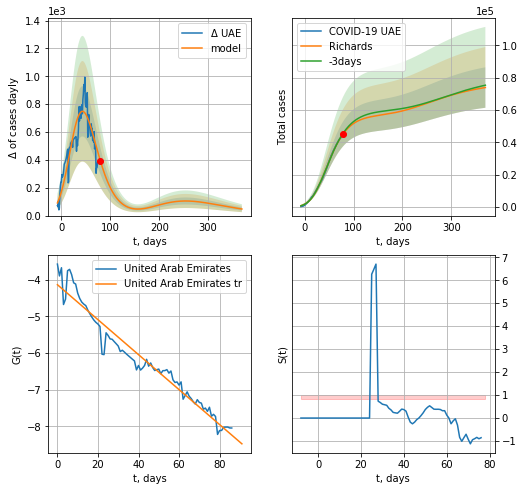

UAE data at: 2020-10-13
+3 day model MAPE: 0.009864
model: Richards
coeffs: [5.69575832e+04 1.33404785e-01 1.50634020e+01 3.08321872e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.168958
forecast at the end of period: +291 days
	 deltaDaycases: 47
	 total cases: 73883 ± 12483
	 total death: 304 ± 154
trend coefficient of determination: 0.950927
 intercept: -4.139656
 slope: -0.047646


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


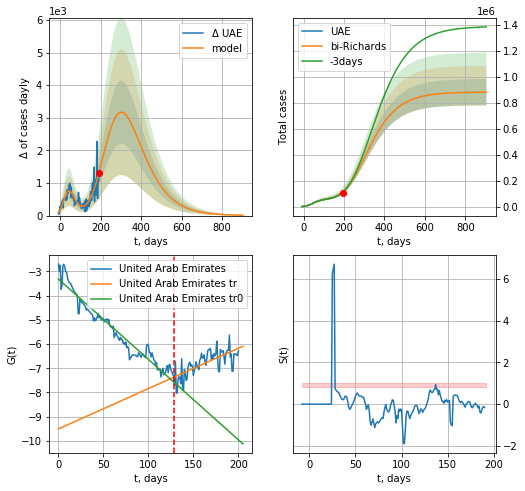

UAE data at: 2020-10-13
+3 day model MAPE: 0.005720
model: bi-Richards
coeffs: [8.24427401e+05 7.00075180e-02 1.41274833e+02 1.61141026e-01]
rational stdev: 0.114865
forecast at the end of period: +711 days
	 deltaDaycases: 10
	 total cases: 880447 ± 101132
	 total death: 3631 ± 1251
bi-Richards approximation splitting point: 128
trend coefficient of determination: 0.942446
 intercept: -3.312016
 slope: -0.033234
trend coefficient of determination: 0.489522
 intercept: -9.509470
 slope: 0.016678


In [757]:
iL = 40
vL = 128 + iL
x = forecastRR('UAE',dfUAE[iL:vL-iL],d1,70*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
xx = forecast2RR('UAE',dfUAE[iL:],d1,130*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)
#x = forecastQR('UAE',dfUAE[40:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

In [758]:
#plt.plot(range(len(dfUAE[45:])-1),np.log(np.log(np.log(np.diff(dfUAE[45:].cases)))))

In [759]:
dfSA = read_df(pd.DataFrame(),"SA")
#x = forecastRRR('Saudi Arabia',dfSA[:],d1,76*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

SA
           date     cases  active   death
220 2020-10-09  338539.0    9261  4996.0
221 2020-10-10  338944.0    9189  5018.0
222 2020-10-11  339267.0    8894  5043.0
223 2020-10-12  339615.0    8708  5068.0
224 2020-10-13  340089.0    8663  5087.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


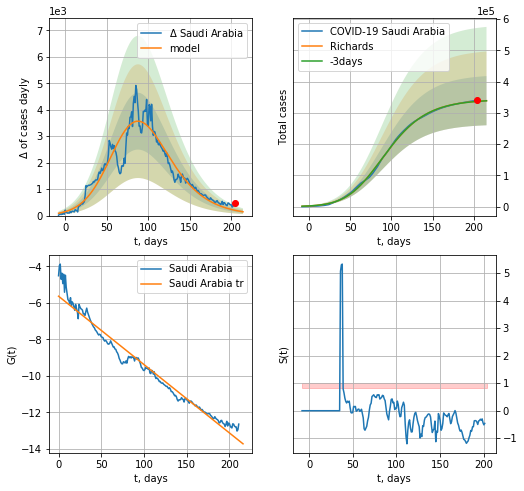

Saudi Arabia data at: 2020-10-13
+3 day model MAPE: 0.001106
model: Richards
coeffs: [3.42936206e+05 7.31143354e-02 6.67295599e+01 4.75981531e-01]
rational stdev: 0.232055
forecast at the end of period: +11 days
	 deltaDaycases: 143
	 total cases: 338835 ± 78628
	 total death: 5068 ± 3528
trend coefficient of determination: 0.966958
 intercept: -5.630850
 slope: -0.037435


In [760]:
x = forecastRR('Saudi Arabia',dfSA[12:],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
#xx = forecast2RR('Saudi Arabia',dfSA[12:],d1,27*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=75)
#x = forecastQR('Saudi Arabia',dfSA[12:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

Sri
           date   cases  active  death
213 2020-10-09  4523.0    1214   13.0
214 2020-10-10  4628.0    1309   13.0
215 2020-10-11  4752.0    1432   13.0
216 2020-10-12  4844.0    1514   13.0
217 2020-10-13  5038.0    1697   13.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


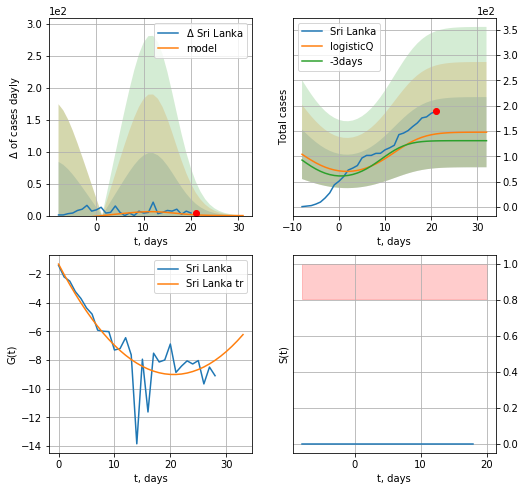

Sri Lanka data at: 2020-10-13
+3 day model MAPE: 0.111838
model: logisticQ
coeffs: [ 1.47873593e+02  1.02177717e-02  4.75700419e+00 -1.32326165e+00]
rational stdev: 0.468204
forecast at the end of period: +11 days
	 deltaDaycases: 0
	 total cases: 147 ± 69
	 total death: 0 ± 0
trend coefficient of determination: 0.737116
 intercept_: -1.300425972375204
 coeffs_: [ 0.         -0.74879164  0.01816974]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


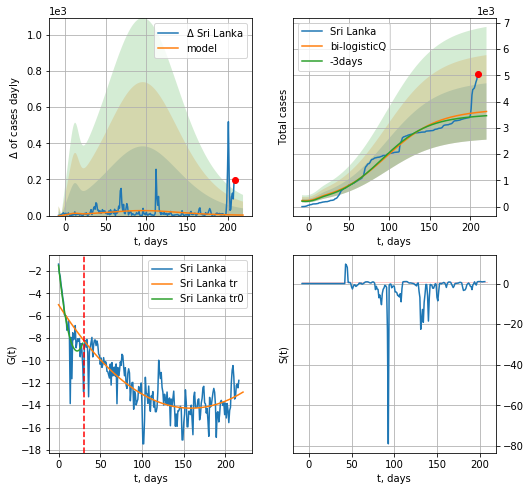

Sri Lanka data at: 2020-10-13
+3 day model MAPE: 0.043877
model: bi-logisticQ
coeffs: [ 3.49533779e+03  4.58601881e-08  9.59079701e+01 -6.89423858e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.296277
forecast at the end of period: +11 days
	 deltaDaycases: 2
	 total cases: 3626 ± 1074
	 total death: 9 ± 7
bi-logisticQ approximation splitting point: 30
trend coefficient of determination: 0.725855
 intercept_: -1.5084890363019623
 coeffs_: [ 0.         -0.68634546  0.01540158]
trend coefficient of determination: 0.632583
 intercept_: -5.018012924972062
 coeffs_: [ 0.         -0.11669791  0.00036811]


In [761]:
try:
    dfSri = read_df(pd.DataFrame(),"Sri")
    vL= 30
    x = forecastRRR('Sri Lanka',dfSri[:vL],d1,T18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
    xx = forecast2RRR('Sri Lanka',dfSri[:],d1,T18*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)
except:
    print ("Exception occurs")

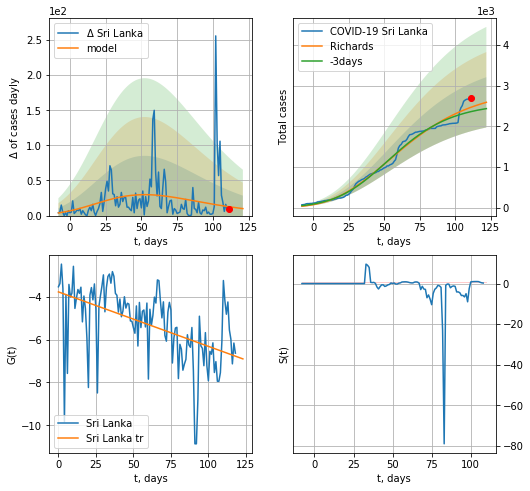

Sri Lanka data at: 2020-10-13
+3 day model MAPE: 0.046566
model: Richards
coeffs: [ 2.95449828e+03  2.23648946e-01 -1.68618598e+01  1.30710649e-01]
rational stdev: 0.238323
forecast at the end of period: +11 days
	 deltaDaycases: 9
	 total cases: 2591 ± 617
	 total death: 6 ± 4
trend coefficient of determination: 0.261938
 intercept: -3.763839
 slope: -0.025471


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in power


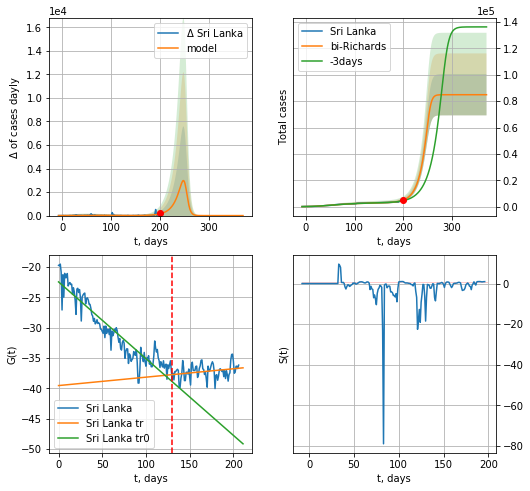

Sri Lanka data at: 2020-10-13
+3 day model MAPE: 0.101755
model: bi-Richards
coeffs: [8.19355291e+04 6.89180299e-02 2.53400979e+02 3.86126125e+00]
rational stdev: 0.184453
forecast at the end of period: +172 days
	 deltaDaycases: 0
	 total cases: 84889 ± 15658
	 total death: 219 ± 121
bi-Richards approximation splitting point: 130
trend coefficient of determination: 0.877891
 intercept: -22.459451
 slope: -0.126439
trend coefficient of determination: 0.068582
 intercept: -39.541552
 slope: 0.013850


In [762]:
vL=140#88
x = forecastRR('Sri Lanka',dfSri[10:vL-10],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Sri Lanka',dfSri[10:],d1,53*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-10)
#x = forecastQR('Sri Lanka',dfSri[10:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

PS
           date     cases  active   death
225 2020-10-09  318266.0    8646  6558.0
226 2020-10-10  318932.0    8904  6570.0
227 2020-10-11  319317.0    8552  6580.0
228 2020-10-12  319848.0    8651  6588.0
229 2020-10-13  320463.0    8782  6601.0


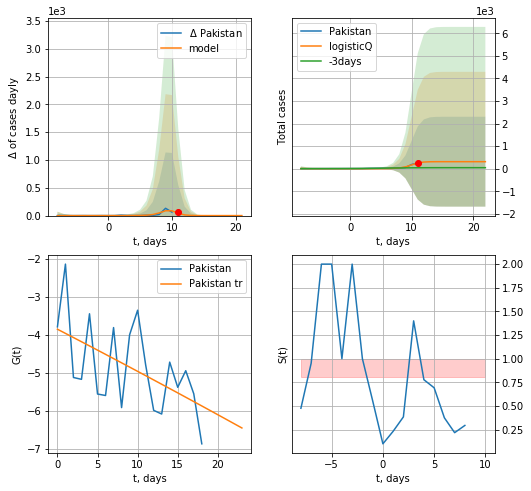

Pakistan data at: 2020-10-13
+3 day model MAPE: 5.954392
model: logisticQ
coeffs: [ 3.10300108e+02  5.80299149e-02  9.88962592e+00 -1.18245382e+01]
rational stdev: 6.420495
forecast at the end of period: +11 days
	 deltaDaycases: 0
	 total cases: 310 ± 1992
	 total death: 6 ± 115
trend coefficient of determination: 0.293073
 intercept_: -3.8498114630651457
 coeffs_: [ 0.         -0.10964083 -0.00016191]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


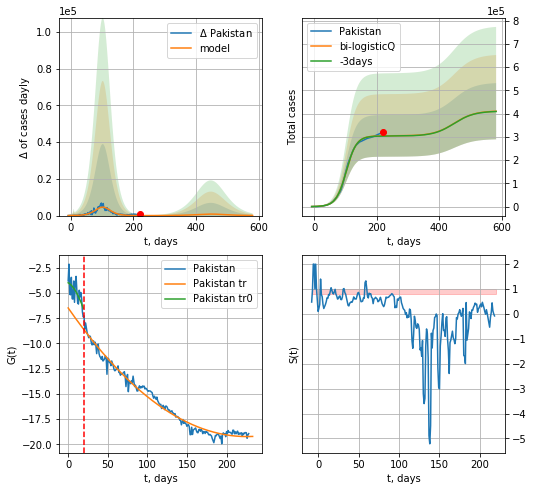

Pakistan data at: 2020-10-13
+3 day model MAPE: 0.002838
model: bi-logisticQ
coeffs: [ 3.03871083e+05  3.17754213e-07  1.02694181e+02 -1.91348986e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.294698
forecast at the end of period: +361 days
	 deltaDaycases: 52
	 total cases: 410069 ± 120846
	 total death: 8446 ± 7467
bi-logisticQ approximation splitting point: 20
trend coefficient of determination: 0.391568
 intercept_: -3.9808806978581046
 coeffs_: [ 0.         -0.04620278 -0.00453428]
trend coefficient of determination: 0.981490
 intercept_: -6.477104632981726
 coeffs_: [ 0.         -0.11297531  0.00025028]


In [763]:
try:
    dfPS = read_df(pd.DataFrame(),"PS")
    vL= 20
    x = forecastRRR('Pakistan',dfPS[:vL],d1,T18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
    xx = forecast2RRR('Pakistan',dfPS[:],d1,80*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


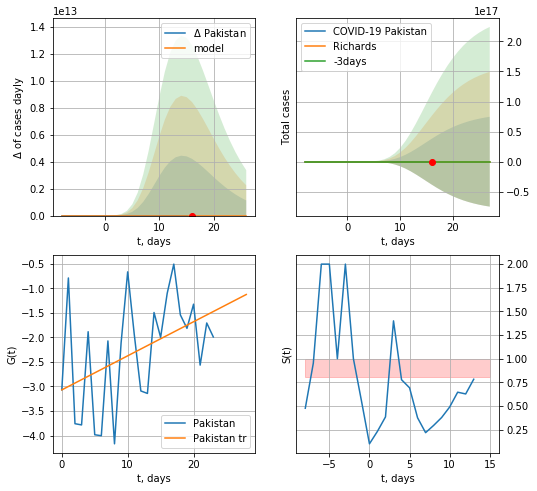

Pakistan data at: 2020-10-13
+3 day model MAPE: 0.118203
model: Richards
coeffs: [ 1.63838701e+03  6.06255652e+00 -3.11642699e+00  3.19416608e-02]
rational stdev: 49944222119087.820312
forecast at the end of period: +11 days
	 deltaDaycases: 28
	 total cases: 1494 ± 74660681887294000
	 total death: 30 ± 4494979990717903
trend coefficient of determination: 0.194578
 intercept: -3.069491
 slope: 0.069432


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


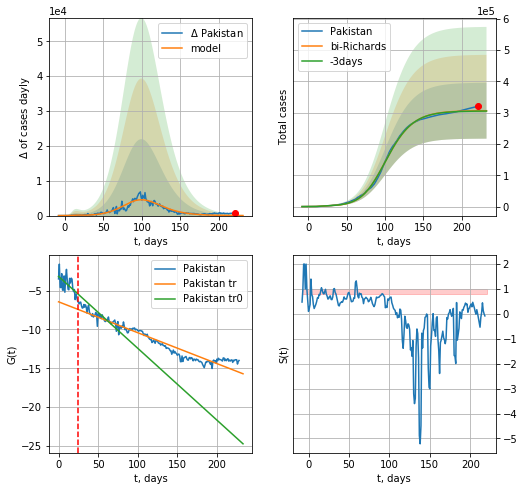

Pakistan data at: 2020-10-13
+3 day model MAPE: 0.003517
model: bi-Richards
coeffs: [3.05040364e+05 8.59024495e-02 9.03433618e+01 6.09999061e-01]
rational stdev: 0.291387
forecast at the end of period: +11 days
	 deltaDaycases: 16
	 total cases: 306380 ± 89275
	 total death: 6310 ± 5515
bi-Richards approximation splitting point: 25
trend coefficient of determination: 0.323117
 intercept: -3.169851
 slope: -0.092470
trend coefficient of determination: 0.929229
 intercept: -6.440688
 slope: -0.039746


In [764]:
vL = 25
x = forecastRR('Pakistan',dfPS[:vL],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Pakistan',dfPS[:],d1,T18*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastQR('Pakistan',dfPS[:],d1,48*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

BN
           date     cases  active   death
215 2020-10-09  375870.0   80481  5477.0
216 2020-10-10  377073.0   80208  5500.0
217 2020-10-11  378266.0   79882  5524.0
218 2020-10-12  379738.0   79792  5555.0
219 2020-10-13  381275.0   79825  5577.0


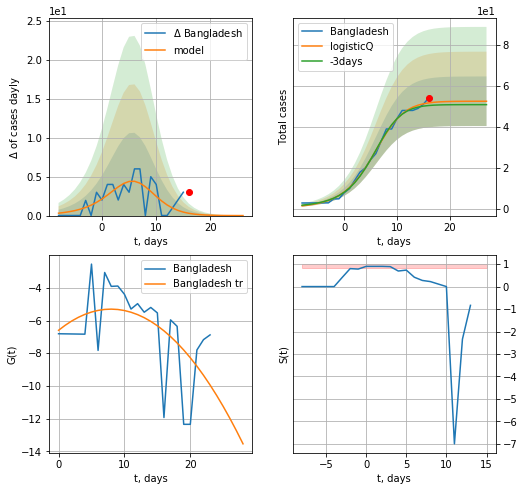

Bangladesh data at: 2020-10-13
+3 day model MAPE: 0.027574
model: logisticQ
coeffs: [ 5.24923910e+01  5.83606353e-03  5.49443194e+00 -5.18823422e+01]
rational stdev: 0.229682
forecast at the end of period: +11 days
	 deltaDaycases: 0
	 total cases: 52 ± 12
	 total death: 0 ± 0
trend coefficient of determination: 0.276192
 intercept_: -6.599187027141191
 coeffs_: [ 0.          0.32583568 -0.02049035]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


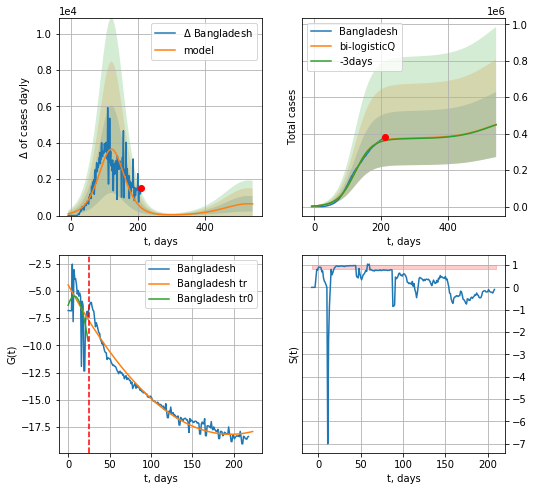

Bangladesh data at: 2020-10-13
+3 day model MAPE: 0.006095
model: bi-logisticQ
coeffs: [ 3.75156454e+05  1.08919448e-07  1.21702617e+02 -3.57263413e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.395879
forecast at the end of period: +333 days
	 deltaDaycases: 639
	 total cases: 450403 ± 178305
	 total death: 6588 ± 7824
bi-logisticQ approximation splitting point: 25
trend coefficient of determination: 0.232653
 intercept_: -6.325425729788838
 coeffs_: [ 0.          0.22449345 -0.0150245 ]
trend coefficient of determination: 0.971073
 intercept_: -4.45700747296134
 coeffs_: [ 0.         -0.13967551  0.00035599]


In [765]:
dfBN = read_df(pd.DataFrame(),"BN")
vL= 25
try:
    x = forecastRRR('Bangladesh',dfBN[:vL],d1,T18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
    xx = forecast2RRR('Bangladesh',dfBN[:],d1,76*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)
except:
    print ("Exception occurs")

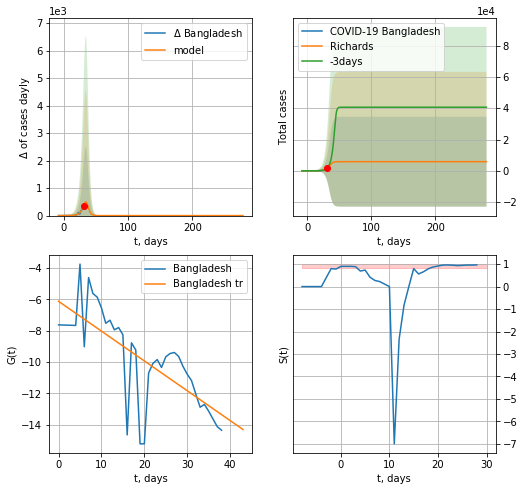

Bangladesh data at: 2020-10-13
+3 day model MAPE: 0.079004
model: Richards
coeffs: [5.83662075e+03 2.41285864e-01 3.62036516e+01 1.74331712e+00]
rational stdev: 4.915459
forecast at the end of period: +249 days
	 deltaDaycases: 0
	 total cases: 5836 ± 28689
	 total death: 85 ± 1253
trend coefficient of determination: 0.544590
 intercept: -6.123432
 slope: -0.190441


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


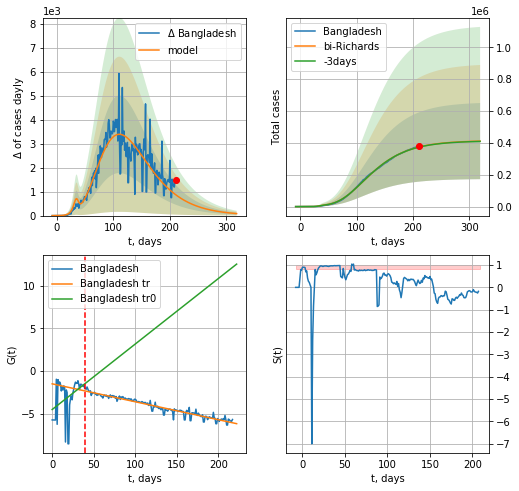

Bangladesh data at: 2020-10-13
+3 day model MAPE: 0.002500
model: bi-Richards
coeffs: [ 4.08849698e+05  2.58041702e+00 -9.75575646e+01  8.78963643e-03]
rational stdev: 0.581232
forecast at the end of period: +109 days
	 deltaDaycases: 83
	 total cases: 411034 ± 238906
	 total death: 6012 ± 10483
bi-Richards approximation splitting point: 40
trend coefficient of determination: 0.167913
 intercept: -4.499220
 slope: 0.076596
trend coefficient of determination: 0.933275
 intercept: -1.495213
 slope: -0.020991


In [766]:
vL=40
x = forecastRR('Bangladesh',dfBN[:vL],d1,64*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Bangladesh',dfBN[:-1],d1,44*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastQR('Bangladesh',dfBN[:],d1,16*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

KW
           date     cases  active  death
228 2020-10-09  110076.0    7403  649.0
229 2020-10-10  110568.0    7191  655.0
230 2020-10-11  111116.0    7190  658.0
231 2020-10-12  111893.0    7427  664.0
232 2020-10-13  112737.0    7557  672.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


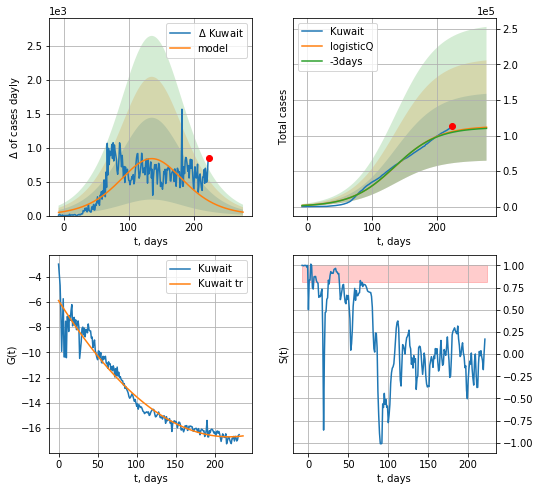

Kuwait data at: 2020-10-13
+3 day model MAPE: 0.010215
model: logisticQ
coeffs: [ 1.13365450e+05  5.89380345e-08  1.35996696e+02 -5.02317475e+05]
rational stdev: 0.421562
forecast at the end of period: +53 days
	 deltaDaycases: 50
	 total cases: 111651 ± 47068
	 total death: 665 ± 841
trend coefficient of determination: 0.952928
 intercept_: -5.893617095916705
 coeffs_: [ 0.         -0.09912762  0.00022736]


In [767]:
try:
    dfKW = read_df(pd.DataFrame(),"KW")
    x = forecastRRR('Kuwait',dfKW[:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


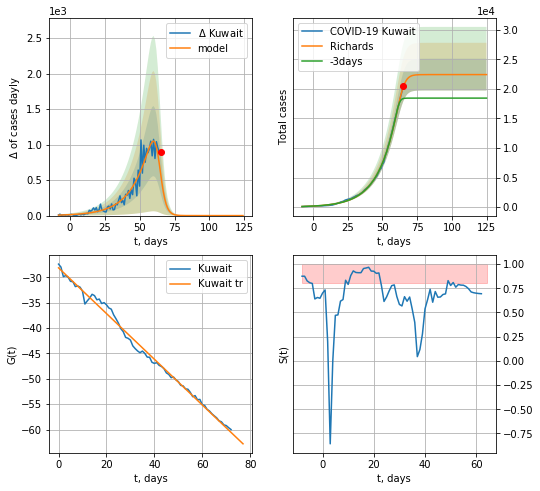

Kuwait data at: 2020-10-13
+3 day model MAPE: 0.136577
model: Richards
coeffs: [2.24365718e+04 7.66634183e-02 6.43548409e+01 5.72971780e+00]
rational stdev: 0.119998
forecast at the end of period: +60 days
	 deltaDaycases: 0
	 total cases: 22436 ± 2692
	 total death: 133 ± 47
trend coefficient of determination: 0.993036
 intercept: -28.143720
 slope: -0.450232


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


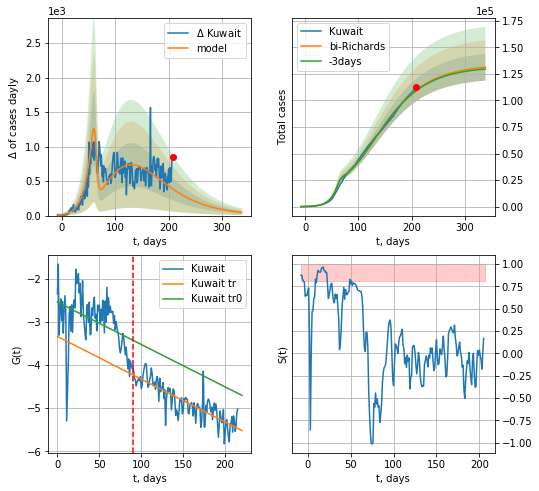

Kuwait data at: 2020-10-13
+3 day model MAPE: 0.005156
model: bi-Richards
coeffs: [ 1.11476465e+05  1.69979498e+00 -1.20595481e+02  1.06466267e-02]
rational stdev: 0.096250
forecast at the end of period: +130 days
	 deltaDaycases: 46
	 total cases: 131339 ± 12641
	 total death: 782 ± 225
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.170266
 intercept: -2.539513
 slope: -0.009835
trend coefficient of determination: 0.700959
 intercept: -3.336126
 slope: -0.009923


In [768]:
iL= 16
vL = 90 + iL
x = forecastRR('Kuwait',dfKW[iL:vL-iL],d1,37*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Kuwait',dfKW[iL:],d1,47*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

DM
           date     cases  active   death
222 2020-10-09  117457.0   22231  2165.0
223 2020-10-10  118014.0   22220  2167.0
224 2020-10-11  118477.0   22220  2173.0
225 2020-10-12  118843.0   22132  2179.0
226 2020-10-13  119008.0   21884  2183.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


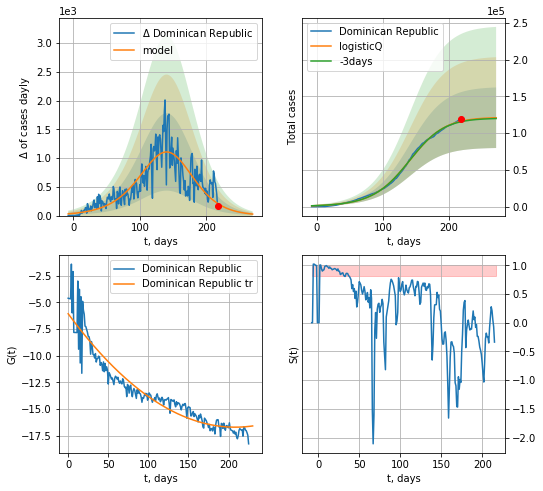

Dominican Republic data at: 2020-10-13
+3 day model MAPE: 0.005701
model: logisticQ
coeffs: [ 1.21571008e+05  2.85247856e-05  1.38392755e+02 -1.13647269e+03]
rational stdev: 0.340642
forecast at the end of period: +53 days
	 deltaDaycases: 26
	 total cases: 120981 ± 41211
	 total death: 2219 ± 2267
trend coefficient of determination: 0.901908
 intercept_: -6.0795302471903865
 coeffs_: [ 0.         -0.10207564  0.00024505]


In [769]:
try:
    dfDM = read_df(pd.DataFrame(),"DM")
    x = forecastRRR('Dominican Republic',dfDM[:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


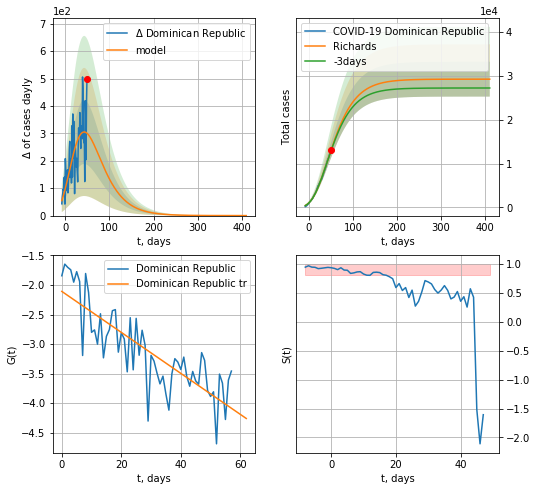

Dominican Republic data at: 2020-10-13
+3 day model MAPE: 0.011985
model: Richards
coeffs: [ 2.92636962e+04  1.52410692e+00 -9.56887865e+01  1.87798018e-02]
rational stdev: 0.135750
forecast at the end of period: +361 days
	 deltaDaycases: 0
	 total cases: 29262 ± 3972
	 total death: 536 ± 218
trend coefficient of determination: 0.671301
 intercept: -2.108314
 slope: -0.034707


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


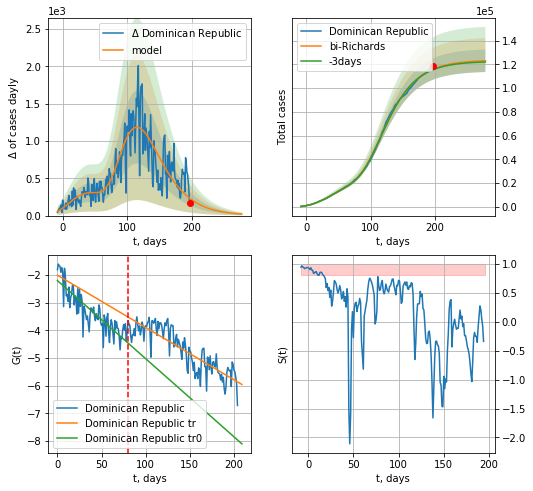

Dominican Republic data at: 2020-10-13
+3 day model MAPE: 0.005077
model: bi-Richards
coeffs: [ 9.44845085e+04  2.67990869e+00 -2.28163142e+01  1.18166280e-02]
rational stdev: 0.077151
forecast at the end of period: +81 days
	 deltaDaycases: 19
	 total cases: 123131 ± 9499
	 total death: 2258 ± 522
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.729074
 intercept: -2.201845
 slope: -0.028238
trend coefficient of determination: 0.738356
 intercept: -2.006816
 slope: -0.018902


In [770]:
vL = 80+21
x = forecastRR('Dominican Republic',dfDM[21:vL-21],d1,80*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Dominican Republic',dfDM[21:],d1,40*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-21)

MD
           date    cases  active   death
216 2020-10-09  60833.0   15902  1442.0
217 2020-10-10  61762.0   16322  1458.0
218 2020-10-11  62151.0   16333  1461.0
219 2020-10-12  62618.0   16412  1478.0
220 2020-10-13  63275.0   16678  1495.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


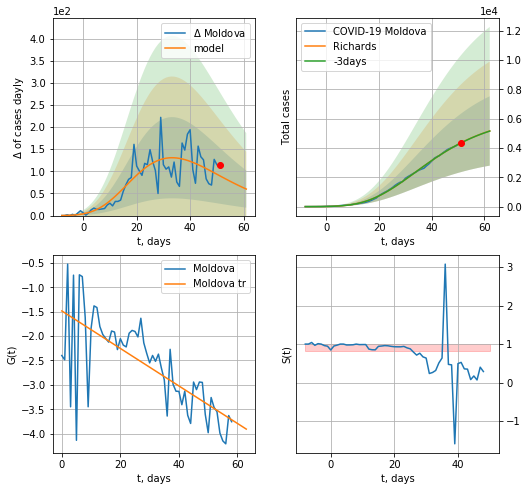

Moldova data at: 2020-10-13
+3 day model MAPE: 0.000798
model: Richards
coeffs: [ 6.30547519e+03  3.98861804e+00 -4.11482156e+01  1.42375767e-02]
rational stdev: 0.458356
forecast at the end of period: +11 days
	 deltaDaycases: 59
	 total cases: 5160 ± 2365
	 total death: 121 ± 166
trend coefficient of determination: 0.512178
 intercept: -1.485670
 slope: -0.038427


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


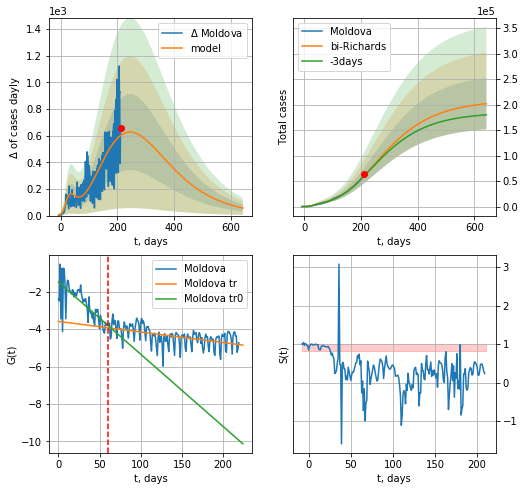

Moldova data at: 2020-10-13
+3 day model MAPE: 0.012249
model: bi-Richards
coeffs: [ 2.02229939e+05  5.72506735e-01 -2.51821404e+02  1.48220504e-02]
rational stdev: 0.248775
forecast at the end of period: +431 days
	 deltaDaycases: 56
	 total cases: 201777 ± 50197
	 total death: 4767 ± 3557
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.526823
 intercept: -1.485578
 slope: -0.038575
trend coefficient of determination: 0.266155
 intercept: -3.587429
 slope: -0.005650


In [771]:
dfMD = read_df(pd.DataFrame(),"MD")
dfMD = dfMD.fillna(0)
try:
    vL = 60
    x = forecastRR("Moldova",dfMD[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
    xx = forecast2RR("Moldova",dfMD[:],d1,90*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
except:
    print("Exception occurs")

In [772]:
#np.diff(dfAF["cases"])

AF
           date     cases  active    death
218 2020-10-09  688352.0   50724  17547.0
219 2020-10-10  690896.0   51070  17673.0
220 2020-10-11  692471.0   50926  17780.0
221 2020-10-12  693359.0   50837  17863.0
222 2020-10-13  694537.0   50935  18028.0


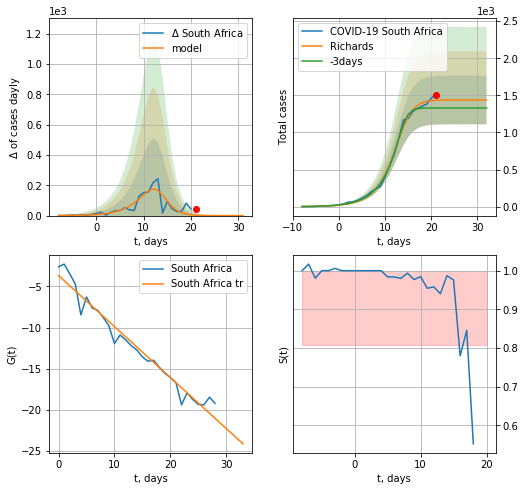

South Africa data at: 2020-10-13
+3 day model MAPE: 0.079443
model: Richards
coeffs: [1.43832006e+03 3.09188711e-01 1.37785511e+01 2.13840843e+00]
rational stdev: 0.227967
forecast at the end of period: +11 days
	 deltaDaycases: 0
	 total cases: 1438 ± 327
	 total death: 37 ± 25
trend coefficient of determination: 0.961533
 intercept: -3.675972
 slope: -0.619731


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


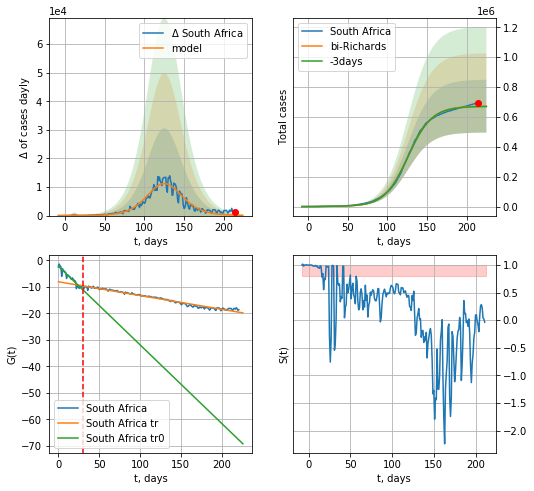

South Africa data at: 2020-10-13
+3 day model MAPE: 0.004118
model: bi-Richards
coeffs: [6.71730721e+05 7.12769026e-02 1.24242176e+02 9.11075498e-01]
rational stdev: 0.262948
forecast at the end of period: +11 days
	 deltaDaycases: 71
	 total cases: 672108 ± 176729
	 total death: 17445 ± 13761
bi-Richards approximation splitting point: 30
trend coefficient of determination: 0.903558
 intercept: -2.231978
 slope: -0.296656
trend coefficient of determination: 0.975053
 intercept: -8.095453
 slope: -0.051942


In [773]:
dfAF = read_df(pd.DataFrame(),"AF").fillna(0)
#dfAF = dfAF.fillna(0)
try:
    vL = 30
    x = forecastRR("South Africa",dfAF[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
    xx = forecast2RR("South Africa",dfAF[:],d1,30*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
except:
    print("Exception occurs")

UB
           date  cases  active  death
208 2020-10-09  60342    2623  498.0
209 2020-10-10  60894    2687  503.0
210 2020-10-11  61205    2629  507.0
211 2020-10-12  61534    2597  510.0
212 2020-10-13  61859    2584  512.0


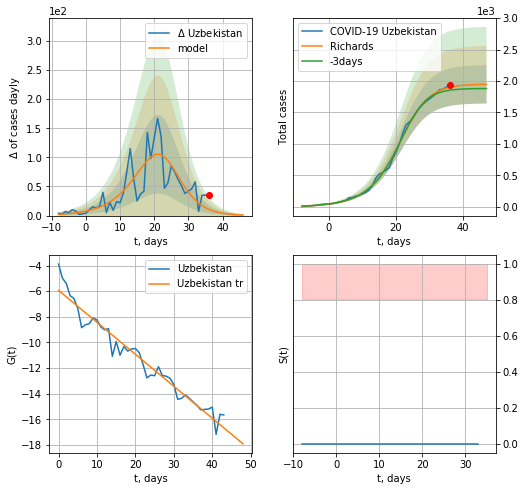

Uzbekistan data at: 2020-10-13
+3 day model MAPE: 0.027380
model: Richards
coeffs: [1.95086939e+03 1.63729535e-01 2.32758397e+01 1.53766466e+00]
rational stdev: 0.156222
forecast at the end of period: +11 days
	 deltaDaycases: 0
	 total cases: 1947 ± 304
	 total death: 16 ± 7
trend coefficient of determination: 0.953191
 intercept: -5.936816
 slope: -0.249439


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


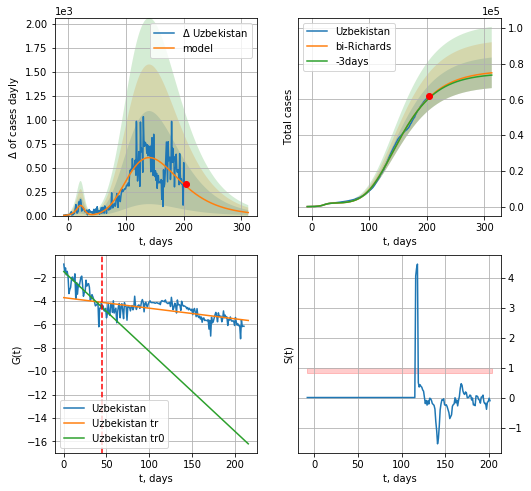

Uzbekistan data at: 2020-10-13
+3 day model MAPE: 0.005020
model: bi-Richards
coeffs: [7.43208379e+04 2.76130264e-01 3.26373298e+01 8.34152431e-02]
rational stdev: 0.114414
forecast at the end of period: +109 days
	 deltaDaycases: 31
	 total cases: 74888 ± 8568
	 total death: 619 ± 212
bi-Richards approximation splitting point: 45
trend coefficient of determination: 0.658255
 intercept: -1.505797
 slope: -0.068024
trend coefficient of determination: 0.388700
 intercept: -3.727520
 slope: -0.009013


In [774]:
dfUB = read_df(pd.DataFrame(),"UB").fillna(0)
#dfAF = dfAF.fillna(0)
try:
    vL = 45
    x = forecastRR("Uzbekistan",dfUB[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
    xx = forecast2RR("Uzbekistan",dfUB[:],d1,44*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
except:
    print("Exception occurs")

In [795]:
cD = {
    "Romania": ["RM",5,4*7],
    #"Finland":"FI",
    "India":["ID",5,6*7],
    "Ecuador":["ED",5,4*7],
    "Philippines":["PH",5,4*7],
    #"Pakistan":"PK",
#    "Luxembourg":"LX",
#    "Saudi Arabia":["SA",5,4*7],
    "Thailand":["TH",5,4*7],
    "Indonesia":["IE",5,16*7],
    "Mexico":["MX",5,8*7],
    "Panama":["PM",12,12*7],
    "Peru":["PU",5,4*7],
    "Serbia":["SB",5,4*7],
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
#    "UAE":["UAE",5,8*7],
    "Argentina":["AG",5,8*7],
    "Iceland":["IC",5,4*7],
    "Colombia":["CB",10,16*7],
    "Qatar":["QR",5,6*7],
    "Algeria":["AR",5,16*7],
    "Croatia":["CT",0,12*7],
    "Egypt":["EG",5,4*7],
    "Slovenia":["SV",12,6*7],
    "Morocco":["MR",5,4*7],
    "Iraq":["IQ",2,8*7]
#    "Hong Kong":"HK"
}

dfArray = [dfRM,dfID,dfED,dfPH,dfTH,dfIE,dfMX,dfPM,dfPU,dfSB,dfAG,dfIC,dfCB,dfQR,dfAG,dfCT,dfEG,dfSV,dfMR,dfIQ]
for c,adf in zip(cD,dfArray):
    if c in ["Qatar","Peru","Argentina","Iraq","India","Philippines","Indonesia","Finland","Luxembourg","Ecuador","Thailand","Morocco","Romania","Iceland","Panama","Colombia","Mexico","Algeria", "Croatia","Slovenia","Egypt","Serbia"]:
        continue
    print (c)
    idS = cD[c][1]
    ipd = cD[c][2]
    x = forecast(c,adf[idS:],d1,ipd-dT)
    #xx = forecast2(c,adf[:],d1,ipd-dT,x)

In [399]:
import requests
import lxml.html as lh
#url='https://www.worldometers.info/coronavirus/#countries'#Create a handle, page, to handle the contents of the website
url='https://www.worldometers.info/coronavirus/#nav-today'
page = requests.get(url)#Store the contents of the website under doc
doc = lh.fromstring(page.content)#Parse data that are stored between <tr>..</tr> of HTML
tr_elements = doc.xpath('//tr')
#Check the length of the first 12 rows
print ([len(T) for T in tr_elements[:12]])
tr_elements = doc.xpath('//tr')#Create empty list
col=[]
i=0#For each row, store each first element (header) and an empty list
for t in tr_elements[0]:
    i+=1
    name=t.text_content()
    print ('%d:"%s"'%(i,name))
    col.append((name,[]))
    
#Since out first row is the header, data is stored on the second row onwards
for j in range(1,len(tr_elements)):
    #T is our j'th row
    T=tr_elements[j]
    #print (len(T))
    #If row is not of size 10, the //tr data is not from our table 
    if len(T)!=19:
        break
    
    #i is the index of our column
    i=0
    
    #Iterate through each element of the row
    for t in T.iterchildren():
        data=t.text_content() 
        #Check if row is empty
        if i>0:
        #Convert any numerical value to integers
            try:
                data=int(data)
            except:
                pass
        #Append the data to the empty list of the i'th column
        col[i][1].append(data)
        #Increment i for the next column
        i+=1
    
print ([len(C) for (title,C) in col])
Dict={title:column for (title,column) in col}
df=pd.DataFrame(Dict)

[19, 19, 19, 19, 19, 19, 19, 19, 19, 19, 19, 19]
1:"#"
2:"Country,Other"
3:"TotalCases"
4:"NewCases"
5:"TotalDeaths"
6:"NewDeaths"
7:"TotalRecovered"
8:"NewRecovered"
9:"ActiveCases"
10:"Serious,Critical"
11:"Tot Cases/1M pop"
12:"Deaths/1M pop"
13:"TotalTests"
14:"Tests/
1M pop
"
15:"Population"
16:"Continent"
17:"1 Caseevery X ppl"
18:"1 Deathevery X ppl"
19:"1 Testevery X ppl"
[698, 698, 698, 698, 698, 698, 698, 698, 698, 698, 698, 698, 698, 698, 698, 698, 698, 698, 698]


In [400]:
df.head(10)
#df.columns[18]

,#,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",Tot Cases/1M pop,Deaths/1M pop,TotalTests,Tests/\n1M pop\n,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,\nNorth America\n,"9,704,894","+4,752","328,709",484,"6,415,160","+4,185","2,961,025","18,404",,,,,,North America,\n,,
1,,\nAsia\n,"12,026,077","+6,100","216,161",34,"10,369,745","+6,458","1,440,171","21,014",,,,,,Asia,\n,,
2,,\nSouth America\n,"8,738,070",227,"273,328",25,"7,645,361",560,"819,381","17,597",,,,,,South America,\n,,
3,,\nEurope\n,"6,269,107","+13,909","233,167",167,"3,071,296","+2,720","2,964,644","11,174",,,,,,Europe,\n,,
4,,\nAfrica\n,"1,601,181",,"38,633",,"1,323,354",,"239,194","1,771",,,,,,Africa,\n,,
5,,\nOceania\n,"33,088",22,949,5,"29,582",5,"2,557",10,,,,,,Australia/Oceania,\n,,
6,,\n\n,721,,15,,659,,47,4,,,,,,,\n,,
7,,World,"38,373,138","+25,010","1,090,962",715,"28,855,157","+13,928","8,427,019","69,974","4,923",140.0,,,,All,\n,,
8,1,USA,"8,090,253",,"220,873",,"5,226,427",,"2,642,953","15,079","24,401",666,"120,523,572","363,507","331,558,077",North America,41,"1,501",3
9,2,India,"7,239,389","+2,307","110,617",,"6,301,927","+3,222","826,845","8,944","5,231",80,"90,090,122","65,100","1,383,863,737",Asia,191,"12,510",15


In [401]:
#df.rename(columns={"Country,Other":"Country",df.columns[9]:"TotDeathsper1Mpop"})
df=df.rename(columns={"Country,Other":"Country",'Deaths/1M pop':"Deathsper1Mpop","Serious,Critical":"Serious_Critical",'Tests/\n1M pop\n':"Testsper1Mpop",'Tot\xa0Cases/1M pop':"TotCasesper1Mpop"})
df.head()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,\nNorth America\n,"9,704,894","+4,752","328,709",484,"6,415,160","+4,185","2,961,025","18,404",,,,,,North America,\n,,
1,,\nAsia\n,"12,026,077","+6,100","216,161",34,"10,369,745","+6,458","1,440,171","21,014",,,,,,Asia,\n,,
2,,\nSouth America\n,"8,738,070",227,"273,328",25,"7,645,361",560,"819,381","17,597",,,,,,South America,\n,,
3,,\nEurope\n,"6,269,107","+13,909","233,167",167,"3,071,296","+2,720","2,964,644","11,174",,,,,,Europe,\n,,
4,,\nAfrica\n,"1,601,181",,"38,633",,"1,323,354",,"239,194","1,771",,,,,,Africa,\n,,


In [402]:
df[df["Country"]=="Lithuania"]

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
124,117,Lithuania,"6,366",,106,,"2,842",,"3,418",15,"2,348",39,"852,008","314,264","2,711,118",Europe,426,"25,577",3
358,118,Lithuania,"6,366",118,106,3,"2,842",49,"3,418",15,"2,348",39,"852,008","314,264","2,711,118",Europe,426,"25,577",3
591,118,Lithuania,"6,248",126,103,,"2,793",16,"3,352",15,"2,305",38,"844,742","311,584","2,711,118",Europe,434,"26,322",3


In [403]:
totIdx = np.where(df['ActiveCases']=='ActiveCases')[0][0]
print(totIdx)

232


In [404]:
df.head(55)

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,\nNorth America\n,"9,704,894","+4,752","328,709",484,"6,415,160","+4,185","2,961,025","18,404",,,,,,North America,\n,,
1,,\nAsia\n,"12,026,077","+6,100","216,161",34,"10,369,745","+6,458","1,440,171","21,014",,,,,,Asia,\n,,
2,,\nSouth America\n,"8,738,070",227,"273,328",25,"7,645,361",560,"819,381","17,597",,,,,,South America,\n,,
3,,\nEurope\n,"6,269,107","+13,909","233,167",167,"3,071,296","+2,720","2,964,644","11,174",,,,,,Europe,\n,,
4,,\nAfrica\n,"1,601,181",,"38,633",,"1,323,354",,"239,194","1,771",,,,,,Africa,\n,,
5,,\nOceania\n,"33,088",22,949,5,"29,582",5,"2,557",10,,,,,,Australia/Oceania,\n,,
6,,\n\n,721,,15,,659,,47,4,,,,,,,\n,,
7,,World,"38,373,138","+25,010","1,090,962",715,"28,855,157","+13,928","8,427,019","69,974","4,923",140.0,,,,All,\n,,
8,1,USA,"8,090,253",,"220,873",,"5,226,427",,"2,642,953","15,079","24,401",666,"120,523,572","363,507","331,558,077",North America,41,"1,501",3
9,2,India,"7,239,389","+2,307","110,617",,"6,301,927","+3,222","826,845","8,944","5,231",80,"90,090,122","65,100","1,383,863,737",Asia,191,"12,510",15


In [405]:
df.at[19, 'TotalRecovered'] = 0
df.at[12, 'TotalRecovered'] = 0
df.at[33, 'TotalRecovered'] = 0
df.at[51, 'TotalRecovered'] = 0
#df.at[109, 'TotalRecovered'] = 0
df.at[19,"ActiveCases"] = 0
df.at[12,"ActiveCases"] = 0
df.at[33,"ActiveCases"] = 0
df.at[51,"ActiveCases"] = 0
#df.at[109,"ActiveCases"] = 0
#df.at[12, 'TotalRecovered'] = 0
df = df.fillna(0)

In [406]:
import lxml
def sanitize(data):
    #print (type(data))
    if type(data) == lxml.etree._ElementUnicodeResult:
        data=str(data).strip()
    if str(data).find(',') != -1:
        data = data.replace(',','')
    #print(str(data).find(',') != -1)
    return data
df=df[df.index<totIdx-1]
df["ActiveCases"] = pd.to_numeric(df["ActiveCases"].apply(sanitize))
df["Deathsper1Mpop"] = pd.to_numeric(df["Deathsper1Mpop"].apply(sanitize))
df["NewCases"] = pd.to_numeric(df["NewCases"].apply(sanitize))
df["NewDeaths"] = pd.to_numeric(df["NewDeaths"].apply(sanitize))
df["Serious_Critical"] = pd.to_numeric(df["Serious_Critical"].apply(sanitize))
df["TotalCases"] = pd.to_numeric(df["TotalCases"].apply(sanitize))
df["TotalDeaths"] = pd.to_numeric(df["TotalDeaths"].apply(sanitize))
df["TotalRecovered"] = pd.to_numeric(df["TotalRecovered"].apply(sanitize))
df["TotCasesper1Mpop"] = pd.to_numeric(df["TotCasesper1Mpop"].apply(sanitize))
df["TotalTests"] = pd.to_numeric(df["TotalTests"].apply(sanitize))
df["Testsper1Mpop"] = pd.to_numeric(df["Testsper1Mpop"].apply(sanitize))
df.head(15)

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,\nNorth America\n,9704894,4752.0,328709.0,484.0,6415160.0,"+4,185",2961025,18404.0,NaN,NaN,NaN,NaN,,North America,\n,,
1,,\nAsia\n,12026077,6100.0,216161.0,34.0,10369745.0,"+6,458",1440171,21014.0,NaN,NaN,NaN,NaN,,Asia,\n,,
2,,\nSouth America\n,8738070,227.0,273328.0,25.0,7645361.0,560,819381,17597.0,NaN,NaN,NaN,NaN,,South America,\n,,
3,,\nEurope\n,6269107,13909.0,233167.0,167.0,3071296.0,"+2,720",2964644,11174.0,NaN,NaN,NaN,NaN,,Europe,\n,,
4,,\nAfrica\n,1601181,NaN,38633.0,NaN,1323354.0,,239194,1771.0,NaN,NaN,NaN,NaN,,Africa,\n,,
5,,\nOceania\n,33088,22.0,949.0,5.0,29582.0,5,2557,10.0,NaN,NaN,NaN,NaN,,Australia/Oceania,\n,,
6,,\n\n,721,NaN,15.0,NaN,659.0,,47,4.0,NaN,NaN,NaN,NaN,,,\n,,
7,,World,38373138,25010.0,1090962.0,715.0,28855157.0,"+13,928",8427019,69974.0,4923.0,140.0,NaN,NaN,,All,\n,,
8,1,USA,8090253,NaN,220873.0,NaN,5226427.0,,2642953,15079.0,24401.0,666.0,120523572.0,363507.0,"331,558,077",North America,41,"1,501",3
9,2,India,7239389,2307.0,110617.0,NaN,6301927.0,"+3,222",826845,8944.0,5231.0,80.0,90090122.0,65100.0,"1,383,863,737",Asia,191,"12,510",15


In [407]:
cLst = countriesEU
ActiveCasesEU = sum([ w for w in df[df['Country'].isin(cLst)].ActiveCases if w>0])
CountryEU = "European Union" 
Deathsper1MpopEU = sum([w for w in df[df['Country'].isin(cLst)].TotalDeaths if w>0])/445.250514
NewCasesEU = sum([w for w in df[df['Country'].isin(cLst)].NewCases if w>0 ])
NewDeathsEU = sum([w for w in df[df['Country'].isin(cLst)].NewDeaths if w>0])
Serious_CriticalEU = sum([w for w in df[df['Country'].isin(cLst)].Serious_Critical if w>0])
Testsper1MpopEU = sum([ w for w in df[df['Country'].isin(cLst)].TotalTests if w>0])/445.250514
TotalCasesEu = sum([w for w in df[df['Country'].isin(cLst)].TotalCases if w>0])
TotalDeathsEU = sum([w for w in df[df['Country'].isin(cLst)].TotalDeaths if w>0])
TotalRecoveredEU = sum([w for w in df[df['Country'].isin(cLst)].TotalRecovered if w>0] )
TotalTestsEU = sum([w for w in df[df['Country'].isin(cLst)].TotalTests if w>0])
TotCasesper1MpopEU = TotalCasesEu/445.250514

rowEU = {"ActiveCases":ActiveCasesEU,"Continent":"Europe","Country": CountryEU,"Deathsper1Mpop": Deathsper1MpopEU,"NewCases": NewCasesEU,"NewDeaths": NewDeathsEU,"Serious_Critical": Serious_CriticalEU,"Testsper1Mpop": Testsper1MpopEU,"TotalCases": TotalCasesEu,"TotalDeaths": TotalDeathsEU,"TotalRecovered": TotalRecoveredEU,"TotalTests": TotalTestsEU,"TotCasesper1Mpop": TotCasesper1MpopEU }
df = df.append(rowEU, ignore_index=True)
df.tail()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
227,,Total:,6269107,13909.0,233167.0,167.0,3071296.0,"+2,720",2964644,11174.0,NaN,NaN,NaN,NaN,,Europe,,,
228,,Total:,1601181,NaN,38633.0,NaN,1323354.0,,239194,1771.0,NaN,NaN,NaN,NaN,,Africa,,,
229,,Total:,33088,22.0,949.0,5.0,29582.0,5,2557,10.0,NaN,NaN,NaN,NaN,,Australia/Oceania,,,
230,,Total:,721,NaN,15.0,NaN,659.0,,47,4.0,NaN,NaN,NaN,NaN,,,,,
231,NaN,European Union,3677207,8319.0,153858.0,60.0,1152579.0,NaN,1201633,7273.0,8258.737238,345.553784,93471081.0,209929.192805,NaN,Europe,NaN,NaN,NaN


In [408]:
#df['Reported1st case'] = df['Reported1st case'].map(lambda x: x.lstrip('\n'))
df["Country"] = df["Country"].str.strip('\n')
df.head()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,North America,9704894,4752.0,328709.0,484.0,6415160.0,"+4,185",2961025,18404.0,NaN,NaN,NaN,NaN,,North America,\n,,
1,,Asia,12026077,6100.0,216161.0,34.0,10369745.0,"+6,458",1440171,21014.0,NaN,NaN,NaN,NaN,,Asia,\n,,
2,,South America,8738070,227.0,273328.0,25.0,7645361.0,560,819381,17597.0,NaN,NaN,NaN,NaN,,South America,\n,,
3,,Europe,6269107,13909.0,233167.0,167.0,3071296.0,"+2,720",2964644,11174.0,NaN,NaN,NaN,NaN,,Europe,\n,,
4,,Africa,1601181,NaN,38633.0,NaN,1323354.0,,239194,1771.0,NaN,NaN,NaN,NaN,,Africa,\n,,


In [409]:
#totIdx0 = np.where(df['Country']=='Total:')[0][0]
#df.at[totIdx0,'Country'] = 'World'

In [410]:
#df

In [411]:
#df[df['Country'].isnull()]
#df['Country']=df['Country'].dropna()
##for idx in df['Country'].isnull():
##    #print(idx)
##    if idx == True:
##        ind = df[df['Country'].isnull()].index[0]
##        df = df.drop(df.index[ind])
df = df.drop(df.index[6])
df.head(10)

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,North America,9704894,4752.0,328709.0,484.0,6415160.0,"+4,185",2961025,18404.0,NaN,NaN,NaN,NaN,,North America,\n,,
1,,Asia,12026077,6100.0,216161.0,34.0,10369745.0,"+6,458",1440171,21014.0,NaN,NaN,NaN,NaN,,Asia,\n,,
2,,South America,8738070,227.0,273328.0,25.0,7645361.0,560,819381,17597.0,NaN,NaN,NaN,NaN,,South America,\n,,
3,,Europe,6269107,13909.0,233167.0,167.0,3071296.0,"+2,720",2964644,11174.0,NaN,NaN,NaN,NaN,,Europe,\n,,
4,,Africa,1601181,NaN,38633.0,NaN,1323354.0,,239194,1771.0,NaN,NaN,NaN,NaN,,Africa,\n,,
5,,Oceania,33088,22.0,949.0,5.0,29582.0,5,2557,10.0,NaN,NaN,NaN,NaN,,Australia/Oceania,\n,,
7,,World,38373138,25010.0,1090962.0,715.0,28855157.0,"+13,928",8427019,69974.0,4923.0,140.0,NaN,NaN,,All,\n,,
8,1,USA,8090253,NaN,220873.0,NaN,5226427.0,,2642953,15079.0,24401.0,666.0,120523572.0,363507.0,"331,558,077",North America,41,"1,501",3
9,2,India,7239389,2307.0,110617.0,NaN,6301927.0,"+3,222",826845,8944.0,5231.0,80.0,90090122.0,65100.0,"1,383,863,737",Asia,191,"12,510",15
10,3,Brazil,5114823,NaN,151063.0,NaN,4526975.0,,436785,8318.0,24014.0,709.0,17900000.0,84041.0,"212,990,988",South America,42,"1,410",12


In [412]:
df.to_csv('data/coronaAll_%s.csv'%(date.today()- timedelta(days=1)), index=False)

In [413]:
countryDic = {
  "USA": "US",
"Italy":"IT",
"Spain":"SP",
"Germany":"GR",
"France":"FR",
"Iran":"IN",
"UK":"GB",
"Switzerland":"SZ",
"S. Korea":"KR",
"Norway":"NG",
"Sweden":"SW",
"Israel":"IS",
"Denmark":"DK",
"Poland":"PL",
"Estonia":"ES",
"Ukraine":"Ukr",
"Latvia":"LV",
    "Lithuania":"LT",
    "China":"CN",
    "USA":"US",
    "Russia":"RS",
    "Japan":"JP",
    "Netherlands":"NL",
    "Belgium":"BG",
    "Singapore":"SG",
    "Austria":"AT",
    "Turkey":"TR",
    "Canada":"CA",
    "Portugal":"PT",
    "World":"World",
    "Australia":"AS",
    "Brazil":"BZ",
    "Malaysia":"ML",
    "New Zealand":"ZL",
    "Belarus":"BR",
    "Ireland":"IR",
    "Chile":"CL",
    "Czechia":"CH",
    "Romania": "RM",
    "Finland":"FI",
    "India":"ID",
    "Ecuador":"ED",
    "Philippines":"PH",
#    "Pakistan":"PK",
    "Luxembourg":"LX",
    "Saudi Arabia":"SA",
    "Thailand":"TH",
    "Indonesia":"IE",
    "Mexico":"MX",
    "Panama":"PM",
    "Peru":"PU",
    "Serbia":"SB",
    "South Africa":"AF",
    "UAE":"UAE",
    "Argentina":"AG",
    "Iceland":"IC",
    "Colombia":"CB",
    "Qatar":"QR",
    "Algeria":"AR",
    "Croatia":"CT",
    "Egypt":"EG",
    "Slovenia":"SV",
    "Morocco":"MR",
    "Iraq":"IQ",
    "European Union":"EU",
    "Bulgaria":"BL",
    "Hungary":"HG",
    "Malta":"MT",
    "Slovakia":"SL",
    "Cyprus":"CP",
    "Greece":"GC",
    "Dominican Republic":"DM",
    "Kuwait":"KW",
    "Bangladesh":"BN",
    "Sri Lanka":"Sri",
    "Pakistan":"PS",
    "Moldova":"MD",
    "Uzbekistan":"UB"
#    "Hong Kong":"HK"
}
df=df[df.TotalCases.astype(int)>0]
#df=df['TotalCases'].astype(int)

for c in countryDic:
    print (c,countryDic[c])

USA US
Italy IT
Spain SP
Germany GR
France FR
Iran IN
UK GB
Switzerland SZ
S. Korea KR
Norway NG
Sweden SW
Israel IS
Denmark DK
Poland PL
Estonia ES
Ukraine Ukr
Latvia LV
Lithuania LT
China CN
Russia RS
Japan JP
Netherlands NL
Belgium BG
Singapore SG
Austria AT
Turkey TR
Canada CA
Portugal PT
World World
Australia AS
Brazil BZ
Malaysia ML
New Zealand ZL
Belarus BR
Ireland IR
Chile CL
Czechia CH
Romania RM
Finland FI
India ID
Ecuador ED
Philippines PH
Luxembourg LX
Saudi Arabia SA
Thailand TH
Indonesia IE
Mexico MX
Panama PM
Peru PU
Serbia SB
South Africa AF
UAE UAE
Argentina AG
Iceland IC
Colombia CB
Qatar QR
Algeria AR
Croatia CT
Egypt EG
Slovenia SV
Morocco MR
Iraq IQ
European Union EU
Bulgaria BL
Hungary HG
Malta MT
Slovakia SL
Cyprus CP
Greece GC
Dominican Republic DM
Kuwait KW
Bangladesh BN
Sri Lanka Sri
Pakistan PS
Moldova MD
Uzbekistan UB


In [414]:
len(countryDic)

76

In [415]:
df = pd.read_csv('data/coronaAll_%s.csv'%(date.today()- timedelta(days=1)),',')
df=df[df.TotalCases.astype(int)>0]
#df=df['TotalCases'].astype(int)
from datetime import date, timedelta
for c in df.Country: 
    print (c)
    #if c in ['North America','South America','Asia','Europe','Africa','Oceania','World']:
    #    continue
    f = open("data/tmp/corona%sOneRaw.csv"%(c),'w')
    #print ("corona%sOneRaw.csv"%(c),date.today()- timedelta(days=1),c,df[df.Country == c].TotalCases.values[0])
    print(c)
    if c!='World':
        f.write("%s,%s,%s,%s\n"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
        print(c,"%s,%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
    else:
        f.write("%s,%s,%s,%s\n"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
        print(c,"%s,%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
    f.close()

North America
North America
North America 2020-10-13,9704894,2961025,328709.0
Asia
Asia
Asia 2020-10-13,12026077,1440171,216161.0
South America
South America
South America 2020-10-13,8738070,819381,273328.0
Europe
Europe
Europe 2020-10-13,6269107,2964644,233167.0
Africa
Africa
Africa 2020-10-13,1601181,239194,38633.0
Oceania
Oceania
Oceania 2020-10-13,33088,2557,949.0
World
World
World 2020-10-13,38373138,8427019,1090962.0
USA
USA
USA 2020-10-13,8090253,2642953,220873.0
India
India
India 2020-10-13,7239389,826845,110617.0
Brazil
Brazil
Brazil 2020-10-13,5114823,436785,151063.0
Russia
Russia
Russia 2020-10-13,1326178,271427,22966.0
Spain
Spain
Spain 2020-10-13,925341,0,33204.0
Colombia
Colombia
Colombia 2020-10-13,924098,89254,28141.0
Argentina
Argentina
Argentina 2020-10-13,917035,150228,24572.0
Peru
Peru
Peru 2020-10-13,853974,66596,33419.0
Mexico
Mexico
Mexico 2020-10-13,825340,139349,84420.0
France
France
France 2020-10-13,756472,620850,32942.0
South Africa
South Africa
South Africa

Sao Tome and Principe 2020-10-13,929,19,15.0
Channel Islands
Channel Islands
Channel Islands 2020-10-13,741,53,48.0
San Marino
San Marino
San Marino 2020-10-13,741,17,42.0
Sint Maarten
Sint Maarten
Sint Maarten 2020-10-13,719,52,22.0
Diamond Princess
Diamond Princess
Diamond Princess 2020-10-13,712,40,13.0
Turks and Caicos
Turks and Caicos
Turks and Caicos 2020-10-13,696,17,6.0
Curaçao
Curaçao
Curaçao 2020-10-13,619,275,1.0
Papua New Guinea
Papua New Guinea
Papua New Guinea 2020-10-13,565,21,7.0
Taiwan
Taiwan
Taiwan 2020-10-13,530,34,7.0
Burundi
Burundi
Burundi 2020-10-13,529,56,1.0
Tanzania
Tanzania
Tanzania 2020-10-13,509,305,21.0
Gibraltar
Gibraltar
Gibraltar 2020-10-13,499,75,nan
Comoros
Comoros
Comoros 2020-10-13,496,5,7.0
Faeroe Islands
Faeroe Islands
Faeroe Islands 2020-10-13,477,12,nan
Saint Martin
Saint Martin
Saint Martin 2020-10-13,466,149,8.0
Eritrea
Eritrea
Eritrea 2020-10-13,414,42,nan
Mauritius
Mauritius
Mauritius 2020-10-13,407,36,10.0
Isle of Man
Isle of Man
Isle of Ma

In [416]:
#c='World'
#print(c,"%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0]))

In [417]:
for c in countryDic: 
    #if c not in ['European Union']:
    #    continue
    ff = open("data/tmp/corona%sOneRaw.csv"%(c),'r')
    fff = open("data/corona%s.csv"%(countryDic[c]),'a')
    for l in ff:
        #print(c,l)
        print("append data/corona%s.csv"%(countryDic[c]),"%s"%(l))
        fff.write(l)
    ff.close()
    fff.close()

append data/coronaUS.csv 2020-10-13,8090253,2642953,220873.0

append data/coronaIT.csv 2020-10-13,365467,87193,36246.0

append data/coronaSP.csv 2020-10-13,925341,0,33204.0

append data/coronaGR.csv 2020-10-13,335679,46839,9740.0

append data/coronaFR.csv 2020-10-13,756472,620850,32942.0

append data/coronaIN.csv 2020-10-13,508389,67479,29070.0

append data/coronaGB.csv 2020-10-13,634920,0,43018.0

append data/coronaSZ.csv 2020-10-13,65881,13978,2103.0

append data/coronaKR.csv 2020-10-13,24889,1421,438.0

append data/coronaNG.csv 2020-10-13,15793,3653,277.0

append data/coronaSW.csv 2020-10-13,100654,0,5899.0

append data/coronaIS.csv 2020-10-13,297274,48017,2055.0

append data/coronaDK.csv 2020-10-13,33101,5202,674.0

append data/coronaPL.csv 2020-10-13,135278,50173,3101.0

append data/coronaES.csv 2020-10-13,3947,819,68.0

append data/coronaUkr.csv 2020-10-13,276177,152249,5229.0

append data/coronaLV.csv 2020-10-13,2840,1474,41.0

append data/coronaLT.csv 2020-10-13,6366,3418,106.0

In [418]:
import pandas as pd
import io
import requests
url="https://opendata.ecdc.europa.eu/covid19/casedistribution/csv"
s=requests.get(url).content
#print (s)
dfc=pd.read_csv(io.StringIO(s.decode(encoding='windows-1252')))
dfc.to_csv("data/europa_corona.csv", index=False)

In [419]:
countryDic1 = {
    "Romania": "RM",
    "Finland":"FI",
    "India":"ID",
    "Ecuador":"ED",
    "Philippines":"PH",
    "Pakistan":"PK",
    "Luxembourg":"LX",
#    "Saudi Arabia":"SA",
    "Thailand":"TH",
    "Indonesia":"IE",
    "Mexico":"MX",
    "Panama":"PM",
    "Peru":"PU",
    "Serbia":"SB",
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
#    "UAE":"UAE",
    "Argentina":"AG",
    "Iceland":"IC",
    "Colombia":"CB",
    "Qatar":"QR",
    "Algeria":"AR",
    "Croatia":"CT",
    "Egypt":"EG",
    "Slovenia":"SV",
    "Morocco":"MR",
    "Iraq":"IQ",
    "Bulgaria":"BL"
#    "Hong Kong":"HK"
}
countryDic2 = {
    "Austria":"AT",
    "Italy":"IT",
    "Belgium":"BG",
    "Latvia":"LV",
    "Bulgaria":"BL",
    "Lithuania":"LT",
    "Croatia":"CT",
    "Luxembourg":"LX",
    "Cyprus":"CP",
    "Malta":"MT",
    "Czechia":"CH",
    "Netherlands":"NL",
    "Denmark":"DK",
    "Poland":"PL",
    "Estonia":"ES",
    "Portugal":"PT",
    "Finland":"FI",
    "Romania":"RM",
    "France":"FR",
    "Slovakia":"SL",
    "Germany":"GR",
    "Slovenia":"SV",
    "Greece":"GC",
    "Spain":"SP",
    "Hungary":"HG",
    "Sweden":"SW",
    "Ireland":"IR"      
}
cD3 = {"Malta":"MT","Slovakia":"SL","Greece":"GC","Hungary":"HG","Cyprus":"CP","South Africa":"SAF","Afghanistan":"AFG"}
    
for  c in cD3:#countryDic1:
    if c != "Afghanistan":
        continue
    dfc = pd.read_csv("data/europa_corona.csv",",")
    dfc = dfc[dfc['countriesAndTerritories']==c].sort_values(['year', 'month', 'day'], ascending=[True, True, True])
    print(c,sum(dfc["cases"].values))
    dfc=dfc.rename(columns={"dateRep":"date"})
    dfc = dfc[dfc["cases"]>0]
    dfc['date'] = pd.to_datetime(dfc[['year', 'month', 'day']])
    #dfc['date'] = dfc['date'].dt.strftime('%Y-%m-%d')
    dfc["cases"]=np.cumsum(dfc["cases"].values)
    dfc[['date', 'cases']].to_csv('data/corona%s.csv'%(cD3[c]), index=False)#countryDic1

Afghanistan 39928


In [420]:
#dfRM = read_df(pd.DataFrame(),"RM")

In [421]:
dfc.tail()#[['date', 'cases']]

,date,day,month,year,cases,deaths,countriesAndTerritories,geoId,countryterritoryCode,popData2019,continentExp,Cumulative_number_for_14_days_of_COVID-19_cases_per_100000
5,2020-10-08,8,10,2020,39616,1,Afghanistan,AF,AFG,38041757.0,Asia,1.172396
4,2020-10-09,9,10,2020,39693,2,Afghanistan,AF,AFG,38041757.0,Asia,1.332746
3,2020-10-10,10,10,2020,39703,1,Afghanistan,AF,AFG,38041757.0,Asia,1.343261
1,2020-10-12,12,10,2020,39799,4,Afghanistan,AF,AFG,38041757.0,Asia,1.503611
0,2020-10-13,13,10,2020,39928,3,Afghanistan,AF,AFG,38041757.0,Asia,1.811168


In [1218]:
date(2012, 3, 16)

datetime.date(2012, 3, 16)

In [1219]:
len(countriesEU)

27

In [ ]:
dfc = pd.read_csv("europa_corona.csv",",")
cLst = ["Austria","Italy","Belgium","Latvia","Bulgaria","Lithuania","Croatia","Luxembourg","Cyprus","Malta","Czechia","Netherlands","Denmark","Poland","Estonia","Portugal","Finland","Romania","France","Slovakia","Germany","Slovenia","Greece","Spain","Hungary","Sweden","Ireland"]
dfc = dfc[dfc['countriesAndTerritories'].isin(cLst)].sort_values(['year', 'month', 'day'], ascending=[True, True, True])
print(c,sum(dfc["cases"].values))
dfc=dfc.rename(columns={"dateRep":"date"})
dfc = dfc[dfc["cases"]>0]
dfc['date'] = pd.to_datetime(dfc[['year', 'month', 'day']])
#dfc['date'] = dfc['date'].dt.strftime('%Y-%m-%d')
dfc["cases"]=np.cumsum(dfc["cases"].values)
dfc[['date', 'cases']].to_csv('/home/algiz/Desktop/corona%s.csv'%("EU"), index=False)

In [ ]:
#subsetDataFrame = dfObj[dfObj['Product'].isin(['Mangos', 'Grapes']) ]

#dfD = dfAll[dfAll['Country'].isin(cLst)].TotalTests


In [ ]:
#dfD

In [ ]:
#dfAll[dfAll['Country'].isin(cLst)]

In [ ]:
TT = sum(dfAll[dfAll.TotalTests>0].TotalTests) - dfAll[dfAll['Country']=='European Union'].TotalTests.values[0]
print(TT,TT/7.7776e3)

In [ ]:
TT/7.7776e3

In [ ]:
dfAll[dfAll['Country']=='European Union'].TotalTests.values[0]/(popEU/1e6)

In [ ]:
sum(dfp.Population)/1e6

In [ ]:
dfAll[dfAll.TotalTests>0]

In [ ]:
cDicEU = {
    "Austria":["AT",dfAT],
    "Italy":["IT",dfIT],
    "Belgium":["BG",dfBG],
    "Latvia":["LV",dfLV],
    "Bulgaria":["BL",dfBL],
    "Lithuania":["LT",dfLT],
    "Croatia":["CT",dfCT],
    "Luxembourg":["LX",dfLX],
    "Cyprus":["CP",dfCP],
    "Malta":["MT",dfMT],
    "Czechia":["CH",dfCH],
    "Netherlands":["NL",dfNL],
    "Denmark":["DK",dfDK],
    "Poland":["PL",dfPL],
    "Estonia":["ES",dfES],
    "Portugal":["PT",dfPT],
    "Finland":["FI",dfFI],
    "Romania":["RM",dfRM],
    "France":["FR",dfFR],
    "Slovakia":["SL",dfSL],
    "Germany":["GR",dfGR],
    "Slovenia":["SV",dfSV],
    "Greece":["GC",dfGC],
    "Spain":["SP",dfSP],
    "Hungary":["HG",dfHG],
    "Sweden":["SW",dfSW],
    "Ireland":["IR",dfIR],
}

In [ ]:
def addDataFrames(f_arg, *argv):
    dfTotal = f_arg
    for arg in argv:
        dfTotal = dfTotal.set_index('date').add(arg.set_index('date'), fill_value = 0)
        dfTotal['date'] = dfTotal.index
    return dfTotal
dfTot = cDicEU["Austria"][1]
for cD in cDicEU:
    if cD == "Austria":
        continue
    dfTot = addDataFrames(dfTot, cDicEU[cD][1])
    
dfTot.to_csv("~/Documents/coronaEU1.csv")

In [ ]:
#cDicEU["Ireland"][1]

In [ ]:
dfAll[df["Country"]=="European Union"].TotalTests.values[0]/445.250514

In [ ]:
dfAll[df["Country"]=="Total:"].TotalTests.values[0]/445

In [ ]:
#dfAll

In [ ]:
(sum(dfAll.TotalTests)-dfAll[df["Country"]=="European Union"].TotalTests.values[0])/(7.777e3-445.250514)

In [ ]:
CList = ["USA",
"Spain", "Italy", "UK", "France", "Germany", "Turkey", "Russia", "Iran", "Brazil", "Canada", "Belgium",
"Peru", "Netherlands", "India", "Switzerland", "Ecuador", "Portugal", "Saudi Arabia", "Sweden", "Ireland",
"Mexico", "Pakistan", "Singapore", "Chile", "Israel", "Austria", "Belarus", "Japan", "Qatar", "Poland",
"UAE", "Romania", "Ukraine", "South_Korea", "Indonesia", "Denmark", "Serbia", "Philippines", "Norway", "Czechia",
"Colombia", "Australia", "Malaysia", "Egypt", "Finland", "Morocco", "Argentina", "Algeria", "Moldova", 
"Luxembourg", "Thailand", "Hungary", "Greece", "Iraq", "Croatia", "Iceland", "Estonia", "Bulgaria",
"New_Zealand", "Slovenia", "Slovakia", "Lithuania", "Latvia", "Cyprus", "Malta","Bangladesh","Kuwait",
"Dominican Republic","Moldova","South Africa","China","Uzbekistan"         
]

In [ ]:
len(CList)

In [ ]:
popModelled = sum(dfp[dfp["Country (or dependency)"].isin(CList) ].Population)
popModelled

In [ ]:
for CItem in CList:
    a = """
    %s
    <br />
    <img src="pictures/covidcases%s35_Q.png" alt="hi" class="inline"/><br /> 

      {%% include_relative _includes/covidcases%s35_Q.txt %%}
          <br /> 
    """%(CItem,CItem,CItem)
    print (a)

In [ ]:
R = (dfLT[:].cases.values/0.9240855762594893).astype(int)+1 -dfLT[:].active.values+dfLT[:].death.values
I = dfLT[:].active.values
S = 1700-R[:]-I
plt.plot(range(len(dfLT)),R,label="R")
plt.plot(range(len(dfLT)),I,label="I")
plt.plot(range(len(dfLT)),S,label="S")
plt.legend()
plt.grid()

In [ ]:
plt.plot(np.multiply(I,S)[1:]/1700,-np.diff(S[:]))
plt.grid()

In [ ]:
plt.plot(np.diff(R[:]),I[1:]/950)
plt.grid()

In [ ]:
plt.plot(np.diff(R[:])+np.diff(I)+np.diff(S))
plt.grid()

In [ ]:
def fS(x0,u):
    return x0*u
def fI(gamma,beta,x0,C1,u):
    return gamma*np.log(u)/beta-x0*u-C1/beta
def fR(gamma,beta,u):
    return -gamma*np.log(u)/beta
def fT(C1,gamma,x0,beta,u,u0):
    from scipy.integrate import quad
    def integrand(x, C1,gamma,x0,beta):
        return 1/(beta*x*(C1/beta-gamma*np.log(x)/beta+x0*x)) 
    return quad(integrand, u0, u, args=(C1,gamma,x0,beta),epsrel=1e-12)
vfS = np.vectorize(fS)
vfI = np.vectorize(fI)
vfR = np.vectorize(fR)
vfT = np.vectorize(fT)

In [ ]:
import scipy.optimize as optimize

T = np.linspace(.00001, 55., num=len(dfLT))
#U = np.linspace(1.0, 10*len(dfLT), num=len(dfLT))

def f(params):
    # print(params)  # <-- you'll see that params is a NumPy array
    gamma, norm = params # <-- for readability you may wish to assign names to the component variables
    C1 = -N*beta
    minT = np.min(vfT(C1,gamma,x0,beta,U[:],u0)[0])
    sumT = np.sum((T[:]-(vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm)**2)
    sumS = np.sum((S[:]-vfS(x0,U[:]))**2)
    sumI = np.sum((I[:]-vfI(gamma,beta,x0,C1,U[:]))**2)
    sumR = np.sum((R[:]-vfR(gamma,beta,U[:]))**2)
    return sumR+sumI+sumS+sumT
N = 1700
x0 = N*0.98
gamma = 4.18201705e+01
beta = 0.135
C1 = -N*beta
u0 = 4.00000000e-02
U = np.logspace(u0,0.995,num=len(dfLT),dtype='float64')/10#np.linspace(u0, .995, num=len(dfLT))
norma = 55*2
initial_guess = [gamma, norma]
result = optimize.minimize(f, initial_guess)
if result.success:
    fitted_params = result.x
    print(fitted_params)
else:
    fitted_params = result.x
    print(fitted_params)
    raise ValueError(result.message)

In [ ]:
55*19

In [ ]:
N = 1700
#x0 = N*0.995
gamma =  fitted_params[0]
#beta = 0.135
C1 = -N*beta
u0 = 4.00000000e-02*0.13
norm = fitted_params[1]
U = np.logspace(u0,0.995,num=len(dfLT),dtype='float64')/10#np.linspace(u0, .995, num=len(dfLT))
minT = min(vfT(C1,gamma,x0,beta,U[:],u0)[0])
plt.plot(U[:-1],(np.diff(vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT))*norm)
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfS(x0,U[:]))
plt.plot(range(len(dfLT)),S,label="S")
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfI(gamma,beta,x0,C1,U[:]))
plt.plot(range(len(dfLT)),I,label="I")
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfR(gamma,beta,U[:]))
plt.plot(range(len(dfLT)),R,label="R")
plt.grid()

In [ ]:
#T = np.linspace(1.0, len(dfLT), num=len(dfLT))

In [ ]:
#u0 = [1,0.01]
#vfS(x0,u0),vfI(gamma,beta,x0,C1,u0),vfR(gamma,beta,u0)

In [ ]:
gamma/(beta*x0)*55*4

In [ ]:
np.logspace(0.1,0.9,num=9-2+1,dtype='float64')/10

In [ ]:
10**0.1

In [ ]:
np.multiply(I,S)[1:].shape

In [ ]:
np.diff(S).shape

In [ ]:
50./400